In [ ]:
# Copyright (C) 2024  Jose Ángel Pérez Garrido
# 
# This program is free software: you can redistribute it and/or modify
# it under the terms of the GNU General Public License as published by
# the Free Software Foundation, either version 3 of the License, or
# (at your option) any later version.

# This program is distributed in the hope that it will be useful,
# but WITHOUT ANY WARRANTY; without even the implied warranty of
# MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.  See the
# GNU General Public License for more details.

# You should have received a copy of the GNU General Public License
# along with this program.  If not, see <https://www.gnu.org/licenses/>.

# Particle Swarm Optimization
## Setup the environment

First create a conda environment using the command `conda create --name ec` and activate it in your terminal using `conda activate ec`.

### Install the requirements:

[https://github.com/guofei9987/scikit-opt](https://github.com/guofei9987/scikit-opt)

take care to install all packages you need additionally (such as `numpy`, `scipy`,`setuptools`,`wheel`, etc.)

[**Optuna**](https://optuna.readthedocs.io/en/stable/) library is also required in order to help with the parameter optimization process.


### Analyze Guofei-package

#### PSO Class
The Guofei-package offer several optimization algorithms, including the Particle Swarm Optimization (PSO) algorithm (inside `/sko/PSO.py`) for optimizing a given function. Here's a brief explanation of its functioning:

- **Initialization**:

The PSO algorithm is initialized with parameters such as the objective function (func), the dimensionality of the problem (n_dim), population size (pop), maximum iterations (max_iter), lower and upper bounds for each dimension (lb and ub), and PSO parameters (w, c1, c2). It also initializes particle positions (X), velocities (V), and evaluates the objective function values (Y) for each particle.

- **Main Loop** (run method):

The main loop runs for a specified number of iterations (max_iter). In each iteration, velocities and positions of particles are updated based on PSO equations. The objective function values are recalculated for the updated positions. Personal best positions (pbest_x) and corresponding objective function values (pbest_y) are updated if necessary. The global best position (gbest_x) and its corresponding objective function value (gbest_y) are updated. If a stopping criterion based on precision is provided (precision), the algorithm stops if the difference between the best and worst solutions is less than the precision for a certain number of iterations (N). Optionally, if verbose is set to True, the algorithm prints the best fitness value and corresponding position in each iteration.

- **Helper Methods**:

    - **update_V**: Updates the velocities of particles based on PSO equations.
    - **update_X**: Updates the positions of particles based on their velocities and ensures they remain within bounds.
    - **cal_y**: Calculates the objective function values for the current positions of particles.
    - **update_pbest**: Updates personal best positions and objective function values if a better solution is found.
    - **update_gbest**: Updates the global best position and objective function value if a better solution is found.
    - **recorder**: Records the positions, velocities, and objective function values of particles if record_mode is enabled.

- **Termination**:

The algorithm terminates after reaching the maximum number of iterations or if the stopping criterion is met.

- **Output**:

The best solution found (best_x) and its corresponding objective function value (best_y) are returned.
This code provides a framework for optimizing any given function using PSO and allows for customization of various parameters and constraints.


#### PSO_TSP Class
The implementation for solving the Travel Salesman Problem (TSP) is also contained inside `/sko/PSO.py` and it is briefly explained below:

- **Initialization**:

  - `func`: The objective function to be optimized.
  - `n_dim`: Dimensionality of the problem.
  - `size_pop`: Population size.
  - `max_iter`: Maximum number of iterations.
  - `w`, `c1`, `c2`: PSO parameters controlling inertia, personal best, and global best, respectively.
    Initializes the PSO_TSP instance with these parameters and initializes the population (`X`), evaluates their objective function values (`Y`), and initializes personal best (`pbest_x`, `pbest_y`) and global best (`gbest_x`, `gbest_y`) values.

- **Main Loop (`run` Method)**:

    The main loop runs for a specified number of iterations (`max_iter`). In each iteration:
    - Updates the position of each particle using PSO-inspired strategies (`pso_add`) based on personal best (`pbest_x`) and global best (`gbest_x`).
    - Applies a random mutation strategy (`swap`, `reverse`, or `transpose`) to each particle's position.
    - Evaluates the objective function values for the updated positions.
    - Updates personal best and global best positions and their corresponding objective function values.
    - Records values if `record_mode` is enabled.
    - Optionally prints verbose output if `verbose` is set to `True`.
    - Returns the best solution found (`best_x`) and its corresponding objective function value (`best_y`).

- **Helper Methods**:

    - `crt_X`: Creates an initial population of particle positions.
    - `pso_add`: Implements a PSO-inspired method to update particle positions based on two given positions (`x1`, `x2`).
    - `cal_y`: Calculates the objective function values for the current positions of particles.
    - `update_pbest`: Updates personal best positions and objective function values.
    - `update_gbest`: Updates the global best position and objective function value.
    - `recorder`: Records the positions and objective function values of particles if `record_mode` is enabled.

### Import modules:

In [1]:
import math, random
import csv, os, sys
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from tabulate import tabulate
from scipy import spatial
from sko.PSO import PSO, PSO_TSP

import optuna
from optuna.study import MaxTrialsCallback
from optuna.trial import TrialState
from optuna.visualization.matplotlib import plot_contour, plot_pareto_front, plot_edf, plot_intermediate_values, plot_optimization_history, plot_parallel_coordinate, plot_param_importances, plot_rank, plot_slice, plot_timeline

TOURS_PATH = "./tours"

/home/user/miniconda3/envs/ec/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


### Define the objective functions:

- Schaffer-function:

In [3]:
def schaffer_n2(p):
    '''
    This function has plenty of local minimum, with strong shocks
    global minimum at (0,0) with value 0
    https://en.wikipedia.org/wiki/Test_functions_for_optimization
    '''
    x1, x2 = p
    part1 = np.square(x1) - np.square(x2)
    part2 = np.square(x1) + np.square(x2)
    return 0.5 + (np.square(np.sin(part1)) - 0.5) / np.square(1 + 0.001 * part2)

def schaffer_n4(p):
    '''
    This function has 4 global minimum at (0,1.25312), (0,-1.25313)
    (1.25312,0), (-1.25313,0) with value 0.292579
    https://en.wikipedia.org/wiki/Test_functions_for_optimization
    '''
    x1, x2 = p
    part1 = np.abs(np.square(x1) - np.square(x2))
    part2 = np.square(x1) + np.square(x2)
    return 0.5 + (np.square(np.cos(np.sin(part1))) - 0.5) / np.square(1 + 0.001 * part2)

- Rosenbrock-function:

In [4]:
def rosenbrock(p):
    sum = 0
    for i in range(len(p)-1):
        xi = p[i]
        xii = p[i+1]
        part = 100*(xii-xi**2)**2+ (xi-1)**2
        sum+=part
    return sum

###  Minimize the Schaffer-function in a Monte Carlo loop

Schaffer's function is a standard test function in optimization. The N.2 encoding has a unique minimum value of 0 attained at the point [0,0]. The plot below shows the Schaffer function with dimension 2.

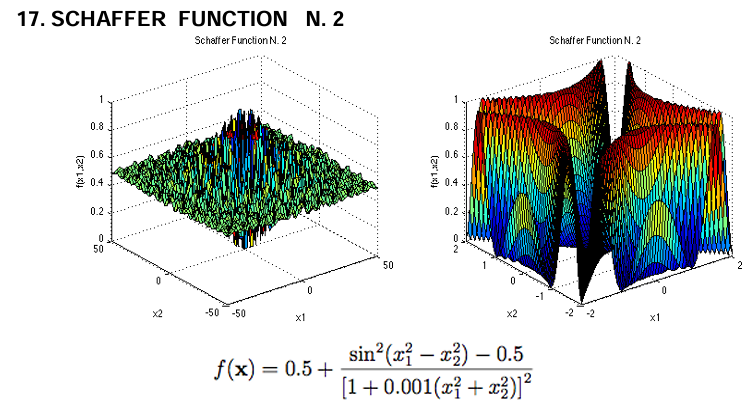

The N.4 encoding has 4 global minimum at [0,1.25312], [0,-1.25313], [1.25312,0], [-1.25313,0] with value 0.292579. The function is usually evaluated on the square xi ∈ [-100, 100], for all i = 1, 2.

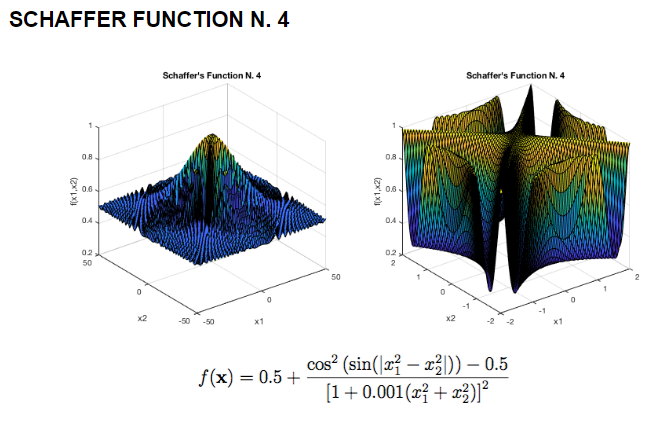

We implement the algorithm embedded into a Monte Carlo loop with a certain number of rounds and compute some statistics (mininum, iteration in which the minimum was found, mean and variance of the objective function). In addition, in a Monte Carlo simulation, random sampling is used to estimate the properties of a system or process by generating a large number of random samples. That is why we also compute the Monte Carlo Standard Error (MCSE) which provides a measure of how much the estimated value may vary due to random sampling variability.

We keep and return the best result (lower mean of the objective function) that we found during the Monte Carlo loop.

In [5]:
# Define the Monte Carlo function
def monte_carlo(rounds, func, n_dim, algorithm, lb, ub, algorithm_params, plot=False, log=True):
    # Auxiliary variables
    results = []
    best_total_result = float('inf')
    best_PSO = None
    best_iteration = None

    for i in range(rounds): # Monte Carlo loop
        al = algorithm(func=func, n_dim=n_dim, lb=lb, ub=ub, **algorithm_params)
            
        best_x, best_y = al.run()
        #print('Round',i,'\nbest_x:', best_x, '\nbest_y:', best_y)
        results.append(best_y)

        # Update best result found during the Monte Carlo loop
        if best_y < best_total_result:
            best_iteration = i
            best_total_result = best_y
            best_PSO = al

    # Calculate minimum, mean, and variance of the objective function
    min_result = np.min(results)
    mean_result = np.mean(results)
    variance_result = np.var(results)

    # Compute Monte Carlo Standard Error (MCSE)
    mcse = np.sqrt(variance_result) / np.sqrt(rounds)

    Y_history = pd.DataFrame(best_PSO.gbest_y_hist)
    
    if(log):
        print("Minimum of objective function:", min_result)
        print("Minimum found in round:", best_iteration)
        print("Minimum found in iteration:",Y_history.min(axis=1).idxmin())
        print("Mean of objective function:", mean_result)
        print("Variance of objective function:", variance_result)
        print("Monte Carlo standard error:", mcse)
    

    # Plot best PSO
    if(plot):
        # Plot the results as a box plot
        fig, axs = plt.subplots(2, 2, figsize=(14, 5))

        # Plot Y_history
        axs[0, 0].plot(Y_history.index, Y_history.values, '.', color='red')
        Y_history.min(axis=1).cummin().plot(kind='line', ax=axs[1, 0], color='red')

        # Remove the empty subplot in the second row
        fig.delaxes(axs[1, 1])

        # Plot the box plot
        results_df = pd.DataFrame(results)
        results_df.plot(kind='box', title='Monte Carlo box plot', ax=axs[0, 1])

        plt.tight_layout()  # Adjust layout for better spacing
        plt.show()

    return best_PSO, mean_result, variance_result, Y_history.min(axis=1).idxmin()

### 1. Run the examples of the Guofei-packages that minimize the Schaffer-function (with both encodings) in a Monte Carlo loop and log the mininum, mean, and variance of the objective function.

We initialize a certain number of Monte Carlo rounds.

In [6]:
rounds=100

#### Schaffer-function N.2

Run the algorithm with the parameters of the examples of the Guofei-packages that minimize the Schaffer-function.

Minimum of objective function: 0.0
Minimum found in round: 0
Minimum found in iteration: 113
Mean of objective function: 0.0
Variance of objective function: 0.0
Monte Carlo standard error: 0.0


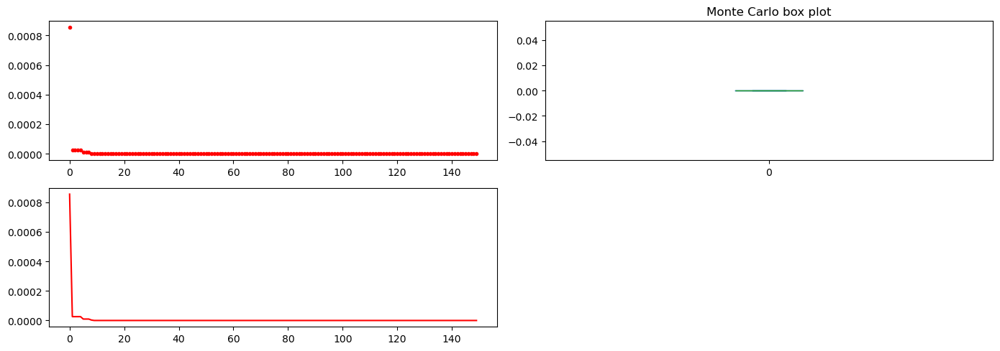

In [24]:
params = {'pop': 40, 'max_iter': 150, 'w': 0.8, 'c1':0.5, 'c2':0.5}
results = monte_carlo(rounds, schaffer_n2, 2, PSO, [-1, -1], [1, 1], params, plot=True)

Minimum of objective function: 3.622897669086633e-07
Minimum found in round: 23
Minimum found in iteration: 129
Mean of objective function: 0.02991698163202708
Variance of objective function: 0.012319763744697183
Monte Carlo standard error: 0.011099443114272528


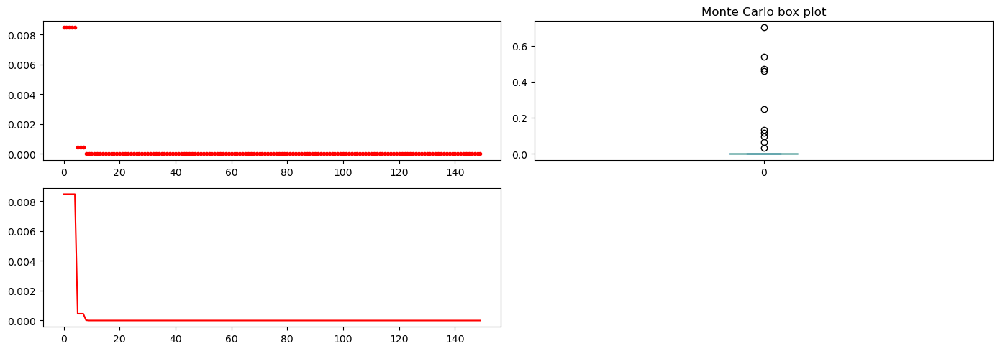

In [25]:
params = {'pop': 1, 'max_iter': 150, 'w': 0.8, 'c1':0.5, 'c2':0.5}
results = monte_carlo(rounds, schaffer_n2, 2, PSO, [-1, -1], [1, 1], params, plot=True)

#### Schaffer-function N.4

Minimum of objective function: 0.44415638244422917
Minimum found in round: 0
Minimum found in iteration: 126
Mean of objective function: 0.44415638244422906
Variance of objective function: 1.232595164407831e-32
Monte Carlo standard error: 1.1102230246251566e-17


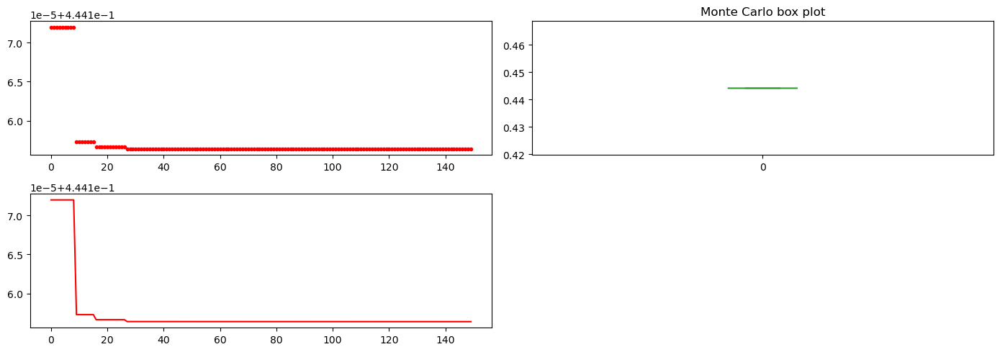

In [26]:
params = {'pop': 40, 'max_iter': 150, 'w': 0.8, 'c1':0.5, 'c2':0.5}
results = monte_carlo(rounds, schaffer_n4, 2, PSO, [-1, -1], [1, 1], params, plot=True)

Using the parameters of the examples of the Guofei-packages that minimize the Schaffer-function N.2 we achieve to find the global minimum in the second Monte Carlo round, with a zero mean and variance of objective function highlighting that using this set of parameters the algorithm is stable as it is able to find the global minimum in every Monte Carlo round. We can also see that the algorithm takes around 10 iterations to converge.

Regarding Schaffer-function N.4, we can see that PSO falls in a local minima (0.44) far from the real global minimum (0.292579) in every Monte Carlo round (since the variance is 0) making necessary to find another set of parameters to be able to reach this minimum. We can also see that the algorithm takes around 18 iterations to converge.

### 2. Try to find a parameter set of the particle swarm optimization algorithm sufficiently good.

A sufficiently good parameter set for a Particle Swarm Optimization Algorithm (PSO) can be evaluated based on its ability to consistently produce high-quality solutions for the given problem within a reasonable amount of time.

Thus, in order to find a parameter set we will consider the following aspects:

1. Evaluate the **stability** of the algorithm across multiple runs with the same parameter set. A good parameter set should produce consistent results close to the minimum across different runs, indicating robustness.

2. Measure **how quickly** the PSO converges towards optimal or near-optimal solutions.

First, we will look a parameter set fixing the maximum number of iterations to satisfy the first condition, and then we will try to reduce the maximum number of iterations to speed up the training without affecting the stability of the algorithm. The first aspect has higher priority since for this project we prefer a high stability than high velocity. 

####  2.1. Minimize Schaffer-function N.2 using grid search

The selection of Genetic Algorithm (PSO) parameters (selection mechanism, crossover and mutation rate) is problem dependent and because of the No Free Lunch theorem there is no general search algorithm to find those parameters that works well for all problems.

Thus, initially we will perform a **grid search** over a set of parameters for each Schaffer-function over the Particle Swarm Optimization algorithm. Then, we can evaluate the performance of each parameter set using the Monte Carlo loop keeping track of the best mean objective function value found.

Parameters to tune:
- c1, c2 : float
    - Parameters to control personal best, global best respectively
- pop : int
    - Size of population
- max_iter : int
    - Max of iterations
- w : float between 0 and 1
    - Inertia

In [14]:
# Define the parameter grid for PSO
PSO_param_grid = {
    'pop': [20, 50, 100, 500],
    'max_iter': [800],
    'w': [0.0001, 0.001, 0.01],
    'c1': [0.1, 0.5, 2.5],
    'c2': [0.1, 0.5, 2.5]
}

# Perform grid search for PSO
best_params_n2 = None
best_mean_result = float('inf')

for pop in PSO_param_grid['pop']:
    for max_iter in PSO_param_grid['max_iter']:
        for w in PSO_param_grid['w']:
            for c1 in PSO_param_grid['c1']:
                for c2 in PSO_param_grid['c2']:
                    params = {'pop': pop, 'max_iter': max_iter, 'w': w, 'c1':c1, 'c2':c2}
                    print("Testing params",params)
                    best_PSO, mean_result, _, _ = monte_carlo(rounds, schaffer_n2, 2, PSO, [-1, -1], [1, 1], params)
                    
                    if mean_result < best_mean_result:
                        best_mean_result = mean_result
                        best_params_n2 = params

                    print()

print("Best Parameters:", best_params_n2)
print("Best Mean Objective Function Value:", best_mean_result)

Testing params {'pop': 20, 'max_iter': 800, 'w': 0.0001, 'c1': 0.1, 'c2': 0.1}
Minimum of objective function: 0.0
Minimum found in iteration: 0
Mean of objective function: 2.8479971159178774e-10
Variance of objective function: 7.299978815048891e-19
Monte Carlo standard error: 2.701847296767323e-10

Testing params {'pop': 20, 'max_iter': 800, 'w': 0.0001, 'c1': 0.1, 'c2': 0.5}
Minimum of objective function: 0.0
Minimum found in iteration: 2
Mean of objective function: 2.1858070908820081e-13
Variance of objective function: 4.204835523321909e-25
Monte Carlo standard error: 2.0505695607128057e-13

Testing params {'pop': 20, 'max_iter': 800, 'w': 0.0001, 'c1': 0.1, 'c2': 2.5}
Minimum of objective function: 0.0
Minimum found in iteration: 0
Mean of objective function: 0.0
Variance of objective function: 0.0
Monte Carlo standard error: 0.0

Testing params {'pop': 20, 'max_iter': 800, 'w': 0.0001, 'c1': 0.5, 'c2': 0.1}
Minimum of objective function: 0.0
Minimum found in iteration: 0
Mean of ob

The best parameters found are **{'pop': 20, 'max_iter': 800, 'w': 0.0001, 'c1': 0.1, 'c2': 2.5}**, with a mean objective function value of 0.0 across the different Monte Carlo rounds. This implies that the system is perfectly balanced as it achieved to find the minimal solution (0) in every Monte Carlo round.

Also note that, from the results, most of the parameter sets show perfectly balanced systems. Only some of the parameter sets with the lowest "pop" value do not achieve to provide a mean of objective function of 0, though it is really close and it only takes 1 Monte Carlo round more.

In [7]:
# Define the parameter grid for PSO
PSO_param_grid = {
    'pop': [20],
    'max_iter': [10,50,100,500,800],
    'w': [0.0001],
    'c1': [0.1],
    'c2': [2.5]
}

# Perform grid search for PSO
best_params_n2 = None
best_mean_result = float('inf')

for pop in PSO_param_grid['pop']:
    for max_iter in PSO_param_grid['max_iter']:
        for w in PSO_param_grid['w']:
            for c1 in PSO_param_grid['c1']:
                for c2 in PSO_param_grid['c2']:
                    params = {'pop': pop, 'max_iter': max_iter, 'w': w, 'c1':c1, 'c2':c2}
                    print("Testing params",params)
                    best_PSO, mean_result, _ = monte_carlo(rounds, schaffer_n2, 2, PSO, [-1, -1], [1, 1], params)
                    
                    if mean_result < best_mean_result:
                        best_mean_result = mean_result
                        best_params_n2 = params

                    print()

print("Best Parameters:", best_params_n2)
print("Best Mean Objective Function Value:", best_mean_result)

Testing params {'pop': 20, 'max_iter': 10, 'w': 0.0001, 'c1': 0.1, 'c2': 2.5}
Minimum of objective function: 2.1475488054534253e-11
Minimum found in round: 6
Mean of objective function: 1.061074716979249e-09
Variance of objective function: 1.9634490316914432e-18
Monte Carlo standard error: 4.4310822963373663e-10

Testing params {'pop': 20, 'max_iter': 50, 'w': 0.0001, 'c1': 0.1, 'c2': 2.5}
Minimum of objective function: 0.0
Minimum found in round: 0
Mean of objective function: 0.0
Variance of objective function: 0.0
Monte Carlo standard error: 0.0

Testing params {'pop': 20, 'max_iter': 100, 'w': 0.0001, 'c1': 0.1, 'c2': 2.5}
Minimum of objective function: 0.0
Minimum found in round: 0
Mean of objective function: 0.0
Variance of objective function: 0.0
Monte Carlo standard error: 0.0

Testing params {'pop': 20, 'max_iter': 500, 'w': 0.0001, 'c1': 0.1, 'c2': 2.5}
Minimum of objective function: 0.0
Minimum found in round: 1
Mean of objective function: 2.2204460492503132e-17
Variance of o

Now we see that the best parameters are **{'pop': 20, 'max_iter': 50, 'w': 0.0001, 'c1':0.1, 'c2': 2.5}**, reducing the number of maximum iterations from 500 to 50. In the example of the Guoffei package we saw that the algorithm took around 10 iterations to converge. That is why using a maximum iterations number of 10 does not give stable results, contrary to using a maximum iterations number of 50. In this way, we achieve to increase the efficiency of the algorithm when looking for the optimal solution and we conclude considering this parameter set **sufficiently good** for this problem.

In summary, the PSO algorithm demonstrates robustness and effectiveness in minimizing the Schaffer function across various parameter settings, with consistent convergence and low variability in the objective function values. Below results along with convergence and box plots are shown for the best parameters set.

Minimum of objective function: 0.0
Minimum found in round: 0
Minimum found in iteration: 21
Mean of objective function: 0.0
Variance of objective function: 0.0
Monte Carlo standard error: 0.0


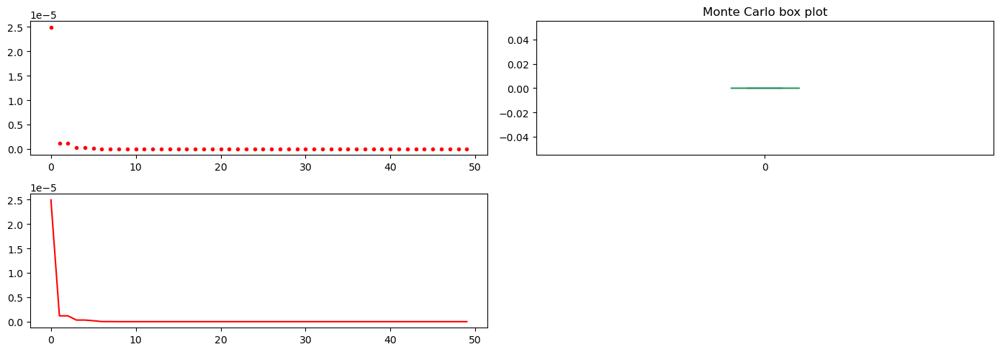

In [8]:
params = {'pop': 20, 'max_iter': 50, 'w': 0.0001, 'c1':0.1, 'c2': 2.5}
results = monte_carlo(rounds, schaffer_n2, 2, PSO, [-1, -1], [1, 1], params, plot=True)

####  2.2. Minimize Schaffer-function N.2 using Optuna

For the following experiments we will use **Optuna**, an open-source parameter optimization. It automates the process of tuning to maximize their performance. Optuna uses various algorithms and strategies, such as Bayesian optimization, to efficiently search through the parameter space and find the optimal configuration for a given objective function, unlike grid search which exhaustively explores a predefined set of parameters. In addition, it offers plots helpful to detect possible correlations between parameters configurations.

First we are going to check what happens when we vary the value of one parameter where maintaining the others frozen. We will keep the values from the example of the Guofei-package as the default values and we will use a search area ([-100,-100],[100,100]).

#### 2.2.1 Varying population
We will analyze 10 different values for the population size between 5 and 500.

[I 2024-03-14 16:31:16,074] A new study created in memory with name: no-name-6cbc7754-1c43-4bb3-a615-3aaa8c3010a8


Minimum of objective function: 0.0
Minimum found in round: 0
Minimum found in iteration: 111
Mean of objective function: 0.0
Variance of objective function: 0.0
Monte Carlo standard error: 0.0


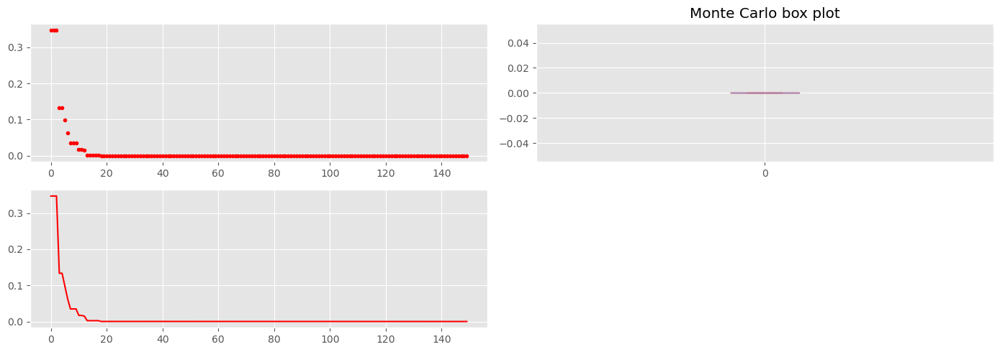

[I 2024-03-14 16:31:29,438] Trial 0 finished with values: [0.0, 0.0, 111.0] and parameters: {'pop': 126}. 


Minimum of objective function: 0.0
Minimum found in round: 0
Minimum found in iteration: 118
Mean of objective function: 0.0
Variance of objective function: 0.0
Monte Carlo standard error: 0.0


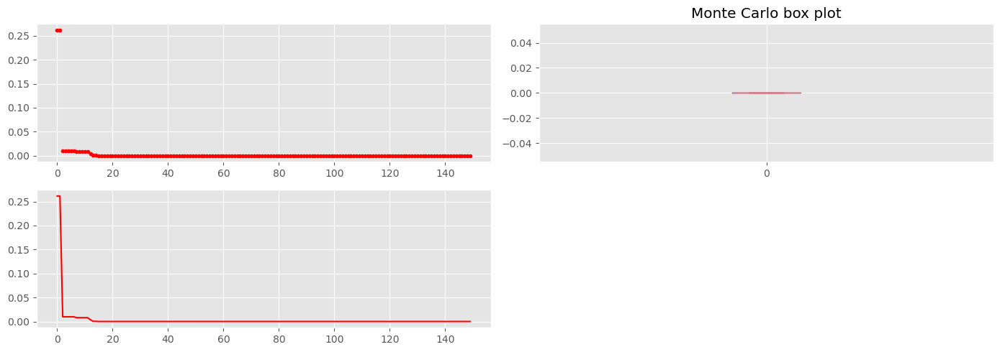

[I 2024-03-14 16:32:01,513] Trial 1 finished with values: [0.0, 0.0, 118.0] and parameters: {'pop': 320}. 


Minimum of objective function: 0.0
Minimum found in round: 0
Minimum found in iteration: 125
Mean of objective function: 0.0
Variance of objective function: 0.0
Monte Carlo standard error: 0.0


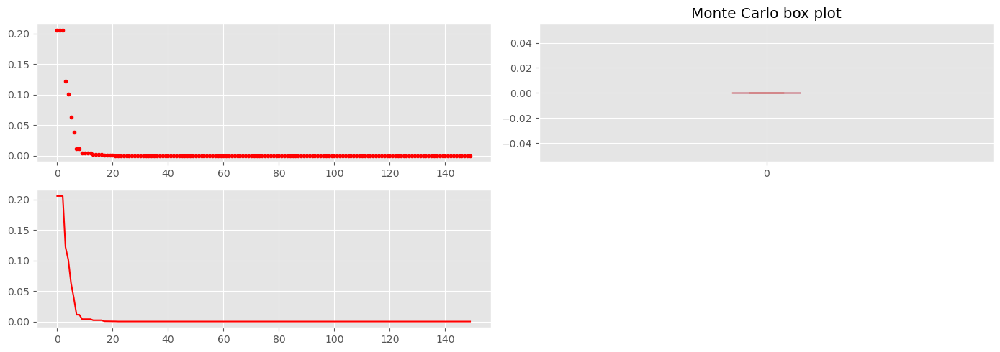

[I 2024-03-14 16:32:26,667] Trial 2 finished with values: [0.0, 0.0, 125.0] and parameters: {'pop': 249}. 


Minimum of objective function: 0.0
Minimum found in round: 0
Minimum found in iteration: 128
Mean of objective function: 0.0
Variance of objective function: 0.0
Monte Carlo standard error: 0.0


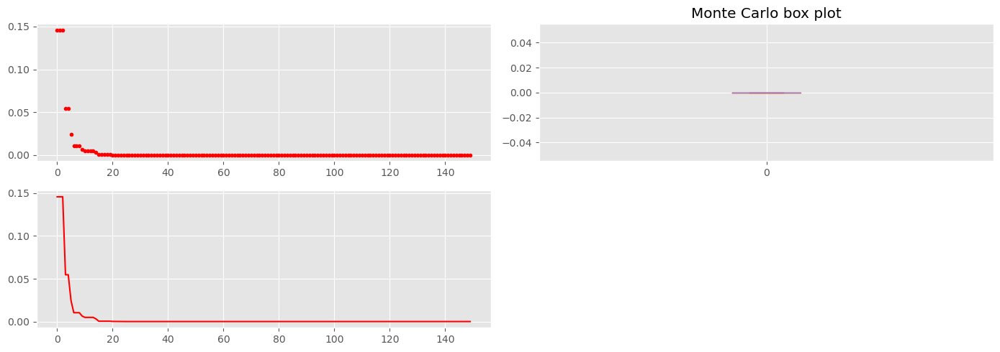

[I 2024-03-14 16:32:56,442] Trial 3 finished with values: [0.0, 0.0, 128.0] and parameters: {'pop': 294}. 


Minimum of objective function: 0.0
Minimum found in round: 0
Minimum found in iteration: 126
Mean of objective function: 0.0
Variance of objective function: 0.0
Monte Carlo standard error: 0.0


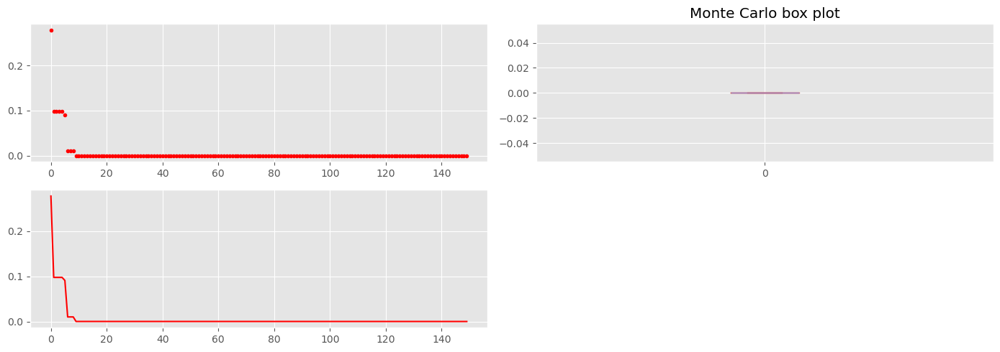

[I 2024-03-14 16:33:21,171] Trial 4 finished with values: [0.0, 0.0, 126.0] and parameters: {'pop': 243}. 


Minimum of objective function: 0.0
Minimum found in round: 0
Minimum found in iteration: 113
Mean of objective function: 0.0
Variance of objective function: 0.0
Monte Carlo standard error: 0.0


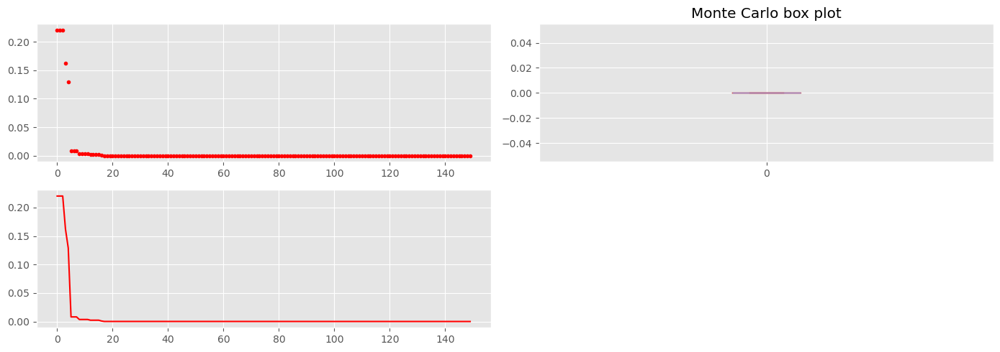

[I 2024-03-14 16:33:57,017] Trial 5 finished with values: [0.0, 0.0, 113.0] and parameters: {'pop': 360}. 


Minimum of objective function: 0.0
Minimum found in round: 0
Minimum found in iteration: 140
Mean of objective function: 0.0
Variance of objective function: 0.0
Monte Carlo standard error: 0.0


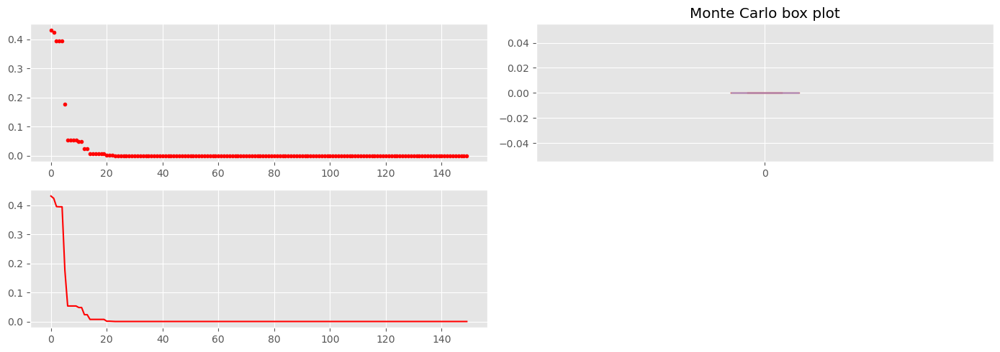

[I 2024-03-14 16:34:05,570] Trial 6 finished with values: [0.0, 0.0, 140.0] and parameters: {'pop': 78}. 


Minimum of objective function: 0.0
Minimum found in round: 0
Minimum found in iteration: 122
Mean of objective function: 0.0
Variance of objective function: 0.0
Monte Carlo standard error: 0.0


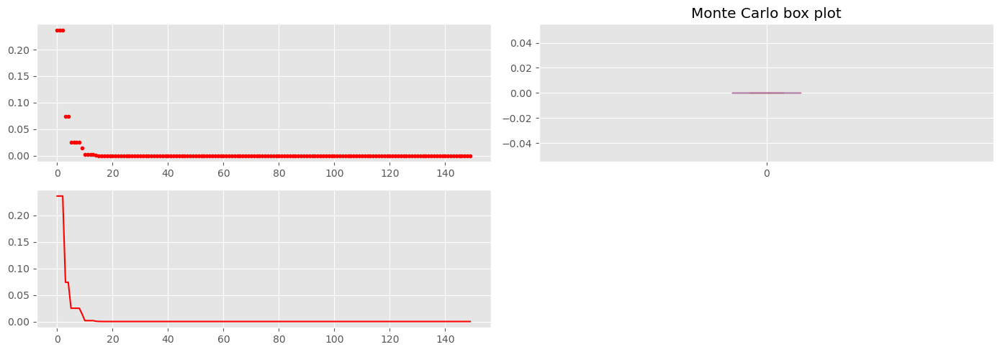

[I 2024-03-14 16:34:47,497] Trial 7 finished with values: [0.0, 0.0, 122.0] and parameters: {'pop': 424}. 


Minimum of objective function: 0.0
Minimum found in round: 0
Minimum found in iteration: 110
Mean of objective function: 0.0
Variance of objective function: 0.0
Monte Carlo standard error: 0.0


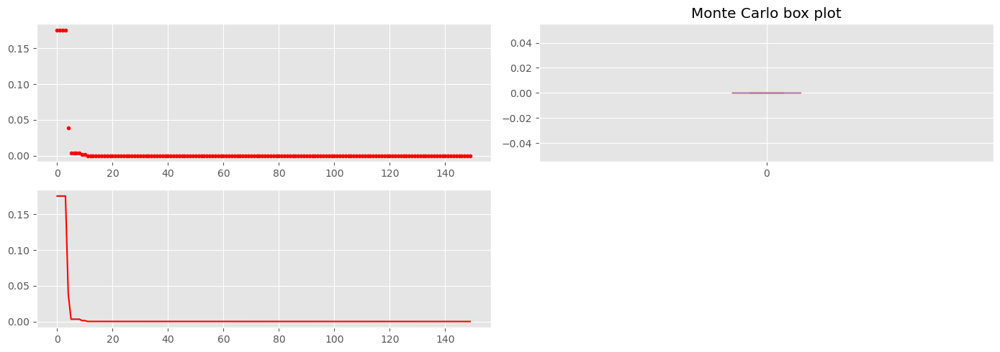

[I 2024-03-14 16:35:27,404] Trial 8 finished with values: [0.0, 0.0, 110.0] and parameters: {'pop': 406}. 


Minimum of objective function: 0.0
Minimum found in round: 0
Minimum found in iteration: 121
Mean of objective function: 0.0
Variance of objective function: 0.0
Monte Carlo standard error: 0.0


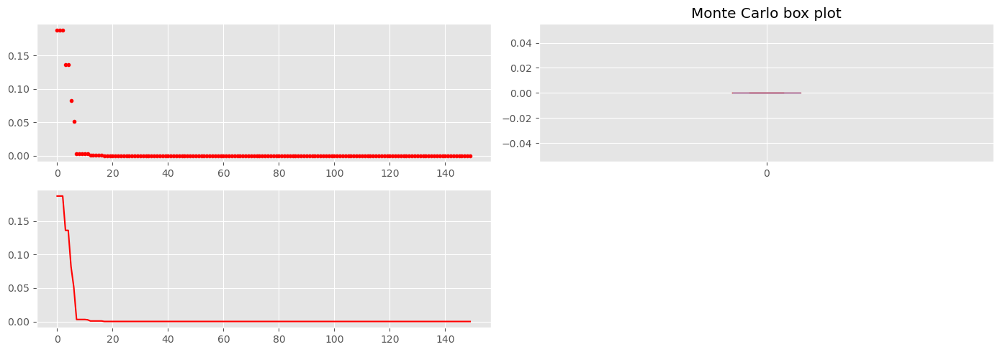

[I 2024-03-14 16:36:02,877] Trial 9 finished with values: [0.0, 0.0, 121.0] and parameters: {'pop': 358}. 


In [66]:
def objective(trial):
    params = {
        "pop": trial.suggest_int("pop", 5, 500),
        'max_iter': 150,
        'w': 0.8,
        'c1': 0.5,
        'c2': 0.5,
    }

    # Add a callback for pruning.
    _, mean_result, variance_result, minimum_iter = monte_carlo(rounds, schaffer_n2, 2, PSO, [-100, -100], [100, 100], params, plot=True, log=True)
    return mean_result, variance_result, minimum_iter

study = optuna.create_study(
    directions=["minimize","minimize","minimize"]
)
study.optimize(objective, callbacks=[MaxTrialsCallback(10, states=(TrialState.COMPLETE,))])

/tmp/ipykernel_1461/863184516.py:1: ExperimentalWarning: plot_pareto_front is experimental (supported from v2.8.0). The interface can change in the future.
  plot_pareto_front(study, target_names=["Mean objective", "Var objective", "Minimum iterations"])
/tmp/ipykernel_1461/863184516.py:2: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Mean objective")
/home/user/miniconda3/envs/ec/lib/python3.10/site-packages/optuna/visualization/matplotlib/_parallel_coordinate.py:119: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  ax.set_ylim(info.dim_objective.range[0], info.dim_objective.range[1])
/tmp/ipykernel_1461/863184516.py:3: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_c

<Axes: title={'center': 'Parallel Coordinate Plot'}>

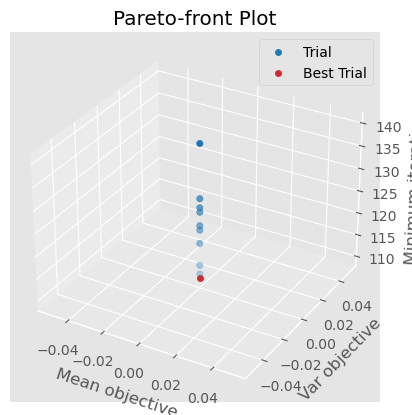

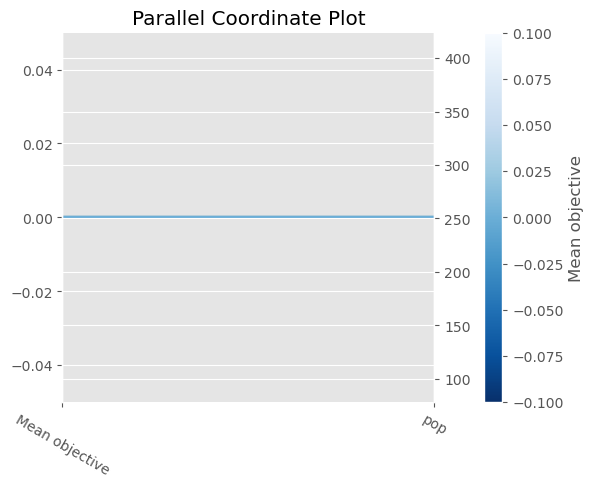

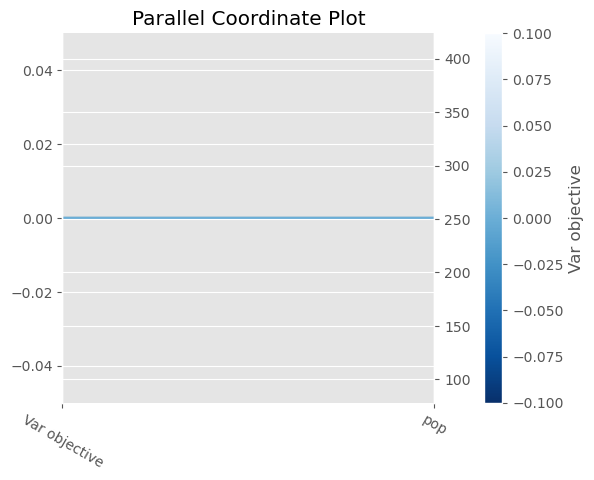

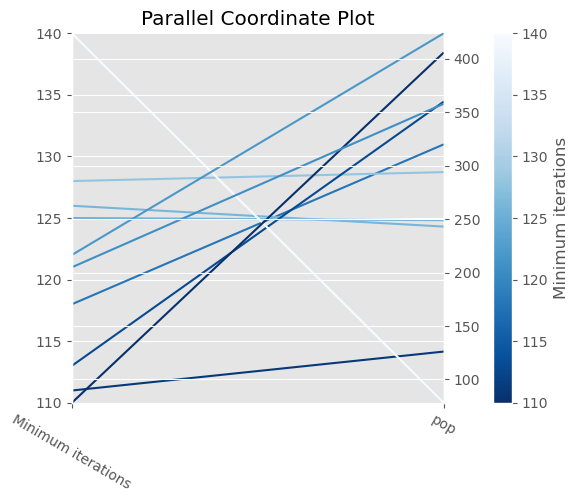

In [67]:
plot_pareto_front(study, target_names=["Mean objective", "Var objective", "Minimum iterations"])
plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Mean objective")
plot_parallel_coordinate(study, target=lambda t: t.values[1], target_name="Var objective")
plot_parallel_coordinate(study, target=lambda t: t.values[2], target_name="Minimum iterations")

Across the ten trials, the minimum of the objective function remains consistently at 0.0, indicating that the algorithm successfully converges to the global optimum. However, there are variations in the number of iterations required to achieve convergence, with values ranging from 110 to 140. Interestingly, there seems to be no clear correlation between population size and convergence speed, as both larger (e.g., 424) and smaller (e.g., 78) population sizes exhibit relatively low iteration counts. This suggests that other factors, such as the exploration-exploitation trade-off, may play a more significant role in determining convergence speed. Nonetheless, it's important to note that these results are specific to the problem at hand and may not generalize to other optimization tasks.

Further experimentation and analysis would be necessary to gain a deeper understanding of the interplay between population size and convergence behavior in PSO algorithms. The most probable reason for these results is that the problem complexity is low.

#### 2.2.2 Varying maximum of iterations
We will analyze 10 different values for the maximum of iterations between 5 and 500.

[I 2024-03-14 16:36:03,695] A new study created in memory with name: no-name-d7298c54-d7df-4396-bc3e-6d5e3db5d2c7


Minimum of objective function: 0.0
Minimum found in round: 0
Minimum found in iteration: 135
Mean of objective function: 0.0
Variance of objective function: 0.0
Monte Carlo standard error: 0.0


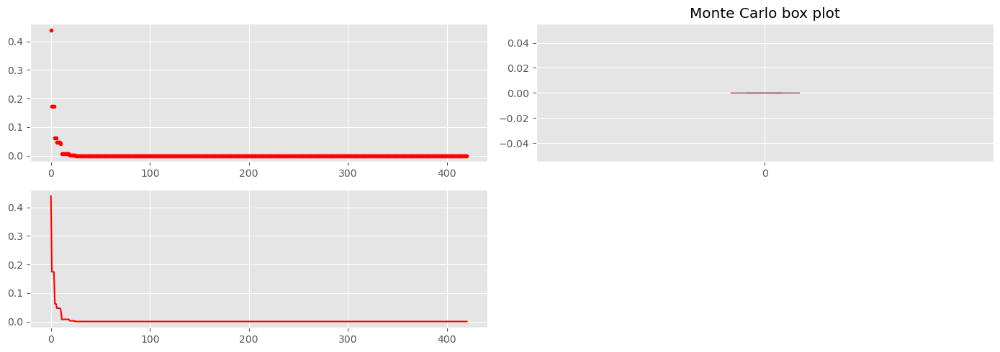

[I 2024-03-14 16:36:16,394] Trial 0 finished with values: [0.0, 0.0, 135.0] and parameters: {'max_iter': 421}. 


Minimum of objective function: 0.0
Minimum found in round: 0
Minimum found in iteration: 148
Mean of objective function: 0.0
Variance of objective function: 0.0
Monte Carlo standard error: 0.0


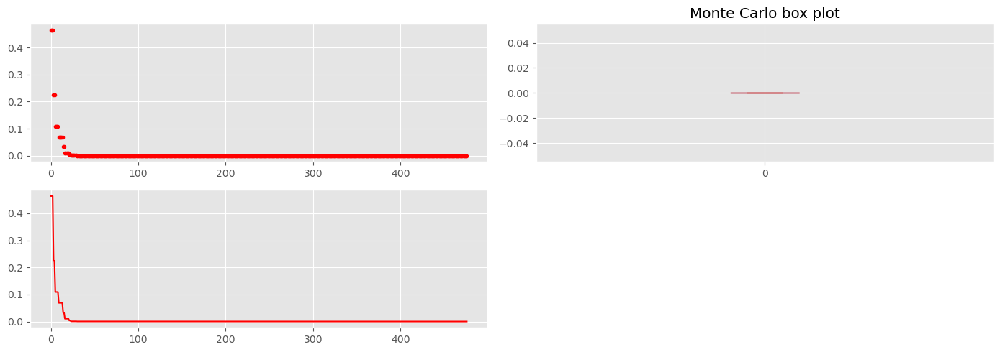

[I 2024-03-14 16:36:30,622] Trial 1 finished with values: [0.0, 0.0, 148.0] and parameters: {'max_iter': 477}. 


Minimum of objective function: 0.0
Minimum found in round: 0
Minimum found in iteration: 141
Mean of objective function: 0.0
Variance of objective function: 0.0
Monte Carlo standard error: 0.0


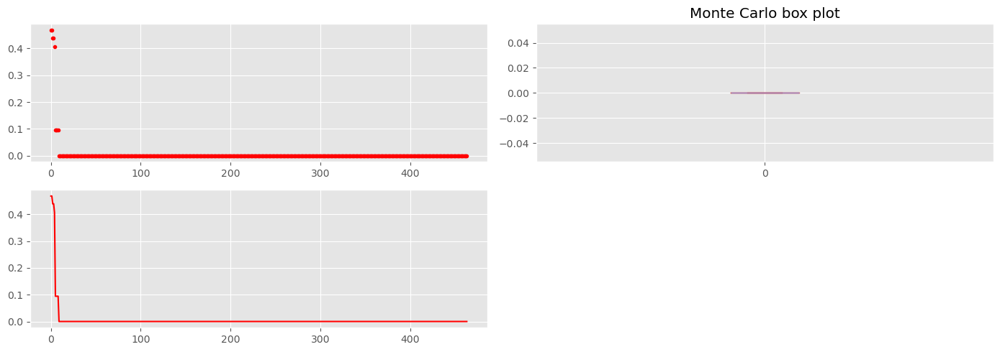

[I 2024-03-14 16:36:44,557] Trial 2 finished with values: [0.0, 0.0, 141.0] and parameters: {'max_iter': 464}. 


Minimum of objective function: 0.0
Minimum found in round: 0
Minimum found in iteration: 138
Mean of objective function: 0.0
Variance of objective function: 0.0
Monte Carlo standard error: 0.0


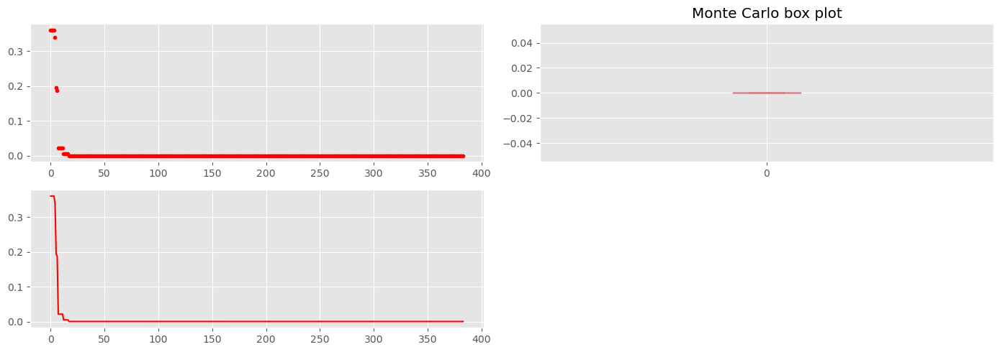

[I 2024-03-14 16:36:56,252] Trial 3 finished with values: [0.0, 0.0, 138.0] and parameters: {'max_iter': 384}. 


Minimum of objective function: 0.0
Minimum found in round: 0
Minimum found in iteration: 134
Mean of objective function: 1.4210854715202004e-16
Variance of objective function: 5.474694682233821e-32
Monte Carlo standard error: 2.339806548036359e-17


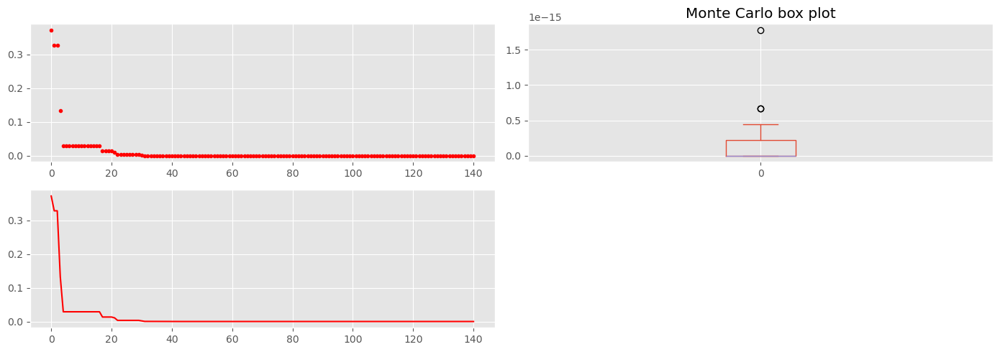

[I 2024-03-14 16:37:00,728] Trial 4 finished with values: [1.4210854715202004e-16, 5.474694682233821e-32, 134.0] and parameters: {'max_iter': 141}. 


Minimum of objective function: 1.2385648062718246e-12
Minimum found in round: 55
Minimum found in iteration: 71
Mean of objective function: 3.4050285424580553e-10
Variance of objective function: 2.1678585838290003e-19
Monte Carlo standard error: 4.656026829635972e-11


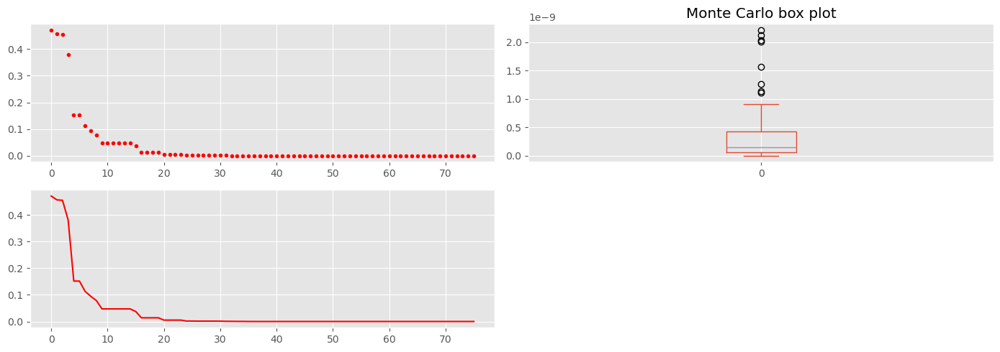

[I 2024-03-14 16:37:03,884] Trial 5 finished with values: [3.4050285424580553e-10, 2.1678585838290003e-19, 71.0] and parameters: {'max_iter': 76}. 


Minimum of objective function: 0.0
Minimum found in round: 0
Minimum found in iteration: 144
Mean of objective function: 0.0
Variance of objective function: 0.0
Monte Carlo standard error: 0.0


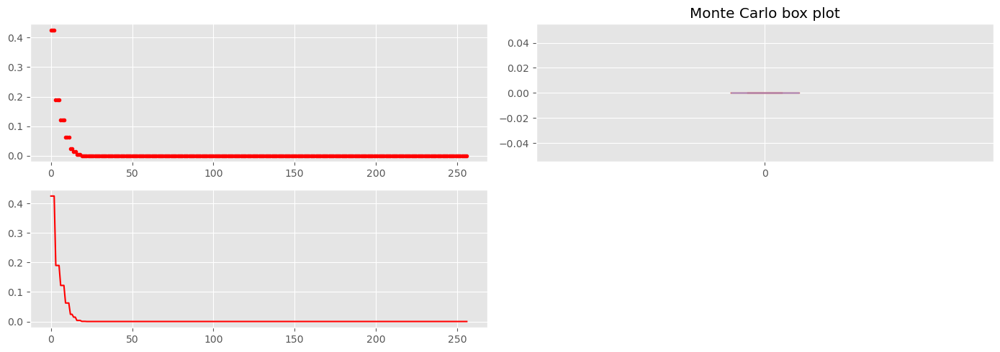

[I 2024-03-14 16:37:11,631] Trial 6 finished with values: [0.0, 0.0, 144.0] and parameters: {'max_iter': 257}. 


Minimum of objective function: 0.0
Minimum found in round: 0
Minimum found in iteration: 137
Mean of objective function: 0.0
Variance of objective function: 0.0
Monte Carlo standard error: 0.0


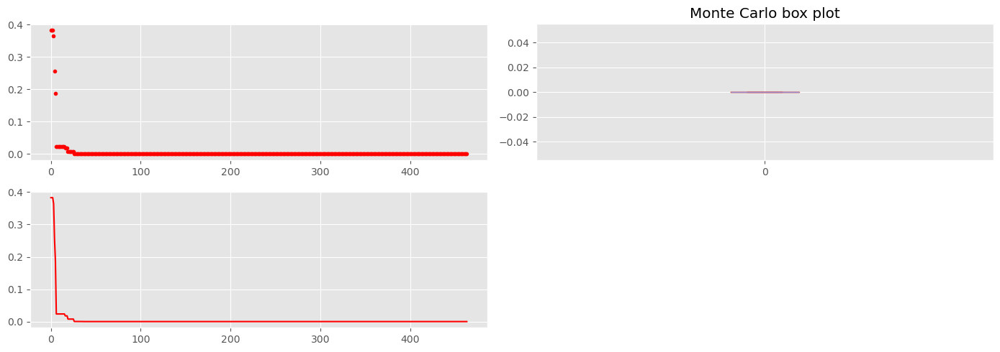

[I 2024-03-14 16:37:25,572] Trial 7 finished with values: [0.0, 0.0, 137.0] and parameters: {'max_iter': 464}. 


Minimum of objective function: 4.7875710618150435e-09
Minimum found in round: 2
Minimum found in iteration: 42
Mean of objective function: 6.468397647163559e-07
Variance of objective function: 2.48263210872575e-12
Monte Carlo standard error: 1.5756370485380668e-07


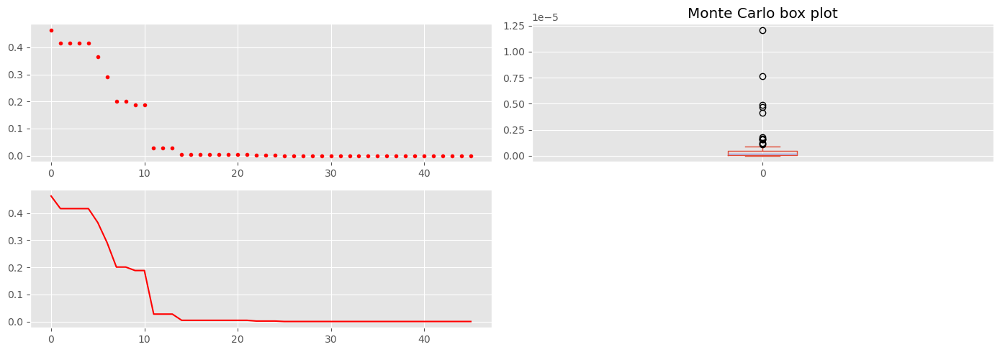

[I 2024-03-14 16:37:27,213] Trial 8 finished with values: [6.468397647163559e-07, 2.48263210872575e-12, 42.0] and parameters: {'max_iter': 46}. 


Minimum of objective function: 0.0
Minimum found in round: 0
Minimum found in iteration: 146
Mean of objective function: 0.0
Variance of objective function: 0.0
Monte Carlo standard error: 0.0


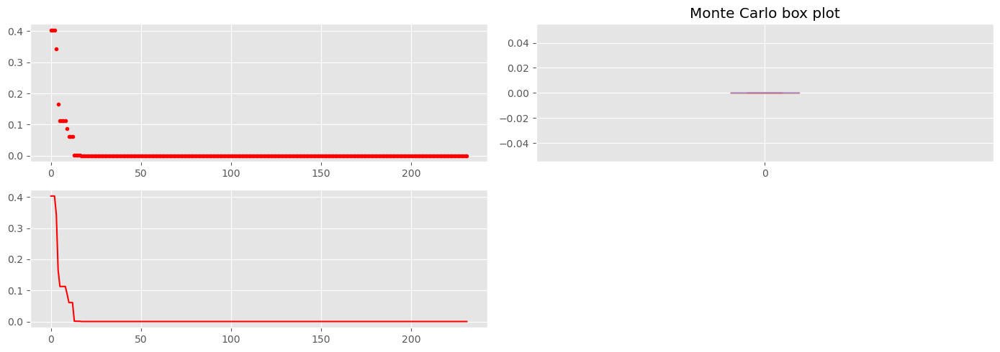

[I 2024-03-14 16:37:34,231] Trial 9 finished with values: [0.0, 0.0, 146.0] and parameters: {'max_iter': 232}. 


In [68]:
def objective(trial):
    params = {
        "pop": 40,
        'max_iter': trial.suggest_int("max_iter", 5, 500),
        'w': 0.8,
        'c1': 0.5,
        'c2': 0.5,
    }

    # Add a callback for pruning.
    _, mean_result, variance_result, minimum_iter = monte_carlo(rounds, schaffer_n2, 2, PSO, [-100, -100], [100, 100], params, plot=True, log=True)
    return mean_result, variance_result, minimum_iter

study = optuna.create_study(
    directions=["minimize","minimize","minimize"]
)
study.optimize(objective, callbacks=[MaxTrialsCallback(10, states=(TrialState.COMPLETE,))])

/tmp/ipykernel_1461/863184516.py:1: ExperimentalWarning: plot_pareto_front is experimental (supported from v2.8.0). The interface can change in the future.
  plot_pareto_front(study, target_names=["Mean objective", "Var objective", "Minimum iterations"])
/tmp/ipykernel_1461/863184516.py:2: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Mean objective")
/tmp/ipykernel_1461/863184516.py:3: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study, target=lambda t: t.values[1], target_name="Var objective")
/tmp/ipykernel_1461/863184516.py:4: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study, target=lambda t: t.values[2], targe

<Axes: title={'center': 'Parallel Coordinate Plot'}>

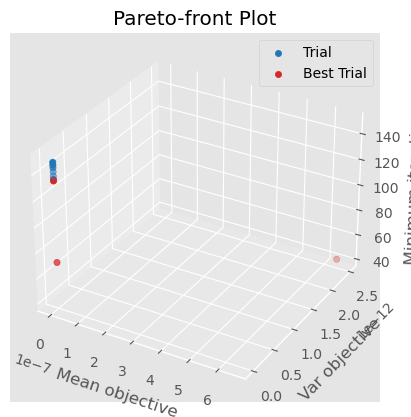

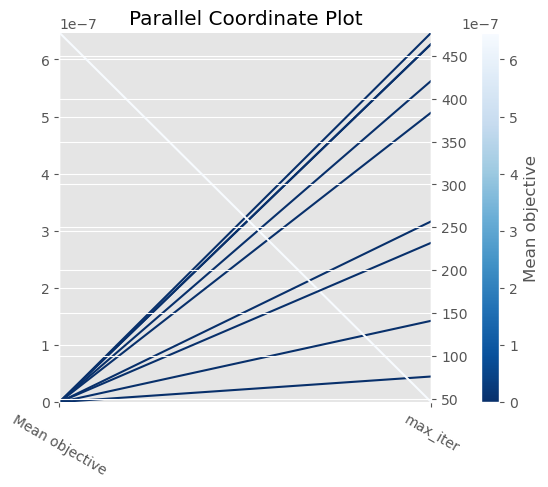

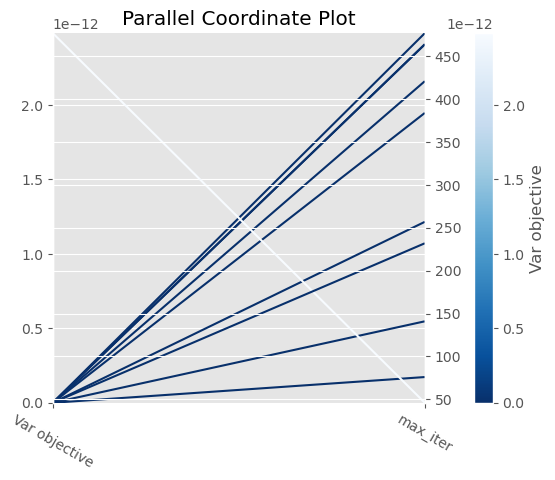

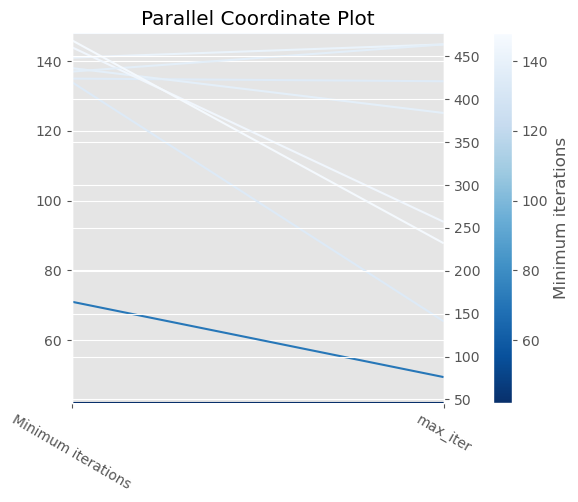

In [69]:
plot_pareto_front(study, target_names=["Mean objective", "Var objective", "Minimum iterations"])
plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Mean objective")
plot_parallel_coordinate(study, target=lambda t: t.values[1], target_name="Var objective")
plot_parallel_coordinate(study, target=lambda t: t.values[2], target_name="Minimum iterations")

As we can see in the results above, if the maximum of iterations is set too low the algorithm may not have sufficient time to explore and exploit the search space effectively. As a result, the optimization process may terminate prematurely, leading to suboptimal solutions or convergence to local optima. This limitation can result in a lack of thorough exploration, hindering the algorithm's ability to discover the best possible solution.

#### 2.2.3 Varying w (inertia)
We will analyze 10 different values for the w between 0.00001 and 1.0.

[I 2024-03-14 16:37:35,038] A new study created in memory with name: no-name-2c70e1ed-6e7a-4133-862c-5c6b3f6bc511


Minimum of objective function: 0.0
Minimum found in round: 0
Minimum found in iteration: 61
Mean of objective function: 0.00013152390167415261
Variance of objective function: 1.7125551344476243e-06
Monte Carlo standard error: 0.0001308646298450282


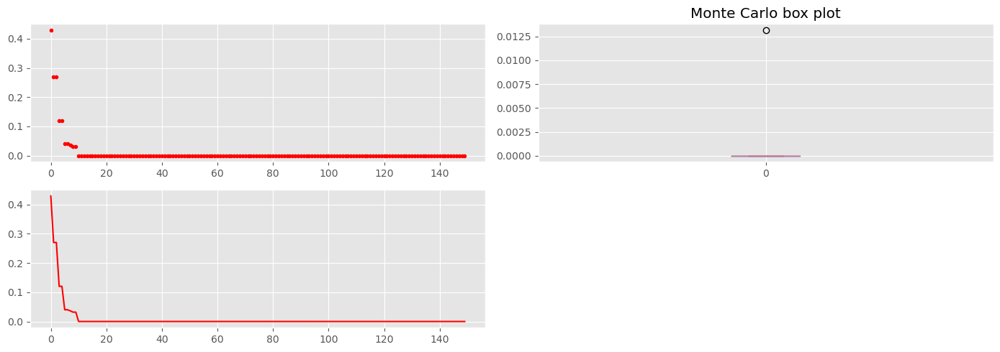

[I 2024-03-14 16:37:39,749] Trial 0 finished with values: [0.00013152390167415261, 1.7125551344476243e-06, 61.0] and parameters: {'w': 0.5674248964903896}. 


Minimum of objective function: 1.1102230246251565e-14
Minimum found in round: 9
Minimum found in iteration: 131
Mean of objective function: 1.0363027103110767e-11
Variance of objective function: 7.709737967122027e-22
Monte Carlo standard error: 2.7766414905641e-12


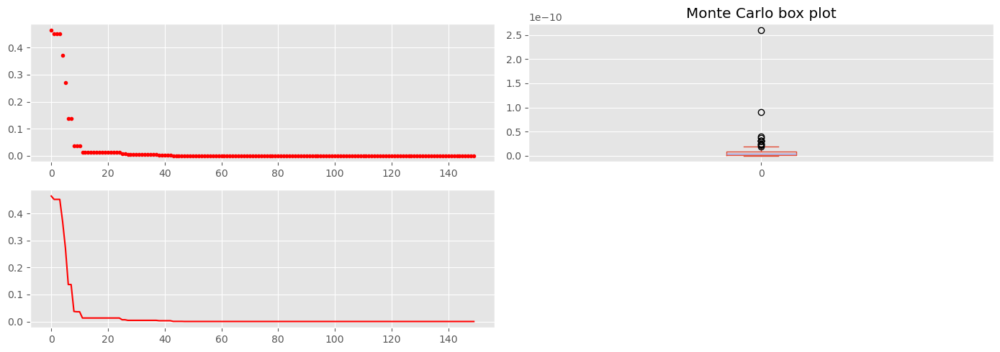

[I 2024-03-14 16:37:44,418] Trial 1 finished with values: [1.0363027103110767e-11, 7.709737967122027e-22, 131.0] and parameters: {'w': 0.8770196935104075}. 


Minimum of objective function: 0.0
Minimum found in round: 0
Minimum found in iteration: 122
Mean of objective function: 3.614896340784935e-05
Variance of objective function: 3.1518155058550733e-08
Monte Carlo standard error: 1.7753353220884986e-05


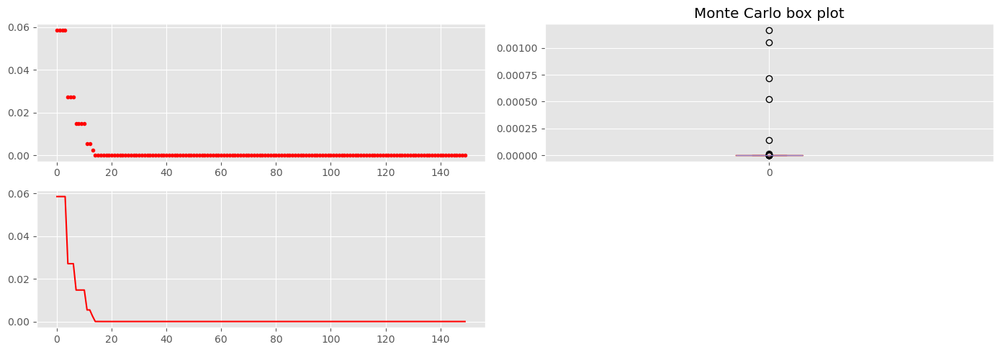

[I 2024-03-14 16:37:49,128] Trial 2 finished with values: [3.614896340784935e-05, 3.1518155058550733e-08, 122.0] and parameters: {'w': 0.11261625976318873}. 


Minimum of objective function: 0.0
Minimum found in round: 0
Minimum found in iteration: 56
Mean of objective function: 0.0
Variance of objective function: 0.0
Monte Carlo standard error: 0.0


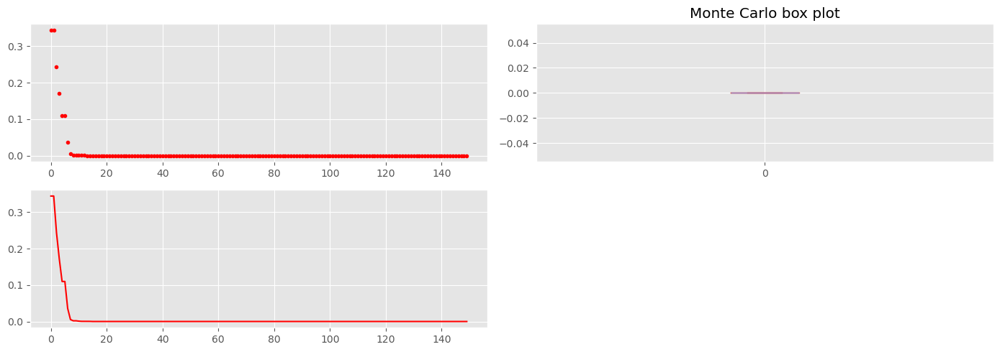

[I 2024-03-14 16:37:53,777] Trial 3 finished with values: [0.0, 0.0, 56.0] and parameters: {'w': 0.5408379436145616}. 


Minimum of objective function: 0.0
Minimum found in round: 0
Minimum found in iteration: 84
Mean of objective function: 0.00010981297187210525
Variance of objective function: 8.633476077949891e-07
Monte Carlo standard error: 9.291650056878967e-05


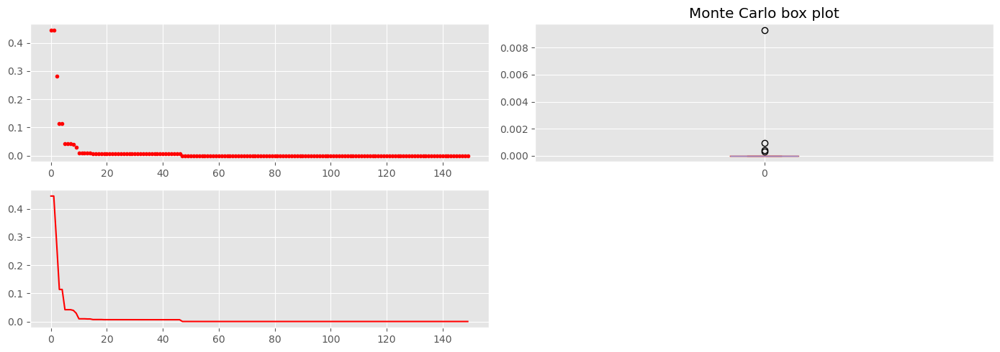

[I 2024-03-14 16:37:58,508] Trial 4 finished with values: [0.00010981297187210525, 8.633476077949891e-07, 84.0] and parameters: {'w': 0.45628262857774093}. 


Minimum of objective function: 0.0
Minimum found in round: 0
Minimum found in iteration: 79
Mean of objective function: 0.0
Variance of objective function: 0.0
Monte Carlo standard error: 0.0


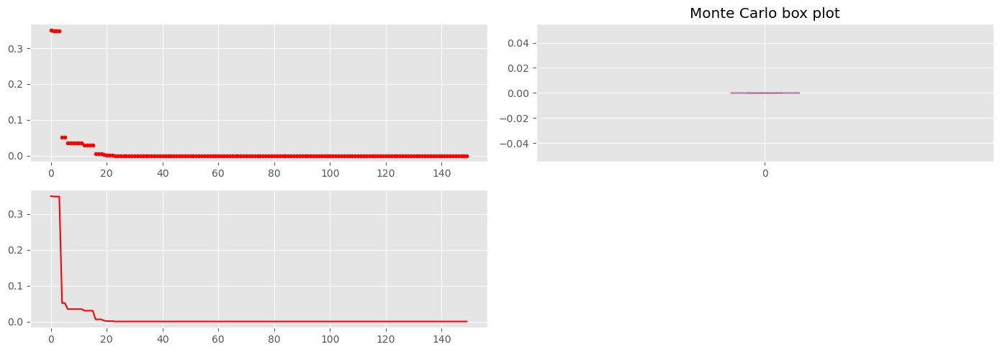

[I 2024-03-14 16:38:03,184] Trial 5 finished with values: [0.0, 0.0, 79.0] and parameters: {'w': 0.6805892486073022}. 


Minimum of objective function: 2.198019544152885e-12
Minimum found in round: 48
Minimum found in iteration: 148
Mean of objective function: 4.609268727806537e-10
Variance of objective function: 8.286763580700212e-19
Monte Carlo standard error: 9.103166251750108e-11


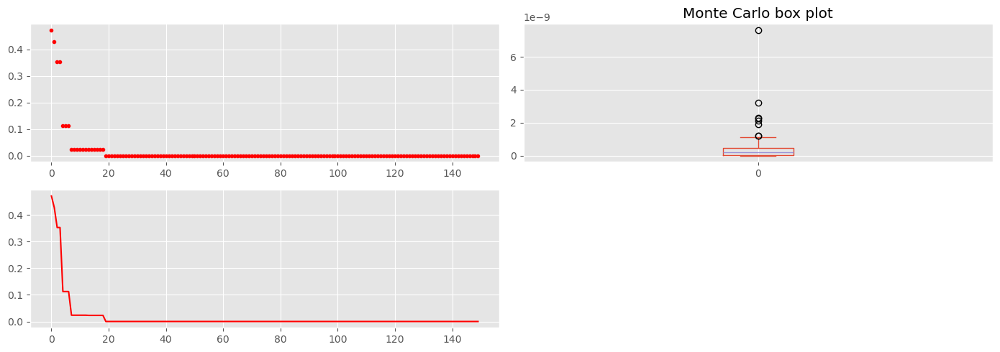

[I 2024-03-14 16:38:07,859] Trial 6 finished with values: [4.609268727806537e-10, 8.286763580700212e-19, 148.0] and parameters: {'w': 0.9011325373487822}. 


Minimum of objective function: 4.754840002285654e-07
Minimum found in round: 99
Minimum found in iteration: 139
Mean of objective function: 0.0016761711516092637
Variance of objective function: 7.255438044803753e-06
Monte Carlo standard error: 0.0002693592033846951


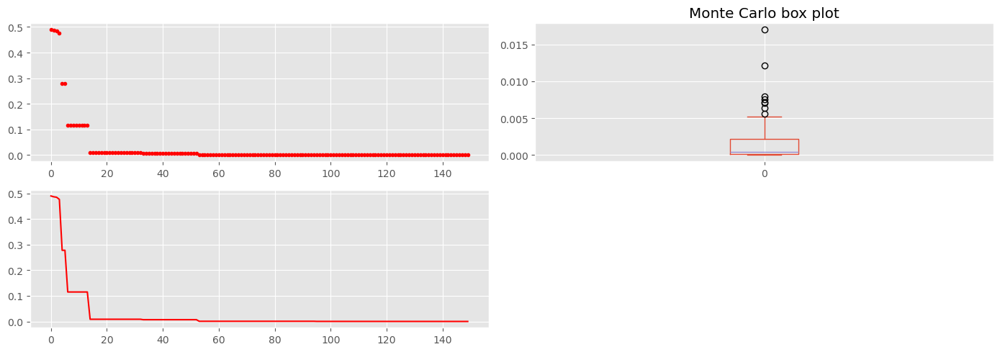

[I 2024-03-14 16:38:12,544] Trial 7 finished with values: [0.0016761711516092637, 7.255438044803753e-06, 139.0] and parameters: {'w': 0.9892264516656194}. 


Minimum of objective function: 0.0
Minimum found in round: 0
Minimum found in iteration: 81
Mean of objective function: 0.00013592989894249175
Variance of objective function: 4.291442544979269e-07
Monte Carlo standard error: 6.550910276426681e-05


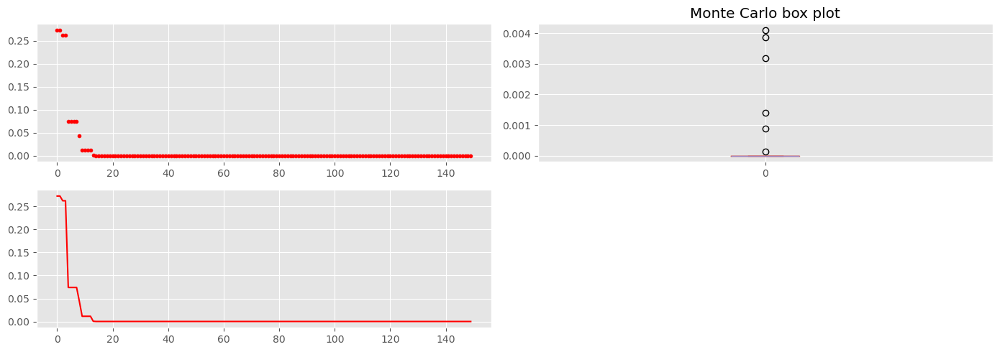

[I 2024-03-14 16:38:17,225] Trial 8 finished with values: [0.00013592989894249175, 4.291442544979269e-07, 81.0] and parameters: {'w': 0.44709374561308185}. 


Minimum of objective function: 0.0
Minimum found in round: 2
Minimum found in iteration: 99
Mean of objective function: 8.309182161028994e-05
Variance of objective function: 2.7049370344323415e-07
Monte Carlo standard error: 5.200900916603143e-05


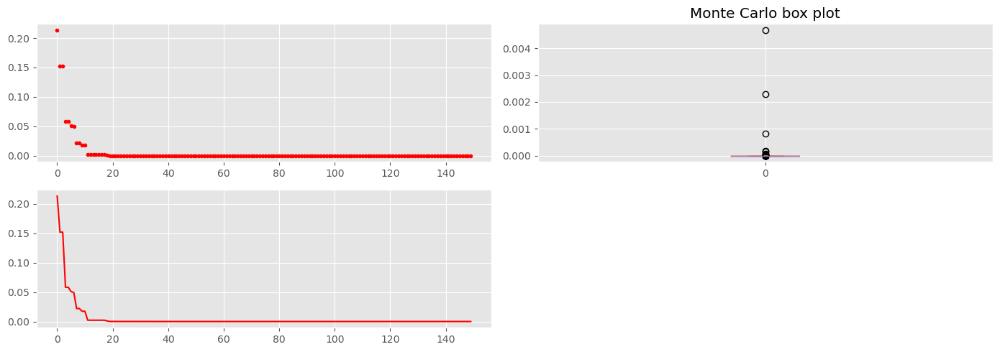

[I 2024-03-14 16:38:21,982] Trial 9 finished with values: [8.309182161028994e-05, 2.7049370344323415e-07, 99.0] and parameters: {'w': 0.036411743019686124}. 


In [70]:
def objective(trial):
    params = {
        "pop": 40,
        'max_iter': 150,
        'w': trial.suggest_float("w", 0.00001, 1.0),
        'c1': 0.5,
        'c2': 0.5,
    }

    # Add a callback for pruning.
    _, mean_result, variance_result, minimum_iter = monte_carlo(rounds, schaffer_n2, 2, PSO, [-100, -100], [100, 100], params, plot=True, log=True)
    return mean_result, variance_result, minimum_iter

study = optuna.create_study(
    directions=["minimize","minimize","minimize"]
)
study.optimize(objective, callbacks=[MaxTrialsCallback(10, states=(TrialState.COMPLETE,))])

/tmp/ipykernel_1461/863184516.py:1: ExperimentalWarning: plot_pareto_front is experimental (supported from v2.8.0). The interface can change in the future.
  plot_pareto_front(study, target_names=["Mean objective", "Var objective", "Minimum iterations"])
/tmp/ipykernel_1461/863184516.py:2: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Mean objective")
/tmp/ipykernel_1461/863184516.py:3: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study, target=lambda t: t.values[1], target_name="Var objective")
/tmp/ipykernel_1461/863184516.py:4: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study, target=lambda t: t.values[2], targe

<Axes: title={'center': 'Parallel Coordinate Plot'}>

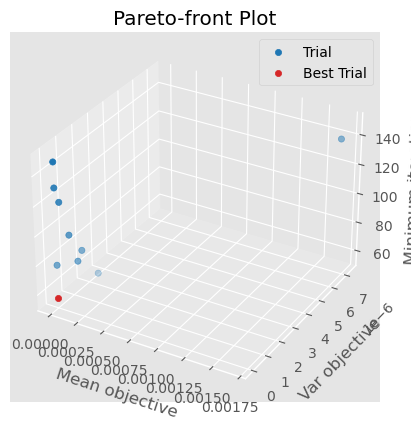

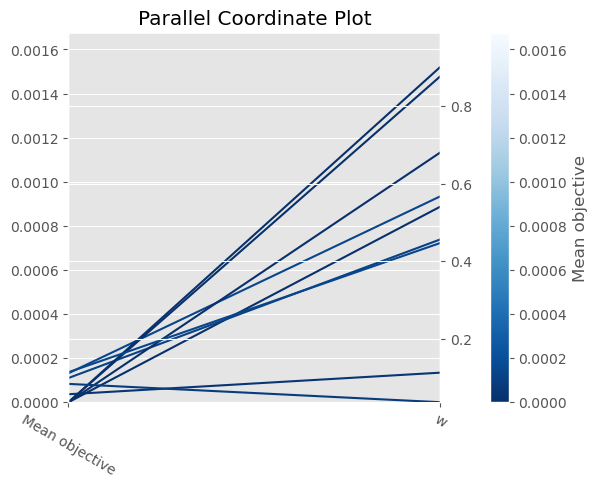

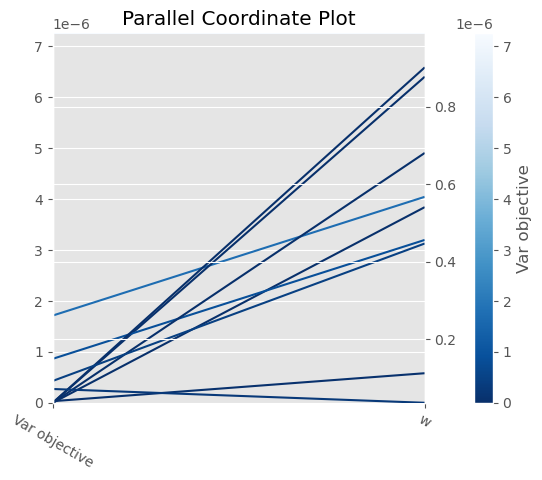

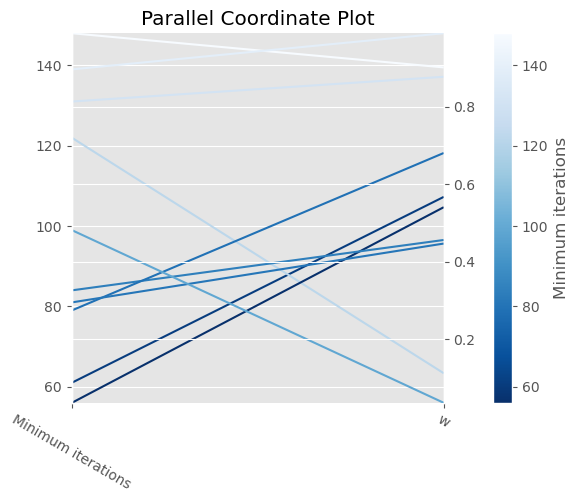

In [71]:
plot_pareto_front(study, target_names=["Mean objective", "Var objective", "Minimum iterations"])
plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Mean objective")
plot_parallel_coordinate(study, target=lambda t: t.values[1], target_name="Var objective")
plot_parallel_coordinate(study, target=lambda t: t.values[2], target_name="Minimum iterations")

Inertia determines the particle's tendency to maintain its current velocity while moving towards better solutions. A high inertia allows particles to maintain their current direction, promoting exploration by enabling them to traverse large areas of the search space. This can help escape local optima and find the global optimum. Conversely, a low inertia encourages exploitation by reducing the particle's velocity, allowing it to converge towards promising solutions found in the vicinity.

In this set of PSO results, the inertia weight (w) was varied while keeping other parameters constant. The trials show that different values of inertia weight lead to variations in the convergence behavior and performance of the PSO algorithm. Lower values of inertia weight (e.g., w = 0.036) tend to exhibit slower convergence, as indicated by higher iteration counts (e.g., Trial 9 with 99 iterations) and larger mean objective function values (e.g., 8.309182161028994e-05). Conversely, higher inertia weights (e.g., w = 0.989) may lead to faster convergence but also show increased variability in convergence behavior, as seen in Trial 7 with 81 iterations and a mean objective function value of 0.00013592989894249175. Moderate values of inertia weight (e.g., w = 0.540) appear to strike a balance between convergence speed and stability, as observed in Trial 3 with 56 iterations and a mean objective function value of 0.00010981297187210525. Comparing these results to the previous ones, where population size was varied, it seems that inertia weight has a more pronounced effect on convergence speed and stability, while population size influences exploration and exploitation trade-offs. 

#### 2.2.4 Varying c1 (personal best)
We will analyze 10 different values for the c1 between 0.01 and 3.0.

[I 2024-03-14 16:38:22,788] A new study created in memory with name: no-name-f3e548a0-31a9-44ee-85fb-b0c21d4594e7


Minimum of objective function: 1.5973888878306752e-12
Minimum found in round: 43
Minimum found in iteration: 147
Mean of objective function: 6.106475032463532e-08
Variance of objective function: 3.25533252760024e-14
Monte Carlo standard error: 1.804254008614153e-08


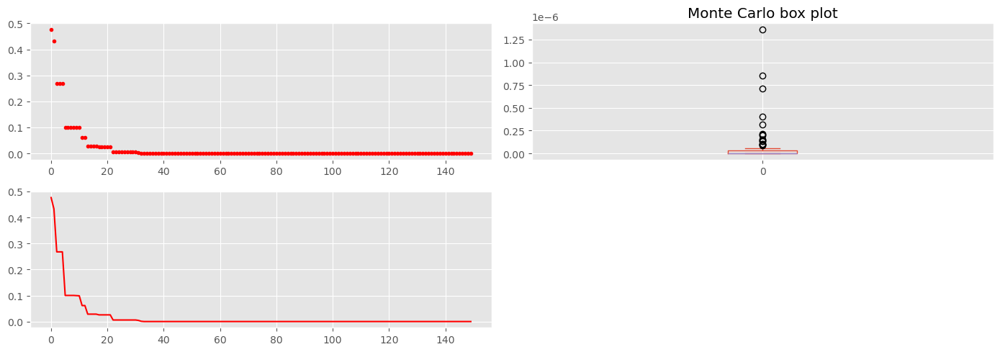

[I 2024-03-14 16:38:27,944] Trial 0 finished with values: [6.106475032463532e-08, 3.25533252760024e-14, 147.0] and parameters: {'c1': 2.5001351601461557}. 


Minimum of objective function: 0.0
Minimum found in round: 0
Minimum found in iteration: 144
Mean of objective function: 2.020605904817785e-16
Variance of objective function: 2.900000599012168e-31
Monte Carlo standard error: 5.3851653633033104e-17


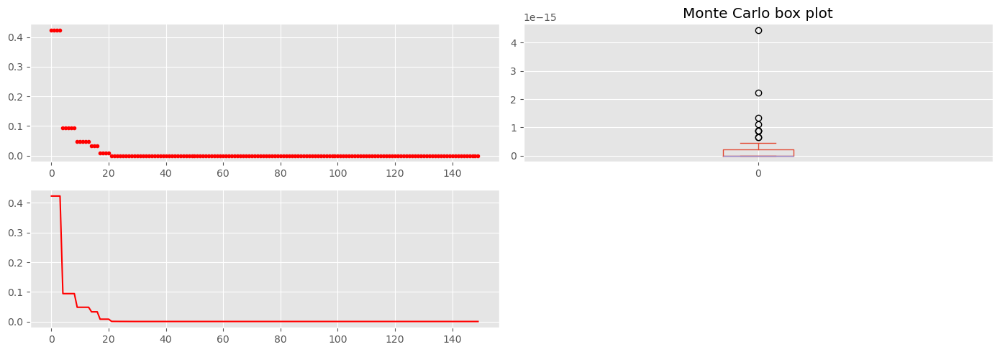

[I 2024-03-14 16:38:32,673] Trial 1 finished with values: [2.020605904817785e-16, 2.900000599012168e-31, 144.0] and parameters: {'c1': 0.9373808280148804}. 


Minimum of objective function: 2.3383517344655047e-12
Minimum found in round: 77
Minimum found in iteration: 132
Mean of objective function: 1.3272251480089814e-06
Variance of objective function: 6.113540469942788e-11
Monte Carlo standard error: 7.81891326844261e-07


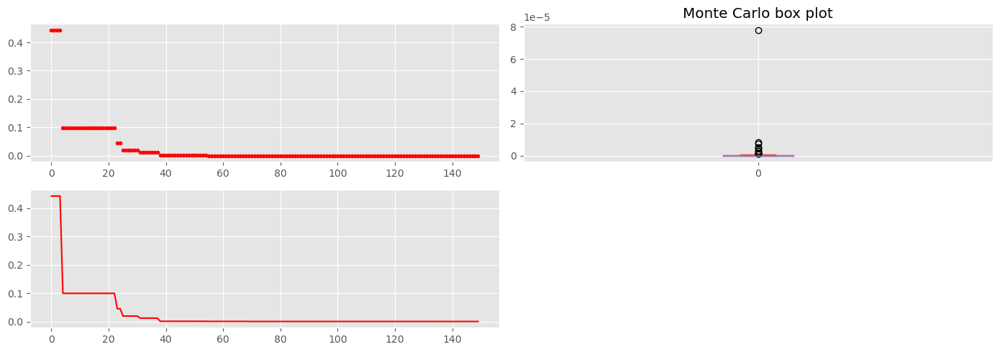

[I 2024-03-14 16:38:37,327] Trial 2 finished with values: [1.3272251480089814e-06, 6.113540469942788e-11, 132.0] and parameters: {'c1': 2.695325146009531}. 


Minimum of objective function: 0.0
Minimum found in round: 49
Minimum found in iteration: 132
Mean of objective function: 1.0789034110558759e-11
Variance of objective function: 6.382350819414856e-22
Monte Carlo standard error: 2.5263314943638844e-12


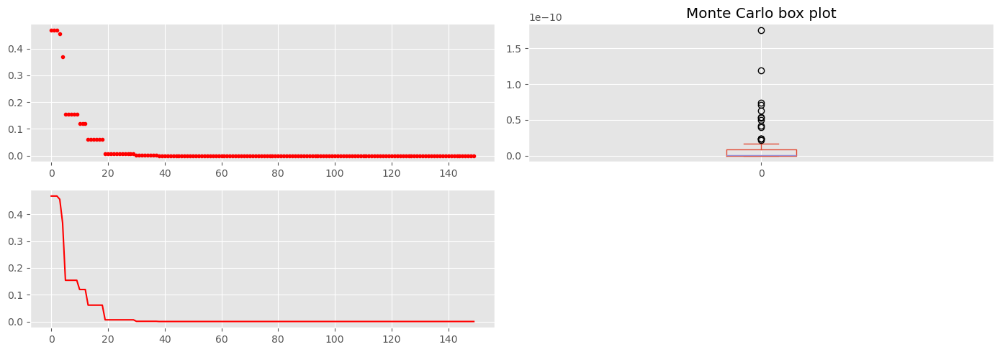

[I 2024-03-14 16:38:42,007] Trial 3 finished with values: [1.0789034110558759e-11, 6.382350819414856e-22, 132.0] and parameters: {'c1': 1.876438428056198}. 


Minimum of objective function: 0.0
Minimum found in round: 0
Minimum found in iteration: 136
Mean of objective function: 3.7747582837255325e-17
Variance of objective function: 1.287322389707539e-32
Monte Carlo standard error: 1.1346023046457902e-17


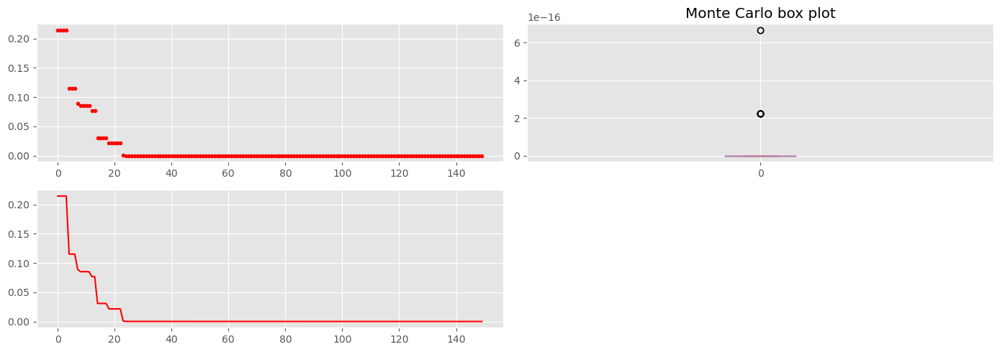

[I 2024-03-14 16:38:46,713] Trial 4 finished with values: [3.7747582837255325e-17, 1.287322389707539e-32, 136.0] and parameters: {'c1': 0.7547824735795112}. 


Minimum of objective function: 0.0
Minimum found in round: 1
Minimum found in iteration: 137
Mean of objective function: 3.1086244689504386e-17
Variance of objective function: 6.922254443314378e-33
Monte Carlo standard error: 8.320008679871902e-18


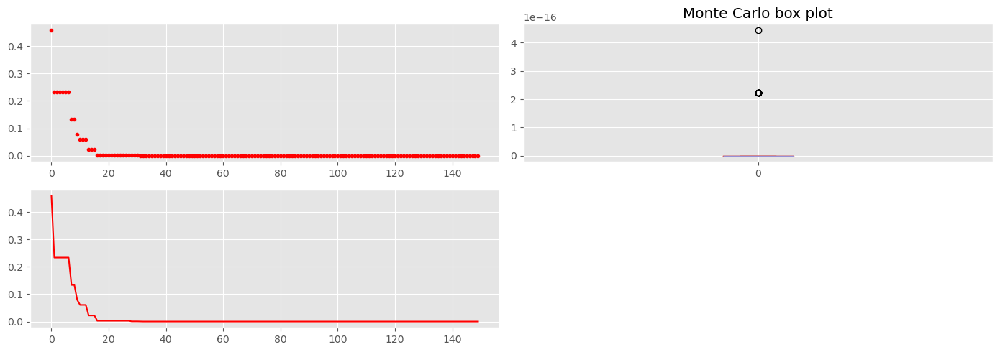

[I 2024-03-14 16:38:51,497] Trial 5 finished with values: [3.1086244689504386e-17, 6.922254443314378e-33, 137.0] and parameters: {'c1': 0.7733930813040362}. 


Minimum of objective function: 3.808064974464287e-13
Minimum found in round: 8
Minimum found in iteration: 148
Mean of objective function: 5.047188253448631e-09
Variance of objective function: 2.3622348299597483e-16
Monte Carlo standard error: 1.5369563526527836e-09


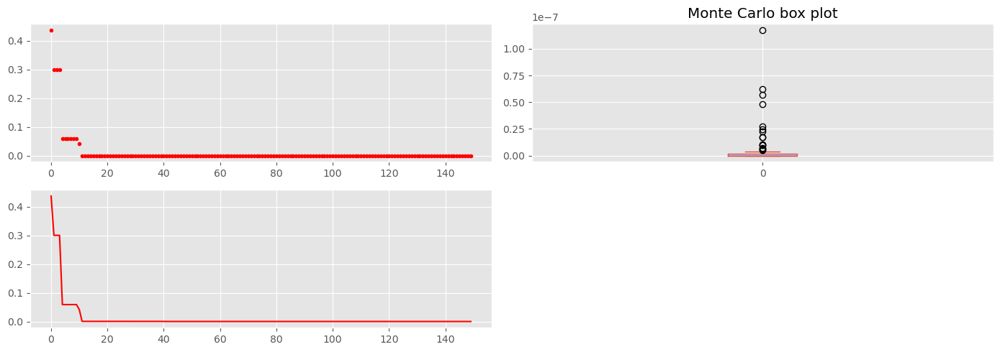

[I 2024-03-14 16:38:56,192] Trial 6 finished with values: [5.047188253448631e-09, 2.3622348299597483e-16, 148.0] and parameters: {'c1': 2.32896297872225}. 


Minimum of objective function: 1.8018087022397822e-11
Minimum found in round: 83
Minimum found in iteration: 139
Mean of objective function: 3.93461473931378e-06
Variance of objective function: 2.7189302297169845e-10
Monte Carlo standard error: 1.6489178965967302e-06


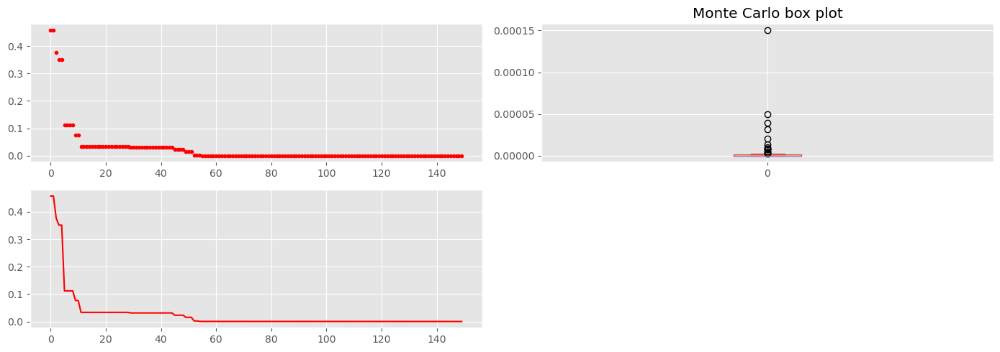

[I 2024-03-14 16:39:00,970] Trial 7 finished with values: [3.93461473931378e-06, 2.7189302297169845e-10, 139.0] and parameters: {'c1': 2.7652742918260667}. 


Minimum of objective function: 0.0
Minimum found in round: 0
Minimum found in iteration: 139
Mean of objective function: 1.3322676295501878e-17
Variance of objective function: 2.780734690904066e-33
Monte Carlo standard error: 5.273267194922012e-18


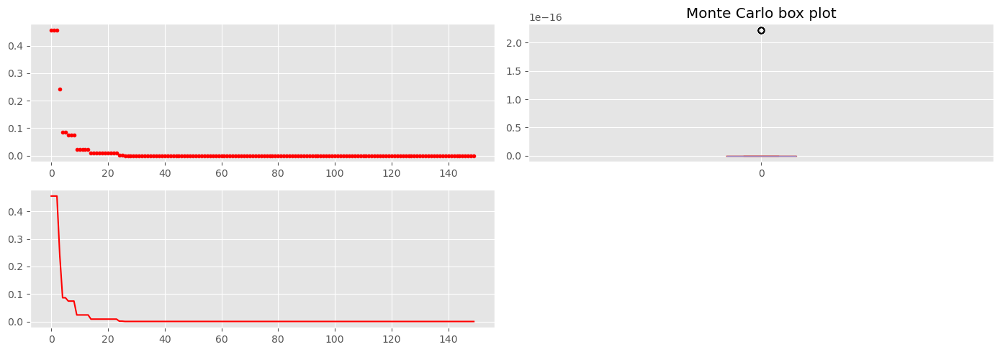

[I 2024-03-14 16:39:05,724] Trial 8 finished with values: [1.3322676295501878e-17, 2.780734690904066e-33, 139.0] and parameters: {'c1': 0.43521229031490066}. 


Minimum of objective function: 2.893241202173158e-13
Minimum found in round: 61
Minimum found in iteration: 142
Mean of objective function: 4.894911729946827e-08
Variance of objective function: 2.439377871958184e-14
Monte Carlo standard error: 1.5618507841526297e-08


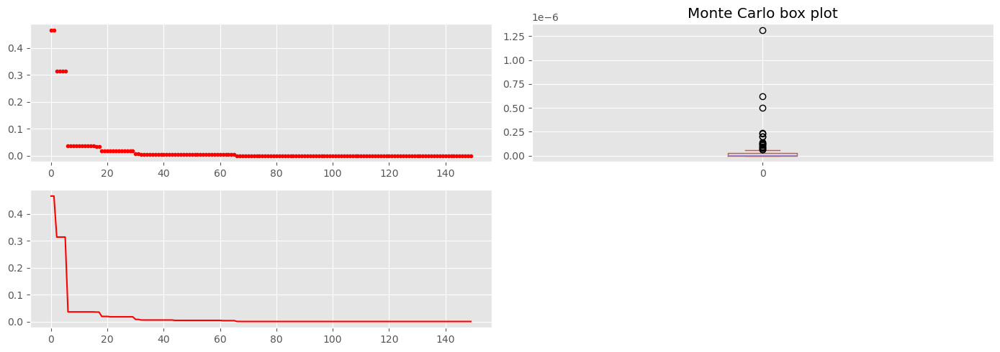

[I 2024-03-14 16:39:10,492] Trial 9 finished with values: [4.894911729946827e-08, 2.439377871958184e-14, 142.0] and parameters: {'c1': 2.4881798408583826}. 


In [72]:
def objective(trial):
    params = {
        "pop": 40,
        'max_iter': 150,
        'w': 0.8,
        'c1': trial.suggest_float("c1", 0.01, 3.0),
        'c2': 0.5,
    }

    # Add a callback for pruning.
    _, mean_result, variance_result, minimum_iter = monte_carlo(rounds, schaffer_n2, 2, PSO, [-100, -100], [100, 100], params, plot=True, log=True)
    return mean_result, variance_result, minimum_iter

study = optuna.create_study(
    directions=["minimize","minimize","minimize"]
)
study.optimize(objective, callbacks=[MaxTrialsCallback(10, states=(TrialState.COMPLETE,))])

/tmp/ipykernel_1461/863184516.py:1: ExperimentalWarning: plot_pareto_front is experimental (supported from v2.8.0). The interface can change in the future.
  plot_pareto_front(study, target_names=["Mean objective", "Var objective", "Minimum iterations"])
/tmp/ipykernel_1461/863184516.py:2: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Mean objective")
/tmp/ipykernel_1461/863184516.py:3: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study, target=lambda t: t.values[1], target_name="Var objective")
/tmp/ipykernel_1461/863184516.py:4: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study, target=lambda t: t.values[2], targe

<Axes: title={'center': 'Parallel Coordinate Plot'}>

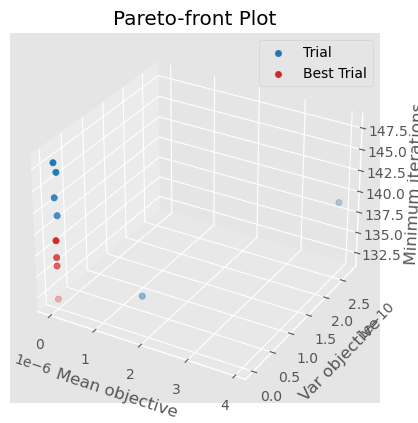

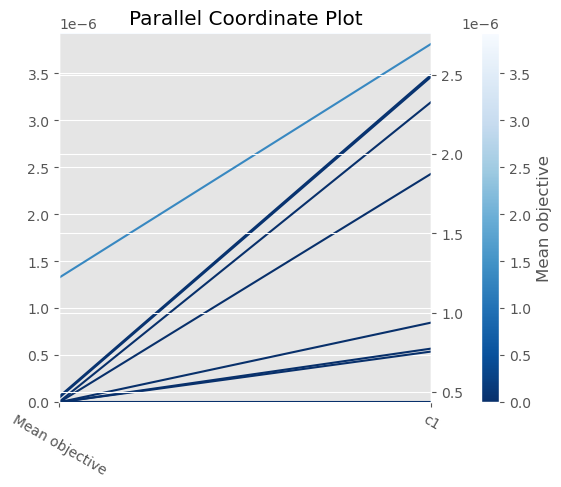

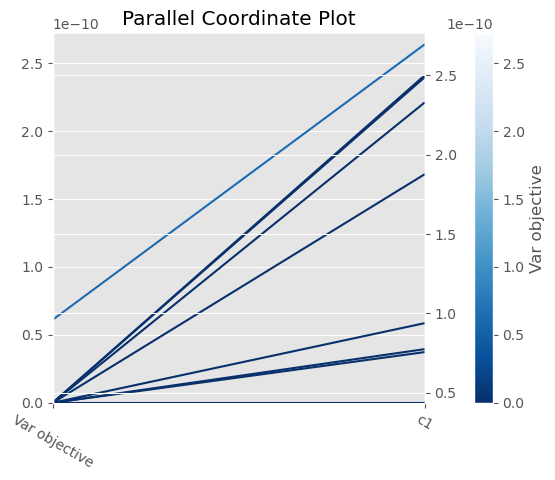

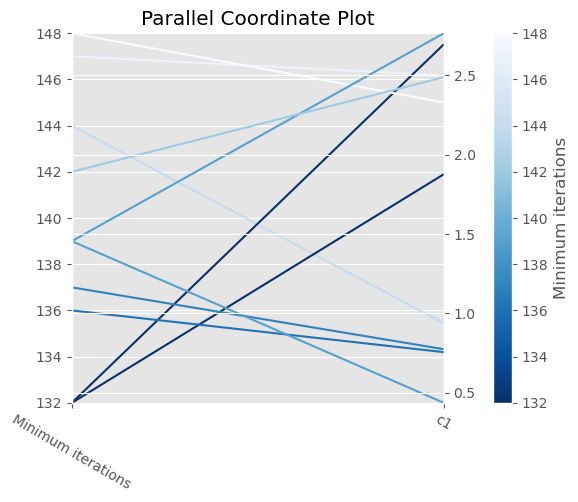

In [73]:
plot_pareto_front(study, target_names=["Mean objective", "Var objective", "Minimum iterations"])
plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Mean objective")
plot_parallel_coordinate(study, target=lambda t: t.values[1], target_name="Var objective")
plot_parallel_coordinate(study, target=lambda t: t.values[2], target_name="Minimum iterations")

The personal best control value in PSO determines the influence of a particle's historical best position on its movement in the search space. A higher personal best control value gives more weight to the particle's historical best position, causing it to be more conservative and exploitative in its exploration. This means that particles tend to converge towards their individual best-known solutions, leading to more exploitation of promising regions in the search space. Conversely, a lower personal best control value makes the particle's movement more explorative, as it relies less on its historical best position and explores the search space more extensively.

Since the problem complexity is not too high is difficult to obtain interesting insights from the results as the algorithm converges successfully to the global minimum in almost all cases.

#### 2.2.5 Varying c2 (global best)
We will analyze 10 different values for the c2 between 0.01 and 3.0.

[I 2024-03-14 16:39:11,284] A new study created in memory with name: no-name-00cdec02-5cf8-44ad-b074-b40db6c9343f


Minimum of objective function: 1.13464793116691e-13
Minimum found in round: 87
Minimum found in iteration: 142
Mean of objective function: 2.9876498441883116e-10
Variance of objective function: 2.5567970589526604e-19
Monte Carlo standard error: 5.0564780815827337e-11


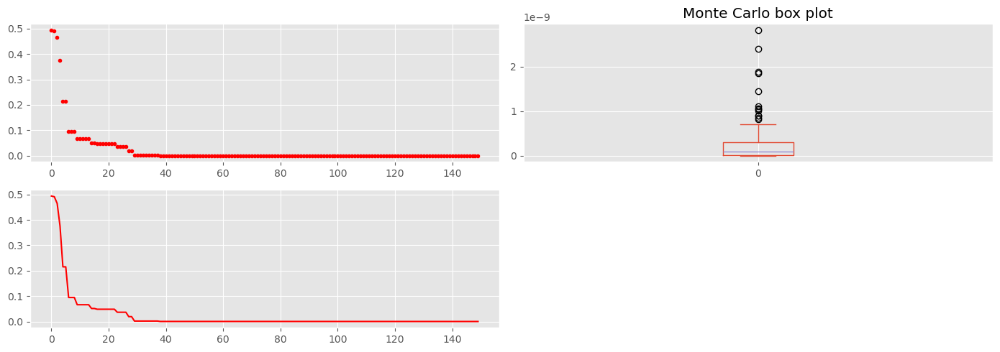

[I 2024-03-14 16:39:15,996] Trial 0 finished with values: [2.9876498441883116e-10, 2.5567970589526604e-19, 142.0] and parameters: {'c1': 2.0261932823262}. 


Minimum of objective function: 8.215650382226158e-15
Minimum found in round: 75
Minimum found in iteration: 149
Mean of objective function: 1.7125176832166745e-11
Variance of objective function: 5.588812211095799e-21
Monte Carlo standard error: 7.475835880418858e-12


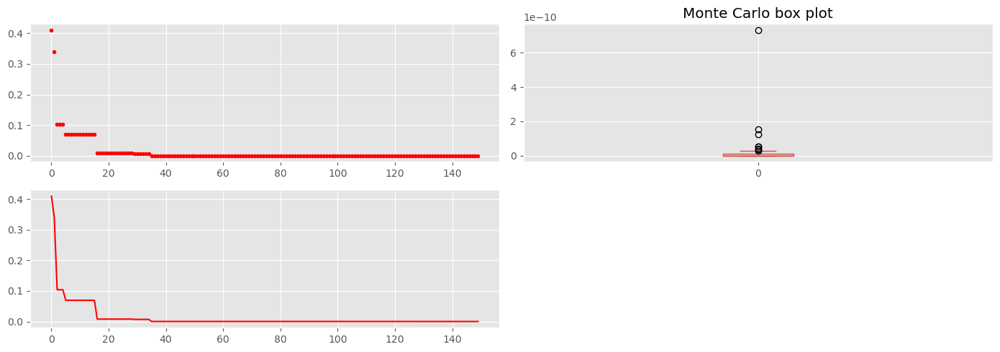

[I 2024-03-14 16:39:20,712] Trial 1 finished with values: [1.7125176832166745e-11, 5.588812211095799e-21, 149.0] and parameters: {'c1': 1.7055414261727553}. 


Minimum of objective function: 0.0
Minimum found in round: 36
Minimum found in iteration: 147
Mean of objective function: 9.29478716216181e-15
Variance of objective function: 2.325305766012572e-28
Monte Carlo standard error: 1.524895329526775e-15


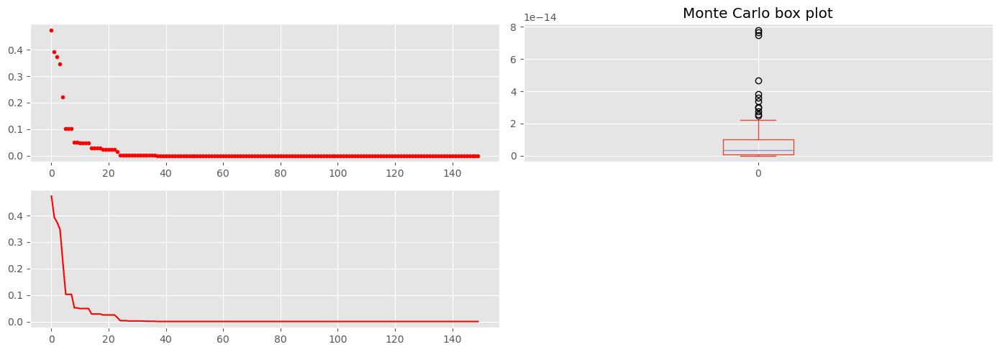

[I 2024-03-14 16:39:25,425] Trial 2 finished with values: [9.29478716216181e-15, 2.325305766012572e-28, 147.0] and parameters: {'c1': 1.1471644740563534}. 


Minimum of objective function: 2.4424906541753444e-15
Minimum found in round: 80
Minimum found in iteration: 149
Mean of objective function: 8.971698939319595e-12
Variance of objective function: 5.167170919352708e-22
Monte Carlo standard error: 2.2731412009271903e-12


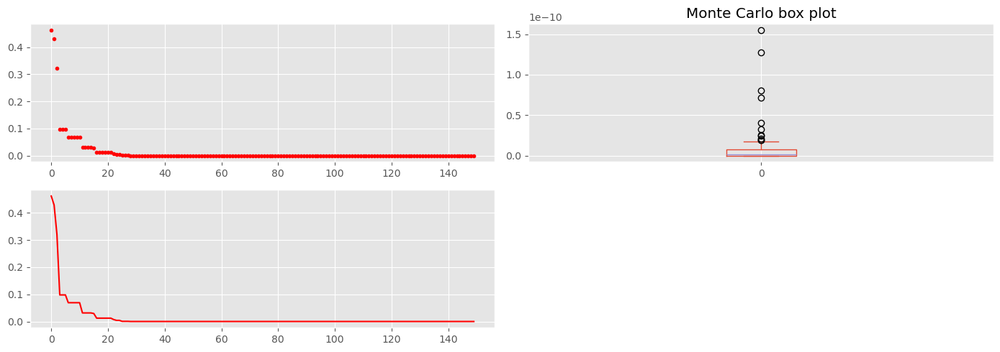

[I 2024-03-14 16:39:30,164] Trial 3 finished with values: [8.971698939319595e-12, 5.167170919352708e-22, 149.0] and parameters: {'c1': 1.6922473369486433}. 


Minimum of objective function: 2.3097107559877372e-10
Minimum found in round: 98
Minimum found in iteration: 138
Mean of objective function: 3.2166481931272805e-07
Variance of objective function: 4.0821005982737426e-13
Monte Carlo standard error: 6.389131864560117e-08


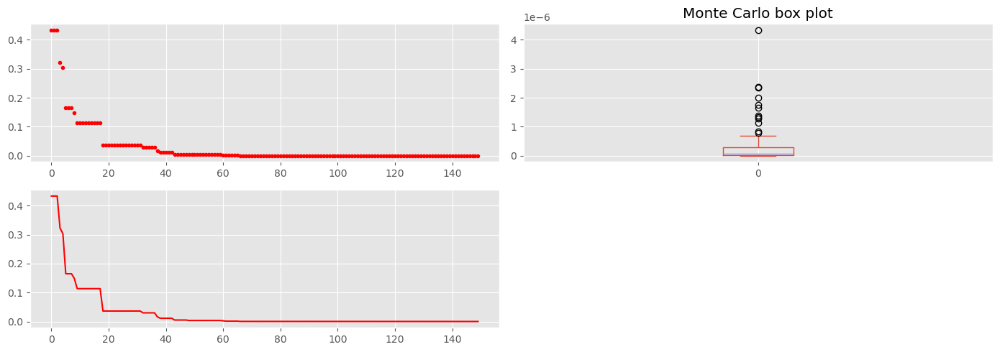

[I 2024-03-14 16:39:34,858] Trial 4 finished with values: [3.2166481931272805e-07, 4.0821005982737426e-13, 138.0] and parameters: {'c1': 2.6628411420815694}. 


Minimum of objective function: 0.0
Minimum found in round: 86
Minimum found in iteration: 145
Mean of objective function: 1.308797514809612e-13
Variance of objective function: 9.058788580865674e-26
Monte Carlo standard error: 3.009782148406372e-14


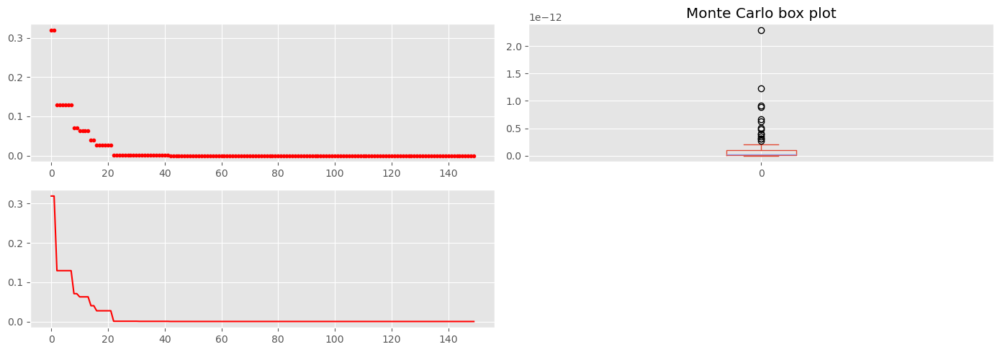

[I 2024-03-14 16:39:39,550] Trial 5 finished with values: [1.308797514809612e-13, 9.058788580865674e-26, 145.0] and parameters: {'c1': 1.348595905976852}. 


Minimum of objective function: 0.0
Minimum found in round: 61
Minimum found in iteration: 134
Mean of objective function: 3.12017078840654e-14
Variance of objective function: 3.7055118730305436e-27
Monte Carlo standard error: 6.0872915759231906e-15


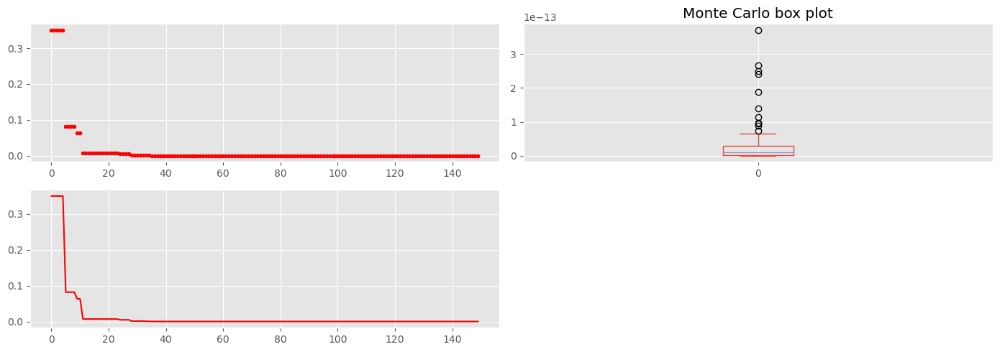

[I 2024-03-14 16:39:44,286] Trial 6 finished with values: [3.12017078840654e-14, 3.7055118730305436e-27, 134.0] and parameters: {'c1': 1.238167624960399}. 


Minimum of objective function: 0.0
Minimum found in round: 35
Minimum found in iteration: 149
Mean of objective function: 1.0494954905126974e-12
Variance of objective function: 5.438513781516329e-24
Monte Carlo standard error: 2.332062130715288e-13


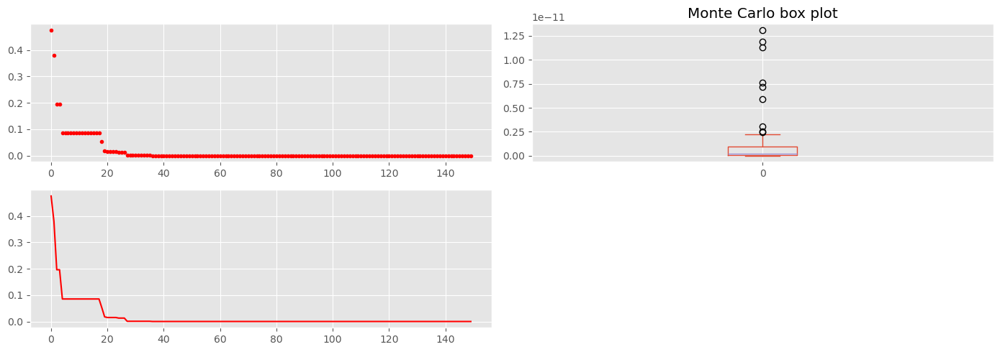

[I 2024-03-14 16:39:49,468] Trial 7 finished with values: [1.0494954905126974e-12, 5.438513781516329e-24, 149.0] and parameters: {'c1': 1.5411723039441174}. 


Minimum of objective function: 0.0
Minimum found in round: 0
Minimum found in iteration: 137
Mean of objective function: 1.1102230246251565e-16
Variance of objective function: 3.7963931063761194e-32
Monte Carlo standard error: 1.9484335006297033e-17


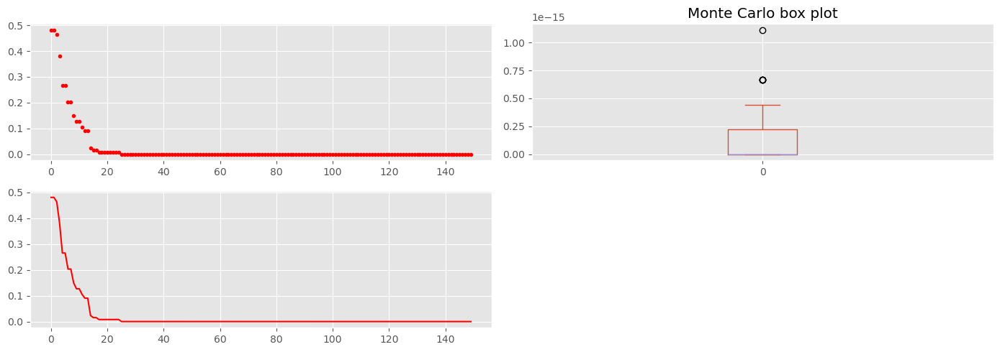

[I 2024-03-14 16:39:54,158] Trial 8 finished with values: [1.1102230246251565e-16, 3.7963931063761194e-32, 137.0] and parameters: {'c1': 0.7258788869956634}. 


Minimum of objective function: 0.0
Minimum found in round: 17
Minimum found in iteration: 146
Mean of objective function: 4.11226608321158e-15
Variance of objective function: 1.4754901702908117e-28
Monte Carlo standard error: 1.2146975633015865e-15


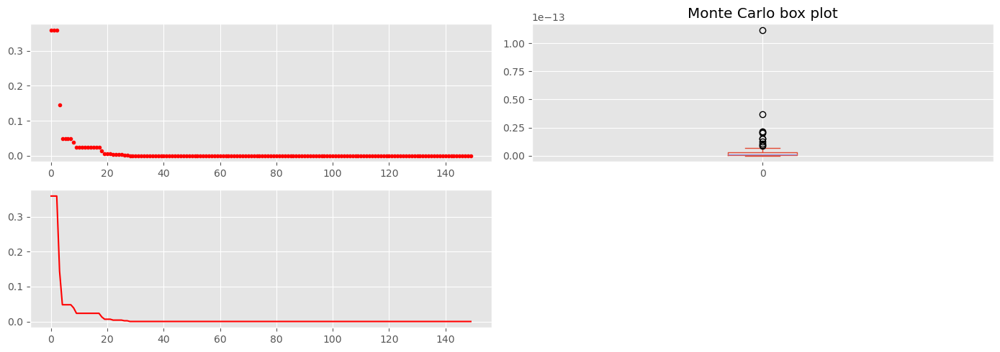

[I 2024-03-14 16:39:58,998] Trial 9 finished with values: [4.11226608321158e-15, 1.4754901702908117e-28, 146.0] and parameters: {'c1': 1.0492728751119034}. 


In [74]:
def objective(trial):
    params = {
        "pop": 40,
        'max_iter': 150,
        'w': 0.8,
        'c1': 0.5,
        'c2': trial.suggest_float("c1", 0.01, 3.0),
    }

    # Add a callback for pruning.
    _, mean_result, variance_result, minimum_iter = monte_carlo(rounds, schaffer_n2, 2, PSO, [-100, -100], [100, 100], params, plot=True, log=True)
    return mean_result, variance_result, minimum_iter

study = optuna.create_study(
    directions=["minimize","minimize","minimize"]
)
study.optimize(objective, callbacks=[MaxTrialsCallback(10, states=(TrialState.COMPLETE,))])

/tmp/ipykernel_1461/863184516.py:1: ExperimentalWarning: plot_pareto_front is experimental (supported from v2.8.0). The interface can change in the future.
  plot_pareto_front(study, target_names=["Mean objective", "Var objective", "Minimum iterations"])
/tmp/ipykernel_1461/863184516.py:2: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Mean objective")
/tmp/ipykernel_1461/863184516.py:3: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study, target=lambda t: t.values[1], target_name="Var objective")
/tmp/ipykernel_1461/863184516.py:4: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study, target=lambda t: t.values[2], targe

<Axes: title={'center': 'Parallel Coordinate Plot'}>

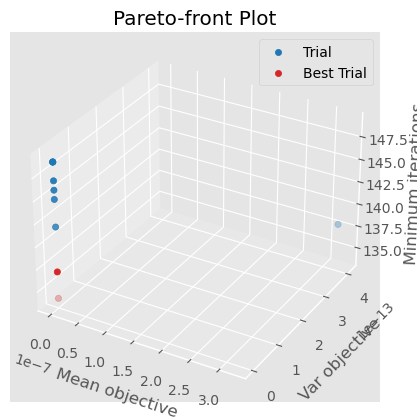

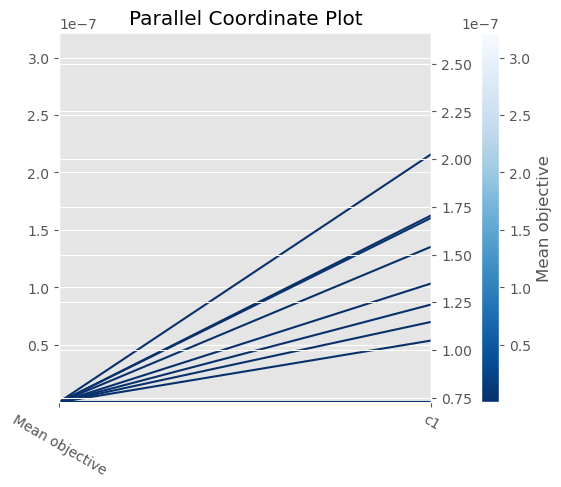

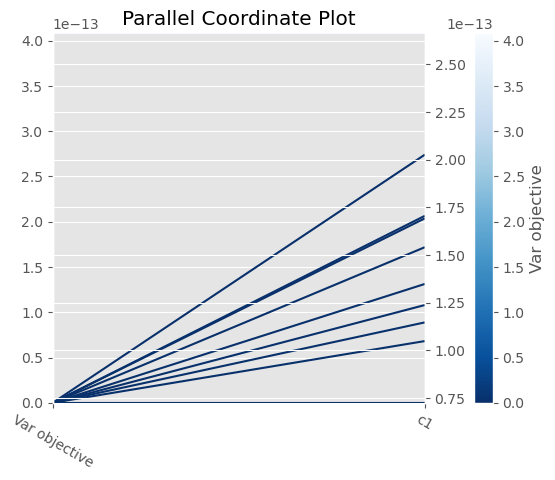

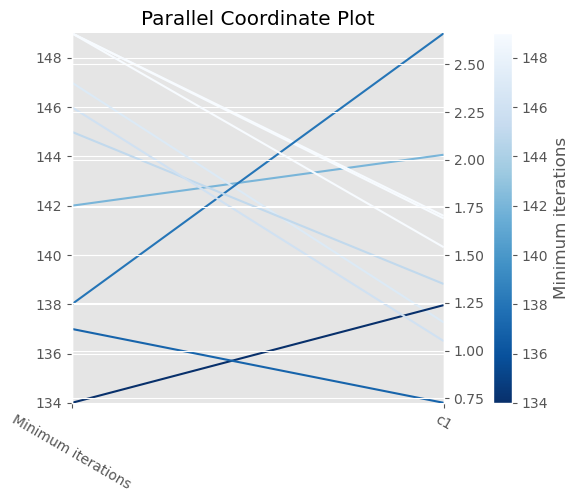

In [75]:
plot_pareto_front(study, target_names=["Mean objective", "Var objective", "Minimum iterations"])
plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Mean objective")
plot_parallel_coordinate(study, target=lambda t: t.values[1], target_name="Var objective")
plot_parallel_coordinate(study, target=lambda t: t.values[2], target_name="Minimum iterations")

The global best control value represents the impact of the best solution found by any particle in the swarm on the movement of all other particles. A higher value encourages greater exploration of the search space as particles are more influenced by the best solution found globally, promoting convergence towards promising regions. Conversely, a lower value promotes exploitation, focusing the particles on refining their search around the current best solution. The choice thus affects the balance between exploration and exploitation in the optimization process, with higher values favoring exploration and lower values favoring exploitation.

Again since the problem complexity is not too high is difficult to obtain interesting insights from the results as the algorithm converges successfully to the global minimum in almost all cases.

#### 2.2.6 Looking for the best parameter set
Now we are going to explore combinations of the previous tested parameters trying to find the best ones (most stable and quick to converge). We will carry out 100 experiments. The aim with this search is minimize the mean of objective function and the minimum iterations required to converge so we will carry out a **Multi–objective optimization**.

In [78]:
def objective(trial):
    params = {
        "pop": trial.suggest_int("pop", 5, 500),
        'max_iter': 200,
        'w': trial.suggest_float("w", 0.00001, 1.0),
        'c1': trial.suggest_float("c1", 0.01, 3.0),
        'c2': trial.suggest_float("c2", 0.01, 3.0),
    }

    # Add a callback for pruning.
    _, mean_result, _, minimum_iter = monte_carlo(rounds, schaffer_n2, 2, PSO, [-100, -100], [100, 100], params, log=False)
    return mean_result, minimum_iter

In [79]:
study = optuna.create_study(
    directions=["minimize","minimize"]
)
study.optimize(objective, callbacks=[MaxTrialsCallback(100, states=(TrialState.COMPLETE,))])

[I 2024-03-14 16:48:51,869] A new study created in memory with name: no-name-2d01cc13-7955-45b4-b5fb-6fb6cff999e4
[I 2024-03-14 16:49:53,139] Trial 0 finished with values: [0.0, 71.0] and parameters: {'pop': 469, 'w': 0.3425887575717802, 'c1': 0.2430442074418653, 'c2': 0.2761273453789225}. 
[I 2024-03-14 16:49:58,523] Trial 1 finished with values: [7.793765632868598e-16, 149.0] and parameters: {'pop': 36, 'w': 0.7039639507771304, 'c1': 0.6881090259726925, 'c2': 0.22413828388736562}. 
[I 2024-03-14 16:50:17,490] Trial 2 finished with values: [0.00018305675972714485, 199.0] and parameters: {'pop': 140, 'w': 0.26537615342106574, 'c1': 1.6379199659212031, 'c2': 0.22852021443876266}. 
[I 2024-03-14 16:50:59,183] Trial 3 finished with values: [3.1086244689504386e-17, 179.0] and parameters: {'pop': 322, 'w': 0.7921626898779953, 'c1': 1.0352193983932176, 'c2': 1.819963845147132}. 
[I 2024-03-14 16:51:57,614] Trial 4 finished with values: [1.5765166949677222e-16, 166.0] and parameters: {'pop': 

/tmp/ipykernel_1461/3439327190.py:1: ExperimentalWarning: plot_pareto_front is experimental (supported from v2.8.0). The interface can change in the future.
  plot_pareto_front(study, target_names=["Mean objective", "Minimum iterations"])
/tmp/ipykernel_1461/3439327190.py:2: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Mean objective")
/tmp/ipykernel_1461/3439327190.py:3: ExperimentalWarning: plot_param_importances is experimental (supported from v2.2.0). The interface can change in the future.
  plot_param_importances(study, target=lambda t: t.values[0], target_name="Mean objective")
/tmp/ipykernel_1461/3439327190.py:4: ExperimentalWarning: plot_contour is experimental (supported from v2.2.0). The interface can change in the future.
  plot_contour(study, target=lambda t: t.values[0], target_name="Mean objective")
[W 2024-03-14 1

array([[<Axes: ylabel='c1'>, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: ylabel='c2'>, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: ylabel='pop'>, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: xlabel='c1', ylabel='w'>, <Axes: xlabel='c2'>,
        <Axes: xlabel='pop'>, <Axes: xlabel='w'>]], dtype=object)

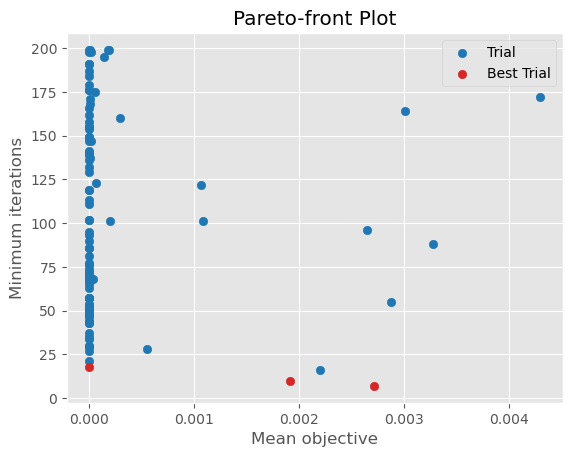

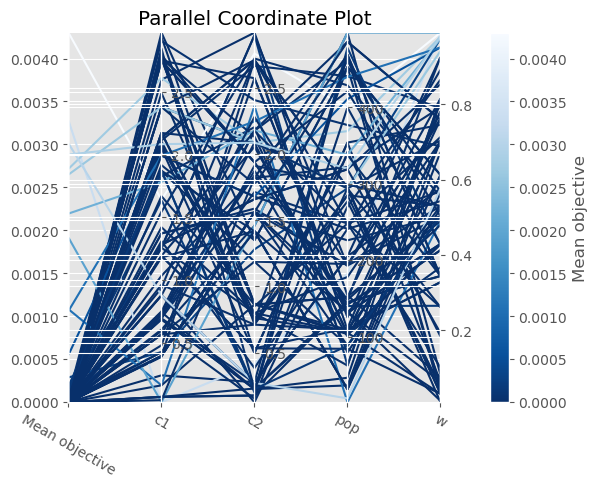

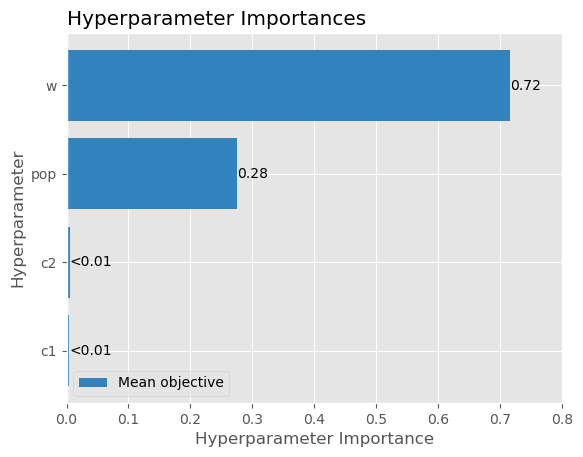

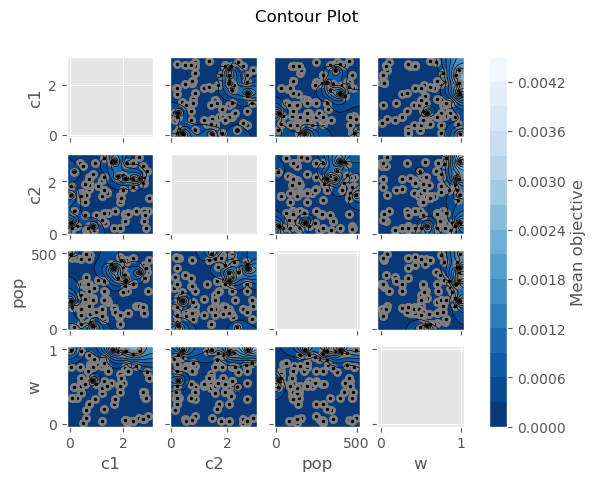

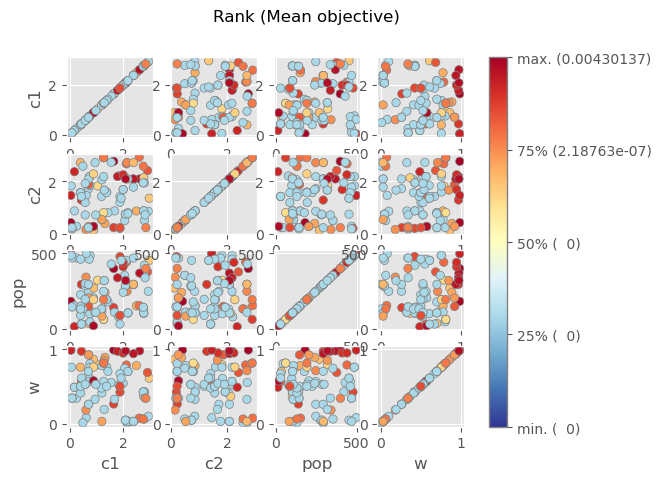

In [80]:
plot_pareto_front(study, target_names=["Mean objective", "Minimum iterations"])
plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Mean objective")
plot_param_importances(study, target=lambda t: t.values[0], target_name="Mean objective")
plot_contour(study, target=lambda t: t.values[0], target_name="Mean objective")
plot_rank(study, target=lambda t: t.values[0], target_name="Mean objective")

In [81]:
# Show the best trials.
for trial in study.best_trials:
    print("Params: ",trial.params, "- Results (mean, iter_cov):",trial.values)  

Params:  {'pop': 498, 'w': 0.08226738195182977, 'c1': 0.607547412999876, 'c2': 1.4584377809310707} Results (mean, var, iter_cov): [0.0, 18.0]
Params:  {'pop': 369, 'w': 0.9792363790606279, 'c1': 2.6098810652794406, 'c2': 2.086531823244361} Results (mean, var, iter_cov): [0.0027154662356024084, 7.0]
Params:  {'pop': 498, 'w': 0.9900667026162694, 'c1': 0.02901408017846193, 'c2': 1.4584377809310707} Results (mean, var, iter_cov): [0.001915803686185949, 10.0]


Previously we saw that the best parameters were **{'pop': 20, 'max_iter': 50, 'w': 0.0001, 'c1':0.1, 'c2': 2.5}** using the grid search approach. Using the Optuna optimization we carried out a multi-objective optimization minimizing the mean of objective function and the minimum iterations required to converge and then we look for Pareto-optimal solutions (shown in the previous cell). The set of parameters **{'pop': 498, 'w': 0.08226738195182977, 'c1': 0.607547412999876, 'c2': 1.4584377809310707}** provides a really good performance with a mean of objective function of 0.0 (completely stable) and a minimum of iterations to converge of 18 (high velocity), being the best solution found so far for this problem.

The other 2 parameter sets also offer good results with low mean of objective functions and slightly quicker convergence but since we prefer stability over velocity we select the first one.

Regarding the parameters importance we can extract the following insights:
- **Inertia Weight** (w): With a relatively high importance value of 0.72, the inertia weight plays a significant role in the optimization process. A high inertia weight enables particles to maintain their current direction, facilitating exploration of the search space. However, too high a value might hinder convergence, while too low a value may limit exploration. The last two plots show that values close to 1 are too high for our problem since the results are quite worse in terms of mean of objective function.

- **Population Size** (pop): The population size, with an importance value of 0.28, also influences optimization effectiveness. A larger population size generally enhances exploration by providing a diverse set of solutions. However, larger populations may lead to increased computational costs. This result suggests that while population size is not as critical as inertia weight, it still deserves attention during optimization parameter tuning. The best results seem to be obtained when using high values of population size.

- **Acceleration Constants** (c1 and c2): Interestingly, both personal best (c1) and global best (c2) acceleration constants have very low importance values (<0.01). This implies that their impact on PSO's performance in optimizing the Schaffer function is minimal within the tested range. These constants determine the influence of the particle's own best position and the global best position on its movement.

### BEST PARAMETER SET FOR MINIMIZING SCHAFFER-FUNCTION N.2 RESULTS

Minimum of objective function: 0.0
Minimum found in round: 0
Minimum found in iteration: 11
Mean of objective function: 0.0
Variance of objective function: 0.0
Monte Carlo standard error: 0.0


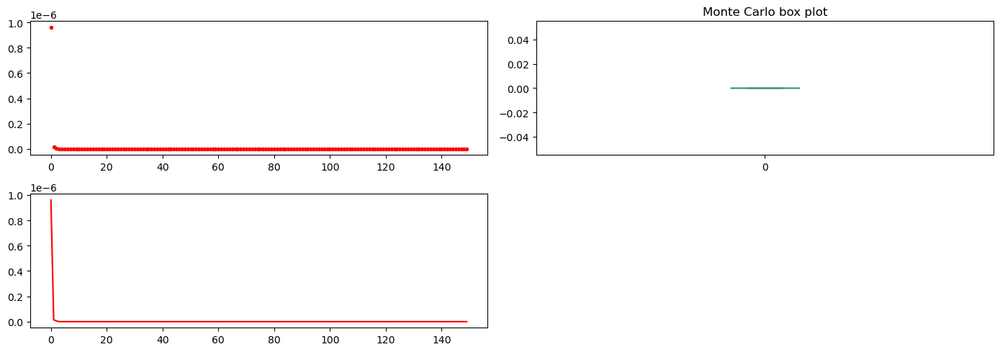

In [9]:
params = {'pop': 498, 'w': 0.08226738195182977, 'c1': 0.607547412999876, 'c2': 1.4584377809310707}
results = monte_carlo(rounds, schaffer_n2, 2, PSO, [-100, -100], [100, 100], params, plot=True)

#### 2.3. Minimize Schaffer-function N.4 using grid search
Let's focus our attention now in the Schaffer-function N.4. We will perform again a grid search over a set of parameters for each Schaffer-function over the Genetic algorithm. Since in the literature it is usually evaluated on the square xi ∈ [-100, 100], for all i = 1, 2, we will define a search area (lower and upper bounds) in that range. Recall that the global minimum has a value of value 0.292579.

In [8]:
# Define the parameter grid for PSO
PSO_param_grid = {
    'pop': [20, 50, 100, 500],
    'max_iter': [800],
    'w': [0.0001, 0.001, 0.01],
    'c1': [0.1, 0.5, 2.5],
    'c2': [0.1, 0.5, 2.5]
}

# Perform grid search for PSO
best_params_n4 = None
best_mean_result = float('inf')

for pop in PSO_param_grid['pop']:
    for max_iter in PSO_param_grid['max_iter']:
        for w in PSO_param_grid['w']:
            for c1 in PSO_param_grid['c1']:
                for c2 in PSO_param_grid['c2']:
                    params = {'pop': pop, 'max_iter': max_iter, 'w': w, 'c1':c1, 'c2':c2}
                    print("Testing params",params)
                    best_PSO, mean_result = monte_carlo(rounds, schaffer_n4, 2, PSO, [-100, -100], [100, 100], params)
                    
                    if mean_result < best_mean_result:
                        best_mean_result = mean_result
                        best_params_n4 = params

                    print()

print("Best Parameters:", best_params_n4)
print("Best Mean Objective Function Value:", best_mean_result)

Testing params {'pop': 20, 'max_iter': 800, 'w': 0.0001, 'c1': 0.1, 'c2': 0.1}
Minimum of objective function: 0.2925793695128004
Minimum found in round: 7
Mean of objective function: 0.29279636207458354
Variance of objective function: 6.580032559628526e-08
Monte Carlo standard error: 8.111739985741977e-05

Testing params {'pop': 20, 'max_iter': 800, 'w': 0.0001, 'c1': 0.1, 'c2': 0.5}
Minimum of objective function: 0.292578916487875
Minimum found in round: 2
Mean of objective function: 0.2942087568905485
Variance of objective function: 5.4146790487563905e-06
Monte Carlo standard error: 0.0007358450277576379

Testing params {'pop': 20, 'max_iter': 800, 'w': 0.0001, 'c1': 0.1, 'c2': 2.5}
Minimum of objective function: 0.2925786320359804
Minimum found in round: 9
Mean of objective function: 0.29531568807331554
Variance of objective function: 2.6237557318519398e-05
Monte Carlo standard error: 0.0016198011396007658

Testing params {'pop': 20, 'max_iter': 800, 'w': 0.0001, 'c1': 0.5, 'c2': 0.

The best parameters found are **{'pop': 50, 'max_iter': 800, 'w': 0.0001, 'c1': 0.1, 'c2': 2.5}**, with a mean and variance of objective function values of 0.292584 and 2.15e-33 respectively across the different Monte Carlo rounds. This implies that the system is almost perfectly balanced as it achieved to reach the global minimal solution (0.292579) in almost every round.

In [11]:
# Define the parameter grid for PSO
PSO_param_grid = {
    'pop': [50],
    'max_iter': [10,50,100,500,800],
    'w': [0.0001],
    'c1': [0.1],
    'c2': [2.5]
}

# Perform grid search for PSO
best_params_n4 = None
best_mean_result = float('inf')

for pop in PSO_param_grid['pop']:
    for max_iter in PSO_param_grid['max_iter']:
        for w in PSO_param_grid['w']:
            for c1 in PSO_param_grid['c1']:
                for c2 in PSO_param_grid['c2']:
                    params = {'pop': pop, 'max_iter': max_iter, 'w': w, 'c1':c1, 'c2':c2}
                    print("Testing params",params)
                    best_PSO, mean_result = monte_carlo(rounds, schaffer_n4, 2, PSO, [-100, -100], [100, 100], params)
                    
                    if mean_result < best_mean_result:
                        best_mean_result = mean_result
                        best_params_n4 = params

                    print()

print("Best Parameters:", best_params_n4)
print("Best Mean Objective Function Value:", best_mean_result)

Testing params {'pop': 50, 'max_iter': 10, 'w': 0.0001, 'c1': 0.1, 'c2': 2.5}
Minimum of objective function: 0.2925830641283696
Minimum found in round: 4
Mean of objective function: 0.29406721146430753
Variance of objective function: 3.118332713321531e-06
Monte Carlo standard error: 0.0005584203357079263

Testing params {'pop': 50, 'max_iter': 50, 'w': 0.0001, 'c1': 0.1, 'c2': 2.5}
Minimum of objective function: 0.2925786320359804
Minimum found in round: 3
Mean of objective function: 0.2927081447135144
Variance of objective function: 1.5096180277816535e-07
Monte Carlo standard error: 0.00012286651406228036

Testing params {'pop': 50, 'max_iter': 100, 'w': 0.0001, 'c1': 0.1, 'c2': 2.5}
Minimum of objective function: 0.29257863203598033
Minimum found in round: 6
Mean of objective function: 0.2925786320359804
Variance of objective function: 4.005934284325451e-33
Monte Carlo standard error: 2.0014830212433607e-17

Testing params {'pop': 50, 'max_iter': 500, 'w': 0.0001, 'c1': 0.1, 'c2': 2.

Now we see that the best parameters are **{'pop': 50, 'max_iter': 100, 'w': 0.0001, 'c1': 0.1, 'c2': 2.5}**, reducing the number of maximum iterations from 500 to 100. In this way, we achieve to increase the efficiency of the algorithm when looking for the optimal solution while maintaining a mean of objective function equal to the global minimum and a really low variance and we conclude considering this parameter set **sufficiently good** for this problem. 

Minimum of objective function: 0.29257863203598033
Minimum found in round: 60
Minimum found in iteration: 69
Mean of objective function: 0.2928842523108738
Variance of objective function: 1.0720803315671726e-06
Monte Carlo standard error: 0.0001035413121206783


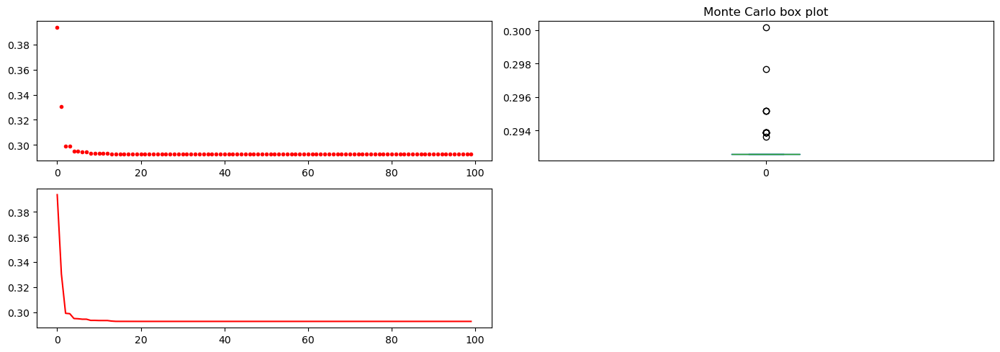

In [10]:
params = {'pop': 50, 'max_iter': 100, 'w': 0.0001, 'c1': 0.1, 'c2': 2.5}
results = monte_carlo(rounds, schaffer_n4, 2, PSO, [-100, -100], [100, 100], params, plot=True)

#### 2.4. Minimize Schaffer-function N.4 using Optuna

Again for the following experiments we will use **Optuna**. We are going to explore combinations of the previous tested parameters trying to find the best ones (most stable and quick to converge). We will carry out 100 experiments. The aim with this search is minimizing the mean of objective function and the minimum iterations required to converge so we will carry out a **Multi–objective optimization**.

In [84]:
def objective(trial):
    params = {
        "pop": trial.suggest_int("pop", 5, 500),
        'max_iter': 200,
        'w': trial.suggest_float("w", 0.00001, 1.0),
        'c1': trial.suggest_float("c1", 0.01, 3.0),
        'c2': trial.suggest_float("c2", 0.01, 3.0),
    }

    # Add a callback for pruning.
    _, mean_result, _, minimum_iter = monte_carlo(rounds, schaffer_n4, 2, PSO, [-100, -100], [100, 100], params, log=False)
    return mean_result, minimum_iter

In [85]:
study = optuna.create_study(
    directions=["minimize","minimize"]
)
study.optimize(objective, callbacks=[MaxTrialsCallback(100, states=(TrialState.COMPLETE,))])

[I 2024-03-14 17:45:53,232] A new study created in memory with name: no-name-52f1d0bd-99b5-4af3-8b85-cb83e276880d
[I 2024-03-14 17:46:36,094] Trial 0 finished with values: [0.29257863203598033, 59.0] and parameters: {'pop': 266, 'w': 0.18920275428387281, 'c1': 0.027596900954056966, 'c2': 2.46870795482597}. 
[I 2024-03-14 17:47:20,566] Trial 1 finished with values: [0.2925813941391616, 199.0] and parameters: {'pop': 278, 'w': 0.05472920712272901, 'c1': 0.41396627912084905, 'c2': 0.16105698414545963}. 
[I 2024-03-14 17:47:23,561] Trial 2 finished with values: [0.2931354036766954, 199.0] and parameters: {'pop': 15, 'w': 0.6803048275558695, 'c1': 1.519967120747654, 'c2': 0.2297752503136537}. 
[I 2024-03-14 17:48:34,581] Trial 3 finished with values: [0.2925786320359803, 142.0] and parameters: {'pop': 453, 'w': 0.12891606206201664, 'c1': 2.384763681846339, 'c2': 1.5466983929898737}. 
[I 2024-03-14 17:48:40,545] Trial 4 finished with values: [0.29257863203598045, 154.0] and parameters: {'pop

/tmp/ipykernel_1461/3439327190.py:1: ExperimentalWarning: plot_pareto_front is experimental (supported from v2.8.0). The interface can change in the future.
  plot_pareto_front(study, target_names=["Mean objective", "Minimum iterations"])
/tmp/ipykernel_1461/3439327190.py:2: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Mean objective")
/tmp/ipykernel_1461/3439327190.py:3: ExperimentalWarning: plot_param_importances is experimental (supported from v2.2.0). The interface can change in the future.
  plot_param_importances(study, target=lambda t: t.values[0], target_name="Mean objective")
/tmp/ipykernel_1461/3439327190.py:4: ExperimentalWarning: plot_contour is experimental (supported from v2.2.0). The interface can change in the future.
  plot_contour(study, target=lambda t: t.values[0], target_name="Mean objective")
[W 2024-03-14 1

array([[<Axes: ylabel='c1'>, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: ylabel='c2'>, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: ylabel='pop'>, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: xlabel='c1', ylabel='w'>, <Axes: xlabel='c2'>,
        <Axes: xlabel='pop'>, <Axes: xlabel='w'>]], dtype=object)

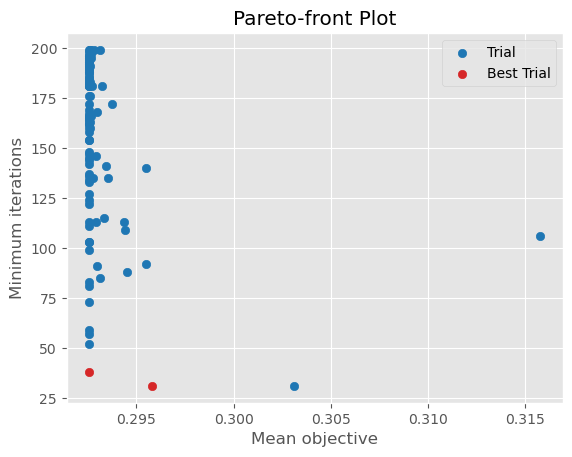

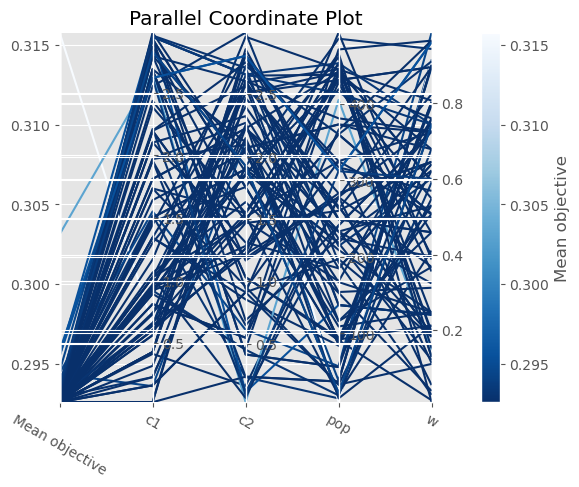

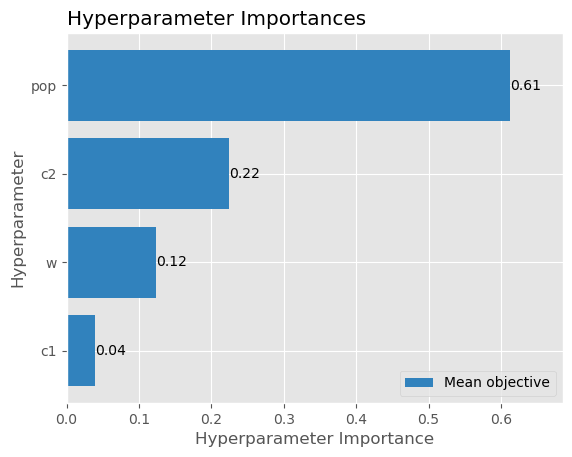

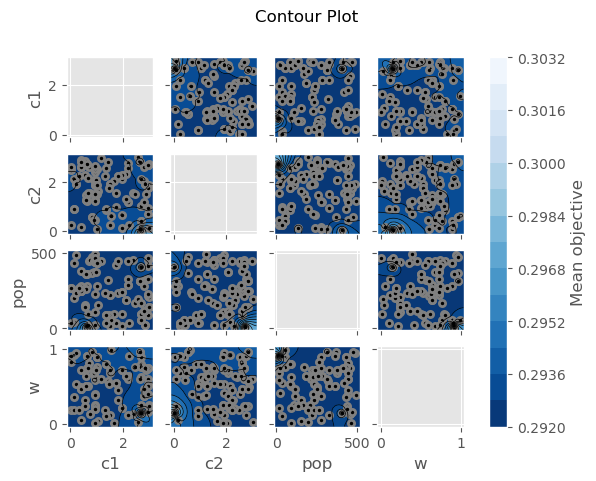

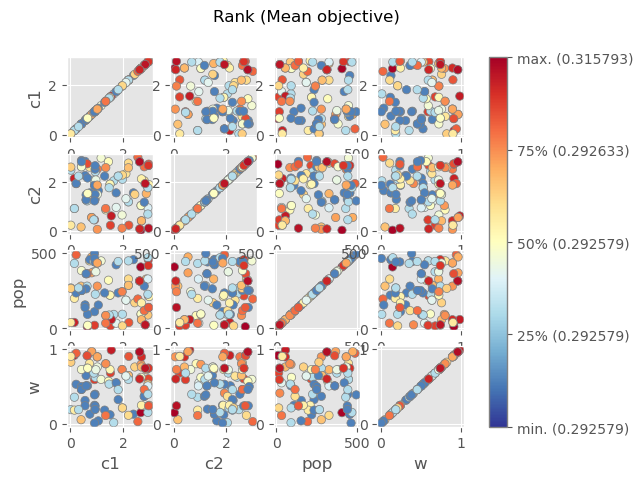

In [86]:
plot_pareto_front(study, target_names=["Mean objective", "Minimum iterations"])
plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Mean objective")
plot_param_importances(study, target=lambda t: t.values[0], target_name="Mean objective")
plot_contour(study, target=lambda t: t.values[0], target_name="Mean objective")
plot_rank(study, target=lambda t: t.values[0], target_name="Mean objective")

In [87]:
# Show the best trials.
for trial in study.best_trials:
    print("Params: ",trial.params, "Results (mean, var, iter_cov):",trial.values) 

Params:  {'pop': 312, 'w': 0.9611712825224676, 'c1': 2.6190585743840624, 'c2': 2.807081651972377} Results (mean, var, iter_cov): [0.2958002125948996, 31.0]
Params:  {'pop': 461, 'w': 0.009545519076492514, 'c1': 0.9216112737597871, 'c2': 1.8512726974377147} Results (mean, var, iter_cov): [0.2925786320359803, 38.0]


Previously we saw that the best parameters were **{'pop': 50, 'max_iter': 100, 'w': 0.0001, 'c1': 0.1, 'c2': 2.5}** using the grid search approach. Using the Optuna optimization we carried out a multi-objective optimization minimizing the mean of objective function and the minimum iterations required to converge and then we look for Pareto-optimal solutions (shown in the previous cell). The set of parameters **{'pop': 461, 'w': 0.009545519076492514, 'c1': 0.9216112737597871, 'c2': 1.8512726974377147}** provides a really good performance with a mean of objective function of 0.2925786320359803 (completely stable) and a minimum of iterations to converge of 38 (high velocity), being the best solution found so far for this problem.

The other parameter set also offer good results with low mean of objective functions and slightly quicker convergence but again since we prefer stability over velocity we select the other one.

Comparing the results of the parameter importance analysis for optimizing the Schaffer function N.4 with those of the original Schaffer function reveals some notable differences:

- **Inertia Weight** (w): In this case, the inertia weight has a much lower importance value of 0.12 compared to the original Schaffer function. This suggests that for Schaffer function N.4, maintaining the particle's current direction is less critical for optimization success. A lower inertia weight may allow particles to adjust their direction more dynamically, potentially aiding convergence.

- **Population Size** (pop): Interestingly, the importance of population size has increased significantly to 0.61 compared to the original Schaffer function. This indicates that for Schaffer function N.4, having a larger population size is more crucial for effective optimization. A larger population size likely facilitates better exploration of the search space, leading to improved convergence to the optimal solution. Therefore, allocating computational resources to accommodate a larger population size may be beneficial when optimizing this particular function.

- **Acceleration Constants** (c1 and c2): Unlike the original Schaffer function, both personal best (c1) and global best (c2) acceleration constants now have non-negligible importance values. The personal best constant (c1) has increased to 0.04, while the global best constant (c2) is 0.22. This suggests that for Schaffer function N.4, the influence of both personal and global best positions on particle movement is more pronounced.


In general, PSO tends to yield more stable results compared to GA in the first assignment when minimizing the Schaffer function. PSO achieves this stability through its efficient exploration and exploitation capabilities, which allow particles to converge towards the global optimum with fewer fluctuations. Unlike GA, which relies on genetic operations such as crossover and mutation that can introduce variability in each generation, PSO's simple yet effective mechanism of updating particle positions based on individual and global bests promotes smoother convergence trajectories.

### BEST PARAMETER SET FOR MINIMIZING SCHAFFER-FUNCTION N.4 RESULTS

Minimum of objective function: 0.29257863203598033
Minimum found in round: 0
Minimum found in iteration: 58
Mean of objective function: 0.2925786320359803
Variance of objective function: 6.625199008692091e-33
Monte Carlo standard error: 8.139532547199558e-18


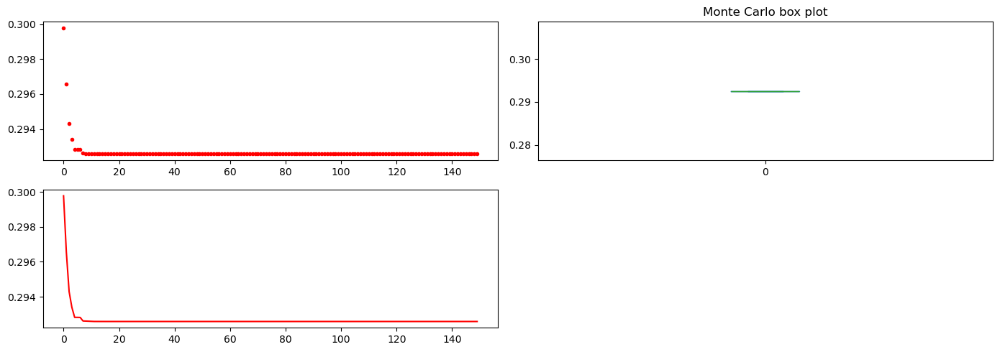

In [12]:
params = {'pop': 461, 'w': 0.009545519076492514, 'c1': 0.9216112737597871, 'c2': 1.8512726974377147}
results = monte_carlo(rounds, schaffer_n4, 2, PSO, [-100, -100], [100, 100], params, plot=True)

To end with this section, if we compare the results with those obtained in the first delivery using GA we can see that, in general, PSO is more stable and converges quickly in minimizing the Schaffer-function, so it is a better option for this problem.

###  3. Minimize the Rosenbrock-function (with both encodings) in a Monte Carlo loop

Rosenbrock's function is a standard test function in optimization. It has a unique minimum value of 0 attained at the point [1,1].

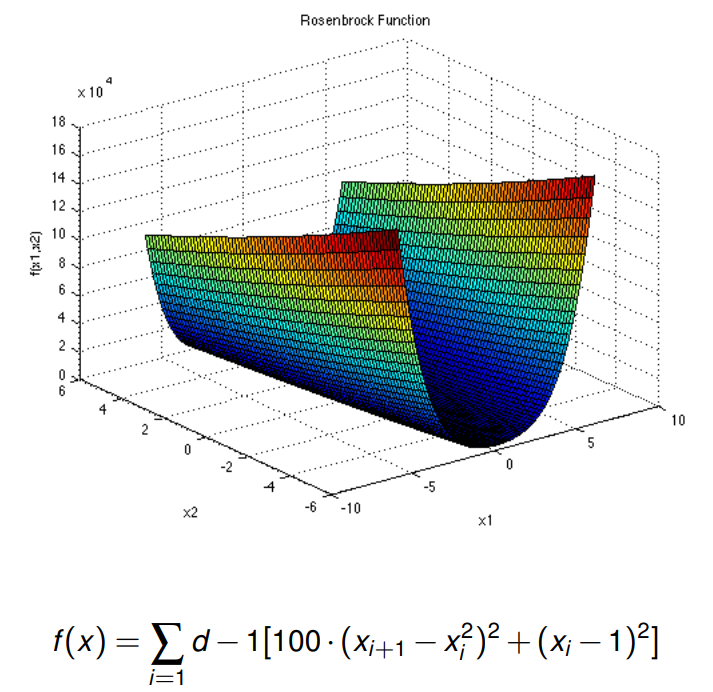

### 3.1. Test minimization of Rosenbrock function with the previous best parameters

First, we will use the **parameter set which provided the best results (grid search) in the previous experiment with the Schaffer N.2 implementation**. We will test it with Rosenbrock function both in three and four dimensions.

Testing best params {'pop': 498, 'w': 0.08226738195182977, 'c1': 0.607547412999876, 'c2': 1.4584377809310707}
Minimum of objective function: 0.012015945780427483
Minimum found in round: 37
Minimum found in iteration: 149
Mean of objective function: 0.29952673380336203
Variance of objective function: 0.016491838230458692
Monte Carlo standard error: 0.012842055221209217


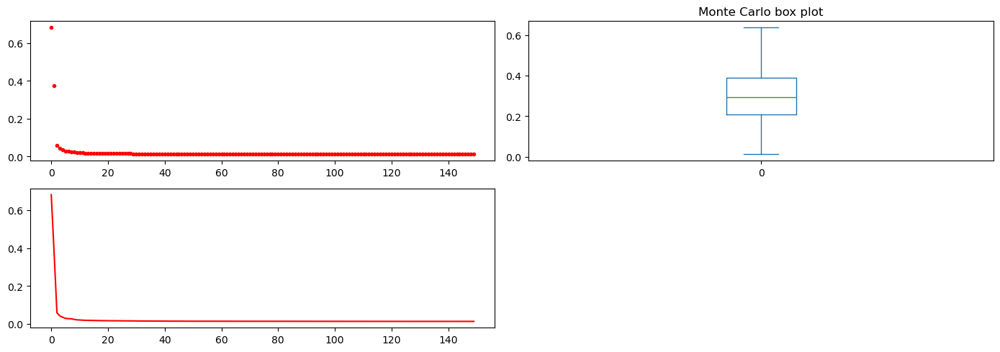

In [11]:
# Rosenbrock function in three dimensions
best_params_n2 = {'pop': 498, 'w': 0.08226738195182977, 'c1': 0.607547412999876, 'c2': 1.4584377809310707}

print("Testing best params",best_params_n2)
results = monte_carlo(rounds, rosenbrock, 3, PSO, [-1, -1, -1], [1, 1, 1], best_params_n2, plot=True)

Testing Rosenbrock function in four dimensions with best params: {'pop': 498, 'w': 0.08226738195182977, 'c1': 0.607547412999876, 'c2': 1.4584377809310707}
Minimum of objective function: 0.2604887311280393
Minimum found in round: 5
Minimum found in iteration: 133
Mean of objective function: 1.0349166570137511
Variance of objective function: 0.10465881686097718
Monte Carlo standard error: 0.03235101495486303


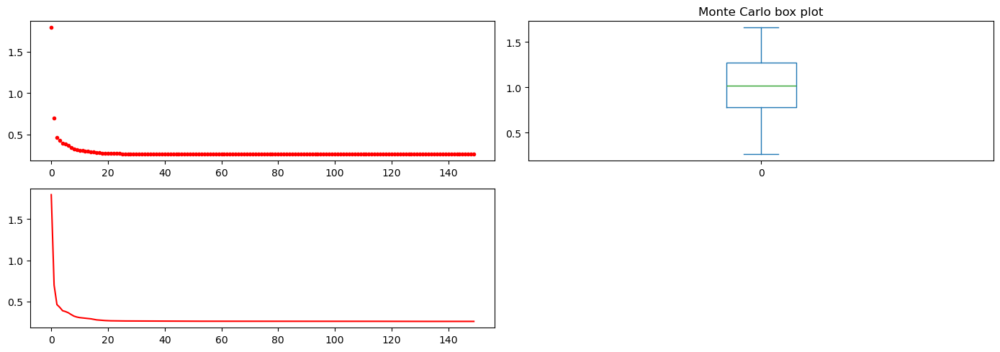

In [10]:
# Rosenbrock function in four dimensions
print("Testing Rosenbrock function in four dimensions with best params:",best_params_n2)
results = monte_carlo(rounds, rosenbrock, 4, PSO, [-1, -1, -1, -1], [1, 1, 1, 1], best_params_n2, plot=True)

In this case the parameter set does not seem to be the best one since we obtain a mean of objective function on 0.29 and 1.03 for three and four dimensions respectively, quite far from the minimal solution (0) even using a small search area of [-1,-1,-1], [1,1,1]. In addition, the minimum of objective function shows that we have not found the minimal solution in any round using Rosenbrock function in three and four dimensions. For three dimensions it takes around 150 iterations to converge while for four dimensions the convergence took 130 iterations. Clearly stated by the results we need to search a better parameter set for minimizing the Rosenbrock function.

#### 3.2. Minimize Rosenbrock function using grid search

As in the previous section, we will perform a grid search over a set of parameters for each Rosenbrock-function over the PSO algorithm. Then, we can evaluate the performance of each parameter set using the Monte Carlo loop keeping track of the best mean objective function value found. First, we will evaluate it for the Rosenbrock function in three dimensions in a search space of ([-1, -1, -1], [1, 1, 1]).

In [12]:
# Define the parameter grid for PSO
PSO_param_grid = {
    'pop': [20, 50, 100, 500],
    'max_iter': [800],
    'w': [0.0001, 0.001, 0.01],
    'c1': [0.1, 0.5, 2.5],
    'c2': [0.1, 0.5, 2.5]
}

# Perform grid search for PSO
best_params_rosen_3 = None
best_mean_result = float('inf')

for pop in PSO_param_grid['pop']:
    for max_iter in PSO_param_grid['max_iter']:
        for w in PSO_param_grid['w']:
            for c1 in PSO_param_grid['c1']:
                for c2 in PSO_param_grid['c2']:
                    params = {'pop': pop, 'max_iter': max_iter, 'w': w, 'c1':c1, 'c2':c2}
                    print("Testing params",params)
                    best_PSO, mean_result, _, _ = monte_carlo(rounds, rosenbrock, 3, PSO, [-1, -1, -1], [1, 1, 1], params)
                    
                    if mean_result < best_mean_result:
                        best_mean_result = mean_result
                        best_params_rosen_3 = params

                    print()

print("Best Parameters:", best_params_rosen_3)
print("Best Mean Objective Function Value:", best_mean_result)

Testing params {'pop': 20, 'max_iter': 800, 'w': 0.0001, 'c1': 0.1, 'c2': 0.1}
Minimum of objective function: 0.688034455891956
Minimum found in round: 3
Mean of objective function: 1.349254632890284
Variance of objective function: 0.2266478418005066
Monte Carlo standard error: 0.1505482785688719

Testing params {'pop': 20, 'max_iter': 800, 'w': 0.0001, 'c1': 0.1, 'c2': 0.5}
Minimum of objective function: 0.5325405349714455
Minimum found in round: 8
Mean of objective function: 1.4679557090988877
Variance of objective function: 0.2684927552801135
Monte Carlo standard error: 0.1638574854195296

Testing params {'pop': 20, 'max_iter': 800, 'w': 0.0001, 'c1': 0.1, 'c2': 2.5}
Minimum of objective function: 0.04728509590864259
Minimum found in round: 3
Mean of objective function: 0.20060449202913383
Variance of objective function: 0.028439358796065677
Monte Carlo standard error: 0.05332856532484788

Testing params {'pop': 20, 'max_iter': 800, 'w': 0.0001, 'c1': 0.5, 'c2': 0.1}
Minimum of obje

The best parameters found are **{'pop': 20, 'max_iter': 800, 'w': 0.0001, 'c1': 2.5, 'c2': 2.5}** with a mean objective function value of 0 (completely stable).

Minimum of objective function: 0.0
Minimum found in round: 0
Minimum found in iteration: 25
Mean of objective function: 0.0
Variance of objective function: 0.0
Monte Carlo standard error: 0.0


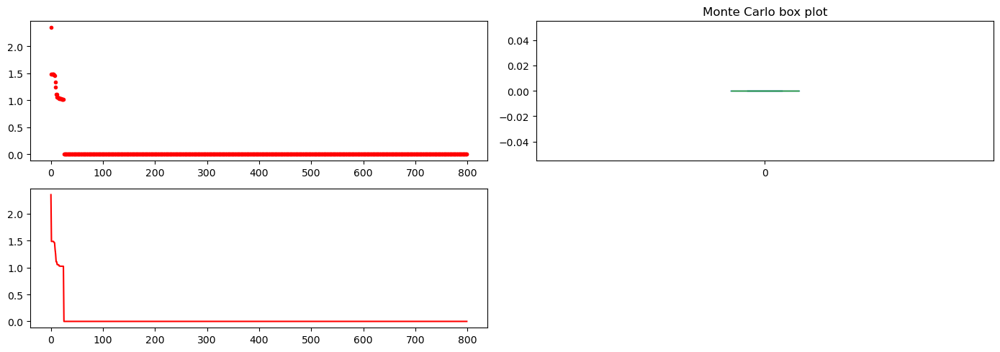

In [13]:
params = {'pop': 20, 'max_iter': 800, 'w': 0.0001, 'c1': 2.5, 'c2': 2.5}
results = monte_carlo(rounds, rosenbrock, 3, PSO, [-1, -1, -1], [1, 1, 1], params, plot=True)

Let's see what happens when we evaluate the Rosenbrock function in four dimensions.

In [13]:
# Define the parameter grid for PSO
PSO_param_grid = {
    'pop': [20, 50, 100, 500],
    'max_iter': [800],
    'w': [0.0001, 0.001, 0.01],
    'c1': [0.1, 0.5, 2.5],
    'c2': [0.1, 0.5, 2.5]
}

# Perform grid search for PSO
best_params_rosen_4 = None
best_mean_result = float('inf')

for pop in PSO_param_grid['pop']:
    for max_iter in PSO_param_grid['max_iter']:
        for w in PSO_param_grid['w']:
            for c1 in PSO_param_grid['c1']:
                for c2 in PSO_param_grid['c2']:
                    params = {'pop': pop, 'max_iter': max_iter, 'w': w, 'c1':c1, 'c2':c2}
                    print("Testing params",params)
                    best_PSO, mean_result, _, _ = monte_carlo(rounds, rosenbrock, 4, PSO, [-1, -1, -1, -1], [1, 1, 1, 1], params)
                    
                    if mean_result < best_mean_result:
                        best_mean_result = mean_result
                        best_params_rosen_4 = params

                    print()

print("Best Parameters:", best_params_rosen_4)
print("Best Mean Objective Function Value:", best_mean_result)

Testing params {'pop': 20, 'max_iter': 800, 'w': 0.0001, 'c1': 0.1, 'c2': 0.1}
Minimum of objective function: 1.3435108529083437
Minimum found in round: 8
Mean of objective function: 2.4769385899169474
Variance of objective function: 0.5039657340653663
Monte Carlo standard error: 0.2244918114465127

Testing params {'pop': 20, 'max_iter': 800, 'w': 0.0001, 'c1': 0.1, 'c2': 0.5}
Minimum of objective function: 2.0266016873037396
Minimum found in round: 2
Mean of objective function: 2.7378405216387867
Variance of objective function: 0.2571552568248032
Monte Carlo standard error: 0.1603606113809757

Testing params {'pop': 20, 'max_iter': 800, 'w': 0.0001, 'c1': 0.1, 'c2': 2.5}
Minimum of objective function: 0.7418950100470872
Minimum found in round: 3
Mean of objective function: 1.4133398111526714
Variance of objective function: 0.6084028540289393
Monte Carlo standard error: 0.2466582360329651

Testing params {'pop': 20, 'max_iter': 800, 'w': 0.0001, 'c1': 0.5, 'c2': 0.1}
Minimum of objecti

Using the Rosenbrock function in 4 dimensions the results show higher mean of objective function in general, with few combinations of parameters being able to reach the global minimum. This increase of complexity is derived from a higher dimensionality. The best parameters found are **{'pop': 20, 'max_iter': 800, 'w': 0.0001, 'c1': 2.5, 'c2': 2.5}** with a mean objective function value of 0.

Minimum of objective function: 0.0
Minimum found in round: 0
Minimum found in iteration: 96
Mean of objective function: 0.0
Variance of objective function: 0.0
Monte Carlo standard error: 0.0


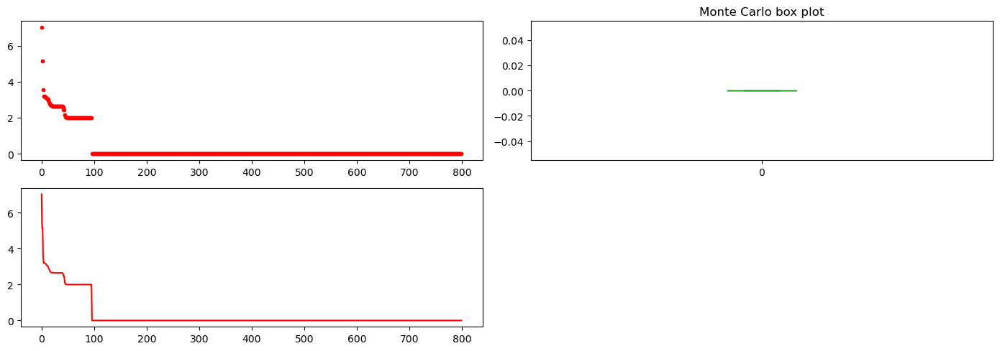

In [14]:
params = {'pop': 20, 'max_iter': 800, 'w': 0.0001, 'c1': 2.5, 'c2': 2.5}
results = monte_carlo(rounds, rosenbrock, 4, PSO, [-1, -1, -1, -1], [1, 1, 1, 1], params, plot=True)

Considering that normally we do not have knowledge domain about where the global minimum is located let's now use a more realistic search space increasing it to ([-100, -100, -100], [100, 100, 100]) and test again.

In [8]:
# Define the parameter grid for PSO
PSO_param_grid = {
    'pop': [20, 50, 100, 500],
    'max_iter': [800],
    'w': [0.0001, 0.001, 0.01],
    'c1': [0.1, 0.5, 2.5],
    'c2': [0.1, 0.5, 2.5]
}

# Perform grid search for PSO
best_params_rosen_3 = None
best_mean_result = float('inf')

for pop in PSO_param_grid['pop']:
    for max_iter in PSO_param_grid['max_iter']:
        for w in PSO_param_grid['w']:
            for c1 in PSO_param_grid['c1']:
                for c2 in PSO_param_grid['c2']:
                    params = {'pop': pop, 'max_iter': max_iter, 'w': w, 'c1':c1, 'c2':c2}
                    print("Testing params",params)
                    best_PSO, mean_result, _, _ = monte_carlo(rounds, rosenbrock, 3, PSO, [-100, -100, -100], [100, 100, 100], params)
                    
                    if mean_result < best_mean_result:
                        best_mean_result = mean_result
                        best_params_rosen_3 = params

                    print()

print("Best Parameters:", best_params_rosen_3)
print("Best Mean Objective Function Value:", best_mean_result)

Testing params {'pop': 20, 'max_iter': 800, 'w': 0.0001, 'c1': 0.1, 'c2': 0.1}
Minimum of objective function: 0.1331454486881294
Minimum found in round: 78
Minimum found in iteration: 783
Mean of objective function: 53251.65337824156
Variance of objective function: 10700039194.4649
Monte Carlo standard error: 10344.099378130944

Testing params {'pop': 20, 'max_iter': 800, 'w': 0.0001, 'c1': 0.1, 'c2': 0.5}
Minimum of objective function: 0.04613347164522689
Minimum found in round: 6
Minimum found in iteration: 154
Mean of objective function: 17411.57599147197
Variance of objective function: 1732338786.4022787
Monte Carlo standard error: 4162.1374153219385

Testing params {'pop': 20, 'max_iter': 800, 'w': 0.0001, 'c1': 0.1, 'c2': 2.5}
Minimum of objective function: 0.013598223424569863
Minimum found in round: 98
Minimum found in iteration: 542
Mean of objective function: 217.78051890146872
Variance of objective function: 1992121.6354491296
Monte Carlo standard error: 141.14253913860023



The best parameters found are **{'pop': 500, 'max_iter': 800, 'w': 0.01, 'c1': 0.1, 'c2': 2.5}** with a mean objective function value of 1.1584545652687e-29 (almost completely stable).

In [9]:
# Define the parameter grid for PSO
PSO_param_grid = {
    'pop': [20, 50, 100, 500],
    'max_iter': [800],
    'w': [0.0001, 0.001, 0.01],
    'c1': [0.1, 0.5, 2.5],
    'c2': [0.1, 0.5, 2.5]
}

# Perform grid search for PSO
best_params_rosen_4 = None
best_mean_result = float('inf')

for pop in PSO_param_grid['pop']:
    for max_iter in PSO_param_grid['max_iter']:
        for w in PSO_param_grid['w']:
            for c1 in PSO_param_grid['c1']:
                for c2 in PSO_param_grid['c2']:
                    params = {'pop': pop, 'max_iter': max_iter, 'w': w, 'c1':c1, 'c2':c2}
                    print("Testing params",params)
                    best_PSO, mean_result, _, _ = monte_carlo(rounds, rosenbrock, 4, PSO, [-100, -100, -100, -100], [100, 100, 100, 100], params)
                    
                    if mean_result < best_mean_result:
                        best_mean_result = mean_result
                        best_params_rosen_4 = params

                    print()

print("Best Parameters:", best_params_rosen_4)
print("Best Mean Objective Function Value:", best_mean_result)

Testing params {'pop': 20, 'max_iter': 800, 'w': 0.0001, 'c1': 0.1, 'c2': 0.1}
Minimum of objective function: 0.27885968673095807
Minimum found in round: 35
Minimum found in iteration: 799
Mean of objective function: 37342.16202636837
Variance of objective function: 7053992981.009325
Monte Carlo standard error: 8398.805260874504

Testing params {'pop': 20, 'max_iter': 800, 'w': 0.0001, 'c1': 0.1, 'c2': 0.5}
Minimum of objective function: 4.35401794799015
Minimum found in round: 23
Minimum found in iteration: 147
Mean of objective function: 44409.14977724188
Variance of objective function: 19110763886.555565
Monte Carlo standard error: 13824.168650069183

Testing params {'pop': 20, 'max_iter': 800, 'w': 0.0001, 'c1': 0.1, 'c2': 2.5}
Minimum of objective function: 0.00439493521789042
Minimum found in round: 96
Minimum found in iteration: 383
Mean of objective function: 30416.716949260925
Variance of objective function: 29078087127.74698
Monte Carlo standard error: 17052.29812305279

Test

The best parameters found are **{'pop': 500, 'max_iter': 800, 'w': 0.01, 'c1': 0.5, 'c2': 2.5}** with a mean objective function value of 0.333. In this case, the increase of complexity derived from a higher dimensionality makes the algorithm unable to find the global minimum with any of the tested parameter sets and decreases the overall stability.

#### 3.3. Minimize Rosenbrock function using Optuna

Looking for improving these results, for the following experiments we will use **Optuna**. We are going to explore combinations of parameters trying to find the best ones (most stable and quick to converge). We will carry out 100 experiments. The aim with this search is minimizing the mean of objective function and the minimum iterations required to converge so we will carry out a **Multi–objective optimization**.

In [88]:
def objective(trial):
    params = {
        "pop": trial.suggest_int("pop", 5, 500),
        'max_iter': 200,
        'w': trial.suggest_float("w", 0.00001, 1.0),
        'c1': trial.suggest_float("c1", 0.01, 3.0),
        'c2': trial.suggest_float("c2", 0.01, 3.0),
    }
    
    # Add a callback for pruning.
    _, mean_result, _, minimum_iter = monte_carlo(rounds, rosenbrock, 3, PSO, [-100, -100, -100], [100, 100, 100], params, log=False)
    return mean_result, minimum_iter

In [89]:
study = optuna.create_study(
    directions=["minimize","minimize"]
)
study.optimize(objective, callbacks=[MaxTrialsCallback(100, states=(TrialState.COMPLETE,))])

[I 2024-03-14 18:51:07,865] A new study created in memory with name: no-name-bcc03ce2-929f-493a-ac53-769e40fc5e97
[I 2024-03-14 18:51:11,933] Trial 0 finished with values: [28.646578976071098, 199.0] and parameters: {'pop': 87, 'w': 0.3307843141558314, 'c1': 0.864222339095748, 'c2': 2.8265613174385593}. 
[I 2024-03-14 18:51:18,188] Trial 1 finished with values: [16.38336930196108, 199.0] and parameters: {'pop': 131, 'w': 0.48432711129193723, 'c1': 0.5025427339960606, 'c2': 1.364189821271976}. 
[I 2024-03-14 18:51:25,631] Trial 2 finished with values: [2.855500014759359, 199.0] and parameters: {'pop': 171, 'w': 0.1247148088689526, 'c1': 1.4992275980182925, 'c2': 1.665315452269089}. 
[I 2024-03-14 18:51:33,840] Trial 3 finished with values: [2.6585083657747752, 199.0] and parameters: {'pop': 187, 'w': 0.10998753239344587, 'c1': 2.7622034748937048, 'c2': 0.9512256595558356}. 
[I 2024-03-14 18:51:51,604] Trial 4 finished with values: [0.003899239173879333, 196.0] and parameters: {'pop': 44

/tmp/ipykernel_1461/3439327190.py:1: ExperimentalWarning: plot_pareto_front is experimental (supported from v2.8.0). The interface can change in the future.
  plot_pareto_front(study, target_names=["Mean objective", "Minimum iterations"])
/tmp/ipykernel_1461/3439327190.py:2: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Mean objective")
/tmp/ipykernel_1461/3439327190.py:3: ExperimentalWarning: plot_param_importances is experimental (supported from v2.2.0). The interface can change in the future.
  plot_param_importances(study, target=lambda t: t.values[0], target_name="Mean objective")
/tmp/ipykernel_1461/3439327190.py:4: ExperimentalWarning: plot_contour is experimental (supported from v2.2.0). The interface can change in the future.
  plot_contour(study, target=lambda t: t.values[0], target_name="Mean objective")
[W 2024-03-14 1

array([[<Axes: ylabel='c1'>, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: ylabel='c2'>, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: ylabel='pop'>, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: xlabel='c1', ylabel='w'>, <Axes: xlabel='c2'>,
        <Axes: xlabel='pop'>, <Axes: xlabel='w'>]], dtype=object)

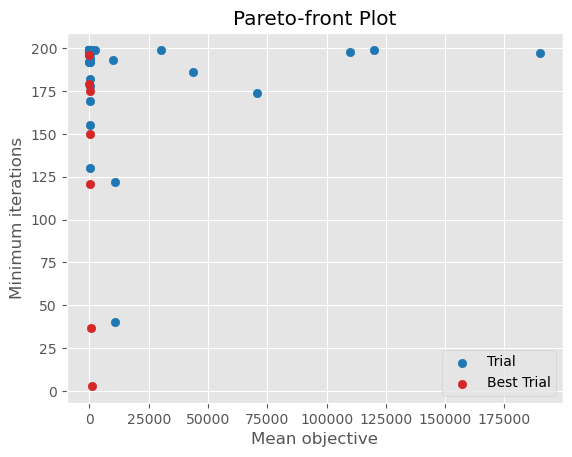

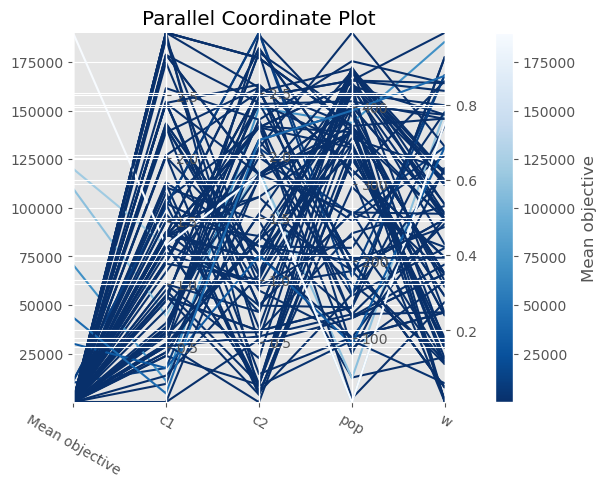

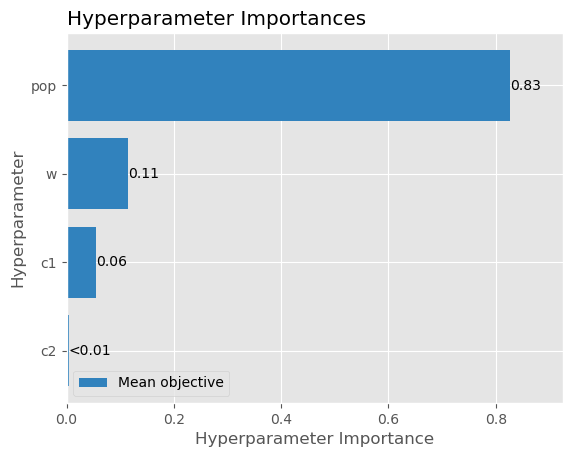

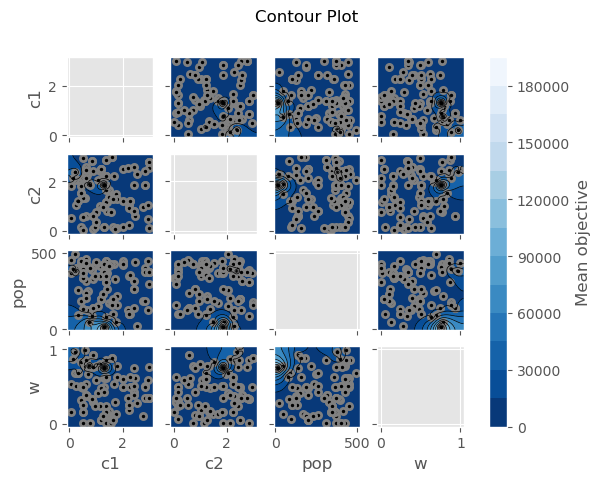

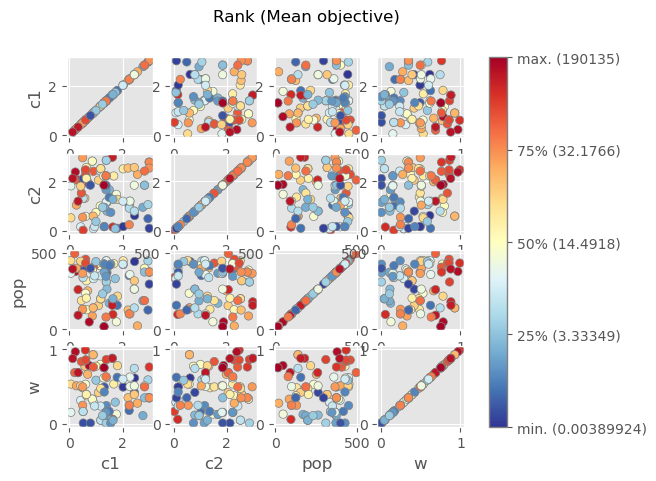

In [90]:
plot_pareto_front(study, target_names=["Mean objective", "Minimum iterations"])
plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Mean objective")
plot_param_importances(study, target=lambda t: t.values[0], target_name="Mean objective")
plot_contour(study, target=lambda t: t.values[0], target_name="Mean objective")
plot_rank(study, target=lambda t: t.values[0], target_name="Mean objective")

In [91]:
# Show the best trials.
for trial in study.best_trials:
    print("Params: ",trial.params, "Results (mean, iter_cov):",trial.values) 

Params:  {'pop': 444, 'w': 0.6151122738415207, 'c1': 2.4501270910212005, 'c2': 0.6135767648369915} Results (mean, var, iter_cov): [0.003899239173879333, 196.0]
Params:  {'pop': 375, 'w': 0.34890408061206435, 'c1': 2.999634424993659, 'c2': 2.7827144956864323} Results (mean, var, iter_cov): [37.714620121182946, 121.0]
Params:  {'pop': 434, 'w': 0.9912160145107844, 'c1': 0.6044611866891099, 'c2': 2.4708794174478173} Results (mean, var, iter_cov): [883.3669699050464, 3.0]
Params:  {'pop': 22, 'w': 0.27634549377556855, 'c1': 2.5579221756504587, 'c2': 2.2867295768039573} Results (mean, var, iter_cov): [26.755444669915537, 175.0]
Params:  {'pop': 375, 'w': 0.7630149040202717, 'c1': 2.999634424993659, 'c2': 2.7827144956864323} Results (mean, var, iter_cov): [587.0419146732835, 37.0]
Params:  {'pop': 375, 'w': 0.34890408061206435, 'c1': 2.999634424993659, 'c2': 2.5449953876757796} Results (mean, var, iter_cov): [31.478529657264367, 150.0]
Params:  {'pop': 263, 'w': 0.5097551451829865, 'c1': 2.4

There is a distinct variation in performance across different parameter configurations. The best result was achieved with a parameter set comprising a population size of 444, an inertia weight (w) of 0.6151, a cognitive factor (c1) of 2.4501, and a social factor (c2) of 0.6136. This configuration yielded an low mean objective function value of approximately 0.0039, indicating highly effective convergence to an optimal solution with a number of iterations close to the maximum (196.0). On the contrary, the worst-performing configuration was characterized by a population size of 434, an inertia weight (w) of 0.9912, a cognitive factor (c1) of 0.6045, and a social factor (c2) of 2.4709, resulting in a significantly higher mean objective function value of approximately 883.367, due to a too premature convergence (in only 3 iterations).

The best parameter set results are shown below:

Minimum of objective function: 4.863226819086582e-10
Minimum found in round: 38
Minimum found in iteration: 147
Mean of objective function: 0.16660807942617187
Variance of objective function: 2.6202485522951635
Monte Carlo standard error: 0.1618718181863404


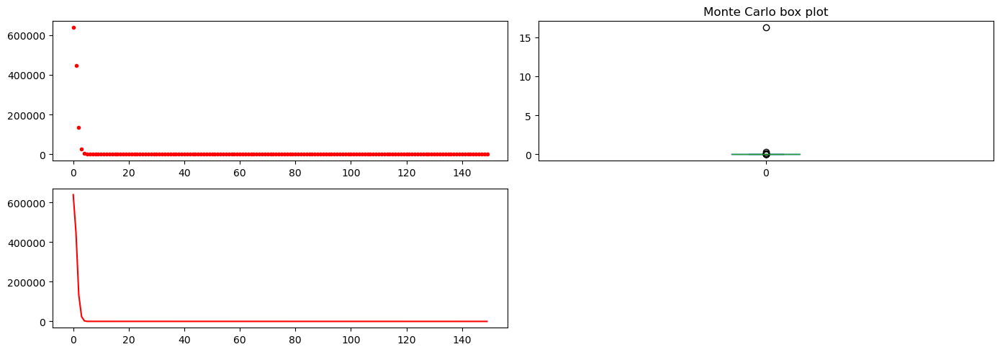

In [15]:
params = {'pop': 444, 'w': 0.6151122738415207, 'c1': 2.4501270910212005, 'c2': 0.6135767648369915}
results = monte_carlo(rounds, rosenbrock, 3, PSO, [-100, -100, -100], [100, 100, 100], params, plot=True)

In general the results are quite far from the global minimum and the executions converge near the maximum of iterations suggesting that this value is not large enough for the algorithm to converge successfully. Let's increase the maximum of iterations to 800 and test again.

In [19]:
def objective(trial):
    params = {
        "pop": trial.suggest_int("pop", 5, 500),
        'max_iter': 800,
        'w': trial.suggest_float("w", 0.00001, 1.0),
        'c1': trial.suggest_float("c1", 0.01, 3.0),
        'c2': trial.suggest_float("c2", 0.01, 3.0),
    }
    
    # Add a callback for pruning.
    _, mean_result, _, minimum_iter = monte_carlo(rounds, rosenbrock, 3, PSO, [-100, -100, -100], [100, 100, 100], params, log=False)
    return mean_result, minimum_iter

In [20]:
study = optuna.create_study(
    directions=["minimize","minimize"]
)
study.optimize(objective, callbacks=[MaxTrialsCallback(100, states=(TrialState.COMPLETE,))])

[I 2024-03-19 10:22:04,618] A new study created in memory with name: no-name-b69187fb-486f-4d63-b0fe-4fc4ce9f1fb6
[I 2024-03-19 10:22:19,258] Trial 0 finished with values: [43.31151741023077, 731.0] and parameters: {'pop': 74, 'w': 0.21993601837185017, 'c1': 1.056691351238217, 'c2': 1.1995763544326479}. 
[I 2024-03-19 10:23:34,292] Trial 1 finished with values: [37.97371657266781, 116.0] and parameters: {'pop': 481, 'w': 0.9455599827636283, 'c1': 2.0278874887006886, 'c2': 0.5999014698139719}. 
[I 2024-03-19 10:23:59,435] Trial 2 finished with values: [26.682105210496843, 799.0] and parameters: {'pop': 149, 'w': 0.5206338317645469, 'c1': 1.7944599066559996, 'c2': 2.868352612822667}. 
[I 2024-03-19 10:25:16,472] Trial 3 finished with values: [26.751233651676998, 589.0] and parameters: {'pop': 492, 'w': 0.9128879174248442, 'c1': 1.770756703124354, 'c2': 1.334761300227451}. 
[I 2024-03-19 10:26:05,254] Trial 4 finished with values: [402.23127533809617, 4.0] and parameters: {'pop': 299, 'w'

/tmp/ipykernel_1036/3439327190.py:1: ExperimentalWarning: plot_pareto_front is experimental (supported from v2.8.0). The interface can change in the future.
  plot_pareto_front(study, target_names=["Mean objective", "Minimum iterations"])
/tmp/ipykernel_1036/3439327190.py:2: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Mean objective")
/tmp/ipykernel_1036/3439327190.py:3: ExperimentalWarning: plot_param_importances is experimental (supported from v2.2.0). The interface can change in the future.
  plot_param_importances(study, target=lambda t: t.values[0], target_name="Mean objective")
/tmp/ipykernel_1036/3439327190.py:4: ExperimentalWarning: plot_contour is experimental (supported from v2.2.0). The interface can change in the future.
  plot_contour(study, target=lambda t: t.values[0], target_name="Mean objective")
[W 2024-03-19 1

array([[<Axes: ylabel='c1'>, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: ylabel='c2'>, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: ylabel='pop'>, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: xlabel='c1', ylabel='w'>, <Axes: xlabel='c2'>,
        <Axes: xlabel='pop'>, <Axes: xlabel='w'>]], dtype=object)

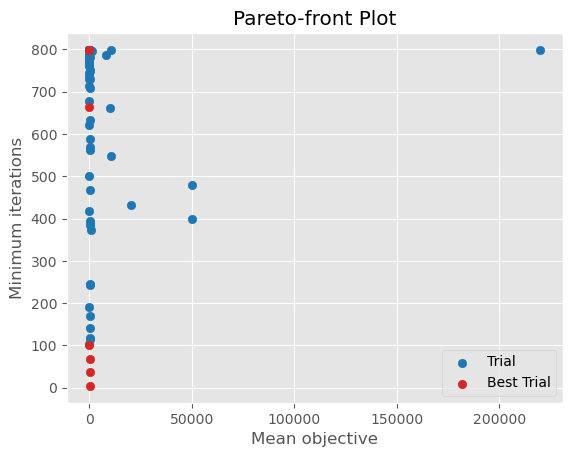

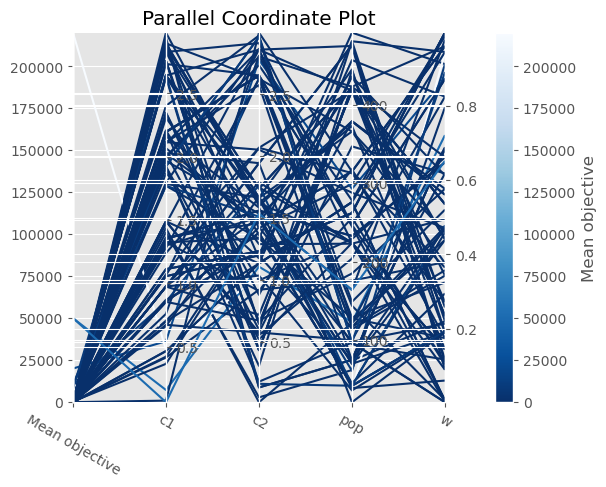

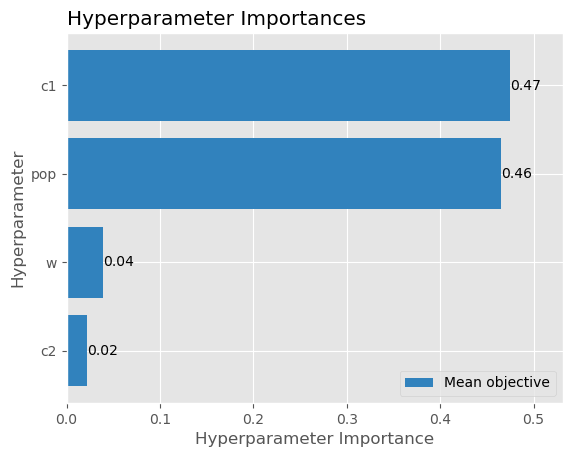

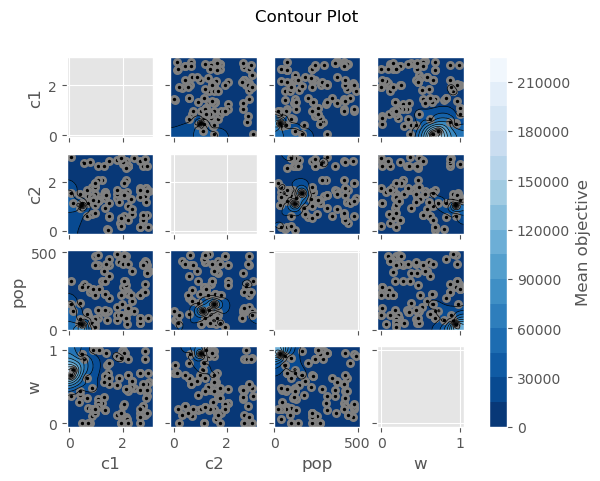

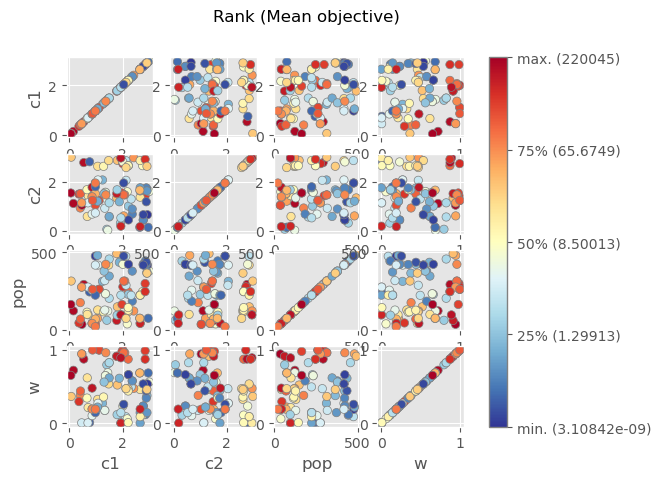

In [21]:
plot_pareto_front(study, target_names=["Mean objective", "Minimum iterations"])
plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Mean objective")
plot_param_importances(study, target=lambda t: t.values[0], target_name="Mean objective")
plot_contour(study, target=lambda t: t.values[0], target_name="Mean objective")
plot_rank(study, target=lambda t: t.values[0], target_name="Mean objective")

In [22]:
# Show the best trials.
for trial in study.best_trials:
    print("Params: ",trial.params, "Results (mean, iter_cov):",trial.values) 

Params:  {'pop': 299, 'w': 0.9878308538236409, 'c1': 2.827735695508326, 'c2': 1.420502688250222} Results (mean, iter_cov): [402.23127533809617, 4.0]
Params:  {'pop': 276, 'w': 0.004903059366782954, 'c1': 0.465479736473394, 'c2': 1.133854052220433} Results (mean, iter_cov): [2.6047520876468058, 100.0]
Params:  {'pop': 418, 'w': 0.5354774350937664, 'c1': 2.911677986154422, 'c2': 0.6478687922272074} Results (mean, iter_cov): [3.108424356153424e-09, 799.0]
Params:  {'pop': 476, 'w': 0.19029709009543444, 'c1': 0.9748618556303104, 'c2': 1.9443721271355485} Results (mean, iter_cov): [1.049318613147067e-08, 665.0]
Params:  {'pop': 262, 'w': 0.9976321394677493, 'c1': 1.1126028221602704, 'c2': 1.233991854565521} Results (mean, iter_cov): [271.70866126271056, 38.0]
Params:  {'pop': 262, 'w': 0.9976321394677493, 'c1': 0.8702770008451864, 'c2': 1.233991854565521} Results (mean, iter_cov): [229.41396499783406, 68.0]


The best result, in terms of achieving the lowest mean objective function value, was observed with a parameter set consisting of a population size of 418, an inertia weight (w) of 0.5355, a cognitive factor (c1) of 2.9117, and a social factor (c2) of 0.6479. Remarkably, this configuration led to a mean objective function value close to zero, approximately 3.1084e-09, indicating highly effective convergence to an optimal solution with full iteration coverage but taking too long to converge. Conversely, the worst-performing configuration was characterized by a population size of 299, an inertia weight (w) of 0.9878, a cognitive factor (c1) of 2.8277, and a social factor (c2) of 1.4205. In this setup, the algorithm achieved a substantially higher mean objective function value of approximately 402.2313, with very low iteration coverage (4.0), suggesting poor convergence and exploration characteristics. 

The best parameter set results are shown below:

Minimum of objective function: 3.270074140355531e-20
Minimum found in round: 20
Minimum found in iteration: 791
Mean of objective function: 3.1274008497622206e-07
Variance of objective function: 9.18044324571587e-12
Monte Carlo standard error: 3.0299246270684473e-07


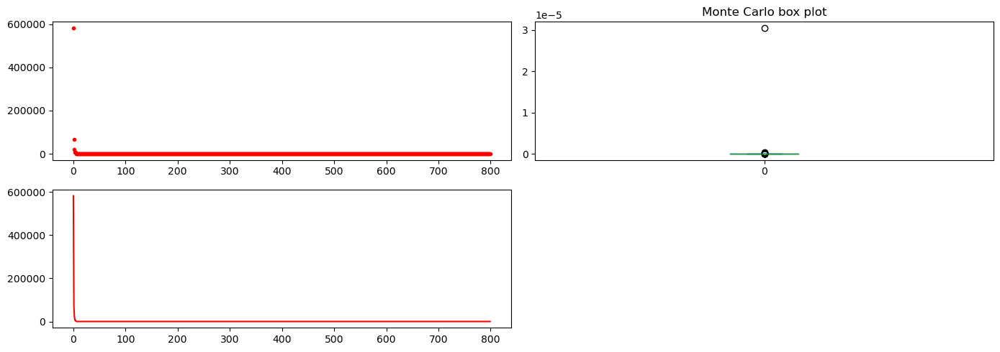

In [18]:
params = {'pop': 418, 'w': 0.5354774350937664, 'c1': 2.911677986154422, 'c2': 0.6478687922272074, 'max_iter': 800}
results = monte_carlo(rounds, rosenbrock, 3, PSO, [-100, -100, -100], [100, 100, 100], params, plot=True)

### Rosenbrock function in 4 dimensions
Let's see what happens with the Rosenbrock function in 4 dimensions.

In [92]:
def objective(trial):
    params = {
        "pop": trial.suggest_int("pop", 5, 500),
        'max_iter': 200,
        'w': trial.suggest_float("w", 0.00001, 1.0),
        'c1': trial.suggest_float("c1", 0.01, 3.0),
        'c2': trial.suggest_float("c2", 0.01, 3.0),
    }
    
    # Add a callback for pruning.
    _, mean_result, _, minimum_iter = monte_carlo(rounds, rosenbrock, 4, PSO, [-100, -100, -100, -100], [100, 100, 100, 100], params, log=False)
    return mean_result, minimum_iter

In [93]:
study = optuna.create_study(
    directions=["minimize","minimize"]
)
study.optimize(objective, callbacks=[MaxTrialsCallback(100, states=(TrialState.COMPLETE,))])

[I 2024-03-14 19:11:43,621] A new study created in memory with name: no-name-683367c6-28c3-4f16-8447-2543fbaf62eb
[I 2024-03-14 19:11:53,678] Trial 0 finished with values: [20035.317458399026, 198.0] and parameters: {'pop': 177, 'w': 0.6916018124011902, 'c1': 1.090940013870994, 'c2': 2.1463088941817206}. 
[I 2024-03-14 19:12:05,881] Trial 1 finished with values: [17.395233776049707, 199.0] and parameters: {'pop': 196, 'w': 0.2090126124963365, 'c1': 1.3684007833191743, 'c2': 1.122570404870518}. 
[I 2024-03-14 19:12:22,796] Trial 2 finished with values: [35.24259565558693, 198.0] and parameters: {'pop': 315, 'w': 0.5314797906129161, 'c1': 1.5807822035103645, 'c2': 2.573397370018549}. 
[I 2024-03-14 19:12:42,758] Trial 3 finished with values: [36.40212160409111, 163.0] and parameters: {'pop': 370, 'w': 0.809084362477775, 'c1': 2.1099296677858663, 'c2': 1.4406429107249044}. 
[I 2024-03-14 19:13:10,710] Trial 4 finished with values: [43.90738137654674, 199.0] and parameters: {'pop': 463, 'w

/tmp/ipykernel_1461/3439327190.py:1: ExperimentalWarning: plot_pareto_front is experimental (supported from v2.8.0). The interface can change in the future.
  plot_pareto_front(study, target_names=["Mean objective", "Minimum iterations"])
/tmp/ipykernel_1461/3439327190.py:2: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Mean objective")
/tmp/ipykernel_1461/3439327190.py:3: ExperimentalWarning: plot_param_importances is experimental (supported from v2.2.0). The interface can change in the future.
  plot_param_importances(study, target=lambda t: t.values[0], target_name="Mean objective")
/tmp/ipykernel_1461/3439327190.py:4: ExperimentalWarning: plot_contour is experimental (supported from v2.2.0). The interface can change in the future.
  plot_contour(study, target=lambda t: t.values[0], target_name="Mean objective")
[W 2024-03-14 1

array([[<Axes: ylabel='c1'>, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: ylabel='c2'>, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: ylabel='pop'>, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: xlabel='c1', ylabel='w'>, <Axes: xlabel='c2'>,
        <Axes: xlabel='pop'>, <Axes: xlabel='w'>]], dtype=object)

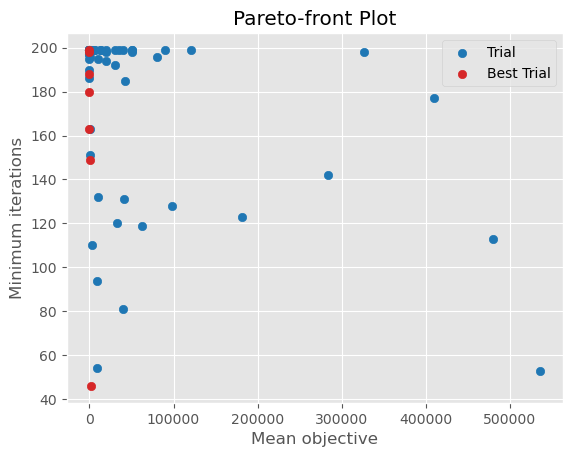

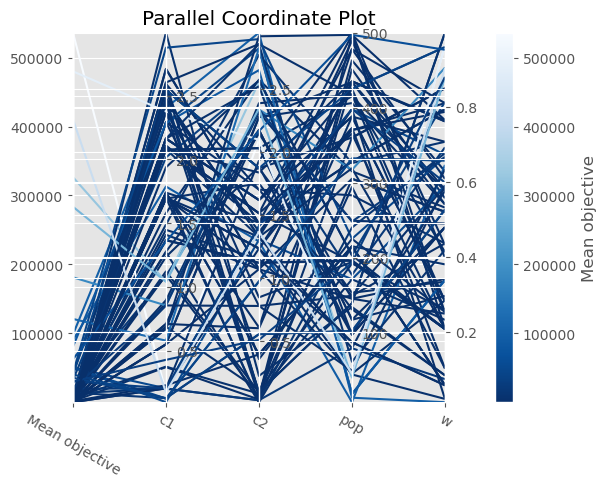

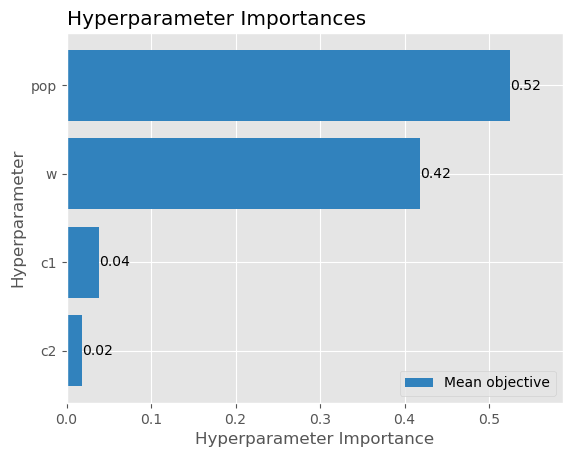

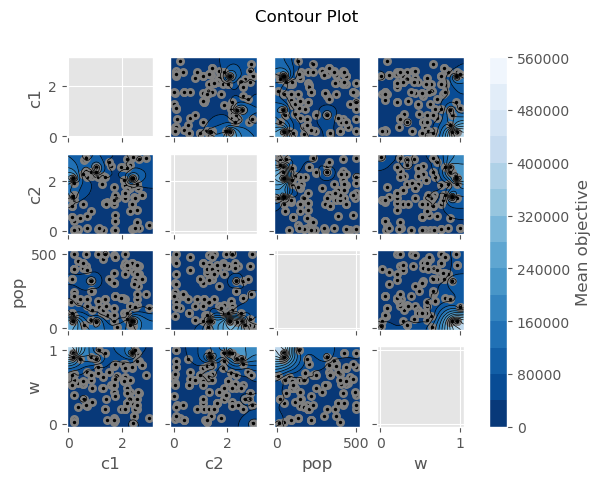

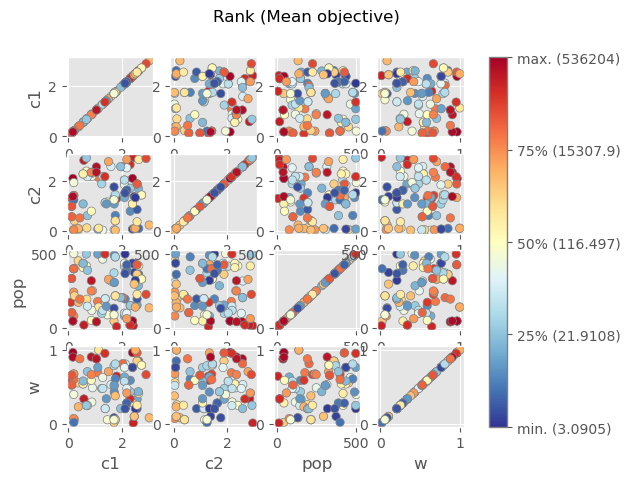

In [94]:
plot_pareto_front(study, target_names=["Mean objective", "Minimum iterations"])
plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Mean objective")
plot_param_importances(study, target=lambda t: t.values[0], target_name="Mean objective")
plot_contour(study, target=lambda t: t.values[0], target_name="Mean objective")
plot_rank(study, target=lambda t: t.values[0], target_name="Mean objective")

In [95]:
# Show the best trials.
for trial in study.best_trials:
    print("Params: ",trial.params, "Results (mean, iter_cov):",trial.values)

Params:  {'pop': 370, 'w': 0.809084362477775, 'c1': 2.1099296677858663, 'c2': 1.4406429107249044} Results (mean, var, iter_cov): [36.40212160409111, 163.0]
Params:  {'pop': 360, 'w': 0.8486223368146965, 'c1': 2.60243941834825, 'c2': 0.09038133660974025} Results (mean, var, iter_cov): [7.476131594603902, 188.0]
Params:  {'pop': 360, 'w': 0.8486223368146965, 'c1': 2.5438976769823527, 'c2': 1.8719399289620235} Results (mean, var, iter_cov): [1937.8481053641563, 46.0]
Params:  {'pop': 497, 'w': 0.20852270045087373, 'c1': 2.100930370263883, 'c2': 1.5153641872214425} Results (mean, var, iter_cov): [3.090497982736543, 199.0]
Params:  {'pop': 398, 'w': 0.022808999420559563, 'c1': 0.20912275735400576, 'c2': 1.2359900815760716} Results (mean, var, iter_cov): [7.530028433006012, 180.0]
Params:  {'pop': 435, 'w': 0.7639567732365038, 'c1': 2.375175146248718, 'c2': 0.06277212173501254} Results (mean, var, iter_cov): [5.2735515215941815, 198.0]
Params:  {'pop': 87, 'w': 0.059013512049042455, 'c1': 1.

The configuration yielding the best result comprised a population size of 497, an inertia weight (w) of 0.2085, a cognitive factor (c1) of 2.1009, and a social factor (c2) of 1.5154. In this setting, the algorithm achieved a mean objective function value of approximately 3.0905, indicating effective convergence to a near-optimal solution but still far from the global minimum. Conversely, the worst-performing configuration featured a population size of 360, an inertia weight (w) of 0.8486, a cognitive factor (c1) of 2.5439, and a social factor (c2) of 1.8719, resulting in a substantially higher mean objective function value of approximately 1937.8481, due to premature convergence.

In general the results are quite far from the global minimum and the executions converge near the maximum of iterations suggesting that this value is not large enough for the algorithm to converge successfully. Let's increase the maximum of iterations to 800 and test again.

In [23]:
def objective(trial):
    params = {
        "pop": trial.suggest_int("pop", 5, 500),
        'max_iter': 800,
        'w': trial.suggest_float("w", 0.00001, 1.0),
        'c1': trial.suggest_float("c1", 0.01, 3.0),
        'c2': trial.suggest_float("c2", 0.01, 3.0),
    }
    
    # Add a callback for pruning.
    _, mean_result, _, minimum_iter = monte_carlo(rounds, rosenbrock, 4, PSO, [-100, -100, -100, -100], [100, 100, 100, 100], params, log=False)
    return mean_result, minimum_iter

In [24]:
study = optuna.create_study(
    directions=["minimize","minimize"]
)
study.optimize(objective, callbacks=[MaxTrialsCallback(100, states=(TrialState.COMPLETE,))])

[I 2024-03-19 12:41:15,233] A new study created in memory with name: no-name-253f31a6-99f3-4277-9c24-50c1c203f765
[I 2024-03-19 12:41:20,357] Trial 0 finished with values: [28258.52828220313, 325.0] and parameters: {'pop': 14, 'w': 0.2449145101919691, 'c1': 1.1857845028752159, 'c2': 1.665992565720303}. 
[I 2024-03-19 12:41:33,796] Trial 1 finished with values: [995.1812226998345, 271.0] and parameters: {'pop': 53, 'w': 0.0781497130001729, 'c1': 1.2562263446035726, 'c2': 1.1028076808370628}. 
[I 2024-03-19 12:42:28,533] Trial 2 finished with values: [16.569661012082232, 644.0] and parameters: {'pop': 247, 'w': 0.0463876130212844, 'c1': 1.274183422204114, 'c2': 0.7676418194158318}. 
[I 2024-03-19 12:43:44,499] Trial 3 finished with values: [23.60773571272393, 775.0] and parameters: {'pop': 361, 'w': 0.13840534043057606, 'c1': 2.759317904779765, 'c2': 2.435985638671927}. 
[I 2024-03-19 12:44:50,754] Trial 4 finished with values: [29.64253522735562, 799.0] and parameters: {'pop': 310, 'w':

/tmp/ipykernel_1036/3439327190.py:1: ExperimentalWarning: plot_pareto_front is experimental (supported from v2.8.0). The interface can change in the future.
  plot_pareto_front(study, target_names=["Mean objective", "Minimum iterations"])
/tmp/ipykernel_1036/3439327190.py:2: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Mean objective")
/tmp/ipykernel_1036/3439327190.py:3: ExperimentalWarning: plot_param_importances is experimental (supported from v2.2.0). The interface can change in the future.
  plot_param_importances(study, target=lambda t: t.values[0], target_name="Mean objective")
/tmp/ipykernel_1036/3439327190.py:4: ExperimentalWarning: plot_contour is experimental (supported from v2.2.0). The interface can change in the future.
  plot_contour(study, target=lambda t: t.values[0], target_name="Mean objective")
[W 2024-03-19 1

array([[<Axes: ylabel='c1'>, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: ylabel='c2'>, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: ylabel='pop'>, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: xlabel='c1', ylabel='w'>, <Axes: xlabel='c2'>,
        <Axes: xlabel='pop'>, <Axes: xlabel='w'>]], dtype=object)

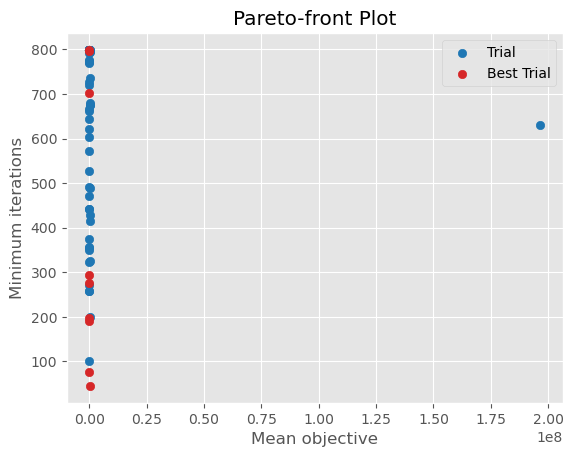

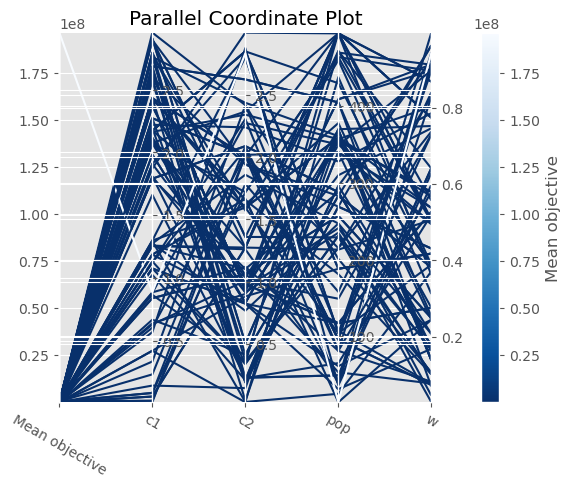

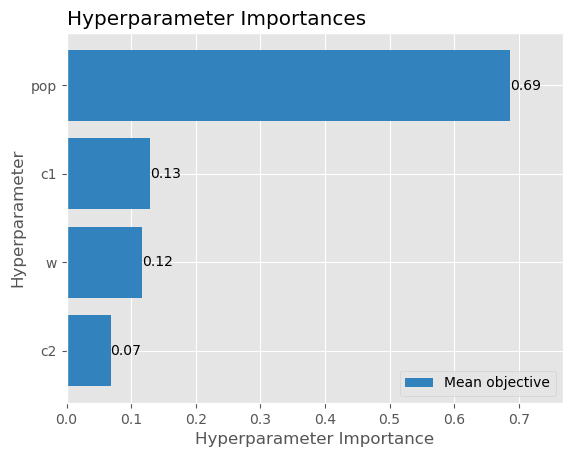

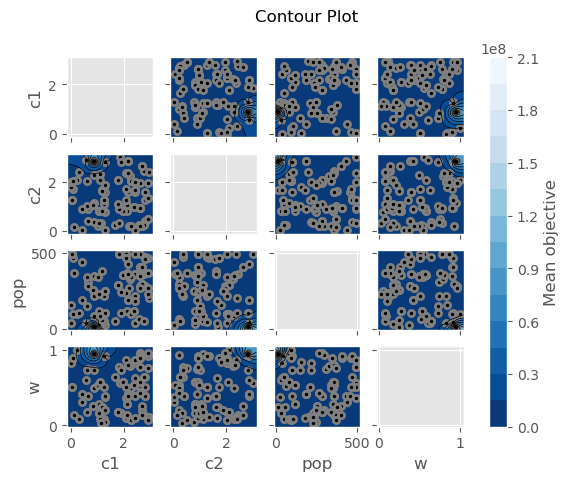

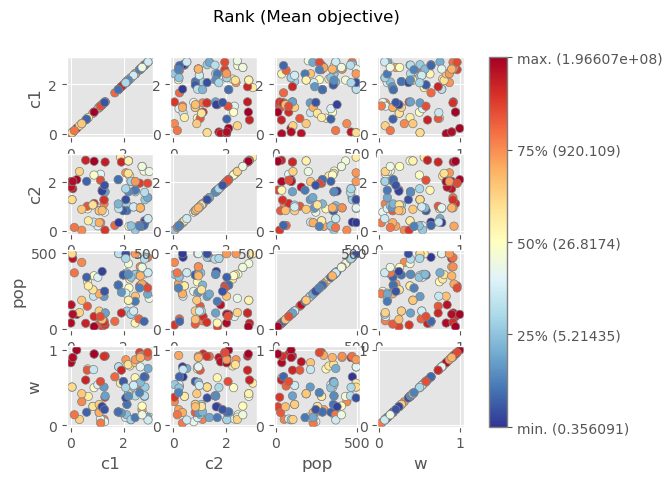

In [25]:
plot_pareto_front(study, target_names=["Mean objective", "Minimum iterations"])
plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Mean objective")
plot_param_importances(study, target=lambda t: t.values[0], target_name="Mean objective")
plot_contour(study, target=lambda t: t.values[0], target_name="Mean objective")
plot_rank(study, target=lambda t: t.values[0], target_name="Mean objective")

In [26]:
# Show the best trials.
for trial in study.best_trials:
    print("Params: ",trial.params, "Results (mean, iter_cov):",trial.values)

Params:  {'pop': 96, 'w': 0.07393768058102848, 'c1': 2.271075082668922, 'c2': 2.0181405314164294} Results (mean, iter_cov): [3.054568227194606, 702.0]
Params:  {'pop': 409, 'w': 0.8973600023592742, 'c1': 2.6189740364866227, 'c2': 0.942740485153258} Results (mean, iter_cov): [413.1104635996104, 190.0]
Params:  {'pop': 241, 'w': 0.16442177660240767, 'c1': 1.9083428962206845, 'c2': 0.9478754387476633} Results (mean, iter_cov): [3.629001641525871, 294.0]
Params:  {'pop': 104, 'w': 0.9162301449663681, 'c1': 1.2975435014826318, 'c2': 2.8020238573682237} Results (mean, iter_cov): [288281.5721652774, 45.0]
Params:  {'pop': 472, 'w': 0.6409433717638277, 'c1': 2.794423097159399, 'c2': 0.3630640676011061} Results (mean, iter_cov): [0.3560910477904409, 799.0]
Params:  {'pop': 496, 'w': 0.7736741880802385, 'c1': 1.807610817580684, 'c2': 0.34342000481967255} Results (mean, iter_cov): [0.8060303577036864, 797.0]
Params:  {'pop': 296, 'w': 0.9250159897374808, 'c1': 2.6808629339643364, 'c2': 0.19845776

This optimal configuration consisted of a population size of 472, an inertia weight (w) of 0.6409, a cognitive factor (c1) of 2.7944, and a social factor (c2) of 0.3631. In this setup, the algorithm achieved a relatively low mean objective function value of approximately 0.3561, indicating superior convergence to a near-optimal solution. The high exploration capability afforded by the larger population size likely facilitated effective exploration of the search space, while the balanced cognitive and social factors contributed to efficient exploitation of promising regions. Furthermore, the moderate inertia weight ensured a balance between exploration and exploitation, enabling the algorithm to avoid premature convergence while efficiently converging towards the optimal solution.

The best parameter set results are shown below:

Minimum of objective function: 4.270264284813067e-11
Minimum found in round: 68
Minimum found in iteration: 797
Mean of objective function: 0.003922025966736758
Variance of objective function: 0.0003102403210185933
Monte Carlo standard error: 0.0017613640197829447


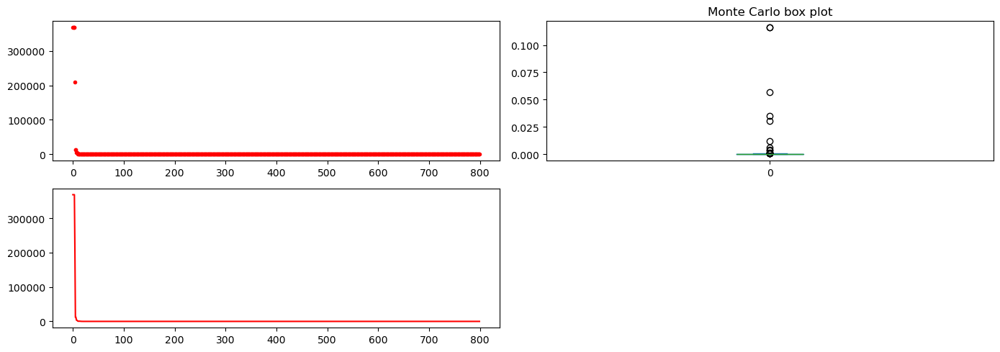

In [17]:
params = {'pop': 472, 'w': 0.6409433717638277, 'c1': 2.794423097159399, 'c2': 0.3630640676011061, 'max_iter': 800}
results = monte_carlo(rounds, rosenbrock, 4, PSO, [-100, -100, -100, -100], [100, 100, 100, 100], params, plot=True)

Compared with the parameter set obtained from grid search (**{'pop': 500, 'max_iter': 800, 'w': 0.01, 'c1': 0.5, 'c2': 2.5}**) whose mean objective function value was 0.333, we obtain a lower mean of objective function of only 0.0039, but we are not able to find the global minimum of 0 in any Monte Carlo round. Maybe further experimentation or different parameters are required.

### 4. Find the optimal tour in a Monte Carlo loop

In [2]:
# AUXILIARY FUNCTIONS
def TourLength(T):
  t=len(T)
  prev=T[t-1]
  length=0.0
  for i in range(0,t):
    curr=T[i]
    length+=DistanceRounded(prev,curr)
    prev=curr
  return length

def ReadTsp(fn):
  f=open(fn+".tsp","rt")
  reader=csv.reader(f,delimiter=" ",skipinitialspace=True)
  coordinates=False
  cities=[]
  best=0.0
  index=0
  for row in reader:
    if row[0]=="EOF":
      break
    elif coordinates:
      cities.append((float(row[1]),float(row[2]),index))
      index+=1
    elif row[0]=="BEST:":
      best=float(row[1])
    elif row[0]=="NAME:":
      print("reading tour",row[1])
    elif row[0]=="NODE_COORD_SECTION":
      coordinates=True
  f.close()
  opt=[]
  try:
    f=open(fn+".opt.tour","rt")
    reader=csv.reader(f,delimiter=" ",skipinitialspace=True)
    coordinates=False
    for row in reader:
      if row[0]=="EOF" or row[0]=="-1":
        break
      elif coordinates:
        index=int(row[0])
        opt.append((cities[index-1][0],cities[index-1][1],index))
      elif row[0]=="NAME:":
        print("reading optimal tour",row[1])
      elif row[0]=="TOUR_SECTION":
        coordinates=True
  except FileNotFoundError:
    print("optimal tour not available")
  finally:
    f.close()

  print("reading done",best)
  return cities,best,opt

def WriteTsp(fn,T):
  f=open(fn+".opt.tour","wt")
  f.write("NAME: "+fn+".opt.tour\n")
  f.write("COMMENT : Length "+str(TourLength(T))+"\n")
  f.write("COMMENT : Found by tsp [Jose Angel Perez PSOrrido]\n")
  f.write("TYPE: TOUR\n")
  f.write("DIMENSION: "+str(len(T))+"\n")
  f.write("TOUR_SECTION\n")
  for t in T:
    f.write(str(t[2]+1)+"\n")
  f.write("-1\n")
  f.write("EOF\n")
  f.close()
  print("writing done")

def Distance(p,q):
  """Returns distance between points p and q assuming that the x- and
  y-coordinates are the first and second entry of the point-tuple"""
  #return math.fabs(p[0]-q[0])+math.fabs(p[1]-q[1])
  return math.hypot(p[0]-q[0],p[1]-q[1])

def DistanceRounded(p,q):
  """Returns rounded distance between points p and q assuming that the x- and
  y-coordinates are the first and second entry of the point-tuple"""
  #return int(math.fabs(p[0]-q[0])+math.fabs(p[1]-q[1])+0.5)
  return int(math.hypot(p[0]-q[0],p[1]-q[1])+0.5)

def TourError(T,best_length):
  return 100.0*(TourLength(T)-best_length)/best_length

def MakeTourWithCities(I,C):
  T=[]
  for i in I:
    T.append((C[i][0],C[i][1],i))
  return T

def PlotTour(T,col,show=False,onlypoints=False,fn=None):
  if T!=[]:
    T.append(T[0])
    x,y,i = zip(*T)
    T.pop(-1)
    fig,ax=plt.subplots(figsize=(12.8,9.6))
    for label in (ax.get_xticklabels()+ax.get_yticklabels()):
      label.set_fontsize(16)

    if onlypoints==True:
      ax.scatter(
        x,y,s=100,color=col,marker="o",linewidth=3
      )
    else:
      ax.plot(
        x,y,color=col,marker="o",linewidth=3,markeredgewidth=3,markersize=10
      )
  if fn!=None:
    plt.savefig(fn,transparent=True,bbox_inches='tight')
  if show==True:
    plt.show()

showProgress=False
def PlotProgressTour(C,T,col,show=False,onlypoints=False,fn=None):
  if not showProgress:
    return
  fig,ax=plt.subplots(figsize=(12.8,9.6))
  ax.axis('equal')
  for label in (ax.get_xticklabels()+ax.get_yticklabels()):
    label.set_fontsize(16)
  x,y,i = zip(*C)
  ax.scatter(
    x,y,s=100,color=col,marker="o",linewidth=3
  )
  offset=0
  if T!=[]:
    T.append(T[0])
    x,y,i = zip(*T)
    T.pop(-1)
    if onlypoints==True:
      ax.scatter(
        x,y,s=100,color="cyan",marker="o",linewidth=3
      )
      offset=len(C)
    else:
      ax.plot(
        x,y,color="cyan",marker="o",linewidth=3,markeredgewidth=3,markersize=10
      )
  if fn!=None:
    plt.savefig(fn+"%03d"%(len(T)+offset),transparent=True,bbox_inches='tight')
  if show==True:
    plt.show()

def TriangleSides(prev,curr,p):
  s0=Distance(prev,curr)
  s1=Distance(prev,p)
  s2=Distance(p,curr)
  return s0,s1,s2

### The quick tour approach

  idea:
  - generate a random permutation of the cities
  - take the first three cities to form a triangle to start with
  - proceed with the rest of the points in given random order
    and insert a new city such that the tour increase is minimal
    among all possible insertions
  - stop when there is no more city

In [3]:
def BestInsertionIndex(T,p):
  
  t=len(T)
  prev=T[t-1]
  curr=T[0]
  s0,s1,s2=TriangleSides(prev,curr,p)
  best_i,shortest=0,s1+s2-s0
  prev=curr
  for i in range(1,t):
    curr=T[i]
    s0,s1,s2=TriangleSides(prev,curr,p)
    increase=s1+s2-s0
    if increase<shortest:
      best_i,shortest=i,increase
    prev=curr
  # print("shortest",shortest,"at",best_i)
  return best_i

def QuickTour(Cities,rounds,best_length):
  min_error=sys.float_info.max
  best_tour=[]
  for j in range(0,rounds): # the Monte Carlo loop
    cities=Cities.copy()       # take a new copy of the cities
    random.shuffle(cities)     # mix them up
    tour=[]
    tour.append(cities.pop(0)) # take the first three as starting triangle
    tour.append(cities.pop(0))
    tour.append(cities.pop(0))

    while cities!=[]:  # while there are still unconnected cities
      PlotProgressTour(
        Cities,tour,"skyblue",show=True,onlypoints=False,fn="progress_QT"
      )
      c=cities.pop(0)  # take the next city
      i=BestInsertionIndex(tour,c)  # get tour segment with smallest increase
      tour.insert(i,c) # insert city replacing the segment by two new ones
    PlotProgressTour(
      Cities,tour,"skyblue",show=True,onlypoints=False,fn="progress_QT"
    )

    error=TourError(tour,best_length)
    print(j+1,"relative error quick tour: ",error,"%")
    if error<min_error:
      min_error=error
      best_tour=tour.copy()
    if error==0.0: # the Las VePSOs condition
      print("optimum found in",j,"rounds")
      WriteTsp("bestTour",best_tour)
      break
  return best_tour,min_error

###  The classical closest-neighbor approach
  idea:
  - select a random city
  - proceed with connecting the closest still unconnected city
  - stop when there is no more city

In [4]:
def ClosestNeighborTour(Cities,rounds,best_length):
  min_error=sys.float_info.max
  best_tour=[]
  # because we have random tie break, more rounds than there are points
  # can be advantageous
  for j in range(0,rounds): # the Monte Carlo loop
    cities=Cities.copy()
    random.shuffle(cities)
    tour=[]
    tour.append(cities.pop(0))
    while cities!=[]:
      min_dis=sys.float_info.max
      p=tour[0][0],tour[0][1]
      candidates=[]
      for i in range(0,len(cities)):
        q=cities[i][0],cities[i][1]
        dis=Distance(p,q)
        if dis<min_dis:
          min_dis=dis
          candidates=[]
          candidates.append(i)
        elif dis==min_dis:
          candidates.append(i)
      tour.insert(0,cities.pop(candidates[random.randrange(len(candidates))]))
      PlotProgressTour(Cities,tour,"red",show=True,fn="progress_CN")

    error=TourError(tour,best_length)
    print(j+1,"relative error closest neighbor: ",error,"%")
    if error<min_error:
      min_error=error
      best_tour=tour.copy()
    if error==0.0: # the Las VePSOs condition
      print("optimum found in",j,"rounds")
      break
  return best_tour,min_error

### The pair-center tour approach
  idea:
  - find closest pair among all pairs of cities
  - substitute this pair of cities by a center city
  - proceed until there is only one city left
  - now we have a binary tree structure
  - travel through the tree top-down and replace
    a "center" by its underlying pair taking care of inserting
    the best possibility
  - stop when all pairs are handled
  
The algorithm uses a data structure of a dictionary to hold the binary tree. Each entry in the dictionary uses as key the index of the current point (either an orignal city or a center being constructed during the progress of the algorithm) and as information a tuple that holds both indices of the points being paired and the coordinates. Hence the tuple `(i,j,x,y)` is the center of points with index `i` and index `j` at location `(x,y)`.

In [5]:
def ClosestPair(L):
  t=len(L)
  best=sys.float_info.max
  pairs=[]
  for i in range(0,t):
    for j in range(i+1,t):
      s0=Distance(L[i],L[j])
      if s0<best:
        best=s0
        pairs=[]
        pairs.append((i,j))
      elif s0==best:
        pairs.append((i,j))
  return pairs[random.randrange(len(pairs))]

def MakeTourWithDictionary(I,D):
  T=[]
  for i in I:
    T.append((D[i][2],D[i][3],i))
  return T

def PairCenterTour(Cities,best_length):
  cities=Cities.copy()
  mark=0
  D={}
  for p in Cities:
    D[mark]=(-1,-1,p[0],p[1])
    mark+=1

  # Deterministic algorithm with pair-center connections
  # First build the binary tree inserting the corresponding centers
  while len(cities)>1:
    a,b=ClosestPair(cities);
    x,y=0.5*(cities[a][0]+cities[b][0]),0.5*(cities[a][1]+cities[b][1])
    D[mark]=(cities[a][2],cities[b][2],x,y)
    cities[a]=(x,y,mark)
    mark+=1
    cities.pop(b)
    PlotProgressTour(
      Cities,cities,"blue",show=True,onlypoints=True,fn="progress_PC"
    )

  # Run the tree downwards and insert the corresponding pair in
  # the best possible way
  mark-=1
  L=[]
  L.append(D[mark][0])
  PlotProgressTour(
    Cities,MakeTourWithDictionary(L,D),"blue",show=True,
    onlypoints=False,fn="progress_PC"
  )
  L.append(D[mark][1])
  PlotProgressTour(
    Cities,MakeTourWithDictionary(L,D),"blue",show=True,
    onlypoints=False,fn="progress_PC"
  )
  t=len(Cities)
  for m in range(mark-1,t-1,-1):
    i=L.index(m)
    Di0=D[L[i]][0]
    Di1=D[L[i]][1]
    q=(D[Di0][2],D[Di0][3])
    r=(D[Di1][2],D[Di1][3])
    p=s=(0,0)
    if i==len(L)-1:
      p=(D[L[i-1]][2],D[L[i-1]][3])
      s=(D[L[0]][2],D[L[0]][3])
    elif i==0:
      p=(D[L[len(L)-1]][2],D[L[len(L)-1]][3])
      s=(D[L[1]][2],D[L[1]][3])
    else:
      p=(D[L[i-1]][2],D[L[i-1]][3])
      s=(D[L[i+1]][2],D[L[i+1]][3])

    if Distance(p,q)+Distance(r,s)>Distance(p,r)+Distance(q,s):
      L[i]=D[m][1]
      L.insert(i+1,D[m][0])
    else:
      L[i]=D[m][0]
      L.insert(i+1,D[m][1])
    PlotProgressTour(
      Cities,MakeTourWithDictionary(L,D),"blue",show=True,
      onlypoints=False,fn="progress_PC"
    )

  tour=MakeTourWithDictionary(L,D)
  error=TourError(tour,best_length)
  return tour,error

### The PSO tour

We implement the computation of a tour with the genetic algorithm from the `scikit-opt` package embedded into a Monte Carlo loop with a certain number of rounds.

We keep and return the best tour that we found during the Monte Carlo loop.

In [6]:
# Monte Carlo PSO Tour
def MonteCarloPSOTour(rounds,cities,best_length, algorithm_params, plot=False):
  n=len(cities)
  points_coordinate=[(l[0],l[1]) for l in cities]

  dist_mat=spatial.distance.cdist(
    points_coordinate, points_coordinate, metric='euclidean'
  )

  def cal_total_distance(routine):
    '''The objective function. input routine, return total distance.
    cal_total_distance(np.arange(n))
    '''
    n, = routine.shape
    return sum([dist_mat[routine[i%n], routine[(i+1)%n]] for i in range(n)])

  # Auxiliary variables
  distance_values = []
  best_error = float('inf')
  best_tour = None
  best_PSO = None

  for i in range(rounds): # Monte Carlo loop
    PSO_tsp=PSO_TSP(
      func=cal_total_distance, n_dim=n, **algorithm_params
    )

    #PSO_tsp.to(device=device) # use GPU if available (NOT AVAILABLE)

    best_points, best_distance = PSO_tsp.run()
    distance_values.append(best_distance)

    T=MakeTourWithCities(best_points,cities)
    error=TourError(T,best_length)

    # Update best tour found during the Monte Carlo loop
    if error < best_error:
      best_error = error
      best_tour = best_points
      best_PSO = PSO_tsp

  # Calculate minimum, mean, and variance of the objective function
  min_distance = np.min(distance_values)
  mean_distance = np.mean(distance_values)
  variance_distance = np.var(distance_values)

  # Compute Monte Carlo Standard Error (MCSE)
  mcse = np.sqrt(variance_distance) / np.sqrt(rounds)

  print("Minimum of objective function:", min_distance)
  print("Mean of objective function:", mean_distance)
  print("Variance of objective function:", variance_distance)
  print("Monte Carlo standard error:", mcse)

  T=MakeTourWithCities(best_tour,cities)
  error=TourError(T,best_length)

  # Plot best PSO
  if(plot):
      Y_history = pd.DataFrame(best_PSO.gbest_y_hist)
      
      # Plot the results as a box plot
      fig, axs = plt.subplots(2, 2, figsize=(14, 5))

      # Plot Y_history
      axs[0, 0].plot(Y_history.index, Y_history.values, '.', color='red')
      Y_history.min(axis=1).cummin().plot(kind='line', ax=axs[1, 0], color='red')

      # Remove the empty subplot in the second row
      fig.delaxes(axs[1, 1])

      # Plot the box plot
      results_df = pd.DataFrame(distance_values)
      results_df.plot(kind='box', title='Monte Carlo box plot', ax=axs[0, 1])

      plt.tight_layout()  # Adjust layout for better spacing
      plt.show()

  return T,error

####  Minimize TSP using Optuna - Experimenting with free parameters

For the following experiments we will use **Optuna**, an open-source parameter optimization. It automates the process of tuning to maximize their performance. Optuna uses various algorithms and strategies, such as Bayesian optimization, to efficiently search through the parameter space and find the optimal configuration for a given objective function, unlike grid search which exhaustively explores a predefined set of parameters. In addition, it offers plots helpful to detect possible correlations between parameters configurations.

First we are going to check what happens when we vary the value of one parameter where maintaining the others frozen. We will keep the values from the example of the Guofei-package as the default values and we will use the most complex map (`rat195`).

In [9]:
rounds = 10

filename='rat195'
theCities,bestLength,bestTour=ReadTsp(TOURS_PATH+"/"+filename)
if bestTour != [] and bestLength!=TourLength(bestTour):
  print("strange best tour given",TourLength(bestTour))

reading tour rat195
reading done 2323.0


#### Varying population size
We will analyze 10 different values for the population size between 5 and 500.

[I 2024-03-28 13:27:57,975] A new study created in memory with name: no-name-f0ac4257-f969-4bd3-a10c-37675bc12391


Minimum of objective function: 8521.544183151478
Mean of objective function: 8987.53496948922
Variance of objective function: 80059.03440936489
Monte Carlo standard error: 89.47571425217286


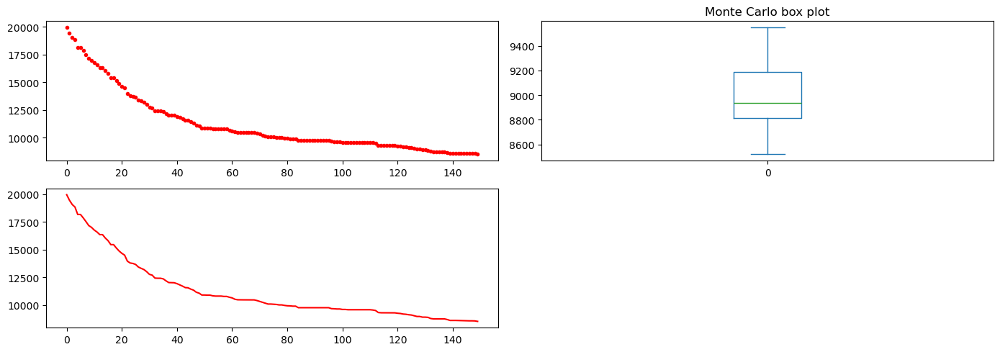

relative error PSO algorithm:  266.7240637107189 %


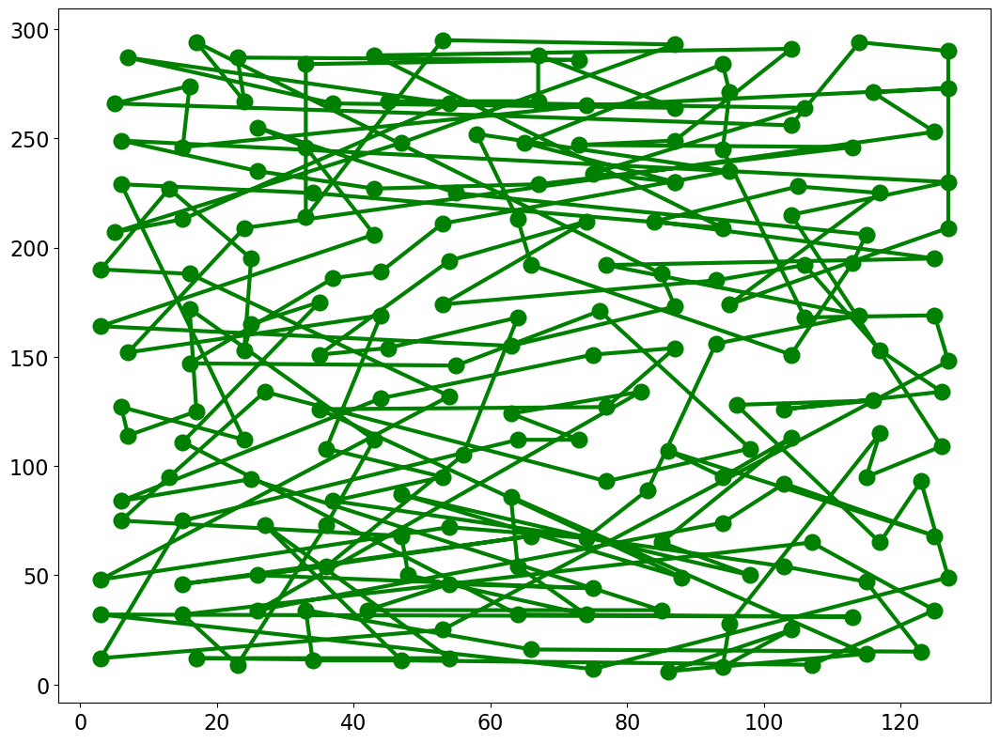

[I 2024-03-28 13:29:29,916] Trial 0 finished with value: 266.7240637107189 and parameters: {'pop': 187}. Best is trial 0 with value: 266.7240637107189.


Minimum of objective function: 6918.403275771873
Mean of objective function: 7753.014850766098
Variance of objective function: 213464.80654834892
Monte Carlo standard error: 146.10434851446036


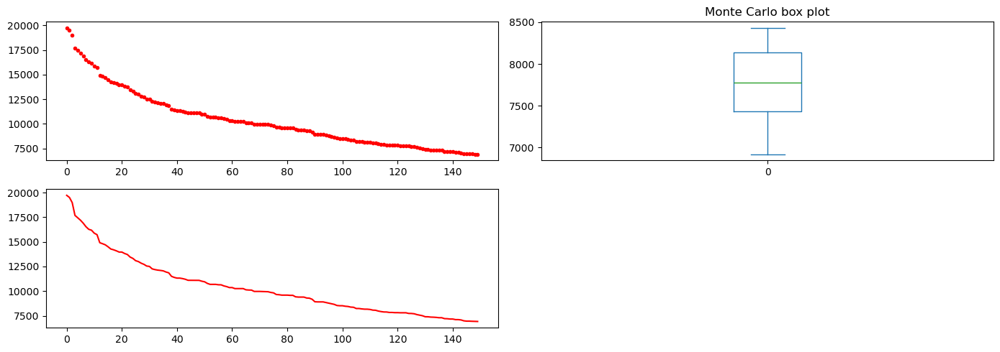

relative error PSO algorithm:  197.28798966853208 %


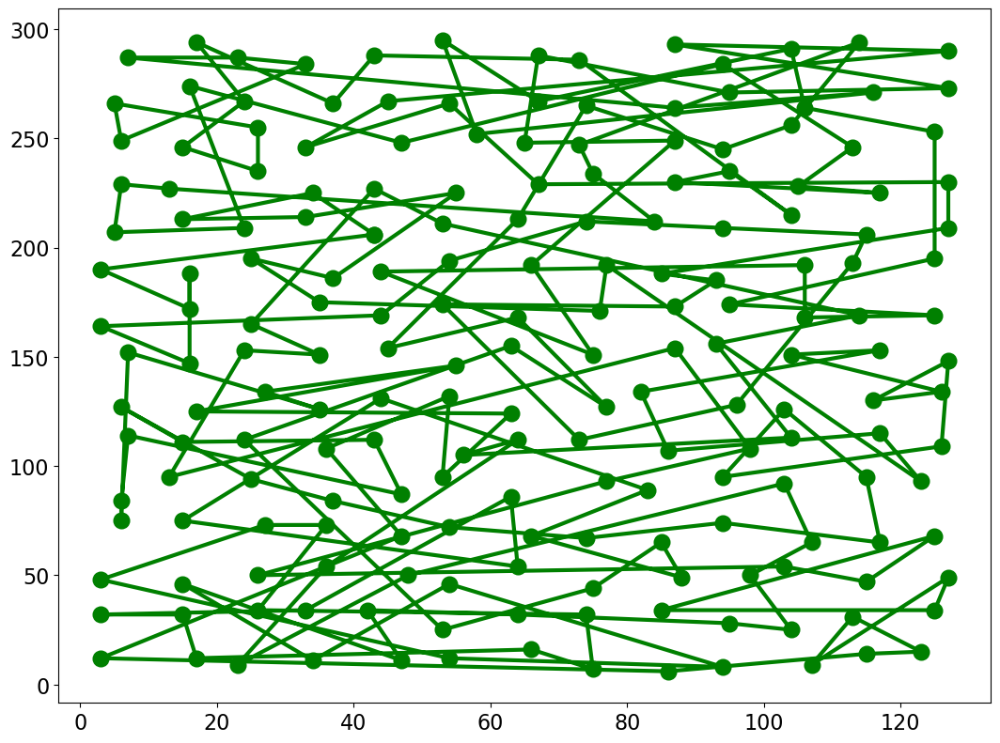

[I 2024-03-28 13:33:08,173] Trial 1 finished with value: 197.28798966853208 and parameters: {'pop': 449}. Best is trial 1 with value: 197.28798966853208.


Minimum of objective function: 7933.244107765063
Mean of objective function: 8599.48086408339
Variance of objective function: 227225.0060463794
Monte Carlo standard error: 150.7398441177313


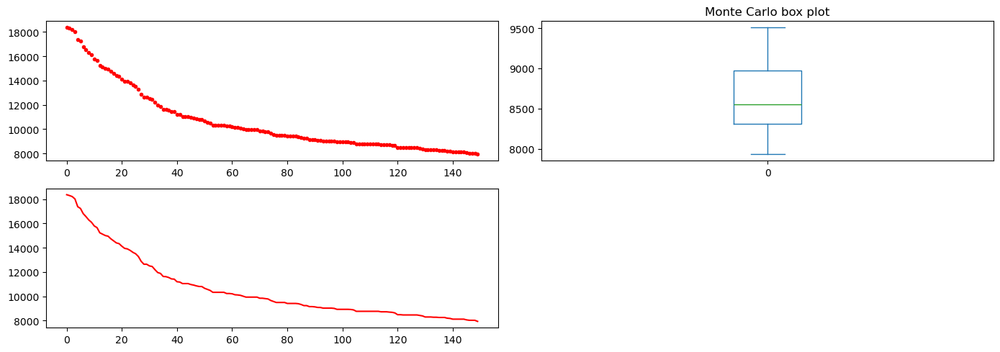

relative error PSO algorithm:  241.2397761515282 %


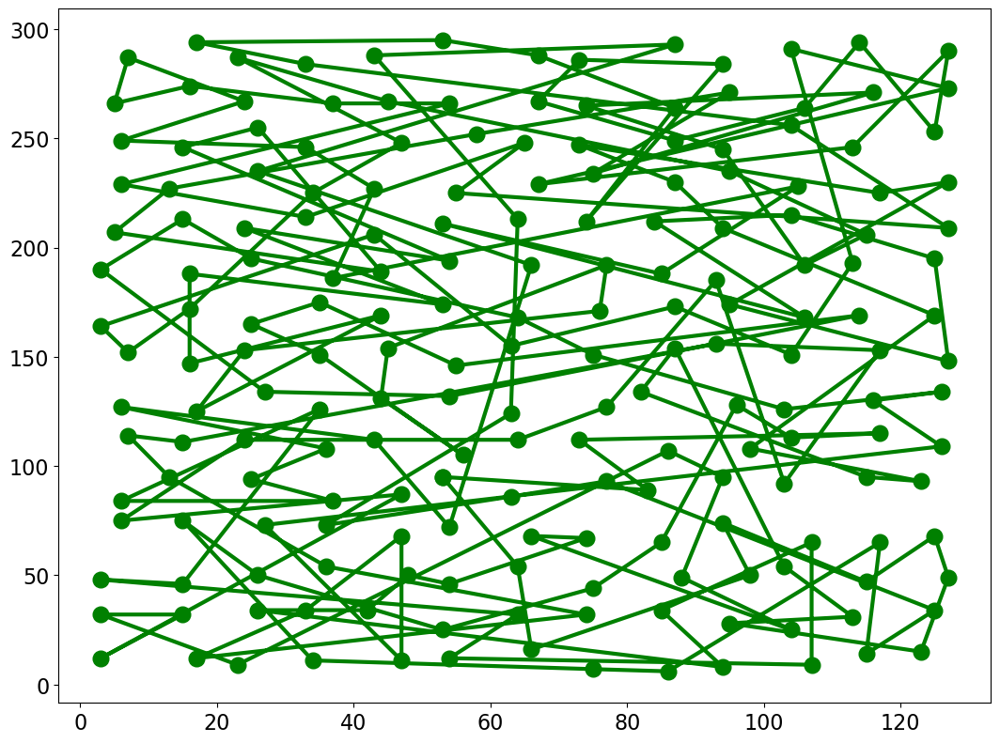

[I 2024-03-28 13:35:18,402] Trial 2 finished with value: 241.2397761515282 and parameters: {'pop': 273}. Best is trial 1 with value: 197.28798966853208.


Minimum of objective function: 7411.255178377803
Mean of objective function: 7945.201237356933
Variance of objective function: 89486.9794180996
Monte Carlo standard error: 94.59755780045253


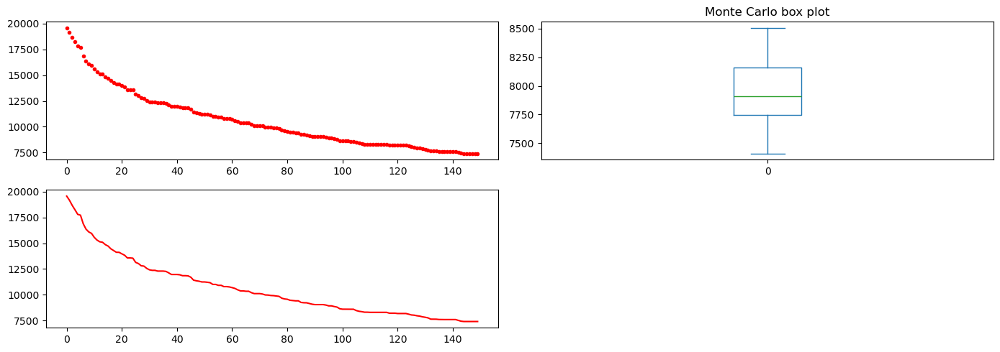

relative error PSO algorithm:  218.8118811881188 %


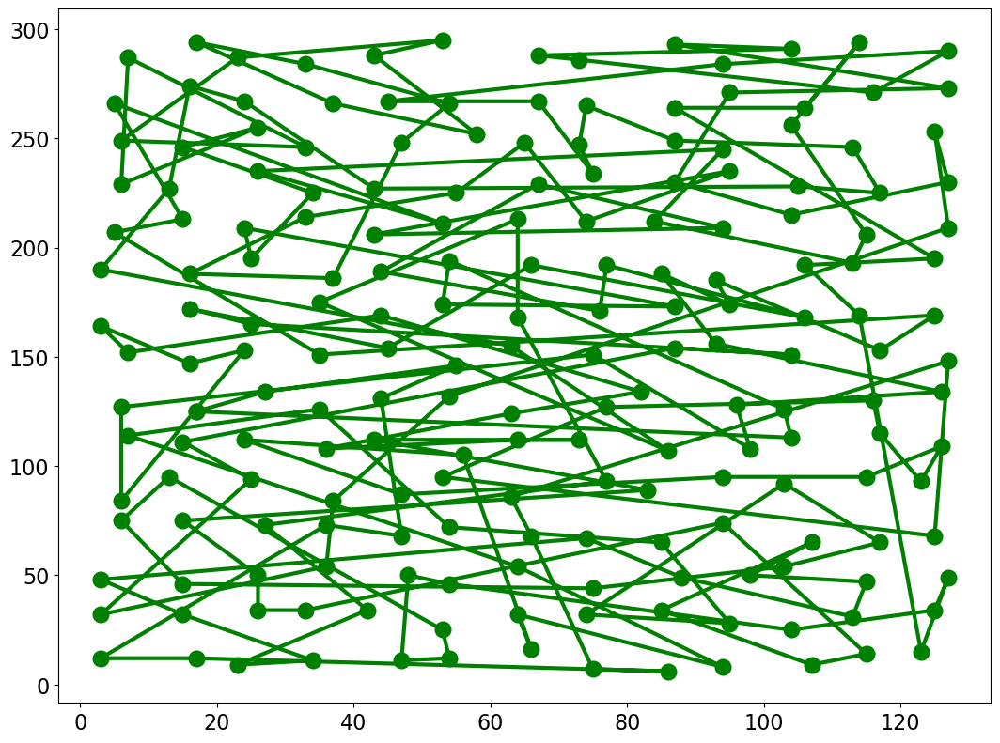

[I 2024-03-28 13:38:05,813] Trial 3 finished with value: 218.8118811881188 and parameters: {'pop': 349}. Best is trial 1 with value: 197.28798966853208.


Minimum of objective function: 7806.74463390837
Mean of objective function: 8278.911432589583
Variance of objective function: 70812.94269157821
Monte Carlo standard error: 84.15042643479485


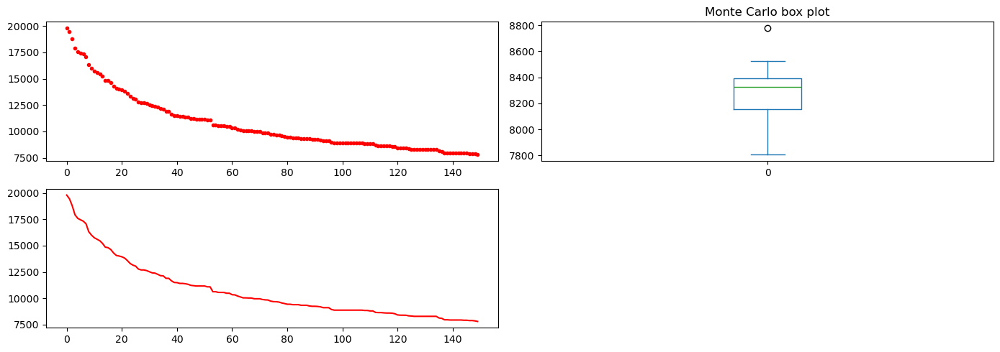

relative error PSO algorithm:  235.8588032716315 %


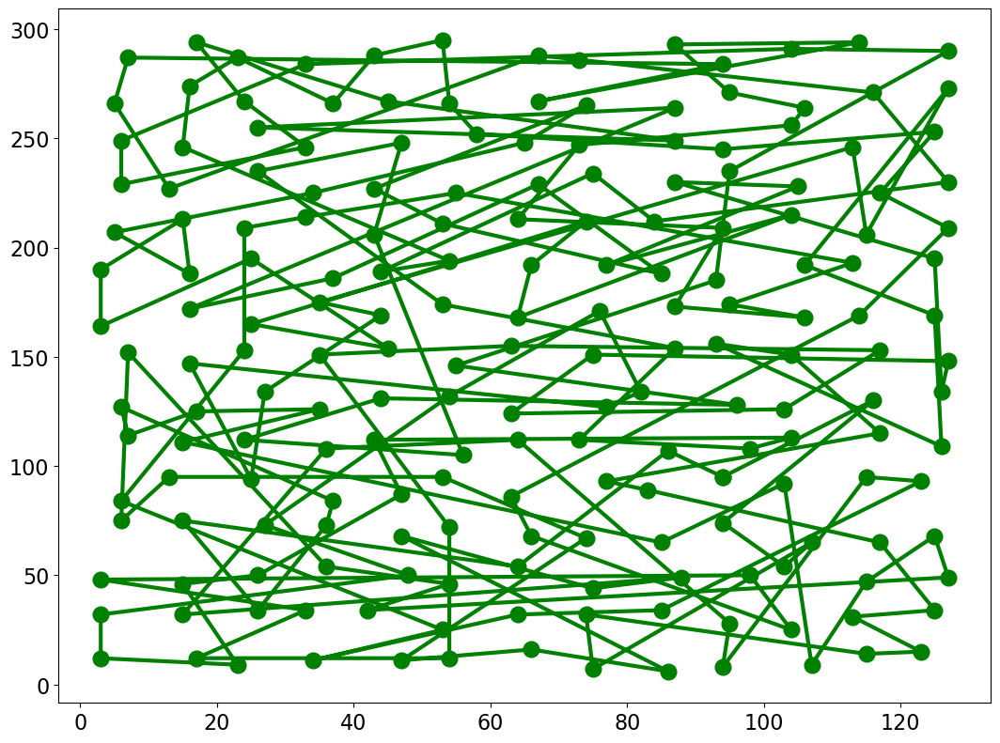

[I 2024-03-28 13:40:32,214] Trial 4 finished with value: 235.8588032716315 and parameters: {'pop': 309}. Best is trial 1 with value: 197.28798966853208.


Minimum of objective function: 8044.364769288227
Mean of objective function: 8733.865707568344
Variance of objective function: 243692.59826958444
Monte Carlo standard error: 156.10656561131066


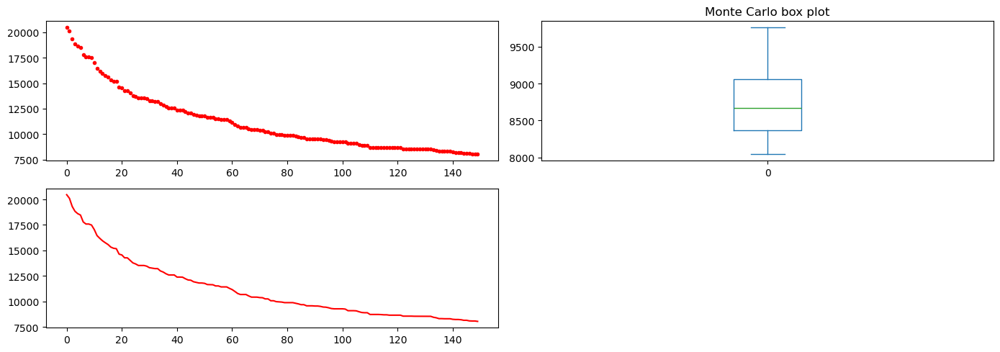

relative error PSO algorithm:  246.06112785191561 %


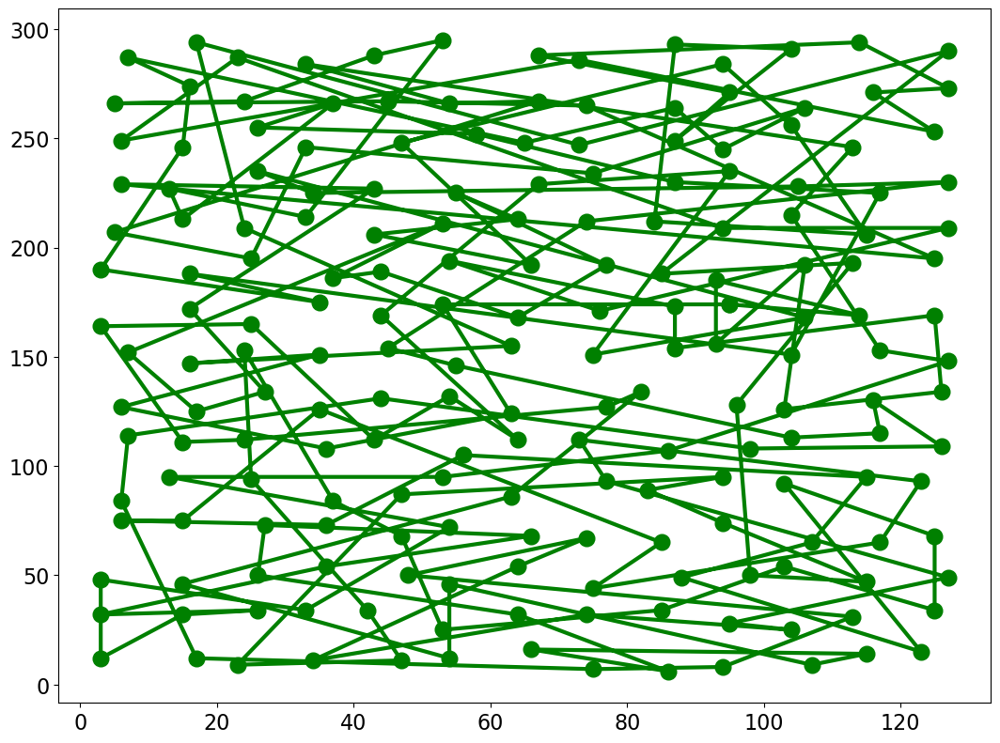

[I 2024-03-28 13:42:15,890] Trial 5 finished with value: 246.06112785191561 and parameters: {'pop': 217}. Best is trial 1 with value: 197.28798966853208.


Minimum of objective function: 8847.445377884223
Mean of objective function: 9632.153446549035
Variance of objective function: 302408.6309746886
Monte Carlo standard error: 173.8990025775561


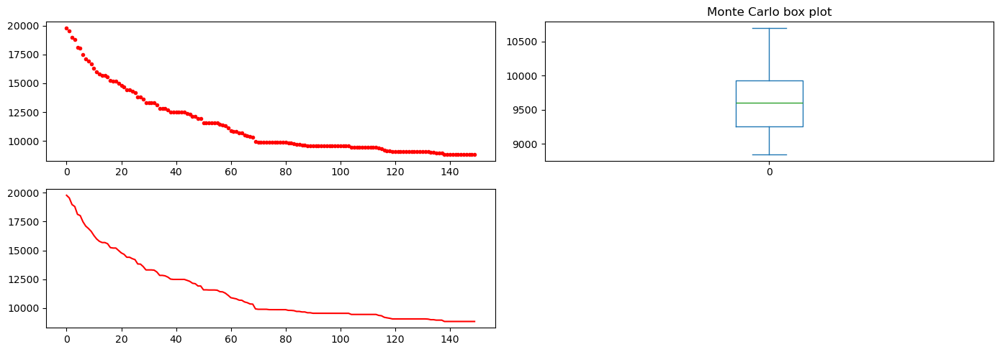

relative error PSO algorithm:  280.45630650021525 %


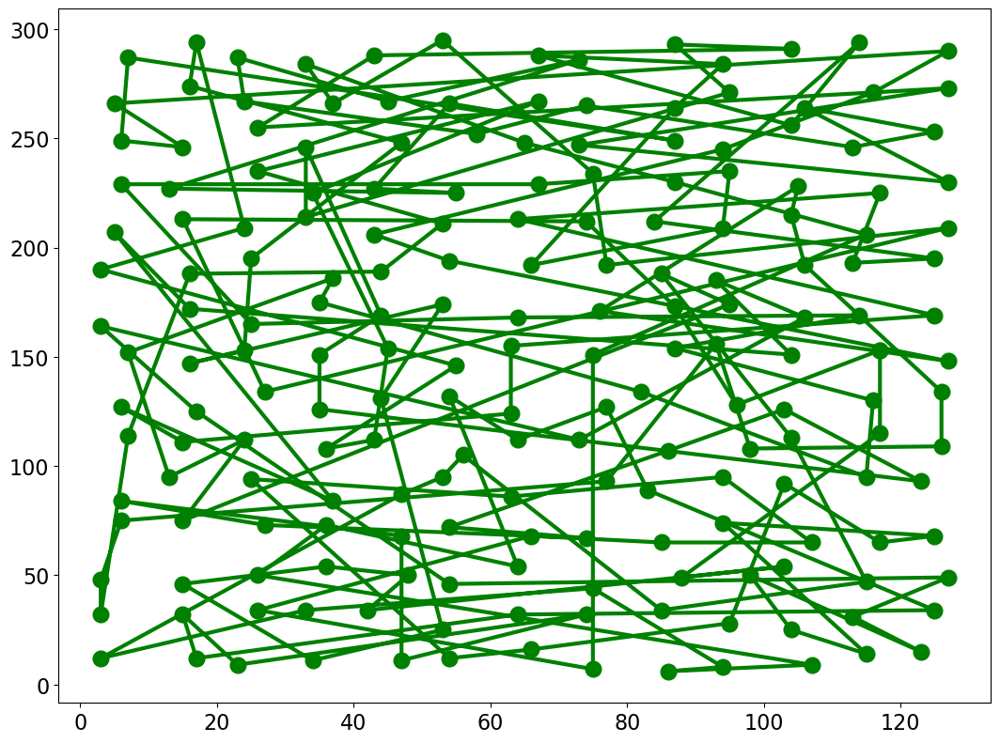

[I 2024-03-28 13:43:06,055] Trial 6 finished with value: 280.45630650021525 and parameters: {'pop': 104}. Best is trial 1 with value: 197.28798966853208.


Minimum of objective function: 7686.985049333555
Mean of objective function: 8310.475647956988
Variance of objective function: 122147.53489250146
Monte Carlo standard error: 110.52037590078194


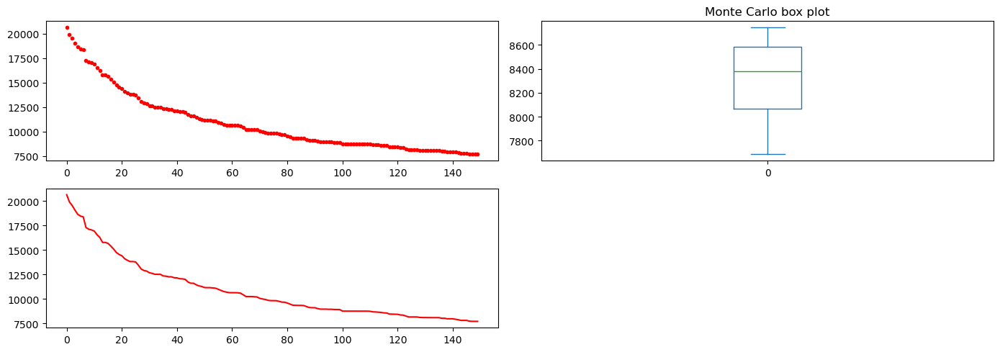

relative error PSO algorithm:  230.60697374085234 %


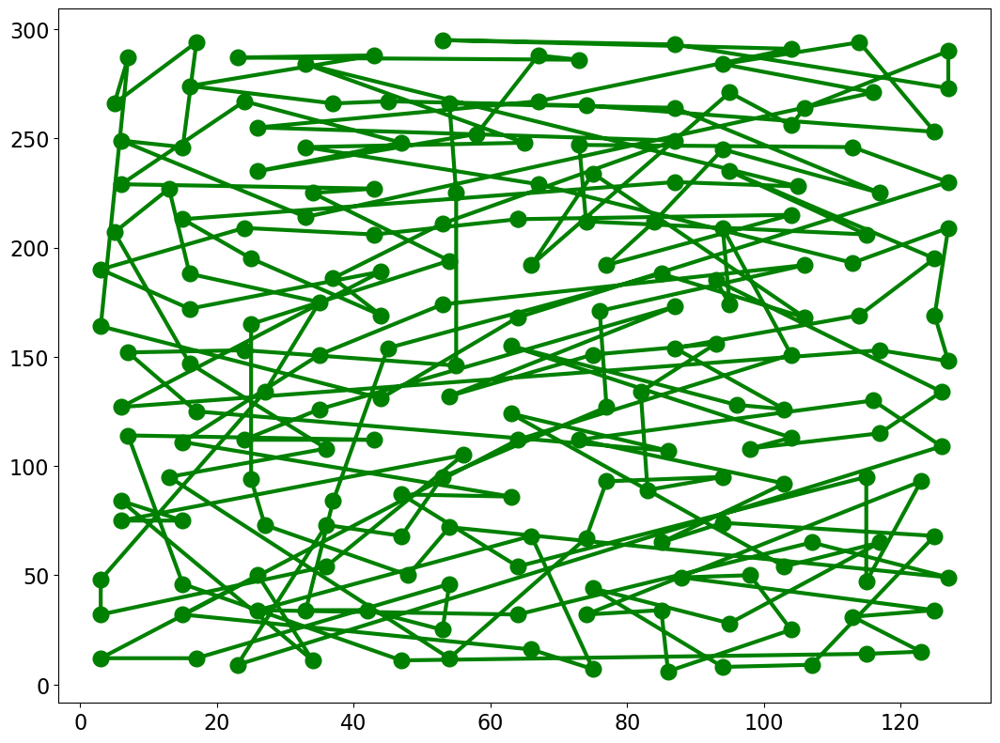

[I 2024-03-28 13:45:11,287] Trial 7 finished with value: 230.60697374085234 and parameters: {'pop': 262}. Best is trial 1 with value: 197.28798966853208.


Minimum of objective function: 8914.892066598455
Mean of objective function: 9318.273856519134
Variance of objective function: 109123.76891928099
Monte Carlo standard error: 104.46232283425492


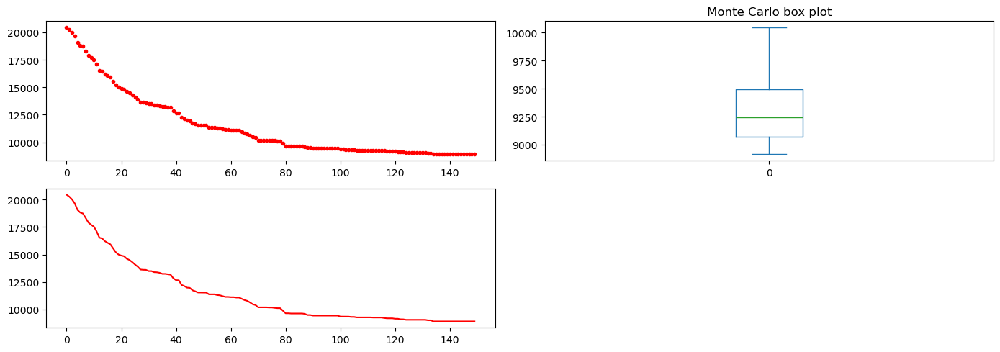

relative error PSO algorithm:  283.6418424451141 %


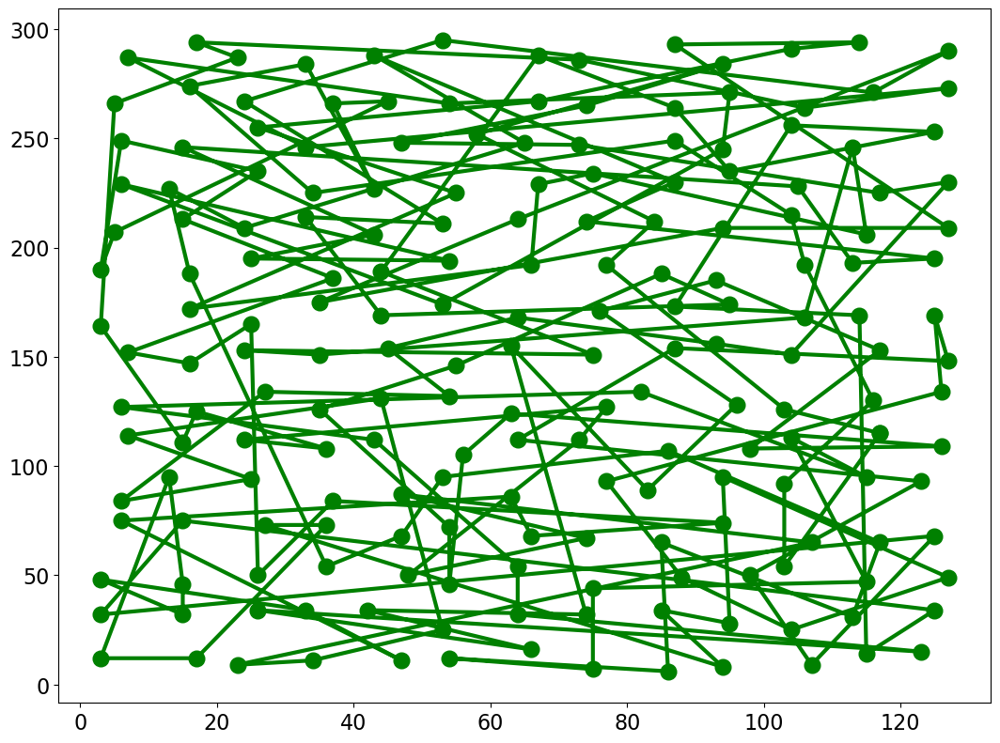

[I 2024-03-28 13:46:20,273] Trial 8 finished with value: 283.6418424451141 and parameters: {'pop': 143}. Best is trial 1 with value: 197.28798966853208.


Minimum of objective function: 9865.795271183006
Mean of objective function: 10701.657557943812
Variance of objective function: 200838.73740685015
Monte Carlo standard error: 141.7175844441508


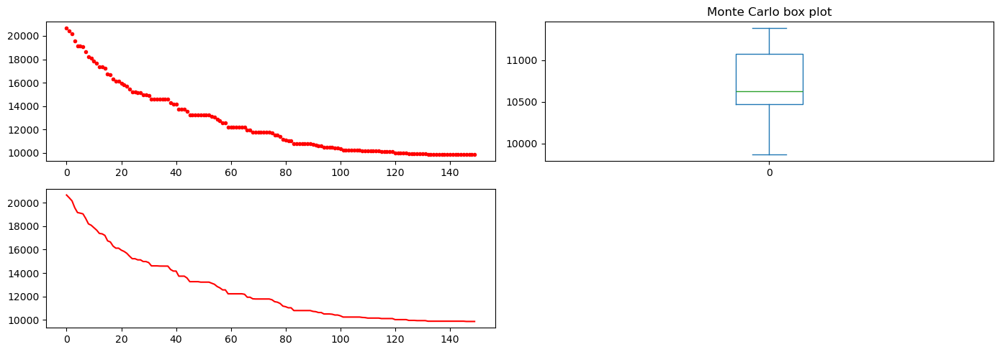

relative error PSO algorithm:  324.62333189840723 %


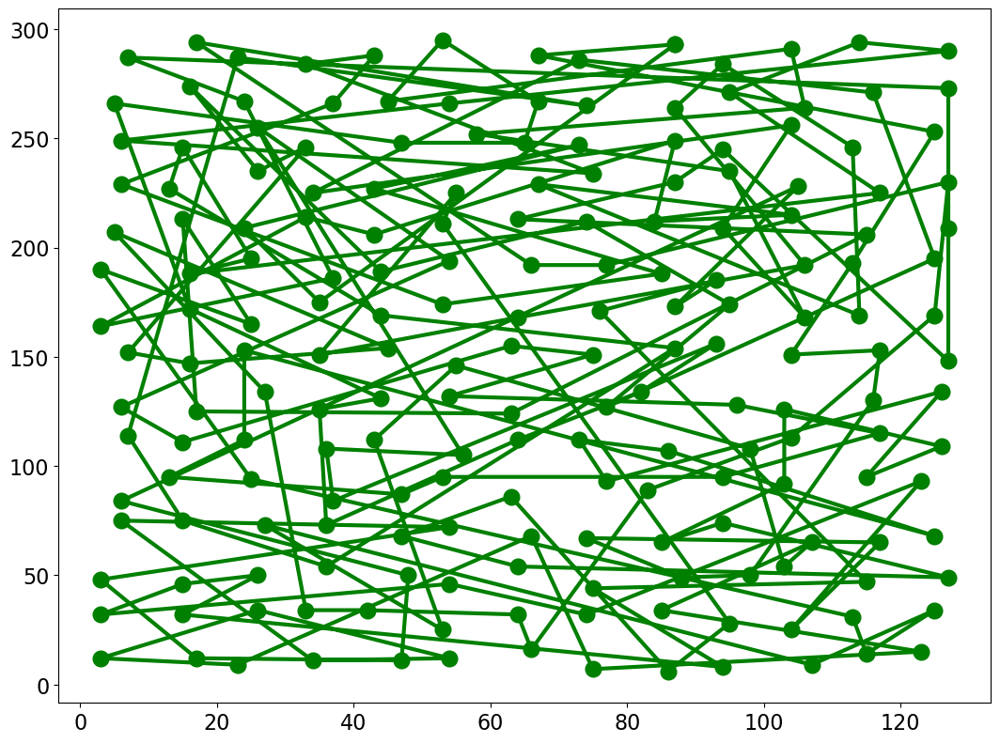

[I 2024-03-28 13:46:43,326] Trial 9 finished with value: 324.62333189840723 and parameters: {'pop': 46}. Best is trial 1 with value: 197.28798966853208.


In [10]:
def objective(trial):
    params = {
        "size_pop": trial.suggest_int("pop", 5, 500),
        'max_iter': 150,
        'w': 0.8,
        'c1': 0.5,
        'c2': 0.5,
    }

    # Add a callback for pruning.
    bestT,error=MonteCarloPSOTour(rounds,theCities,bestLength,params, plot=True)
    print("relative error PSO algorithm: ",error,"%")
    PlotTour(bestT,"green",show=True,fn=filename+"_GeneticAlgorithm.png")
    return error

study = optuna.create_study(
    directions=["minimize"]
)
study.optimize(objective, callbacks=[MaxTrialsCallback(10, states=(TrialState.COMPLETE,))])

/tmp/ipykernel_822/574205412.py:1: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Relative error")


<Axes: title={'center': 'Parallel Coordinate Plot'}>

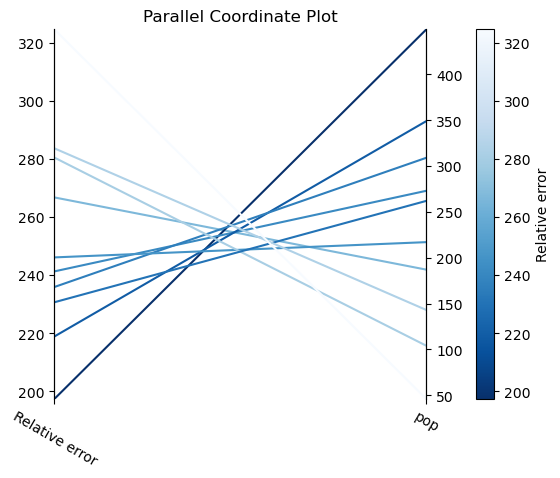

In [12]:
plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Relative error")

Across the ten trials, it can be clearly seen that the higher the population size the lower the relative error, which demonstrates a high importance of this parameter for minimizing the objective function in TSP.

#### 2.2.2 Varying maximum of iterations
We will analyze 10 different values for the maximum of iterations between 5 and 500.

[I 2024-03-28 15:56:18,969] A new study created in memory with name: no-name-9e0999ca-0c63-4904-96b7-c944e5a9f795


Minimum of objective function: 10171.462389680071
Mean of objective function: 10748.24838430248
Variance of objective function: 138307.08778745195
Monte Carlo standard error: 117.60403385405277


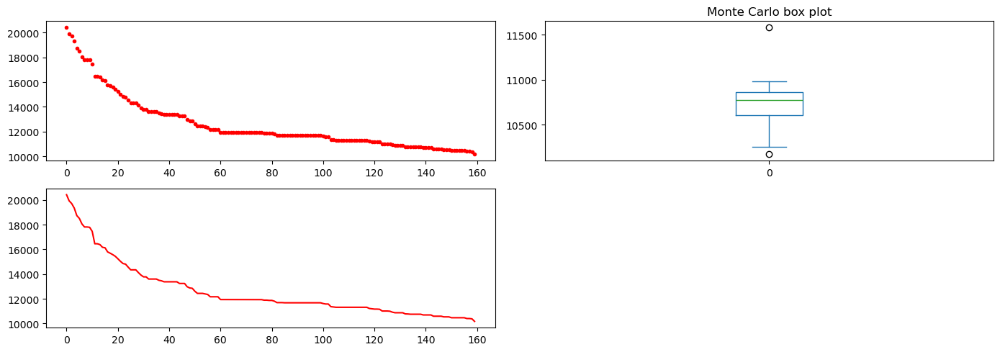

relative error PSO algorithm:  337.6237623762376 %


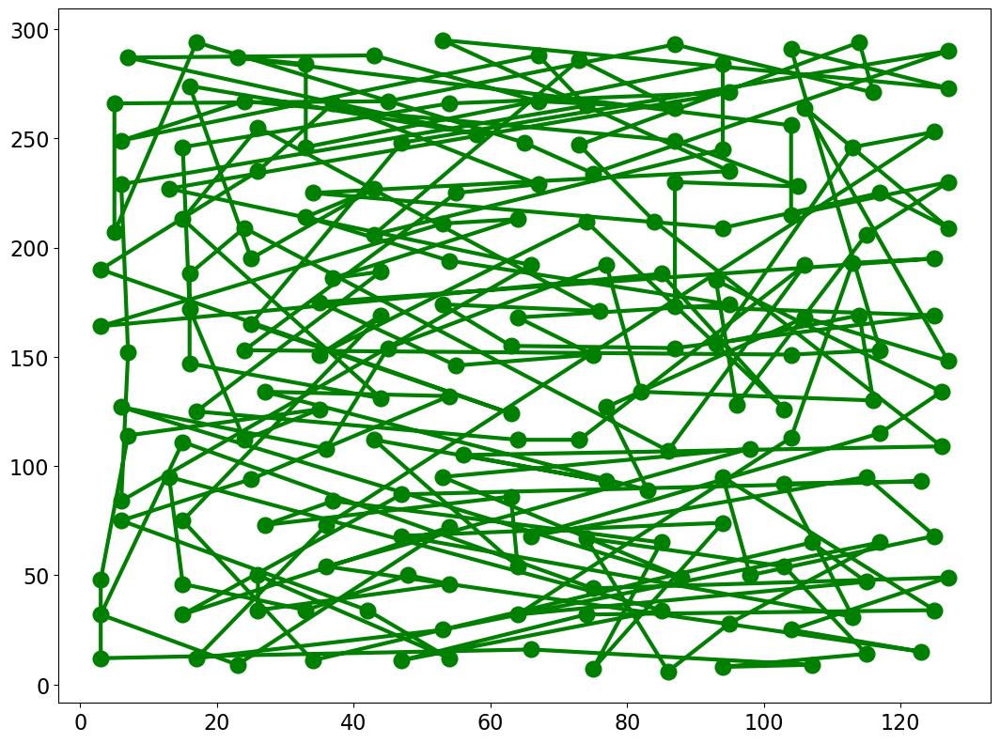

[I 2024-03-28 15:56:40,664] Trial 0 finished with value: 337.6237623762376 and parameters: {'max_iter': 160}. Best is trial 0 with value: 337.6237623762376.


Minimum of objective function: 11024.335883239546
Mean of objective function: 11581.966283477866
Variance of objective function: 149484.51729969544
Monte Carlo standard error: 122.26386109545838


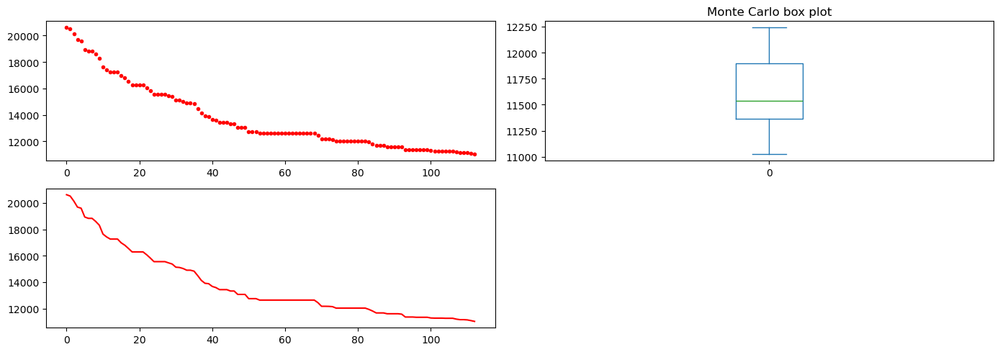

relative error PSO algorithm:  374.4726646577701 %


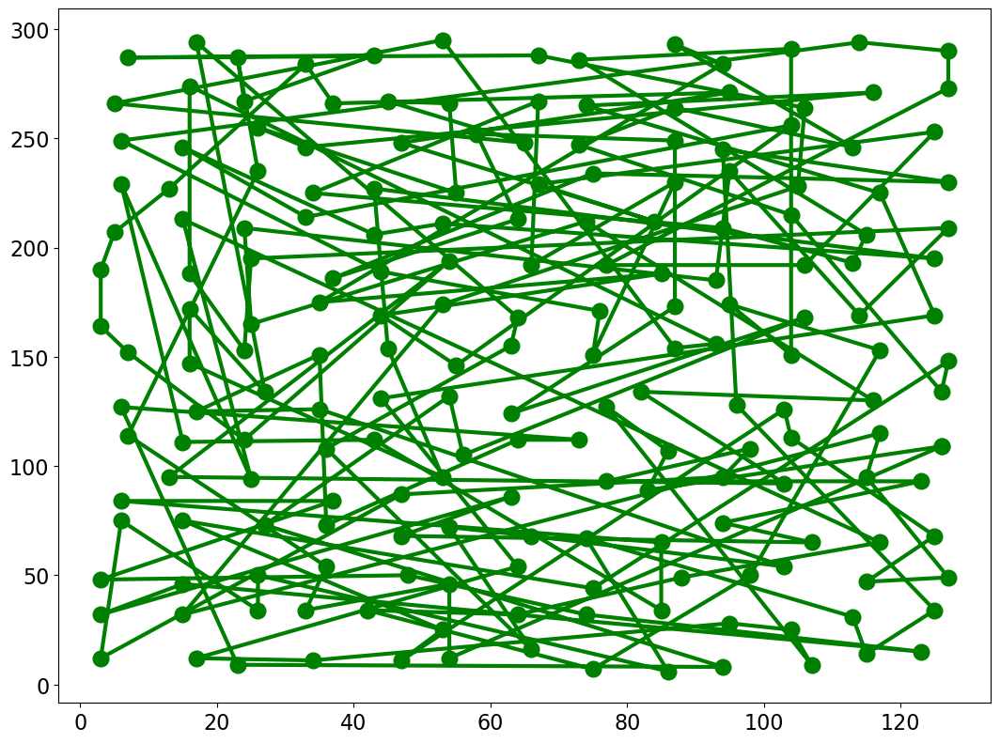

[I 2024-03-28 15:56:55,930] Trial 1 finished with value: 374.4726646577701 and parameters: {'max_iter': 113}. Best is trial 0 with value: 337.6237623762376.


Minimum of objective function: 14111.271522541141
Mean of objective function: 15010.72921453496
Variance of objective function: 274828.1334481881
Monte Carlo standard error: 165.77941170368172


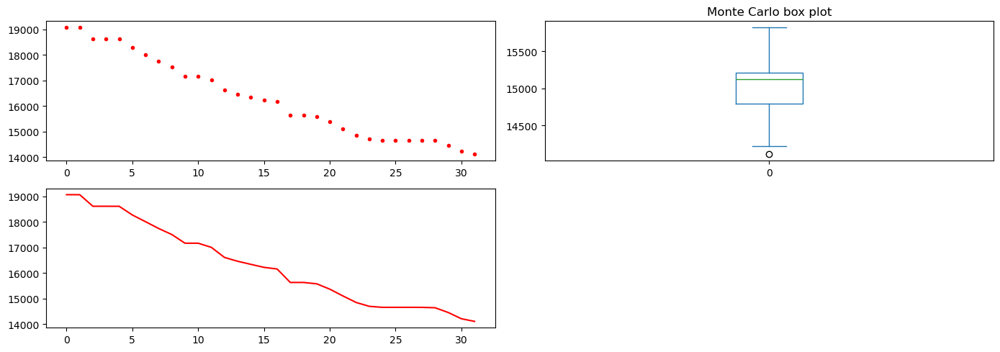

relative error PSO algorithm:  507.2750753336203 %


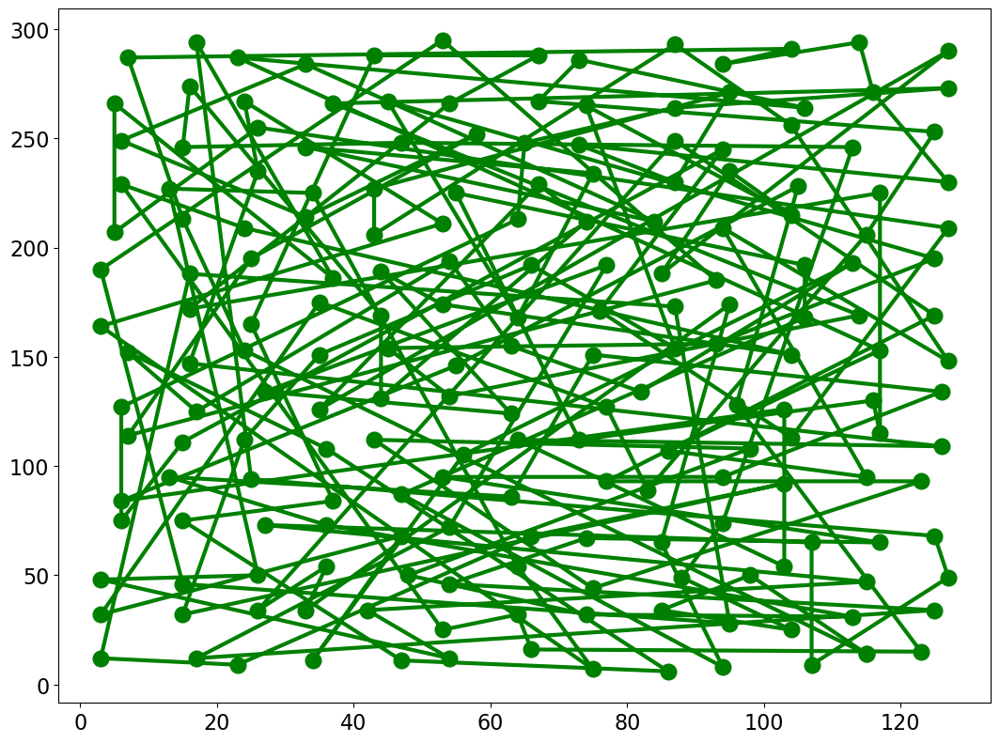

[I 2024-03-28 15:57:00,678] Trial 2 finished with value: 507.2750753336203 and parameters: {'max_iter': 32}. Best is trial 0 with value: 337.6237623762376.


Minimum of objective function: 11095.481604082139
Mean of objective function: 11580.096182414634
Variance of objective function: 232018.73679328695
Monte Carlo standard error: 152.3216126468227


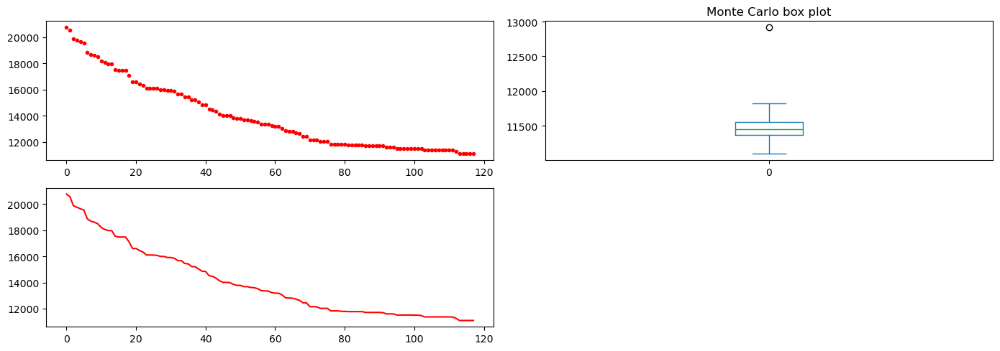

relative error PSO algorithm:  377.61515281962977 %


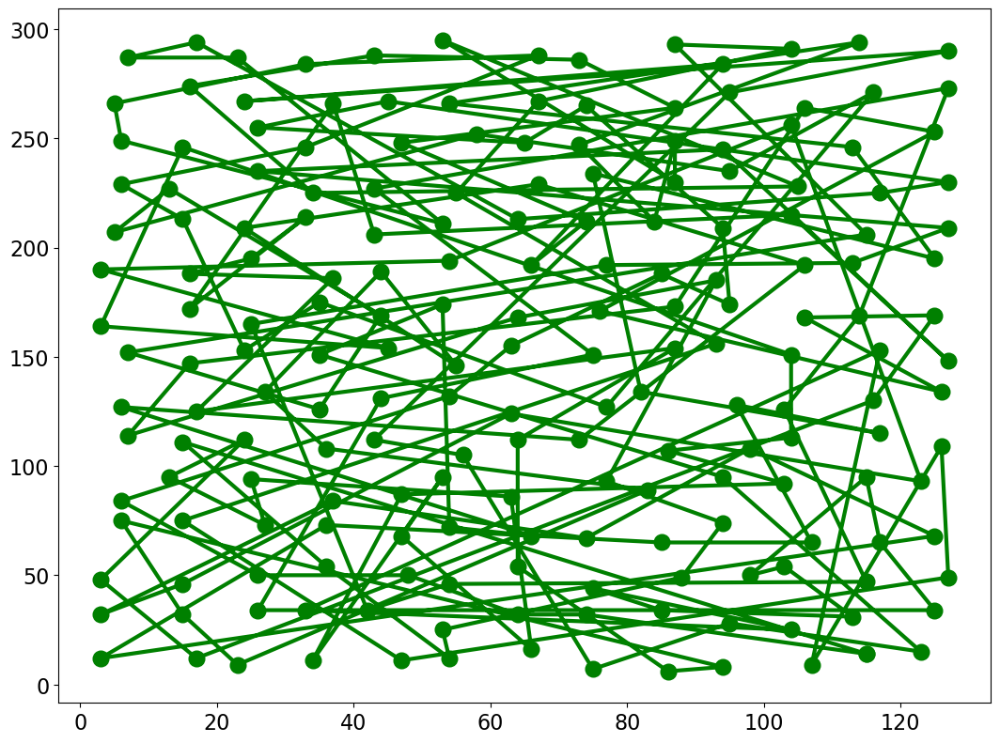

[I 2024-03-28 15:57:16,446] Trial 3 finished with value: 377.61515281962977 and parameters: {'max_iter': 118}. Best is trial 0 with value: 337.6237623762376.


Minimum of objective function: 8114.755957226055
Mean of objective function: 8714.988339499587
Variance of objective function: 155178.68940015836
Monte Carlo standard error: 124.5707386990052


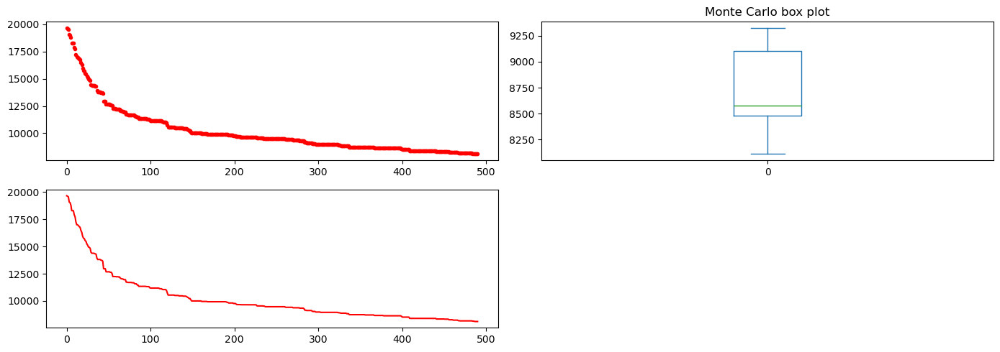

relative error PSO algorithm:  249.07447266465778 %


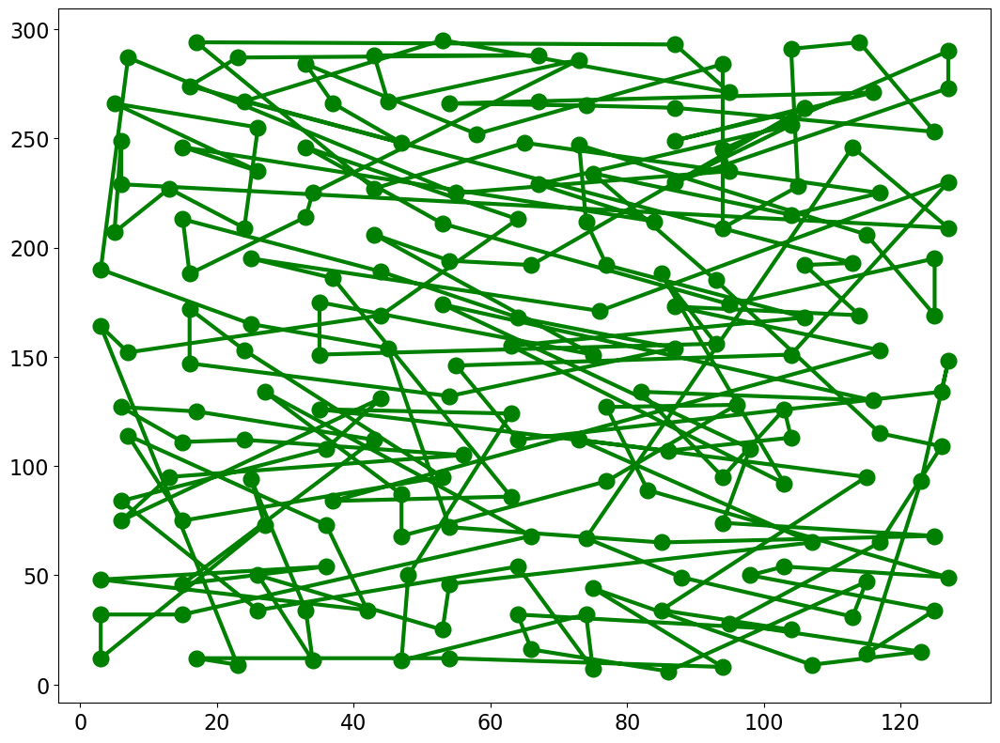

[I 2024-03-28 15:58:20,411] Trial 4 finished with value: 249.07447266465778 and parameters: {'max_iter': 491}. Best is trial 4 with value: 249.07447266465778.


Minimum of objective function: 8806.162402256534
Mean of objective function: 9434.290055678613
Variance of objective function: 150766.97559472304
Monte Carlo standard error: 122.78720438006683


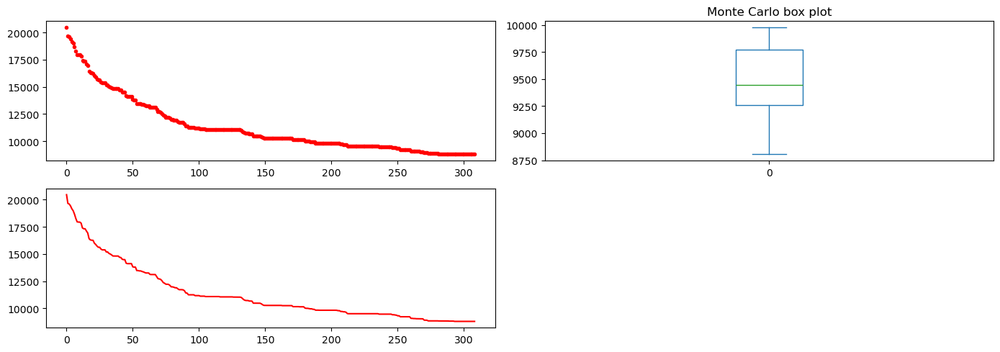

relative error PSO algorithm:  278.99268187688335 %


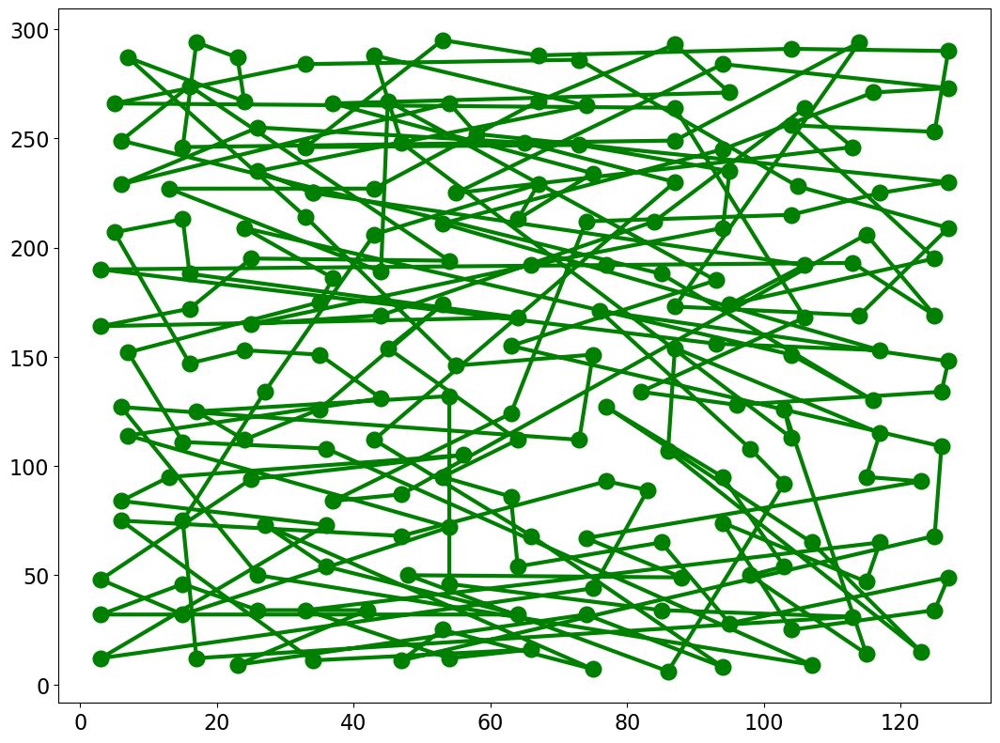

[I 2024-03-28 15:59:00,759] Trial 5 finished with value: 278.99268187688335 and parameters: {'max_iter': 309}. Best is trial 4 with value: 249.07447266465778.


Minimum of objective function: 9222.889527316105
Mean of objective function: 10017.871323456242
Variance of objective function: 208048.36378850802
Monte Carlo standard error: 144.238817170867


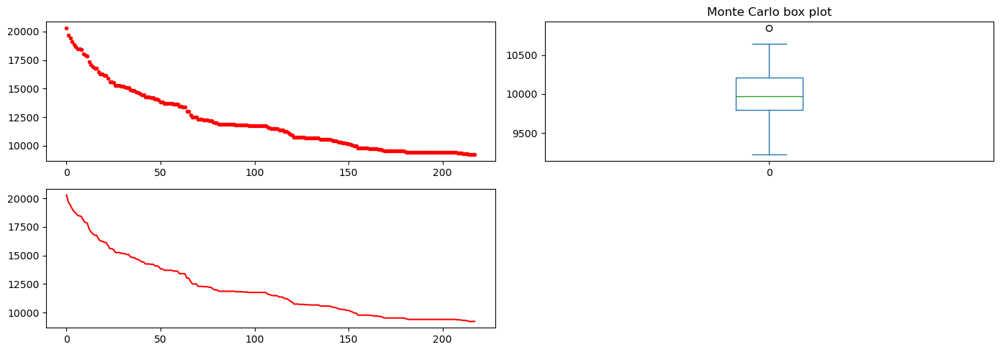

relative error PSO algorithm:  296.9436074042187 %


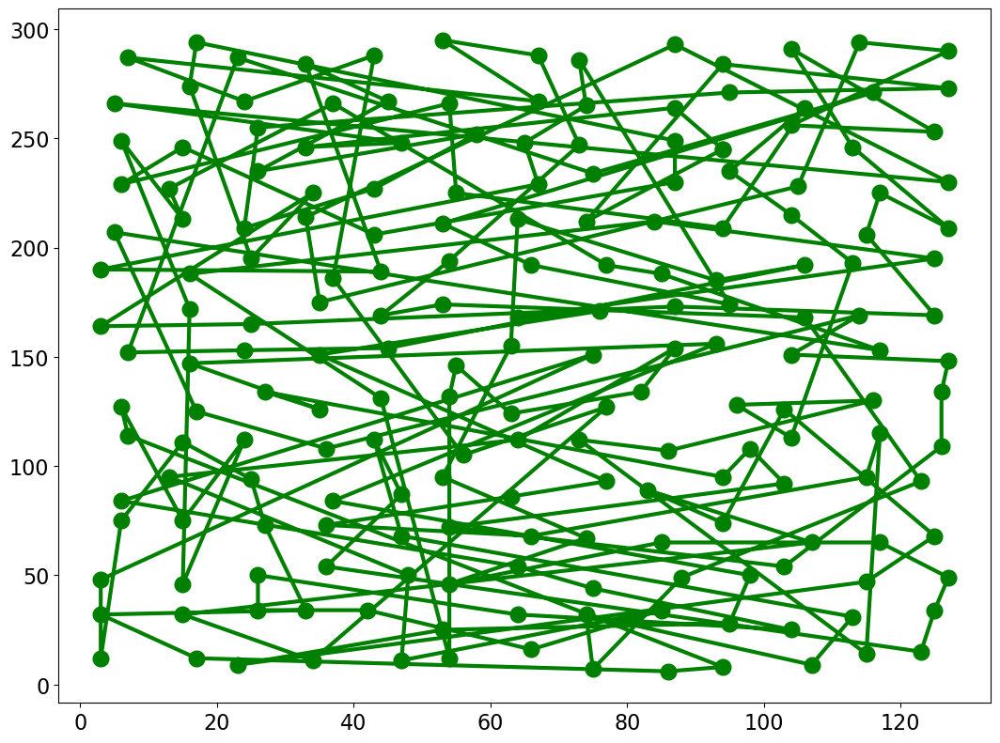

[I 2024-03-28 15:59:29,617] Trial 6 finished with value: 296.9436074042187 and parameters: {'max_iter': 218}. Best is trial 4 with value: 249.07447266465778.


Minimum of objective function: 10001.652065696031
Mean of objective function: 10637.639401173938
Variance of objective function: 146841.66891262884
Monte Carlo standard error: 121.17824429848322


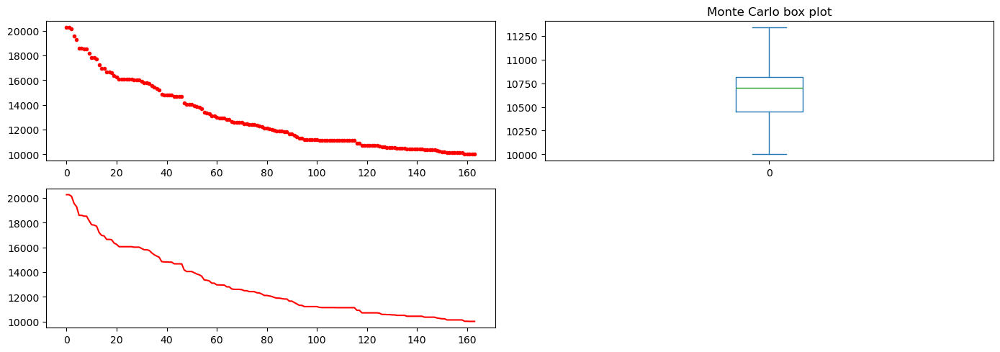

relative error PSO algorithm:  330.520878174774 %


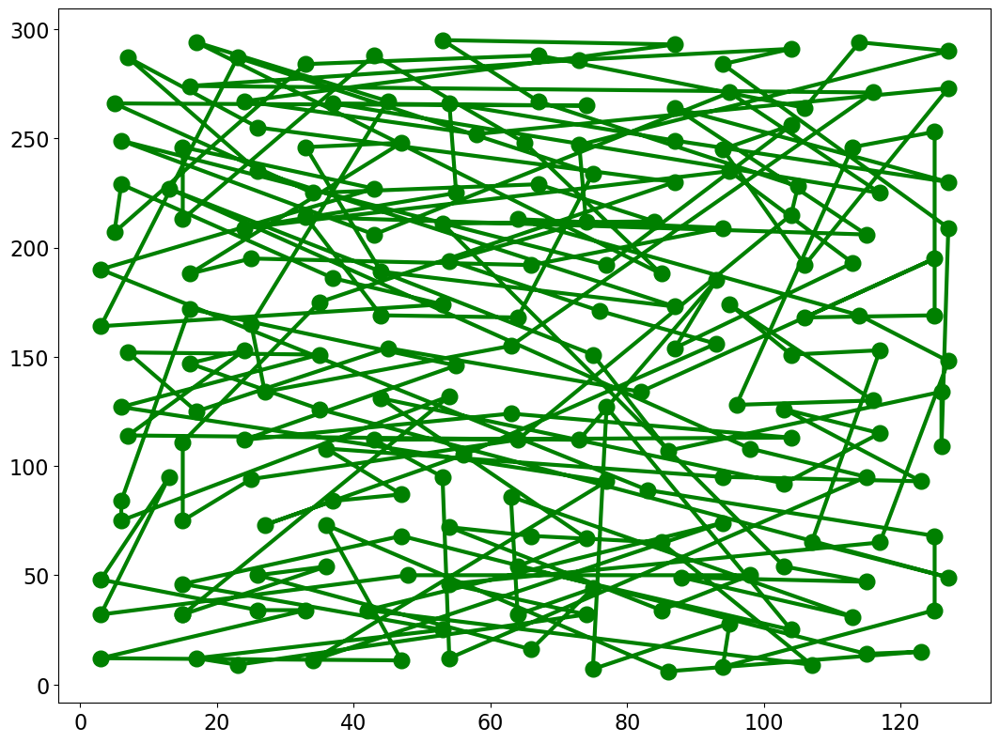

[I 2024-03-28 15:59:51,559] Trial 7 finished with value: 330.520878174774 and parameters: {'max_iter': 164}. Best is trial 4 with value: 249.07447266465778.


Minimum of objective function: 8521.106763527905
Mean of objective function: 9260.060848729514
Variance of objective function: 150401.25443295916
Monte Carlo standard error: 122.63818917162759


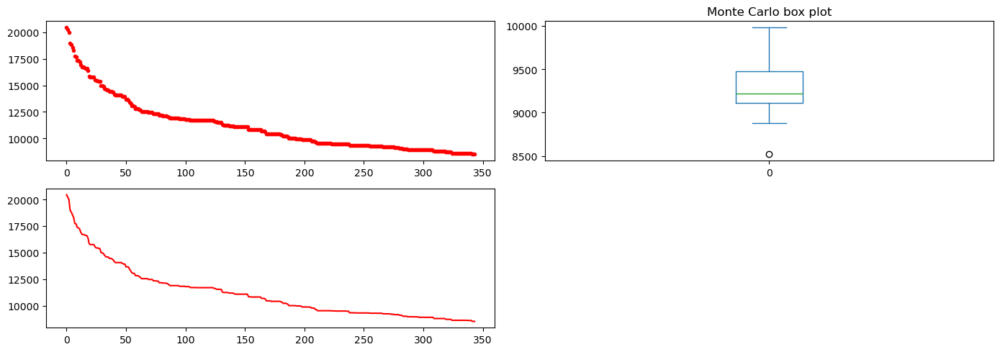

relative error PSO algorithm:  266.5518725785622 %


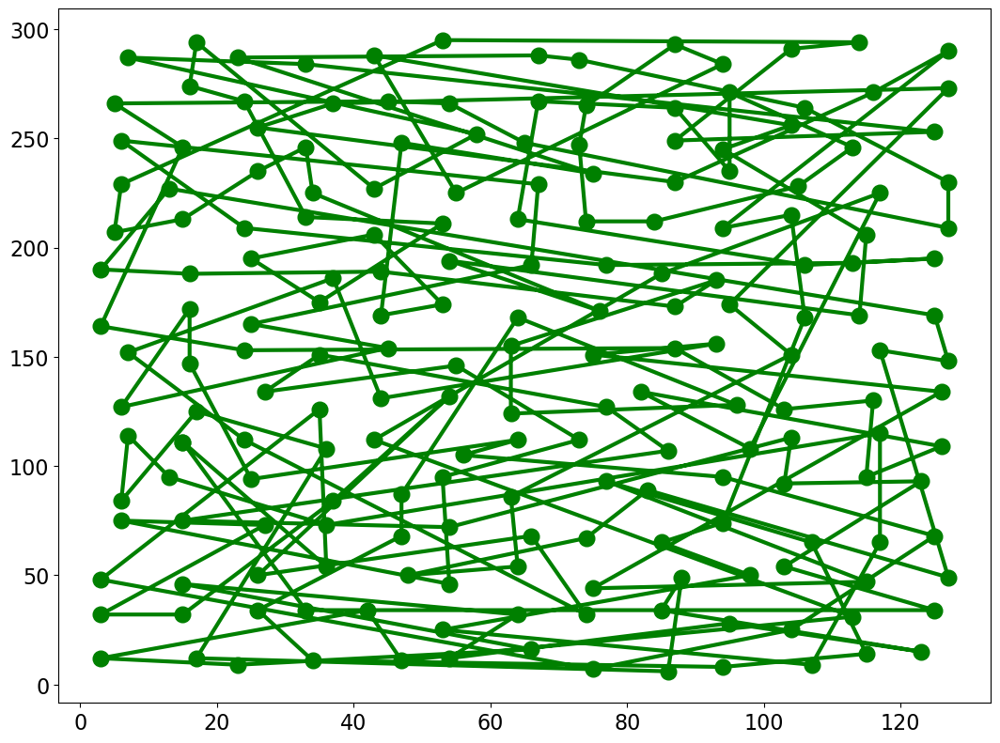

[I 2024-03-28 16:00:36,510] Trial 8 finished with value: 266.5518725785622 and parameters: {'max_iter': 344}. Best is trial 4 with value: 249.07447266465778.


Minimum of objective function: 8345.586703642703
Mean of objective function: 8801.171801658154
Variance of objective function: 88506.18093368423
Monte Carlo standard error: 94.07772368296557


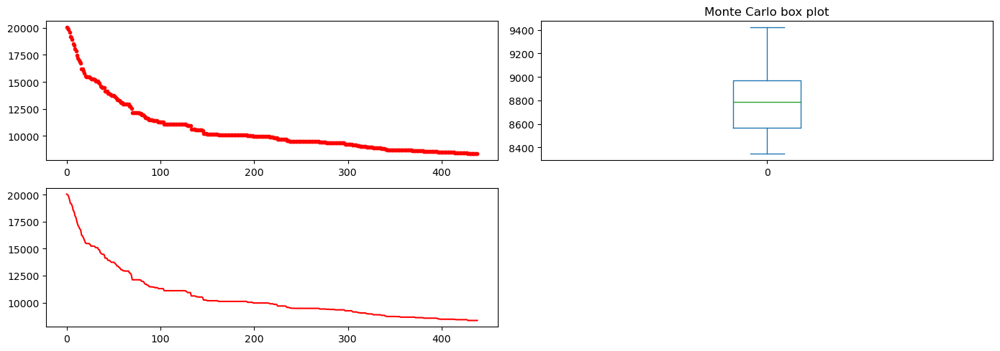

relative error PSO algorithm:  258.9324149806285 %


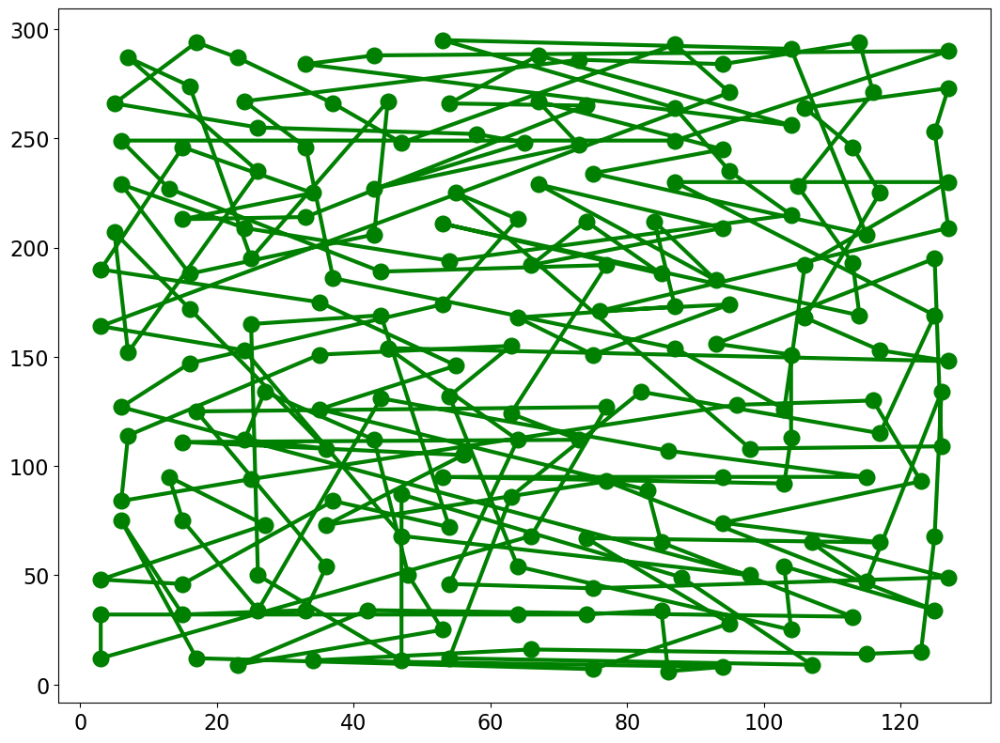

[I 2024-03-28 16:01:33,251] Trial 9 finished with value: 258.9324149806285 and parameters: {'max_iter': 439}. Best is trial 4 with value: 249.07447266465778.


In [13]:
def objective(trial):
    params = {
        "size_pop": 40,
        'max_iter': trial.suggest_int("max_iter", 5, 500),
        'w': 0.8,
        'c1': 0.5,
        'c2': 0.5,
    }

    # Add a callback for pruning.
    bestT,error=MonteCarloPSOTour(rounds,theCities,bestLength,params, plot=True)
    print("relative error PSO algorithm: ",error,"%")
    PlotTour(bestT,"green",show=True,fn=filename+"_GeneticAlgorithm.png")
    return error

study = optuna.create_study(
    directions=["minimize"]
)
study.optimize(objective, callbacks=[MaxTrialsCallback(10, states=(TrialState.COMPLETE,))])

/tmp/ipykernel_822/574205412.py:1: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Relative error")


<Axes: title={'center': 'Parallel Coordinate Plot'}>

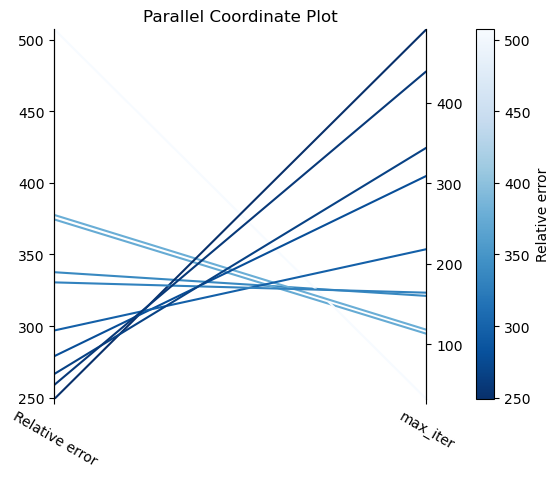

In [14]:
plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Relative error")

As we can see in the results above, if the maximum of iterations is set too low the algorithm may not have sufficient time to explore and exploit the search space effectively. As a result, the optimization process may terminate prematurely, leading to suboptimal solutions or convergence to local optima. This limitation can result in a lack of thorough exploration, hindering the algorithm's ability to discover the best possible solution. Setting the maximum of iterations to a number higher than 500 can help to improve the relative error. However, it would imply a too high computational time. Exploring parallelization would help to mitigate this problem.

#### 2.2.3 Varying w (inertia)
We will analyze 10 different values for the w between 0.00001 and 1.0.

[I 2024-03-28 16:01:33,488] A new study created in memory with name: no-name-5ac110c0-ba60-4810-9b5e-48e8f6fd5e6f


Minimum of objective function: 10588.063772383914
Mean of objective function: 11060.291865169182
Variance of objective function: 125274.00505398991
Monte Carlo standard error: 111.92587058137626


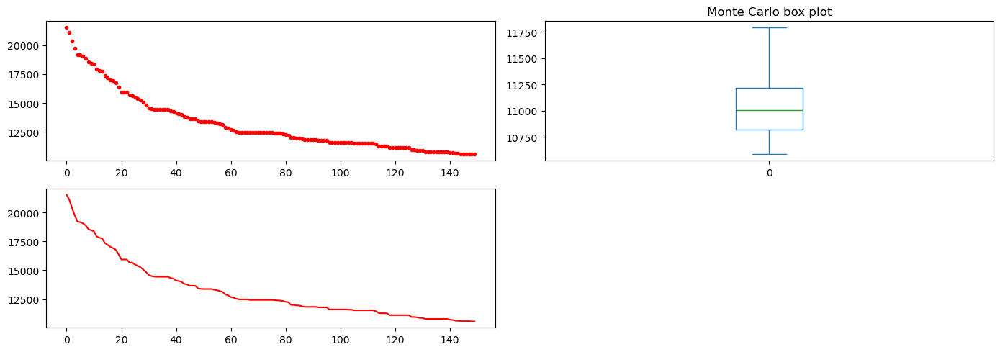

relative error PSO algorithm:  355.4885923374946 %


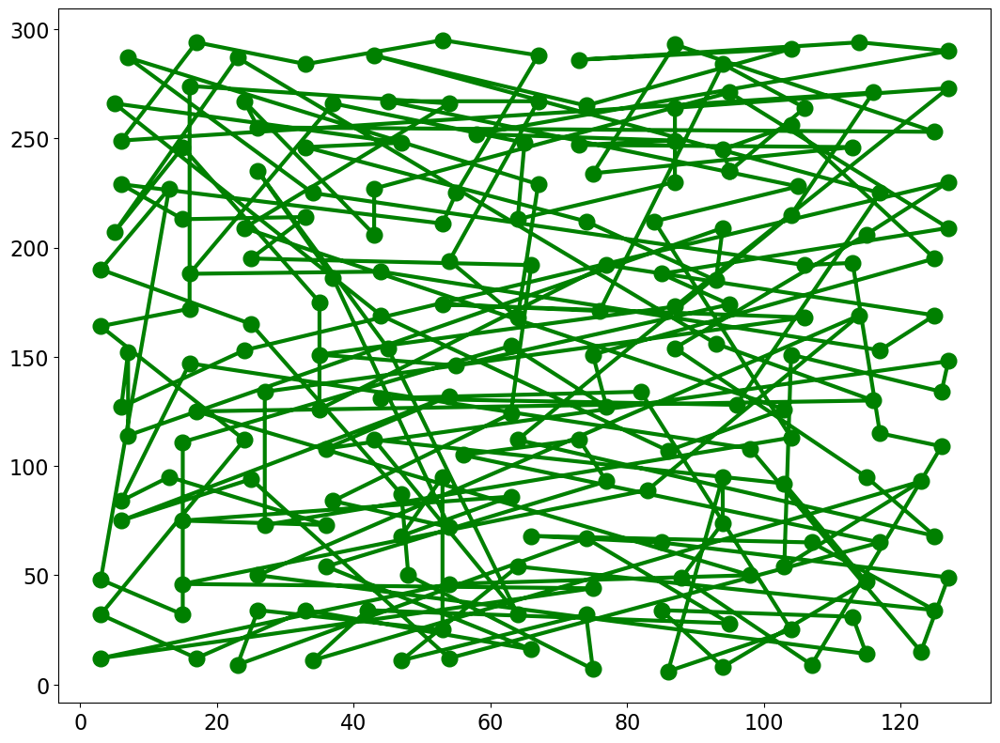

[I 2024-03-28 16:01:53,344] Trial 0 finished with value: 355.4885923374946 and parameters: {'w': 0.9710409437532136}. Best is trial 0 with value: 355.4885923374946.


Minimum of objective function: 10285.722589343306
Mean of objective function: 10924.471288836176
Variance of objective function: 148771.46602550885
Monte Carlo standard error: 121.97190907151894


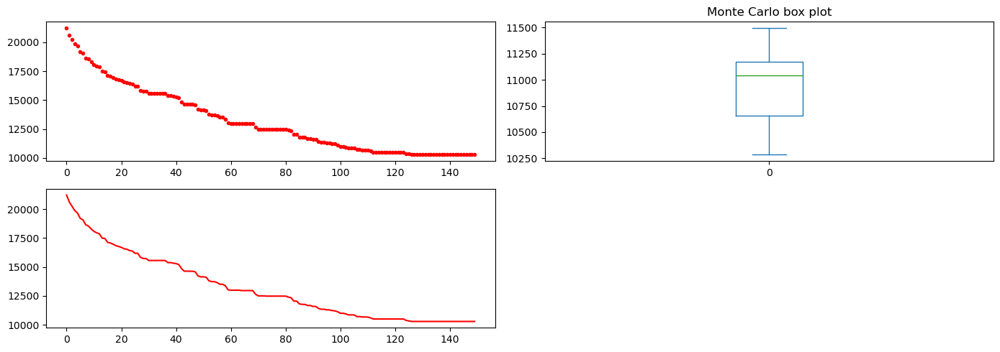

relative error PSO algorithm:  342.31597072750753 %


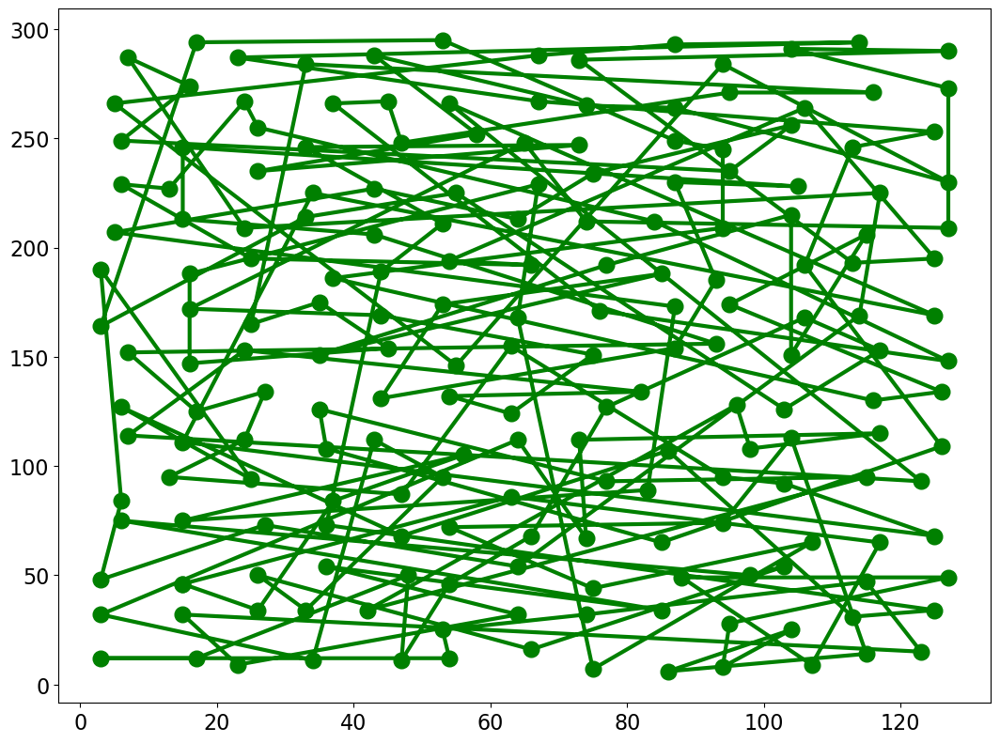

[I 2024-03-28 16:02:13,295] Trial 1 finished with value: 342.31597072750753 and parameters: {'w': 0.7603442648735261}. Best is trial 1 with value: 342.31597072750753.


Minimum of objective function: 10491.646811389388
Mean of objective function: 10898.946650404578
Variance of objective function: 63709.68065442772
Monte Carlo standard error: 79.81834416625523


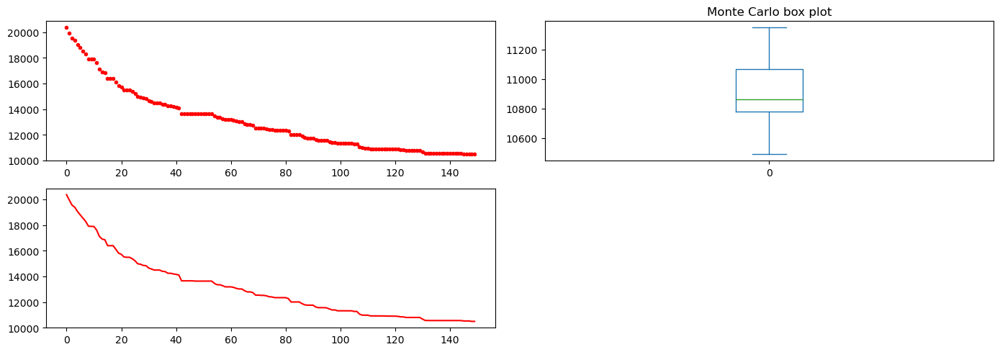

relative error PSO algorithm:  351.48514851485146 %


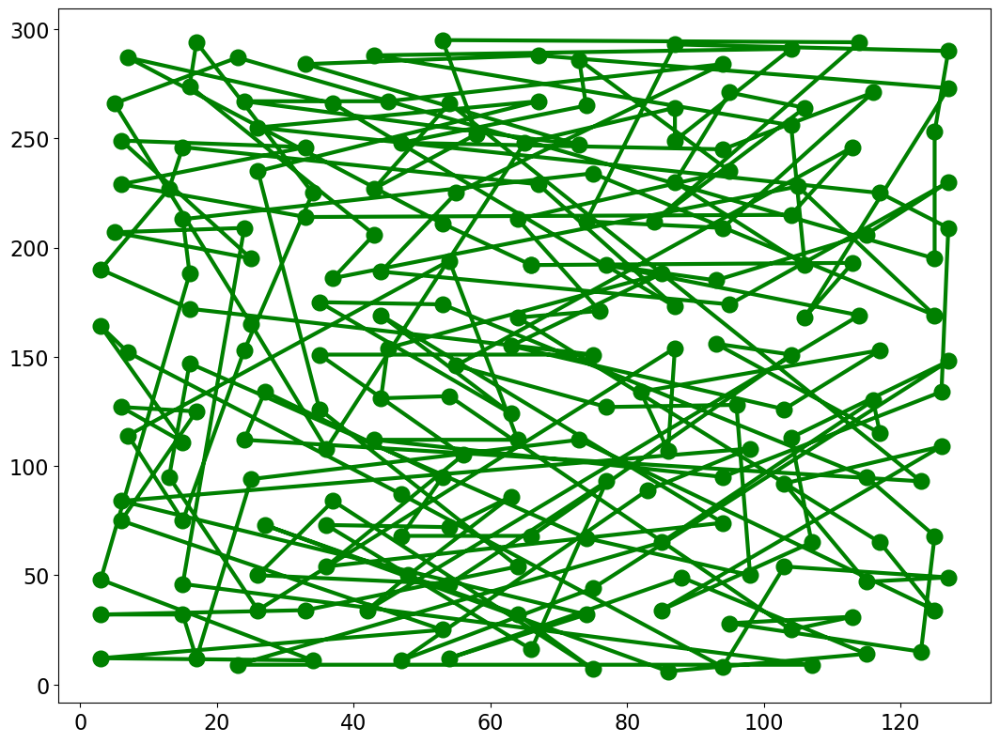

[I 2024-03-28 16:02:33,316] Trial 2 finished with value: 351.48514851485146 and parameters: {'w': 0.24161301608680288}. Best is trial 1 with value: 342.31597072750753.


Minimum of objective function: 10295.251651780547
Mean of objective function: 10856.728391023265
Variance of objective function: 267401.70100556273
Monte Carlo standard error: 163.52421869728127


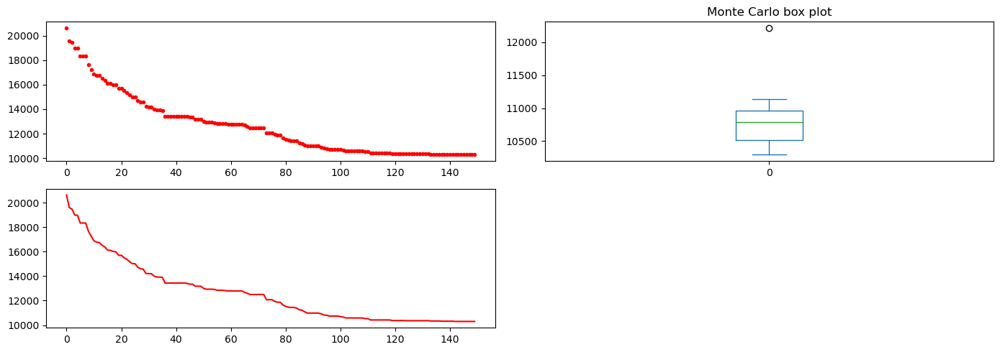

relative error PSO algorithm:  343.2630219543694 %


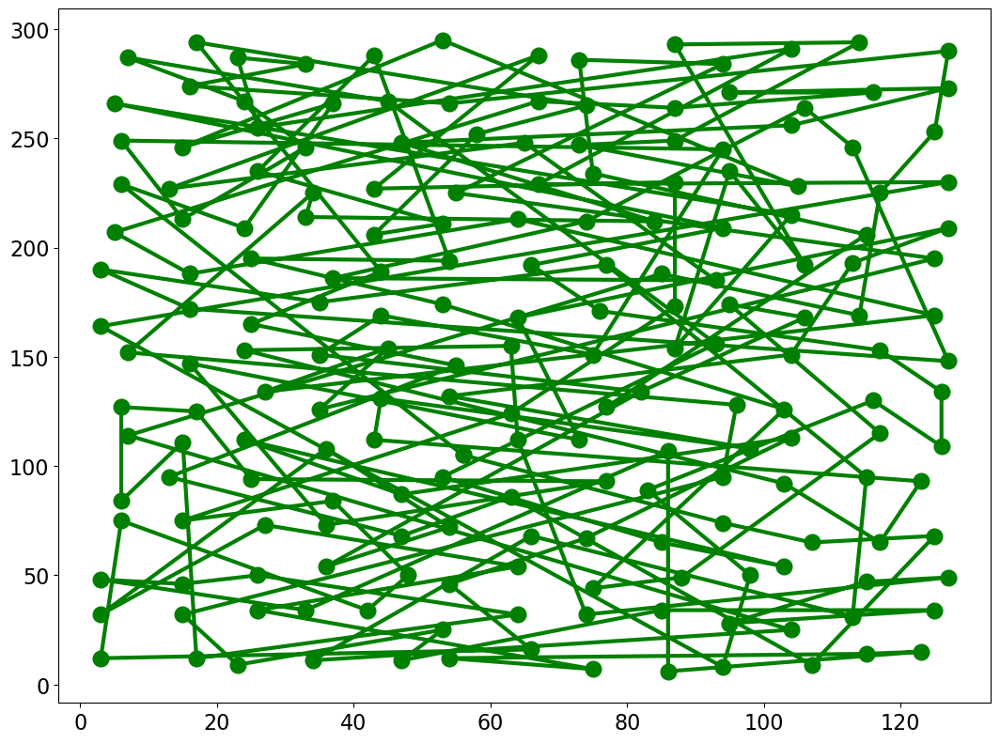

[I 2024-03-28 16:02:53,326] Trial 3 finished with value: 343.2630219543694 and parameters: {'w': 0.6191733550946042}. Best is trial 1 with value: 342.31597072750753.


Minimum of objective function: 10349.549081729649
Mean of objective function: 10950.57121313776
Variance of objective function: 197813.0881730492
Monte Carlo standard error: 140.6460408874168


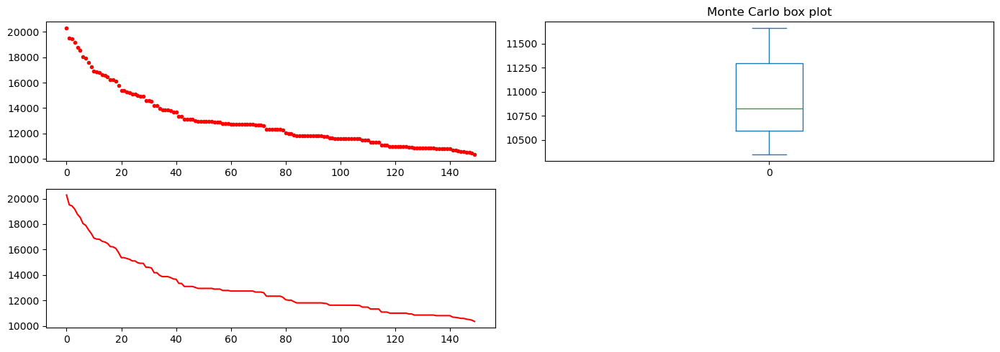

relative error PSO algorithm:  345.2432199741713 %


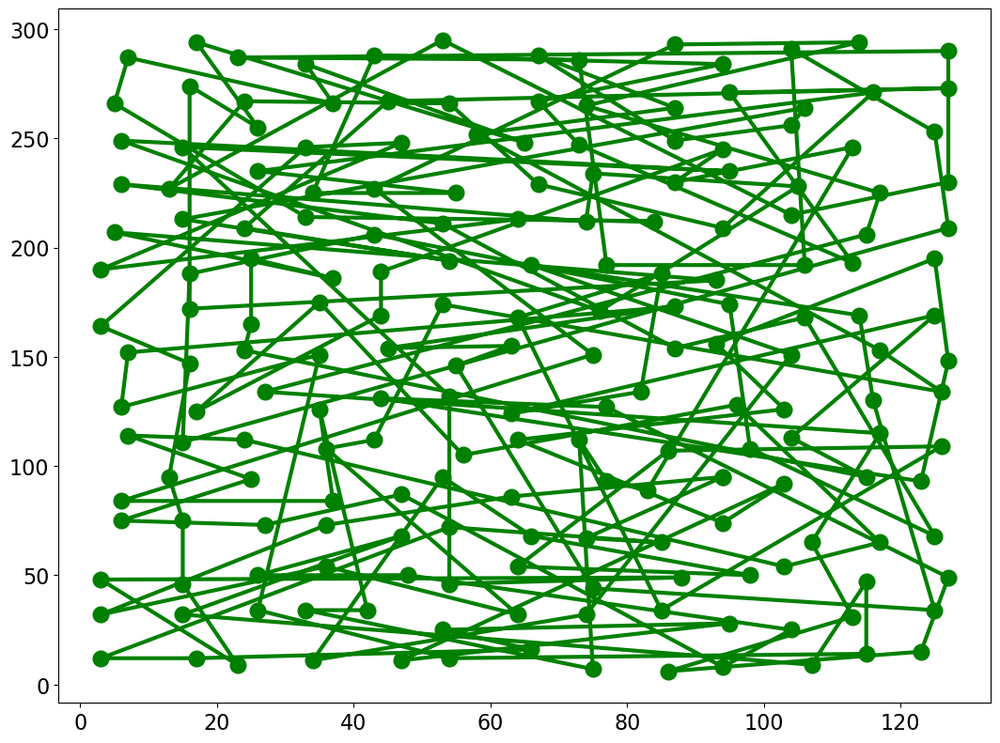

[I 2024-03-28 16:03:13,273] Trial 4 finished with value: 345.2432199741713 and parameters: {'w': 0.8057072357181482}. Best is trial 1 with value: 342.31597072750753.


Minimum of objective function: 10132.433606239498
Mean of objective function: 11061.40451460822
Variance of objective function: 255794.21791637735
Monte Carlo standard error: 159.9356801706165


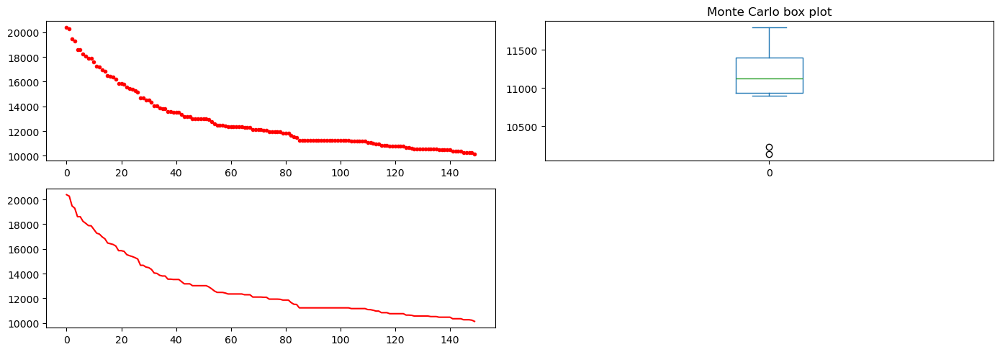

relative error PSO algorithm:  335.85880327163153 %


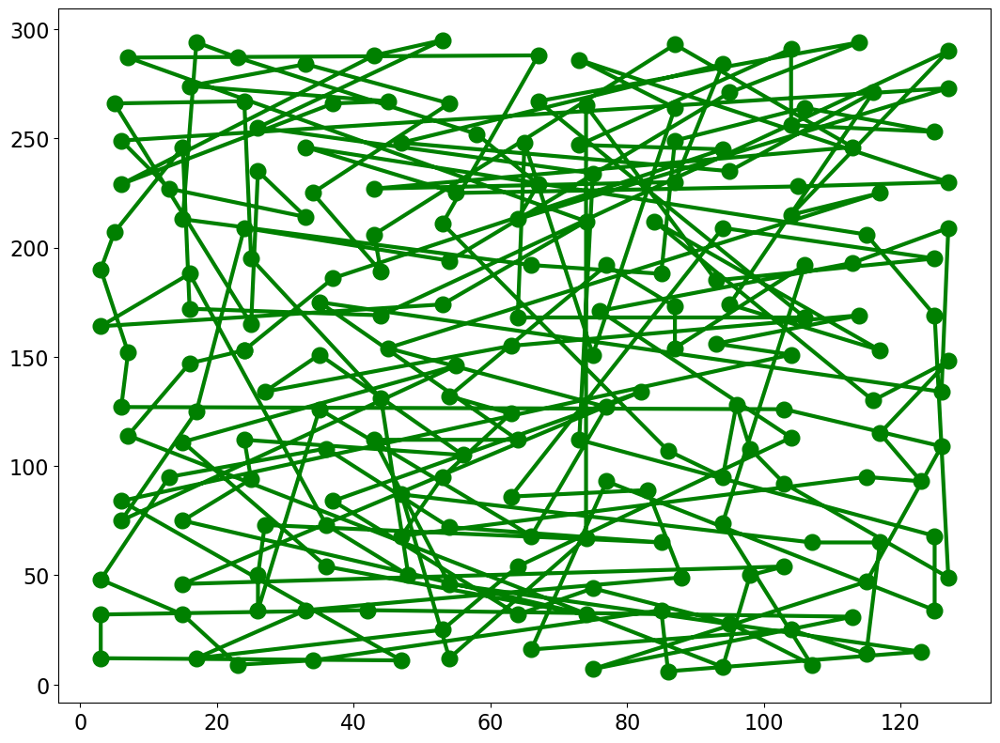

[I 2024-03-28 16:03:33,173] Trial 5 finished with value: 335.85880327163153 and parameters: {'w': 0.18958187377116967}. Best is trial 5 with value: 335.85880327163153.


Minimum of objective function: 10266.286940598224
Mean of objective function: 11006.352790073095
Variance of objective function: 170226.90603970736
Monte Carlo standard error: 130.47103358205888


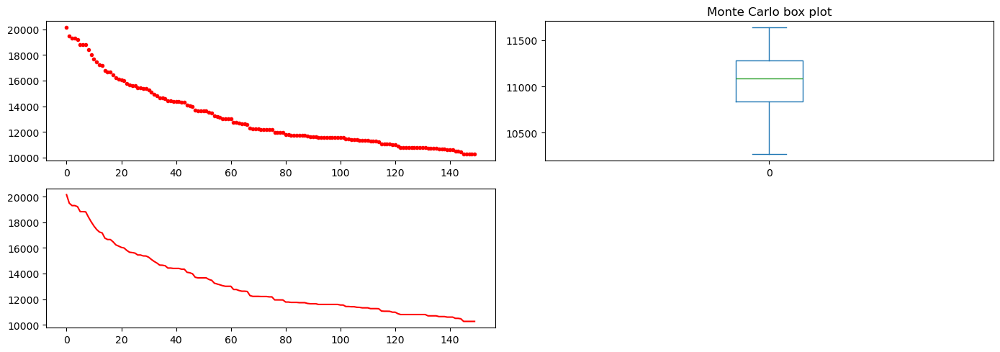

relative error PSO algorithm:  341.6702539819199 %


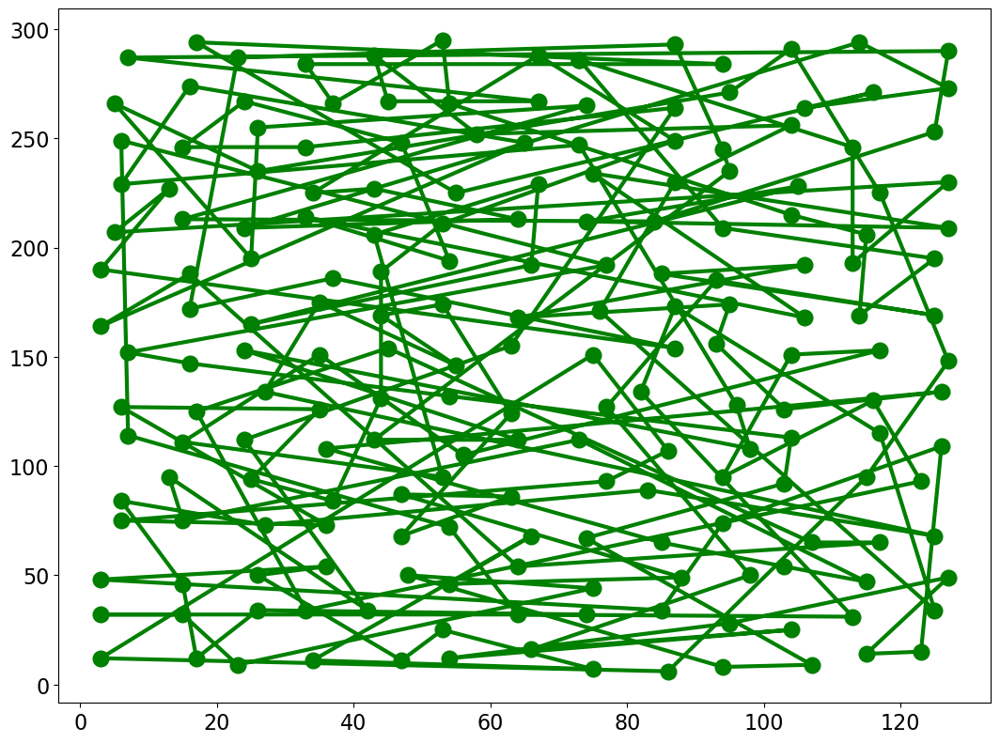

[I 2024-03-28 16:03:53,202] Trial 6 finished with value: 341.6702539819199 and parameters: {'w': 0.8795573073591574}. Best is trial 5 with value: 335.85880327163153.


Minimum of objective function: 10623.32971204445
Mean of objective function: 10999.19569123627
Variance of objective function: 89905.3538189763
Monte Carlo standard error: 94.81843376631798


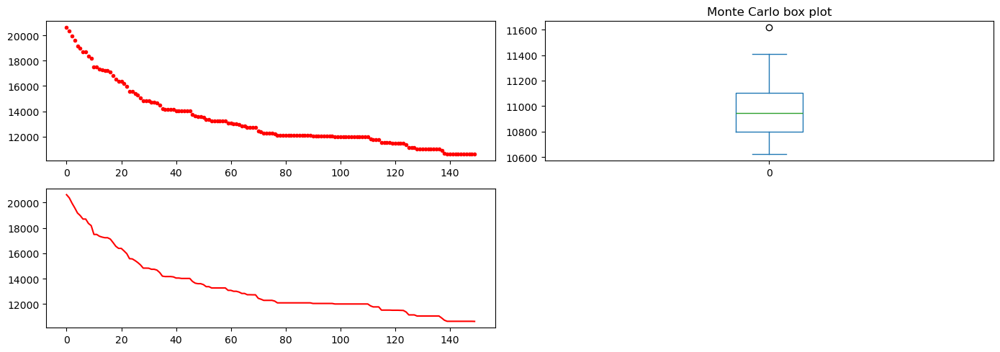

relative error PSO algorithm:  357.25355144210073 %


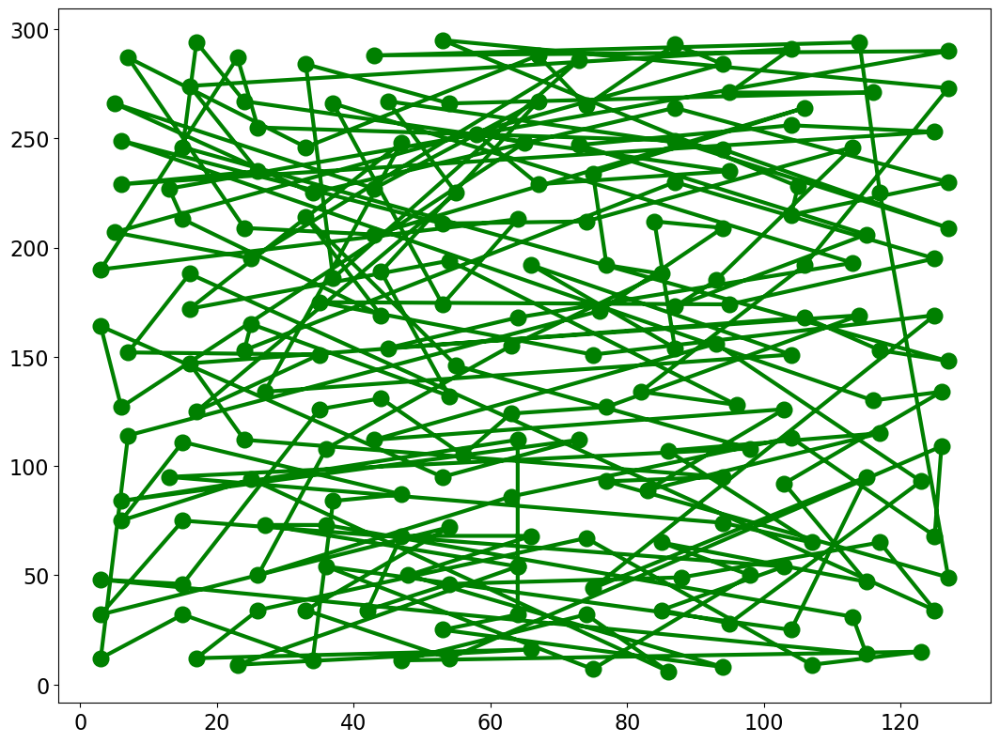

[I 2024-03-28 16:04:13,236] Trial 7 finished with value: 357.25355144210073 and parameters: {'w': 0.9766615637381252}. Best is trial 5 with value: 335.85880327163153.


Minimum of objective function: 10432.917103485097
Mean of objective function: 11008.278096080097
Variance of objective function: 212819.8554435207
Monte Carlo standard error: 145.88346563045474


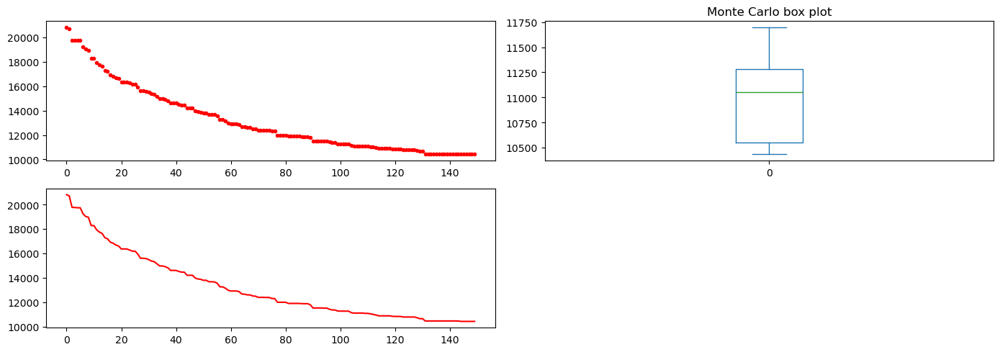

relative error PSO algorithm:  348.8592337494619 %


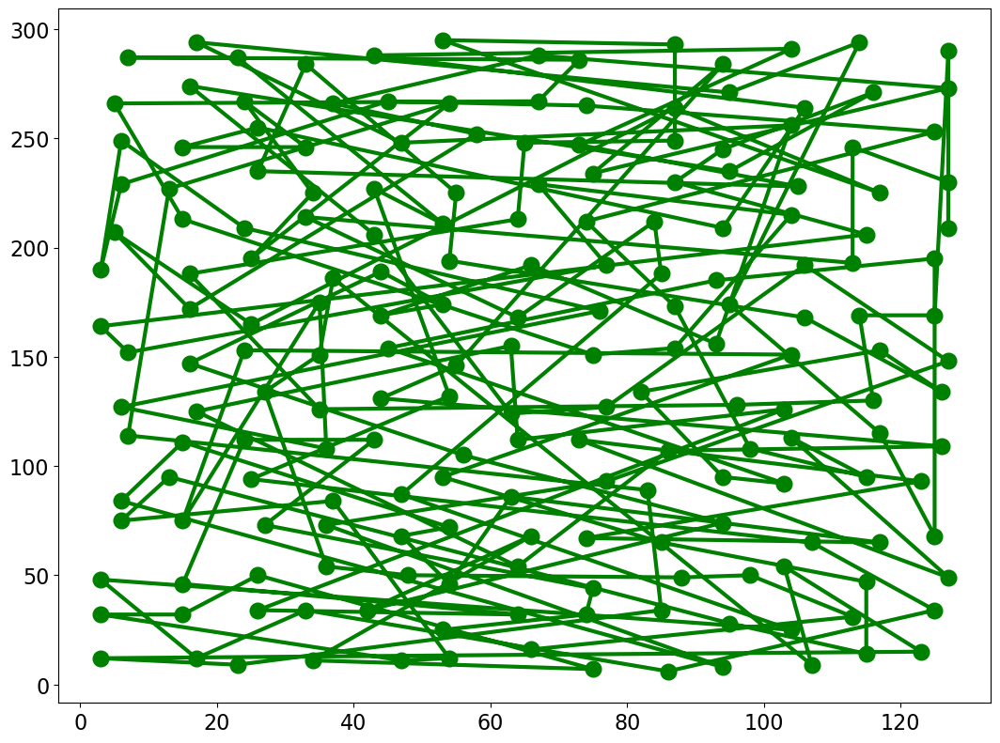

[I 2024-03-28 16:04:33,391] Trial 8 finished with value: 348.8592337494619 and parameters: {'w': 0.25900127132877454}. Best is trial 5 with value: 335.85880327163153.


Minimum of objective function: 10383.601378323594
Mean of objective function: 10801.76078022081
Variance of objective function: 70381.66176194856
Monte Carlo standard error: 83.89377912691056


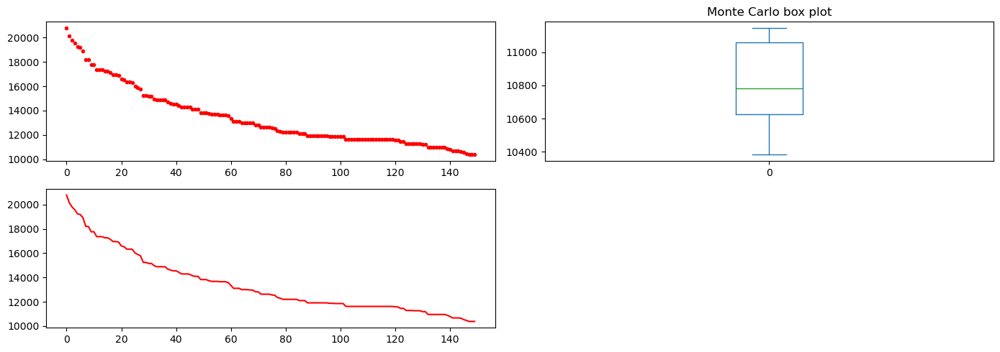

relative error PSO algorithm:  346.7068445975032 %


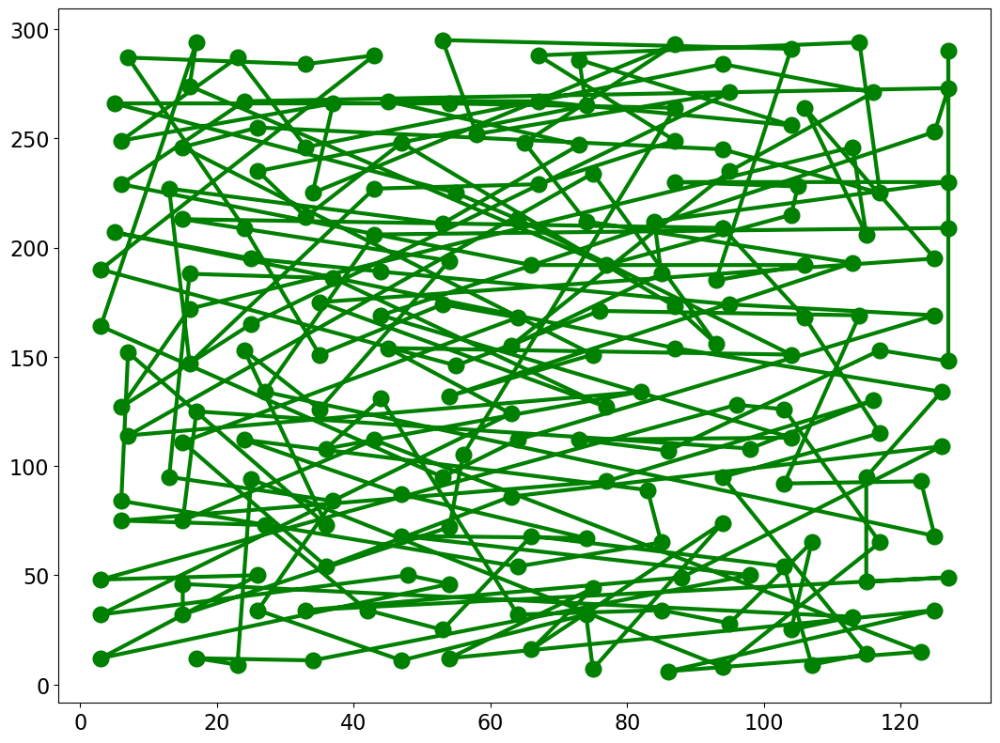

[I 2024-03-28 16:04:53,309] Trial 9 finished with value: 346.7068445975032 and parameters: {'w': 0.6700974410484049}. Best is trial 5 with value: 335.85880327163153.


In [15]:
def objective(trial):
    params = {
        "size_pop": 40,
        'max_iter': 150,
        'w': trial.suggest_float("w", 0.00001, 1.0),
        'c1': 0.5,
        'c2': 0.5,
    }

    # Add a callback for pruning.
    bestT,error=MonteCarloPSOTour(rounds,theCities,bestLength,params, plot=True)
    print("relative error PSO algorithm: ",error,"%")
    PlotTour(bestT,"green",show=True,fn=filename+"_GeneticAlgorithm.png")
    return error

study = optuna.create_study(
    directions=["minimize"]
)
study.optimize(objective, callbacks=[MaxTrialsCallback(10, states=(TrialState.COMPLETE,))])

/tmp/ipykernel_822/574205412.py:1: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Relative error")


<Axes: title={'center': 'Parallel Coordinate Plot'}>

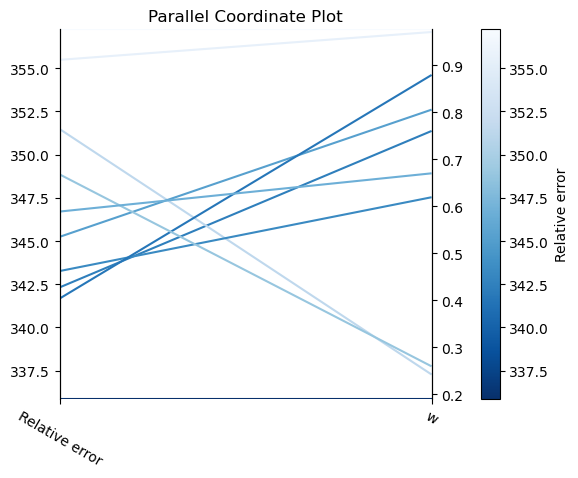

In [16]:
plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Relative error")

Inertia determines the particle's tendency to maintain its current velocity while moving towards better solutions. A high inertia allows particles to maintain their current direction, promoting exploration by enabling them to traverse large areas of the search space. This can help escape local optima and find the global optimum. Conversely, a low inertia encourages exploitation by reducing the particle's velocity, allowing it to converge towards promising solutions found in the vicinity.

The trials show that different values of inertia weight lead to variations in the convergence behavior and performance of the PSO algorithm. Lower values of inertia weight tend to exhibit higher relative errors. Conversely, higher inertia weights may lead to better results. However, the different is not as pronounced compared with respect to the population size.

#### 2.2.4 Varying c1 (personal best)
We will analyze 10 different values for the c1 between 0.01 and 3.0.

[I 2024-03-28 16:04:53,596] A new study created in memory with name: no-name-bafb57e7-9038-45b6-9729-429220bb51fb


Minimum of objective function: 10175.022385635804
Mean of objective function: 10967.168453690261
Variance of objective function: 176609.17085645703
Monte Carlo standard error: 132.894383198259


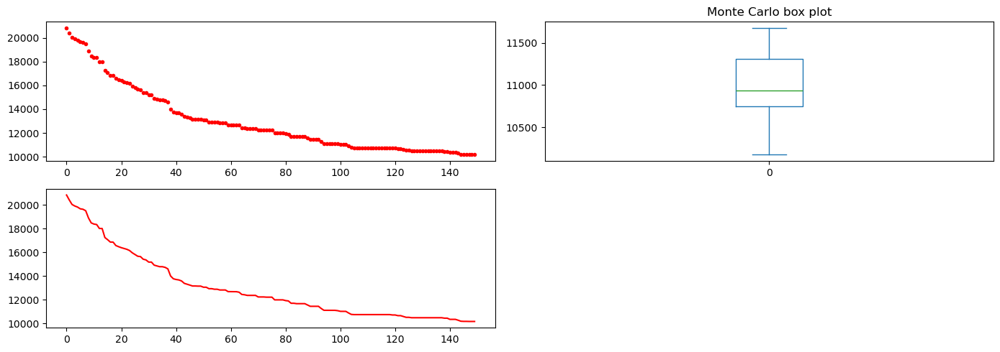

relative error PSO algorithm:  338.01119242359016 %


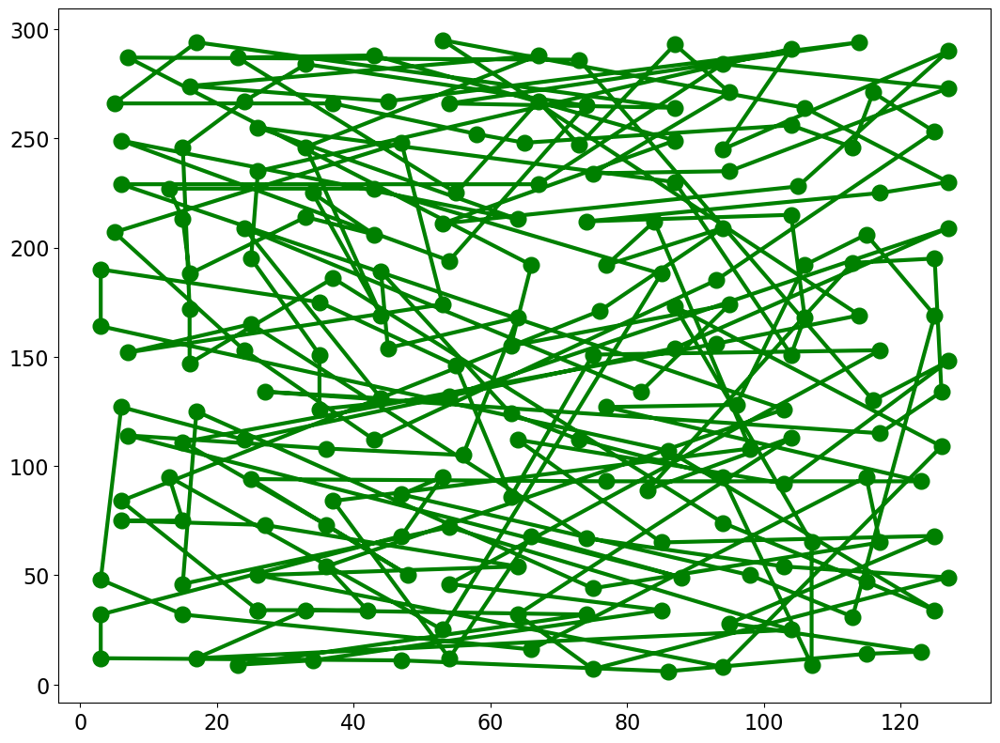

[I 2024-03-28 16:05:13,687] Trial 0 finished with value: 338.01119242359016 and parameters: {'c1': 1.9505775457121675}. Best is trial 0 with value: 338.01119242359016.


Minimum of objective function: 10442.32712866728
Mean of objective function: 10810.83909664716
Variance of objective function: 80352.57521839955
Monte Carlo standard error: 89.63959795670635


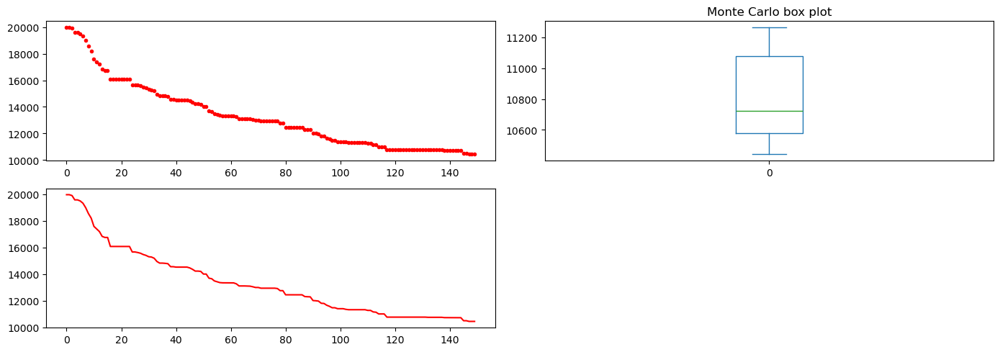

relative error PSO algorithm:  349.28971157985364 %


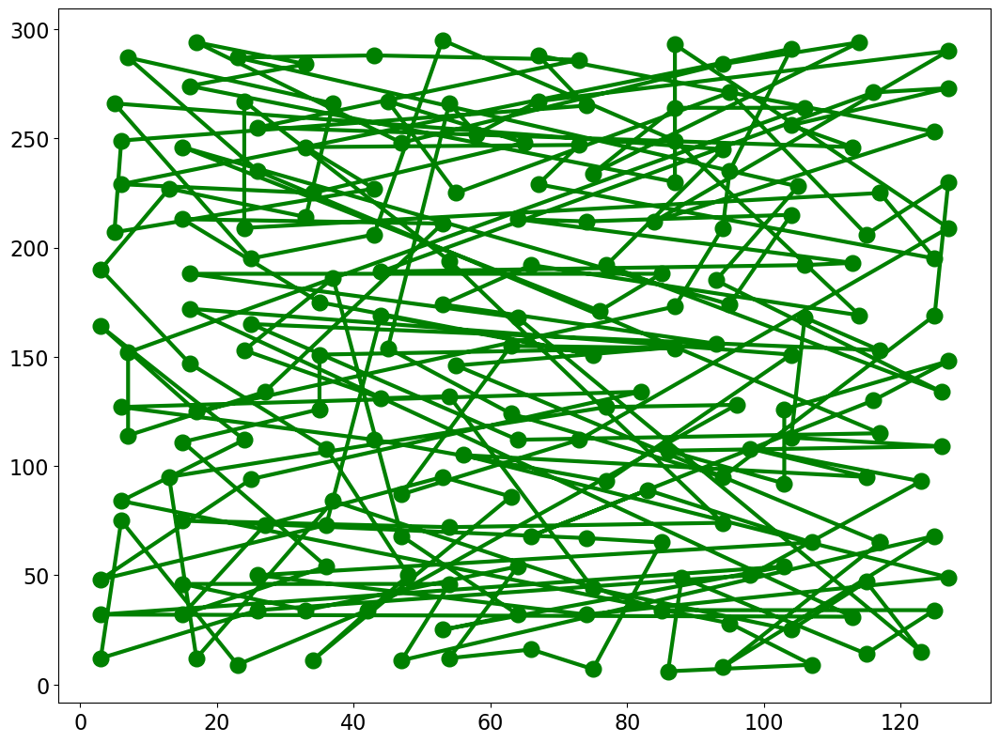

[I 2024-03-28 16:05:33,647] Trial 1 finished with value: 349.28971157985364 and parameters: {'c1': 0.1886964622827896}. Best is trial 0 with value: 338.01119242359016.


Minimum of objective function: 10565.026129569083
Mean of objective function: 11006.606164579383
Variance of objective function: 78503.1983429749
Monte Carlo standard error: 88.60203064432265


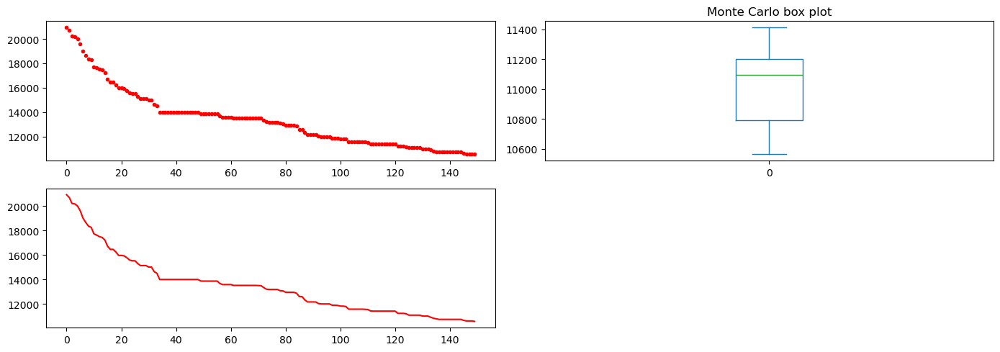

relative error PSO algorithm:  354.842875591907 %


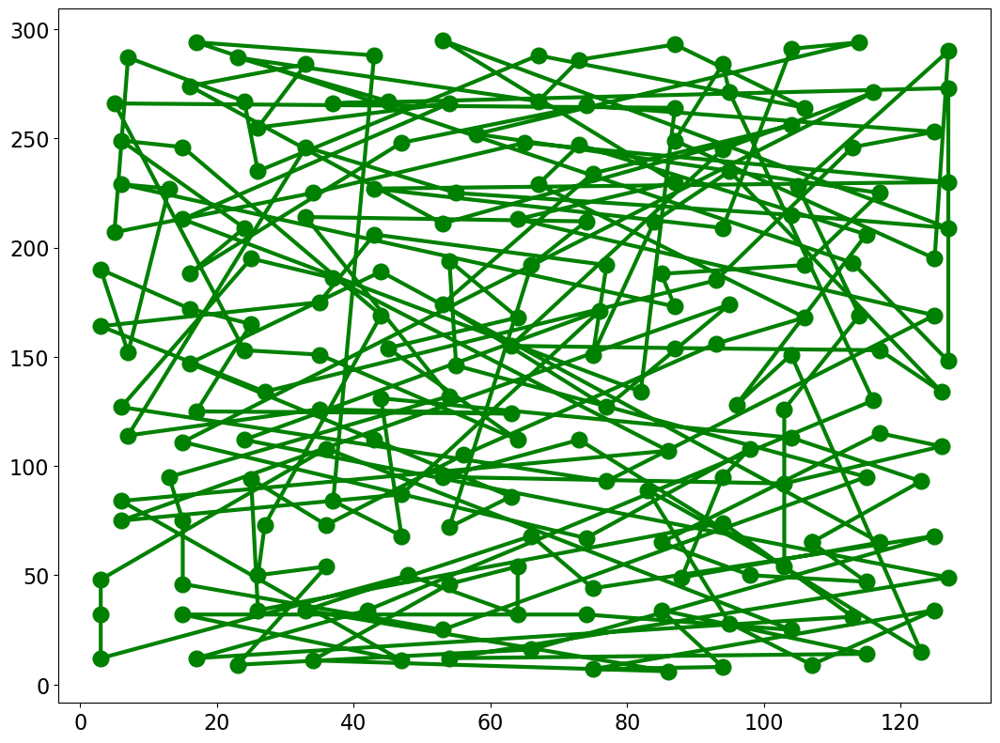

[I 2024-03-28 16:05:53,683] Trial 2 finished with value: 354.842875591907 and parameters: {'c1': 2.707957757748298}. Best is trial 0 with value: 338.01119242359016.


Minimum of objective function: 10277.214786436927
Mean of objective function: 10792.846392181664
Variance of objective function: 120416.5627676415
Monte Carlo standard error: 109.73448080145158


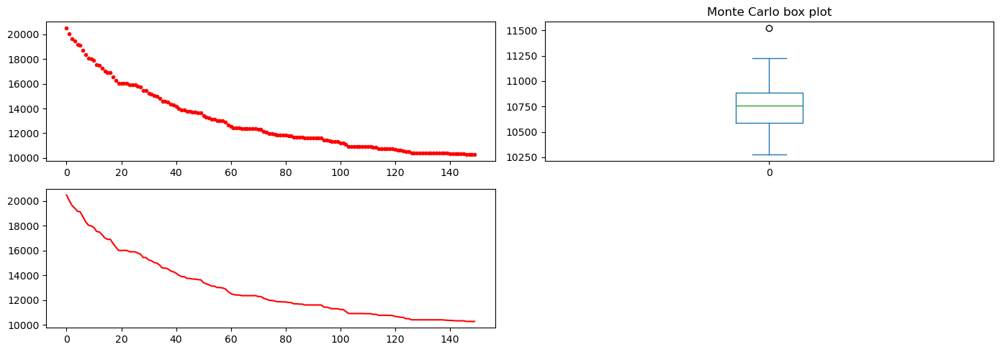

relative error PSO algorithm:  342.4020662935859 %


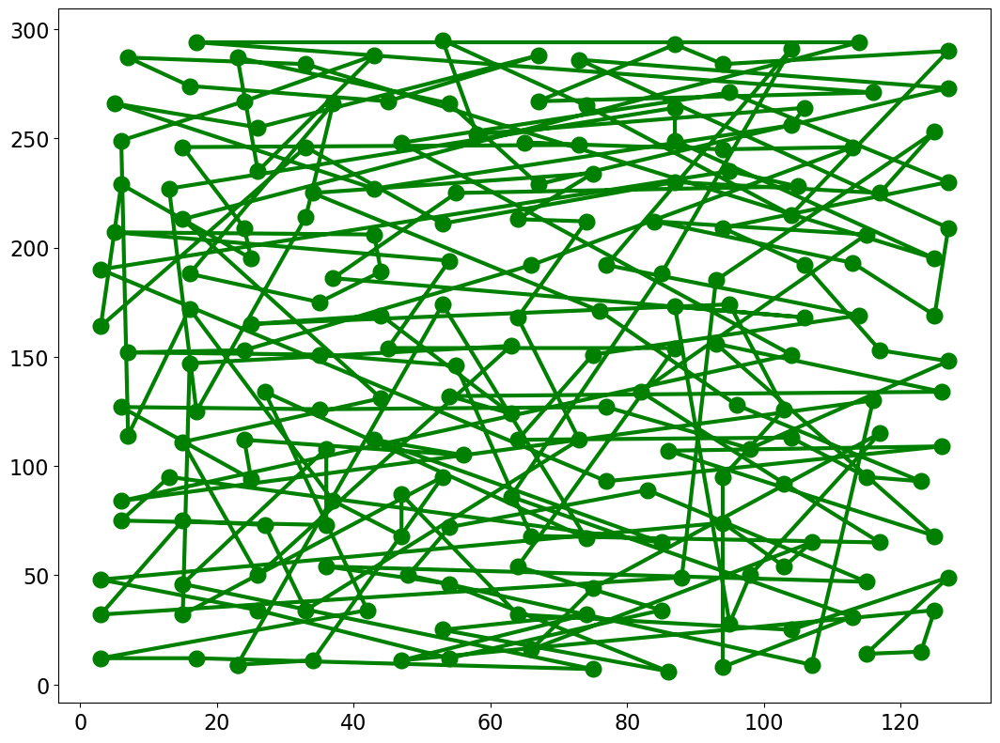

[I 2024-03-28 16:06:13,591] Trial 3 finished with value: 342.4020662935859 and parameters: {'c1': 2.266820228665889}. Best is trial 0 with value: 338.01119242359016.


Minimum of objective function: 10081.786616299634
Mean of objective function: 10887.126518558754
Variance of objective function: 122139.42759431801
Monte Carlo standard error: 110.51670805553249


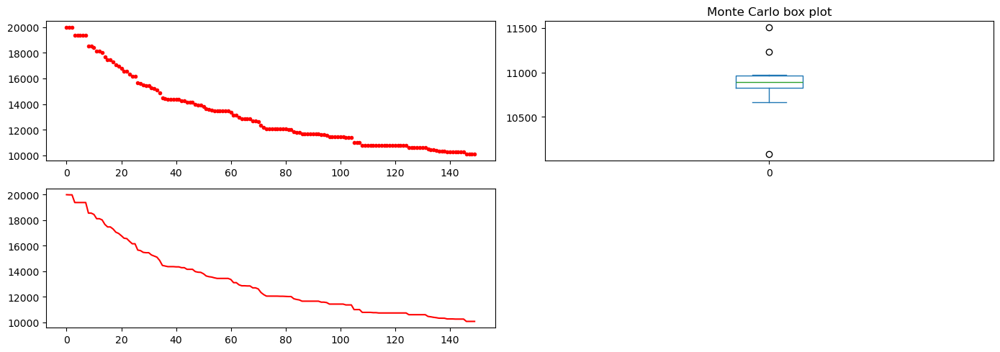

relative error PSO algorithm:  334.007748600947 %


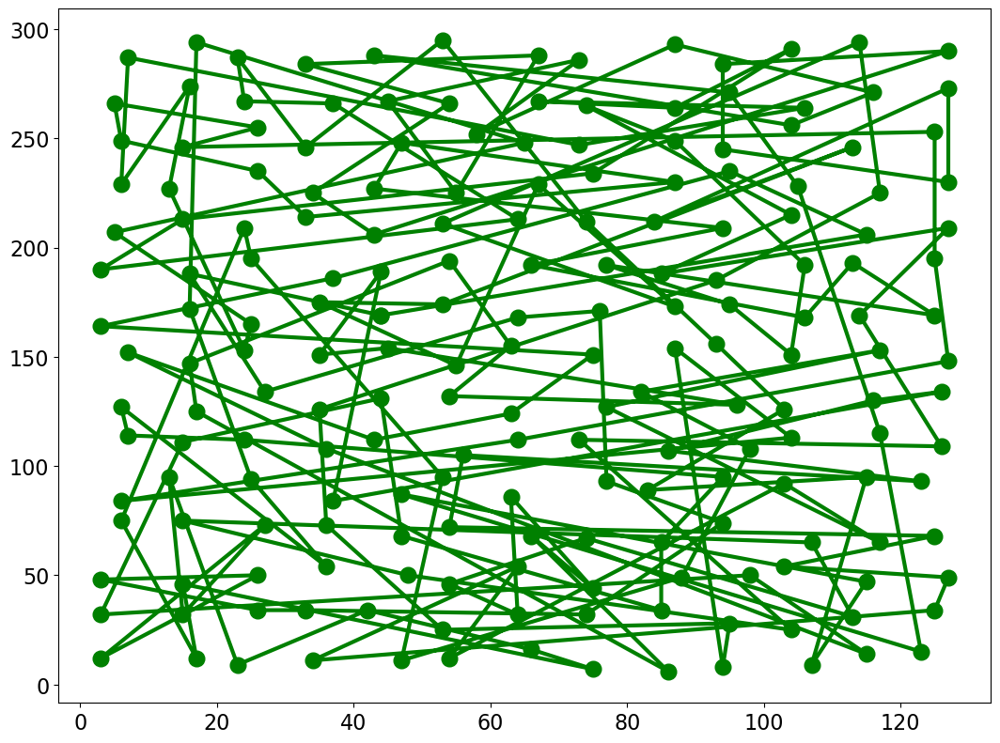

[I 2024-03-28 16:06:33,470] Trial 4 finished with value: 334.007748600947 and parameters: {'c1': 2.5553351687789414}. Best is trial 4 with value: 334.007748600947.


Minimum of objective function: 10463.059778454797
Mean of objective function: 10941.924829864458
Variance of objective function: 124732.05481424837
Monte Carlo standard error: 111.6835058610932


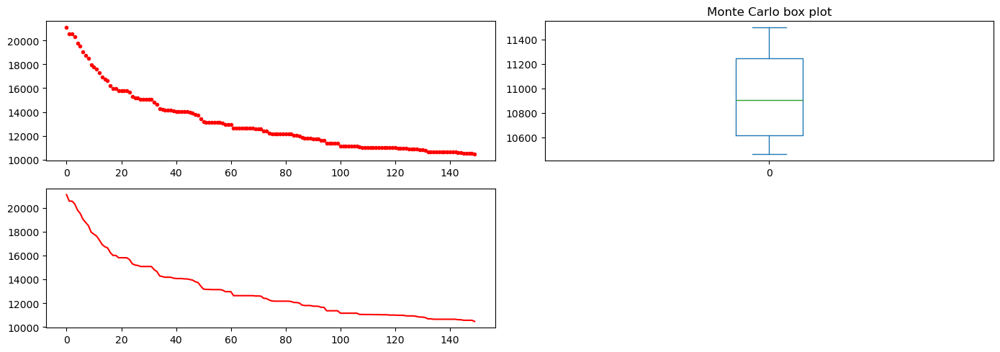

relative error PSO algorithm:  350.23676280671543 %


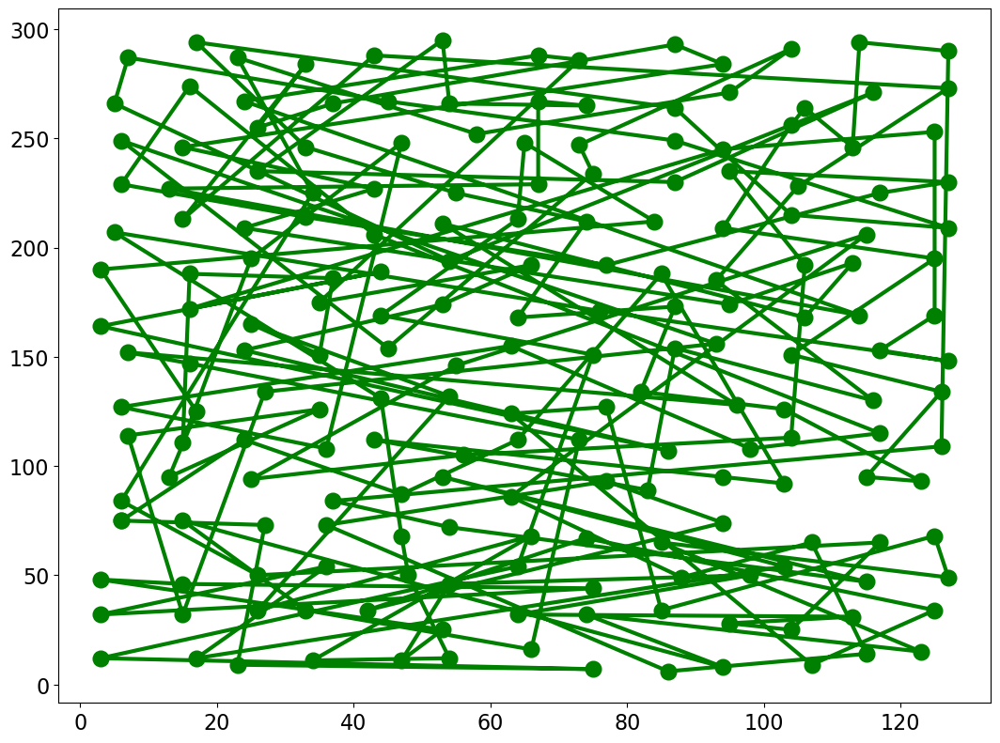

[I 2024-03-28 16:06:53,418] Trial 5 finished with value: 350.23676280671543 and parameters: {'c1': 0.48900882391226014}. Best is trial 4 with value: 334.007748600947.


Minimum of objective function: 10342.534551552795
Mean of objective function: 11006.94526769404
Variance of objective function: 189308.35831318554
Monte Carlo standard error: 137.58937397676664


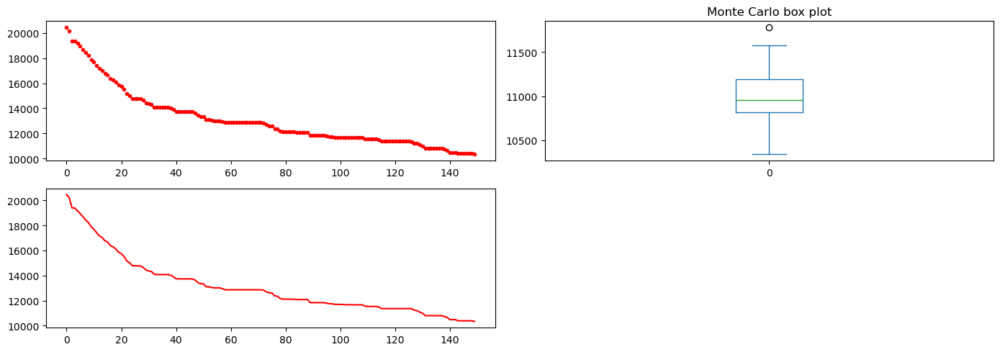

relative error PSO algorithm:  345.157124408093 %


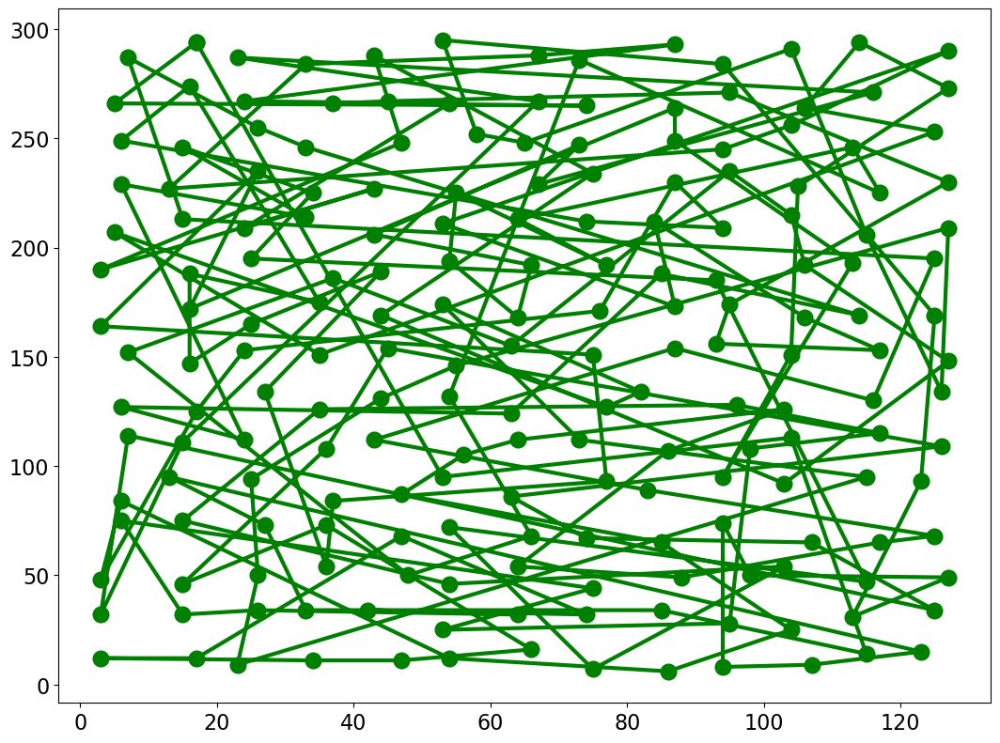

[I 2024-03-28 16:07:13,511] Trial 6 finished with value: 345.157124408093 and parameters: {'c1': 1.9816893523745596}. Best is trial 4 with value: 334.007748600947.


Minimum of objective function: 10440.350976482227
Mean of objective function: 10885.659888168473
Variance of objective function: 111674.029808404
Monte Carlo standard error: 105.6759337826754


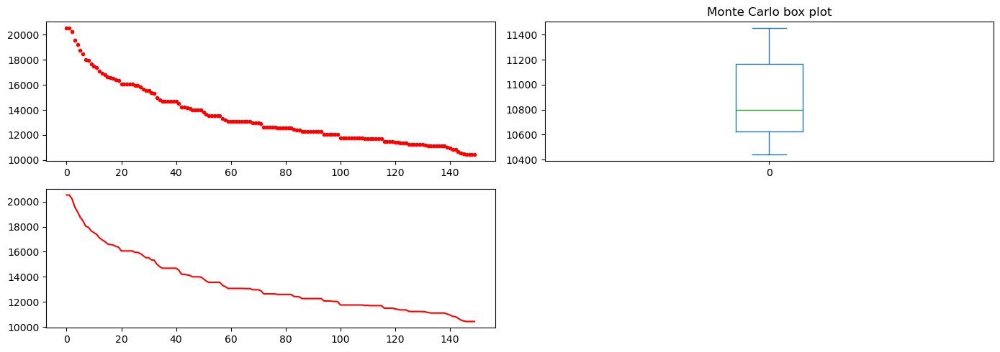

relative error PSO algorithm:  349.37580714593196 %


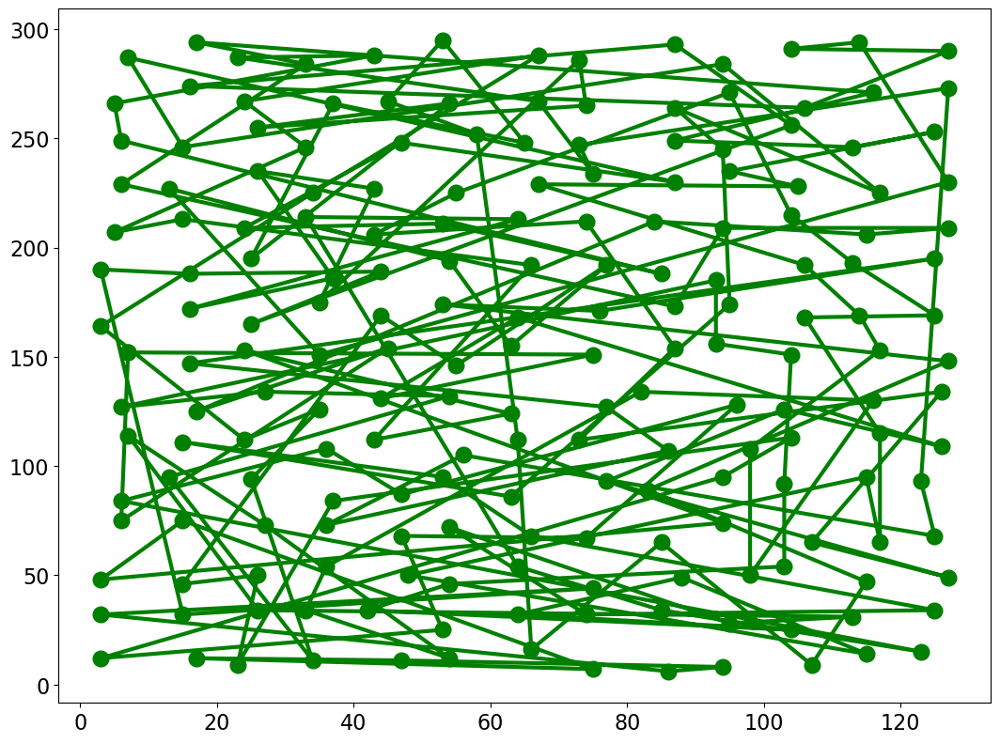

[I 2024-03-28 16:07:33,524] Trial 7 finished with value: 349.37580714593196 and parameters: {'c1': 2.3361274569570236}. Best is trial 4 with value: 334.007748600947.


Minimum of objective function: 10364.297297681482
Mean of objective function: 10873.503455880305
Variance of objective function: 155750.131607386
Monte Carlo standard error: 124.79989247086152


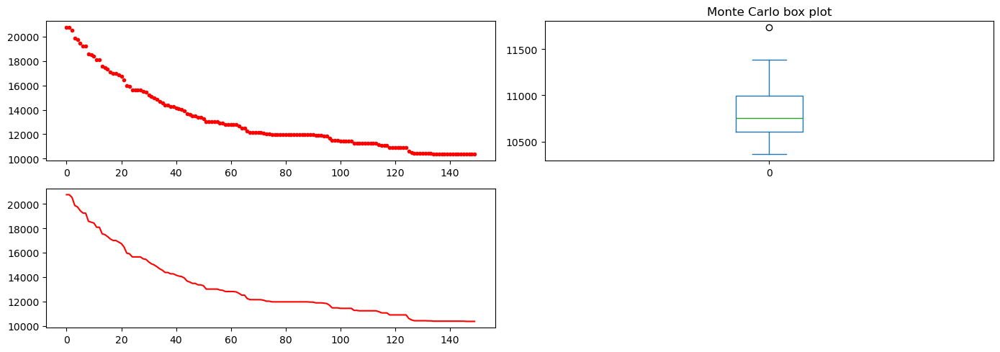

relative error PSO algorithm:  345.9319845027981 %


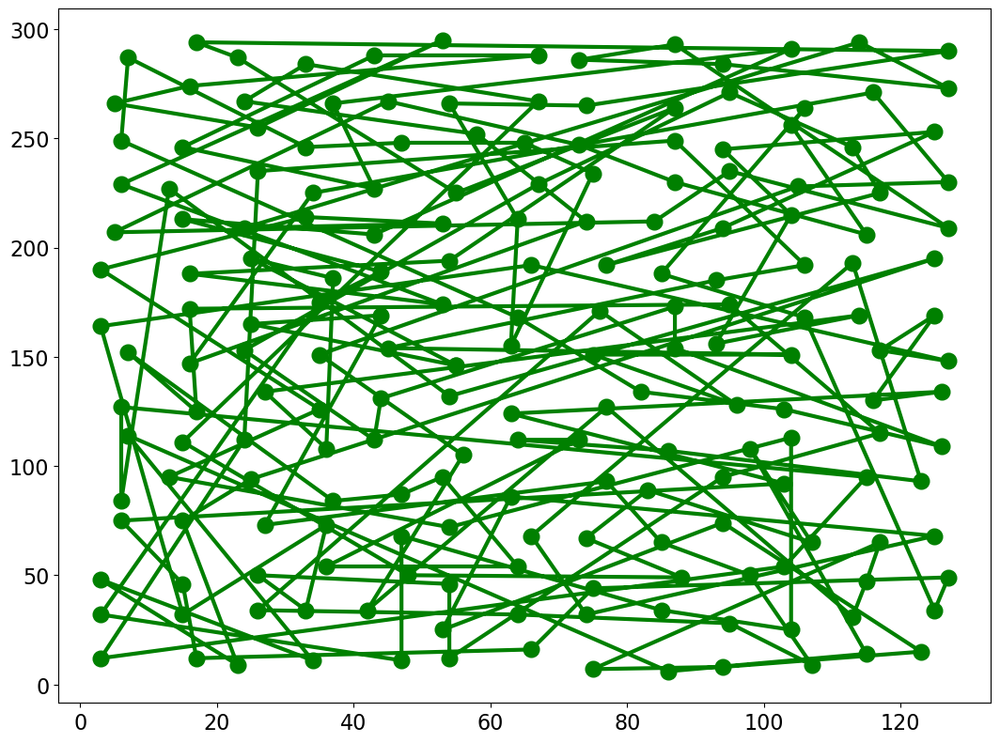

[I 2024-03-28 16:07:53,598] Trial 8 finished with value: 345.9319845027981 and parameters: {'c1': 2.6730368061504963}. Best is trial 4 with value: 334.007748600947.


Minimum of objective function: 10301.283746788235
Mean of objective function: 10939.527946616905
Variance of objective function: 217526.34467075494
Monte Carlo standard error: 147.4877434469573


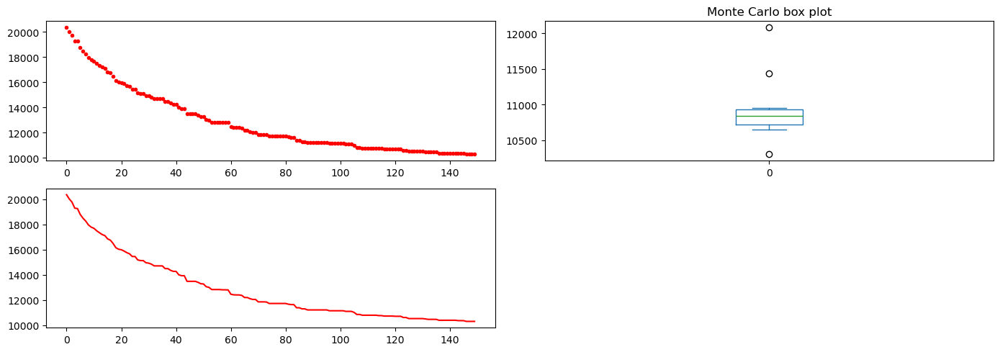

relative error PSO algorithm:  343.3921653034869 %


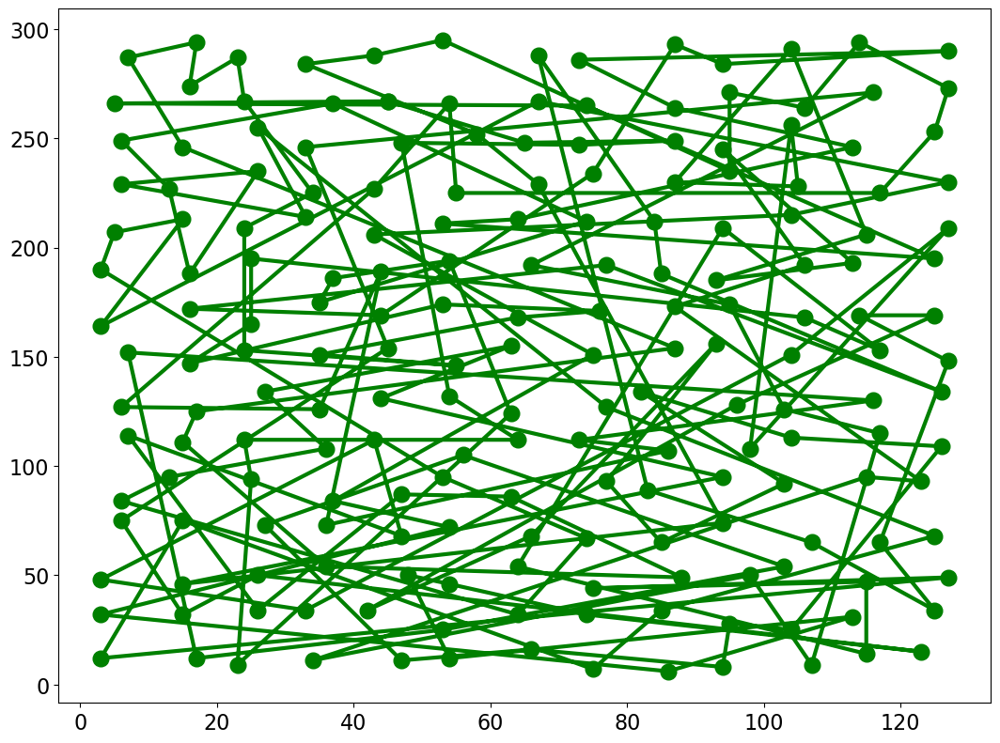

[I 2024-03-28 16:08:13,548] Trial 9 finished with value: 343.3921653034869 and parameters: {'c1': 0.761755201547283}. Best is trial 4 with value: 334.007748600947.


In [17]:
def objective(trial):
    params = {
        "size_pop": 40,
        'max_iter': 150,
        'w': 0.8,
        'c1': trial.suggest_float("c1", 0.01, 3.0),
        'c2': 0.5,
    }

    # Add a callback for pruning.
    bestT,error=MonteCarloPSOTour(rounds,theCities,bestLength,params, plot=True)
    print("relative error PSO algorithm: ",error,"%")
    PlotTour(bestT,"green",show=True,fn=filename+"_GeneticAlgorithm.png")
    return error

study = optuna.create_study(
    directions=["minimize"]
)
study.optimize(objective, callbacks=[MaxTrialsCallback(10, states=(TrialState.COMPLETE,))])

/tmp/ipykernel_822/574205412.py:1: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Relative error")


<Axes: title={'center': 'Parallel Coordinate Plot'}>

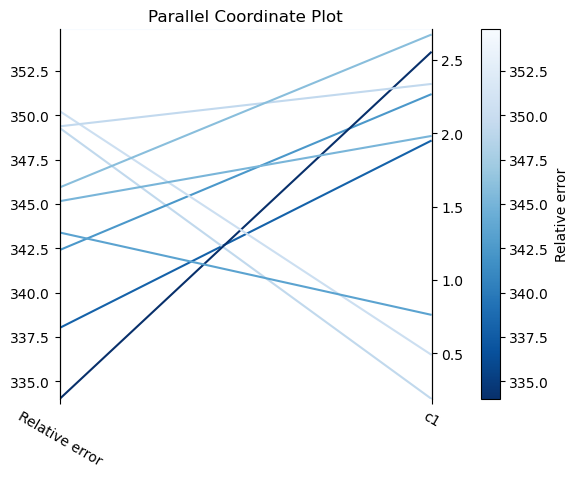

In [18]:
plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Relative error")

The personal best control value in PSO determines the influence of a particle's historical best position on its movement in the search space. A higher personal best control value gives more weight to the particle's historical best position, causing it to be more conservative and exploitative in its exploration. This means that particles tend to converge towards their individual best-known solutions, leading to more exploitation of promising regions in the search space. Conversely, a lower personal best control value makes the particle's movement more explorative, as it relies less on its historical best position and explores the search space more extensively.

It does not seem to exist any correlation between the value of c1 and the relative error in this problem, however too low c1 values seem to provide worse results.

#### 2.2.5 Varying c2 (global best)
We will analyze 10 different values for the c2 between 0.01 and 3.0.

[I 2024-03-28 16:08:13,795] A new study created in memory with name: no-name-85cb80a0-889c-4819-a144-5e7e0d260419


Minimum of objective function: 10221.205951142572
Mean of objective function: 10750.733447882469
Variance of objective function: 96070.12864091364
Monte Carlo standard error: 98.01537055019158


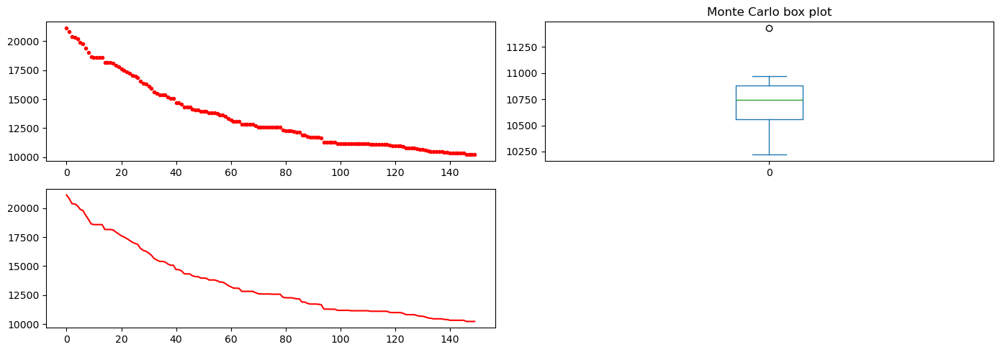

relative error PSO algorithm:  339.7331037451571 %


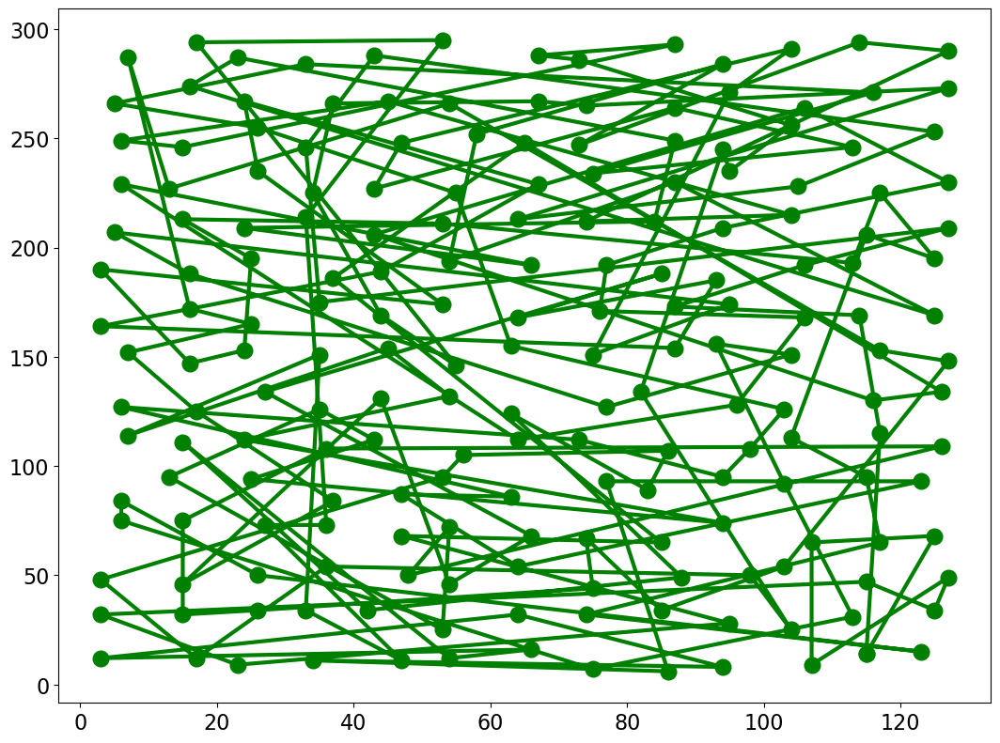

[I 2024-03-28 16:08:33,684] Trial 0 finished with value: 339.7331037451571 and parameters: {'c1': 1.119238019499351}. Best is trial 0 with value: 339.7331037451571.


Minimum of objective function: 10508.533660585354
Mean of objective function: 11006.63427168522
Variance of objective function: 110421.1546452922
Monte Carlo standard error: 105.08147060509393


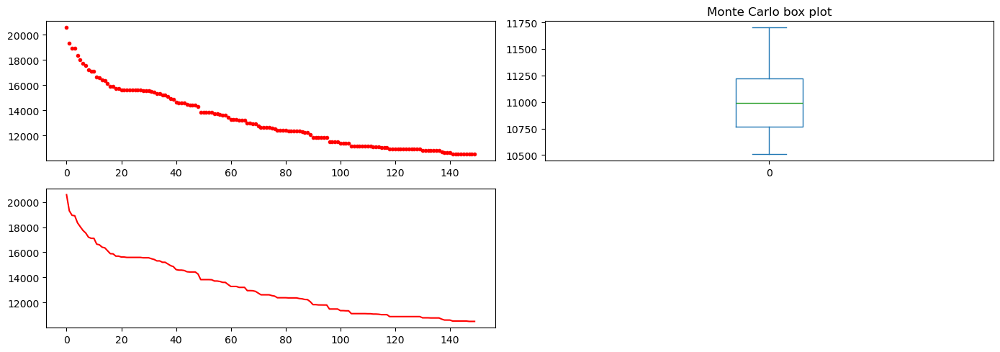

relative error PSO algorithm:  352.04476969436075 %


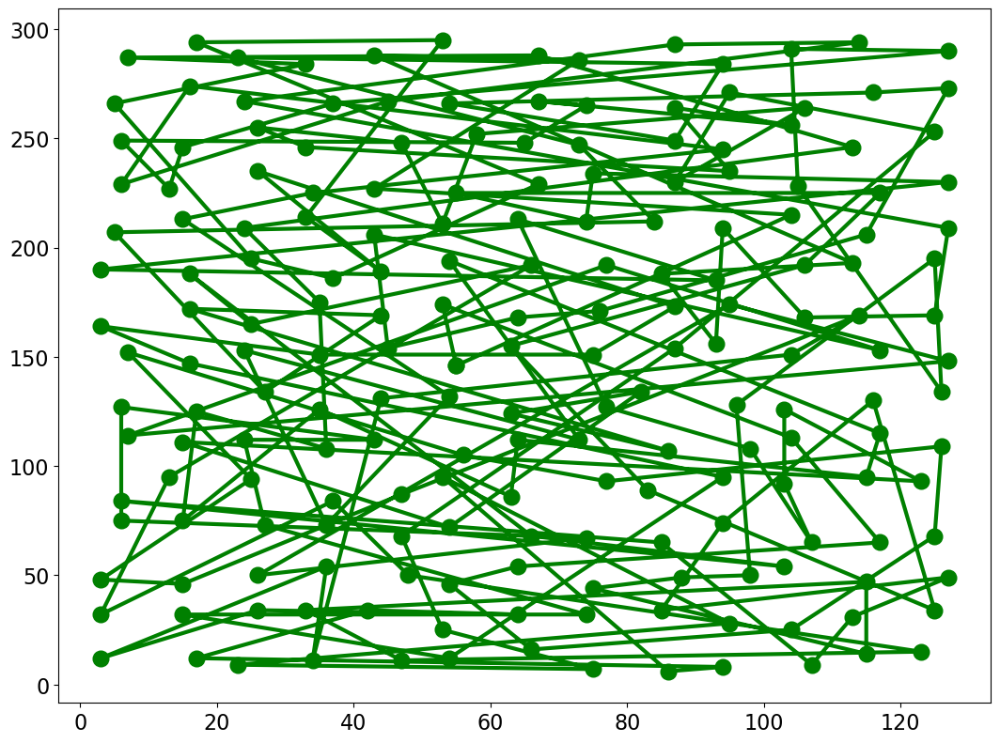

[I 2024-03-28 16:08:53,655] Trial 1 finished with value: 352.04476969436075 and parameters: {'c1': 1.8353853109933154}. Best is trial 0 with value: 339.7331037451571.


Minimum of objective function: 10454.475766227459
Mean of objective function: 11033.940033905581
Variance of objective function: 188084.51884160697
Monte Carlo standard error: 137.14390939506097


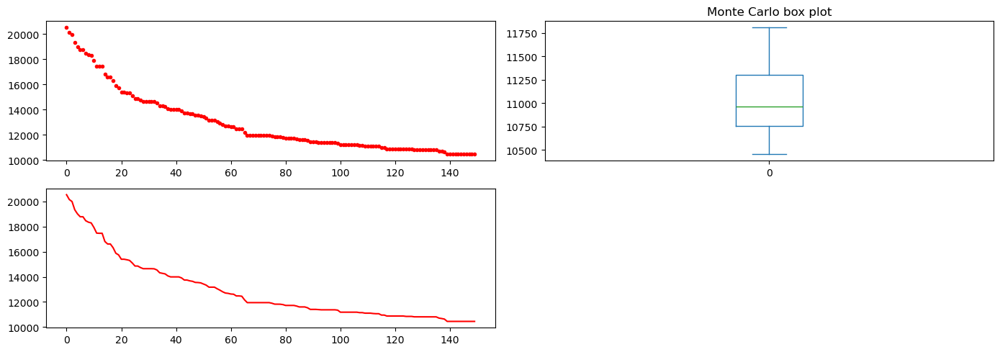

relative error PSO algorithm:  350.10761945759793 %


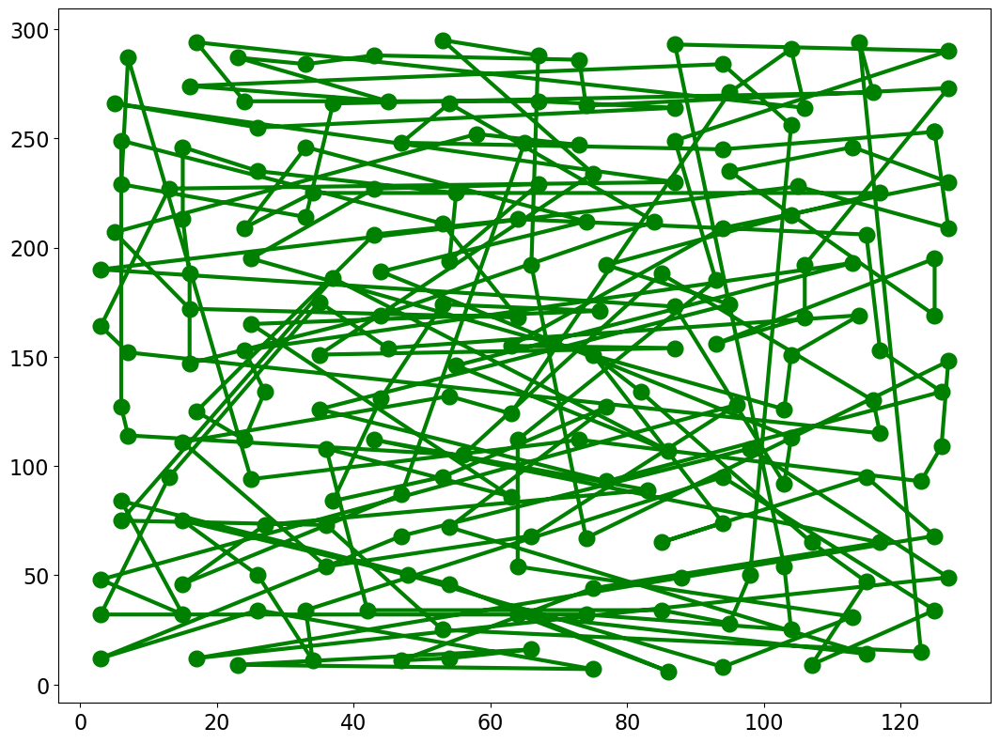

[I 2024-03-28 16:09:13,704] Trial 2 finished with value: 350.10761945759793 and parameters: {'c1': 1.8071034711416416}. Best is trial 0 with value: 339.7331037451571.


Minimum of objective function: 10588.122973249785
Mean of objective function: 10933.603348041524
Variance of objective function: 99503.92812228718
Monte Carlo standard error: 99.75165568665372


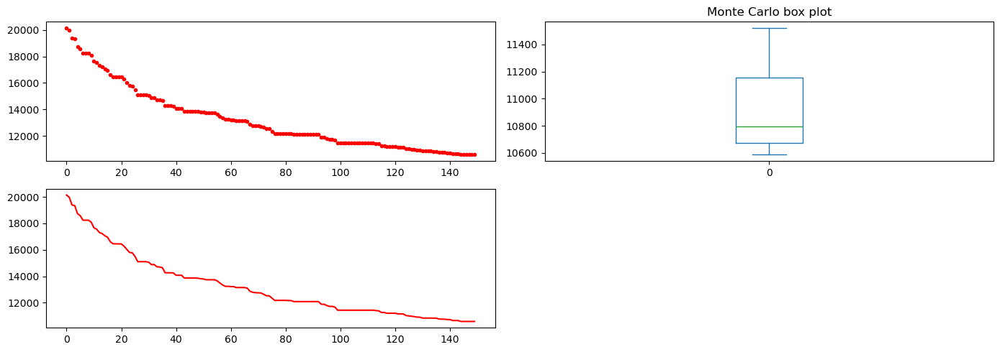

relative error PSO algorithm:  355.2733534222987 %


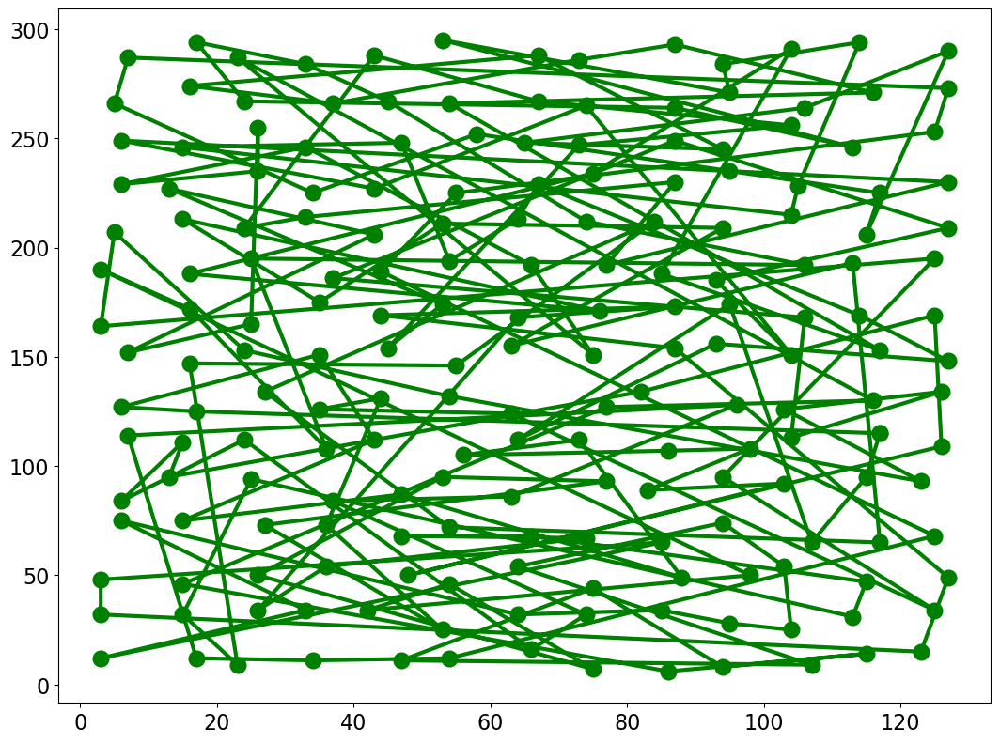

[I 2024-03-28 16:09:33,838] Trial 3 finished with value: 355.2733534222987 and parameters: {'c1': 2.321335949655554}. Best is trial 0 with value: 339.7331037451571.


Minimum of objective function: 10360.1008445989
Mean of objective function: 10840.610106906192
Variance of objective function: 86632.47334701962
Monte Carlo standard error: 93.07656705477464


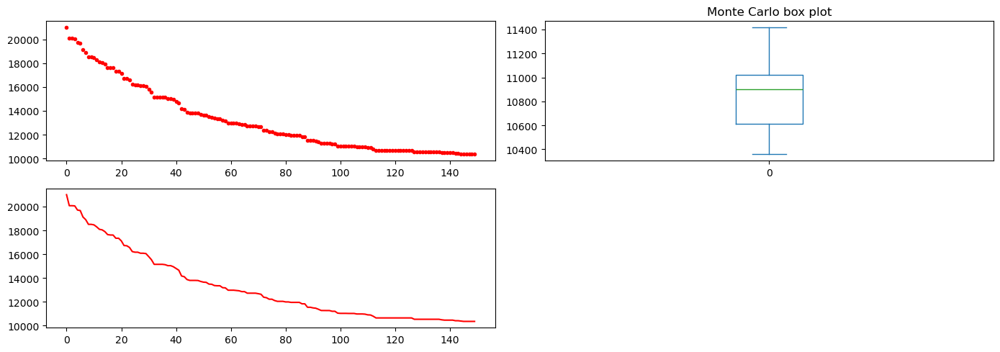

relative error PSO algorithm:  345.88893671975893 %


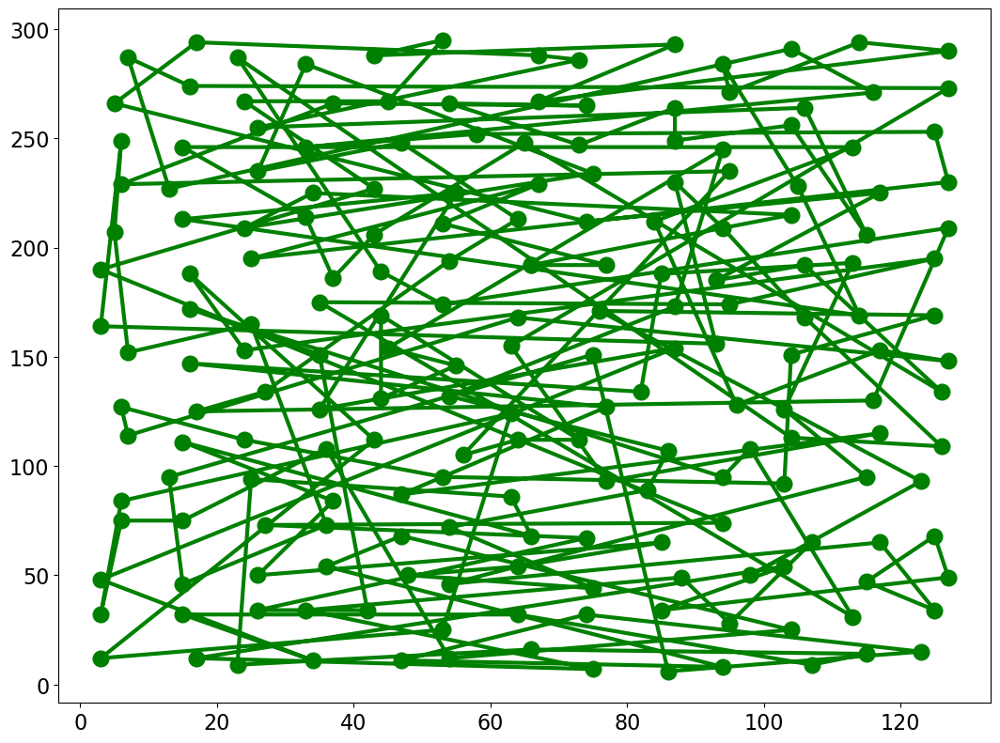

[I 2024-03-28 16:09:53,886] Trial 4 finished with value: 345.88893671975893 and parameters: {'c1': 0.2458737487143853}. Best is trial 0 with value: 339.7331037451571.


Minimum of objective function: 10306.661115133926
Mean of objective function: 10817.180885795558
Variance of objective function: 113751.05049841879
Monte Carlo standard error: 106.65413751862549


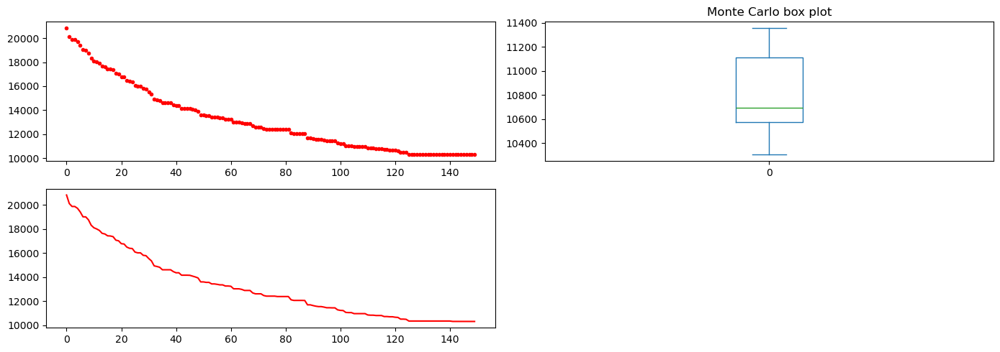

relative error PSO algorithm:  343.4782608695652 %


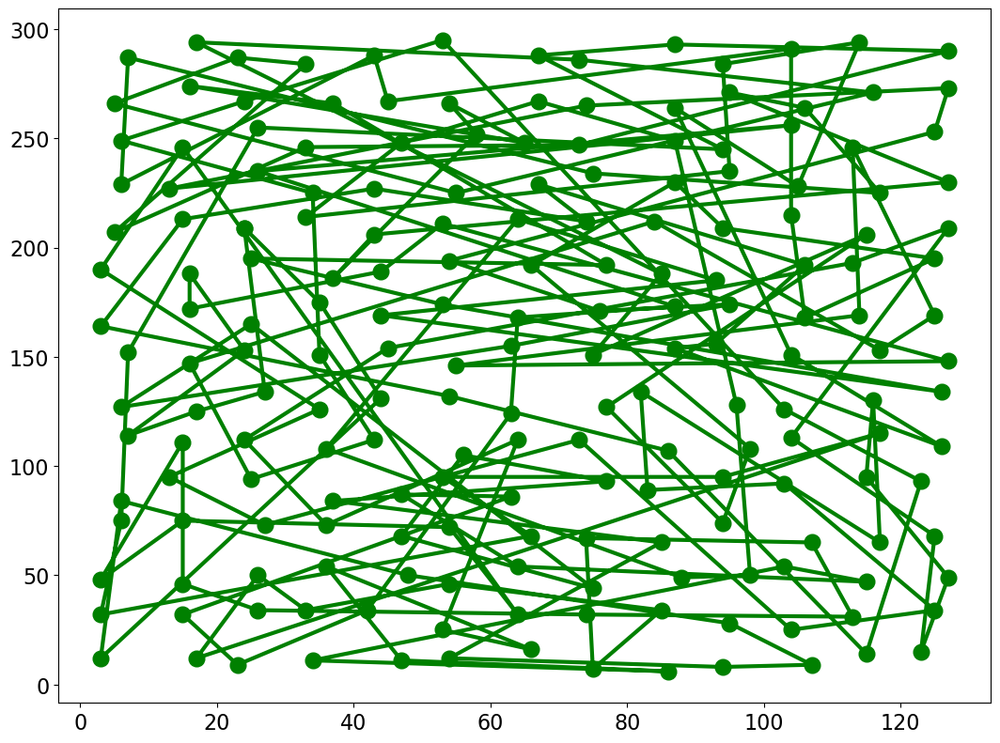

[I 2024-03-28 16:10:13,978] Trial 5 finished with value: 343.4782608695652 and parameters: {'c1': 1.692675902317843}. Best is trial 0 with value: 339.7331037451571.


Minimum of objective function: 10356.69044456773
Mean of objective function: 10885.75215360982
Variance of objective function: 132368.21843337454
Monte Carlo standard error: 115.05138783751134


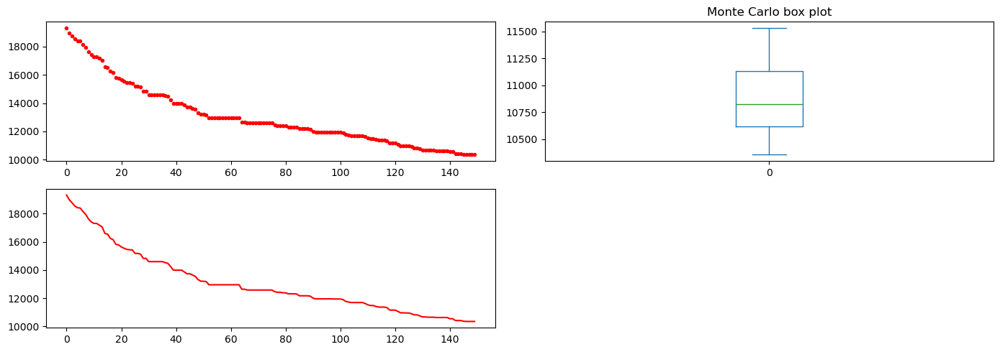

relative error PSO algorithm:  345.4584588893672 %


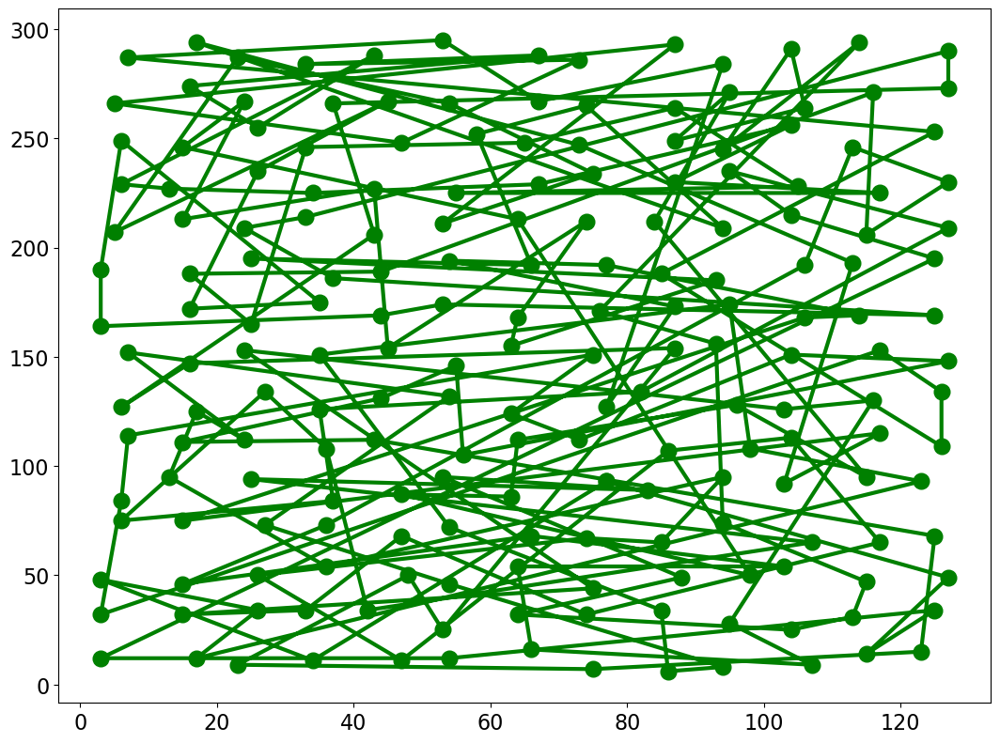

[I 2024-03-28 16:10:34,037] Trial 6 finished with value: 345.4584588893672 and parameters: {'c1': 2.2760476496628854}. Best is trial 0 with value: 339.7331037451571.


Minimum of objective function: 10318.092490437983
Mean of objective function: 11009.83192298736
Variance of objective function: 170360.17252371035
Monte Carlo standard error: 130.5220948819434


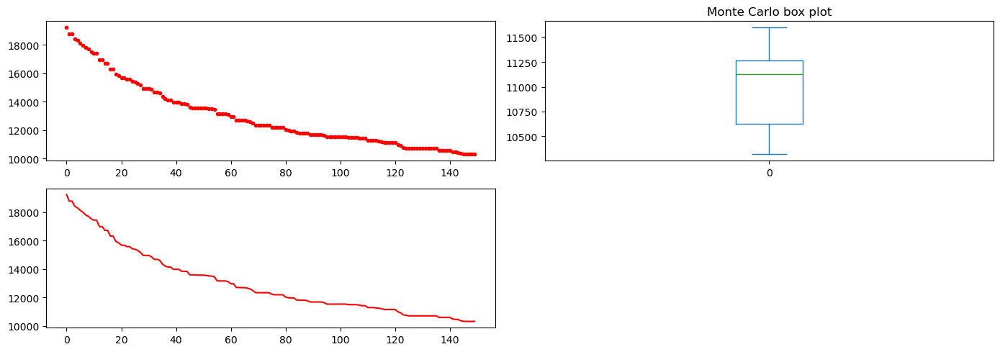

relative error PSO algorithm:  344.08092983211367 %


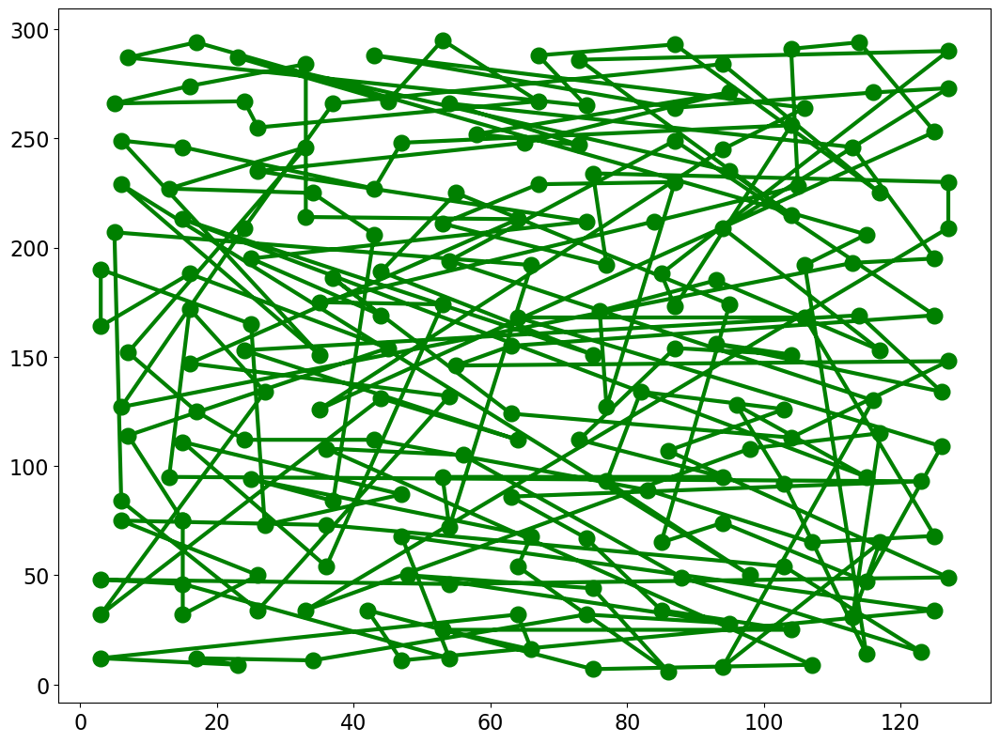

[I 2024-03-28 16:10:54,181] Trial 7 finished with value: 344.08092983211367 and parameters: {'c1': 2.9997768880103903}. Best is trial 0 with value: 339.7331037451571.


Minimum of objective function: 10588.400623243322
Mean of objective function: 10941.9387432812
Variance of objective function: 55527.75774909055
Monte Carlo standard error: 74.51694958134729


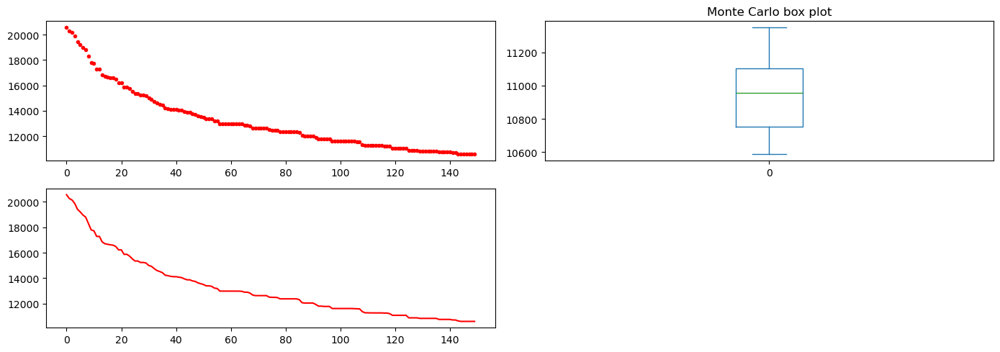

relative error PSO algorithm:  355.61773568661215 %


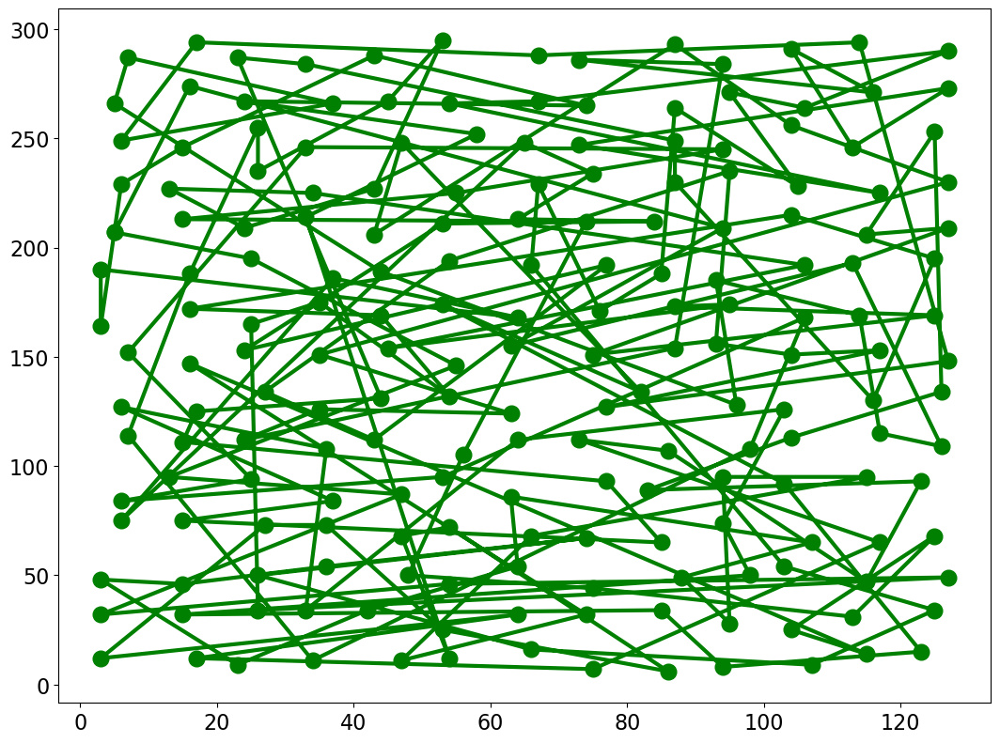

[I 2024-03-28 16:11:14,348] Trial 8 finished with value: 355.61773568661215 and parameters: {'c1': 2.939355642114191}. Best is trial 0 with value: 339.7331037451571.


Minimum of objective function: 10412.970764205202
Mean of objective function: 10819.241406021762
Variance of objective function: 85854.43993933749
Monte Carlo standard error: 92.65767099346792


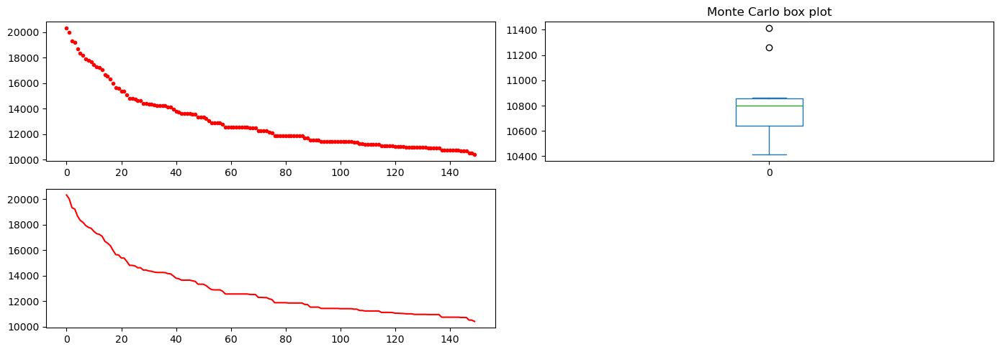

relative error PSO algorithm:  348.12742143779593 %


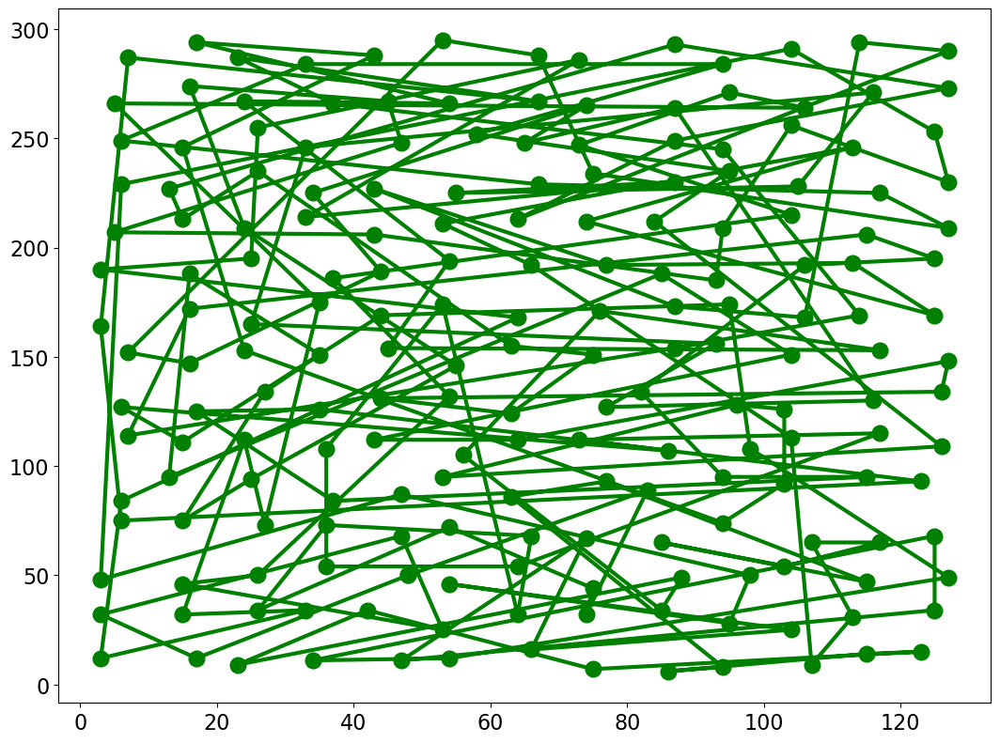

[I 2024-03-28 16:11:34,456] Trial 9 finished with value: 348.12742143779593 and parameters: {'c1': 1.242299330828841}. Best is trial 0 with value: 339.7331037451571.


In [19]:
def objective(trial):
    params = {
        "size_pop": 40,
        'max_iter': 150,
        'w': 0.8,
        'c1': 0.5,
        'c2': trial.suggest_float("c1", 0.01, 3.0),
    }

    # Add a callback for pruning.
    bestT,error=MonteCarloPSOTour(rounds,theCities,bestLength,params, plot=True)
    print("relative error PSO algorithm: ",error,"%")
    PlotTour(bestT,"green",show=True,fn=filename+"_GeneticAlgorithm.png")
    return error

study = optuna.create_study(
    directions=["minimize"]
)
study.optimize(objective, callbacks=[MaxTrialsCallback(10, states=(TrialState.COMPLETE,))])

/tmp/ipykernel_822/574205412.py:1: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Relative error")


<Axes: title={'center': 'Parallel Coordinate Plot'}>

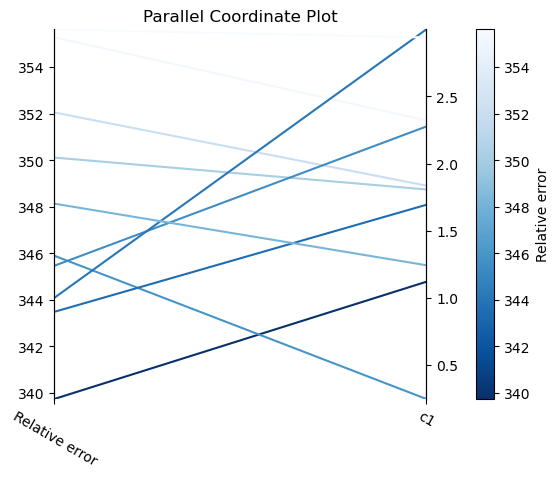

In [20]:
plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Relative error")

The global best control value represents the impact of the best solution found by any particle in the swarm on the movement of all other particles. A higher value encourages greater exploration of the search space as particles are more influenced by the best solution found globally, promoting convergence towards promising regions. Conversely, a lower value promotes exploitation, focusing the particles on refining their search around the current best solution. The choice thus affects the balance between exploration and exploitation in the optimization process, with higher values favoring exploration and lower values favoring exploitation.

It does not seem to exist any correlation between the value of c1 and the relative error in this problem.

## Minimizing TSP using grid search

First, we will follow the previous strategy in which we performed a grid search over a set of parameters trying to find the best combination. We will test them using `berlin52.tour`.

In [22]:
filename='berlin52'

# Define the parameter grid for PSO
PSO_param_grid = {
    'size_pop': [20, 50, 100, 500],
    'max_iter': [1000],
    'w': [0.1, 0.5, 0.9],
    'c1': [0.1, 0.5, 2.5],
    'c2': [0.1, 0.5, 2.5]
}

# Perform grid search for PSO
best_params = None
best_error = float('inf')

theCities,bestLength,bestTour=ReadTsp(TOURS_PATH+"/"+filename)
if bestTour != [] and bestLength!=TourLength(bestTour):
  print("strange best tour given",TourLength(bestTour))

for size_pop in PSO_param_grid['size_pop']:
    for max_iter in PSO_param_grid['max_iter']:
        for w in PSO_param_grid['w']:
            for c1 in PSO_param_grid['c1']:
                for c2 in PSO_param_grid['c2']:
                    params = {'size_pop': size_pop, 'max_iter': max_iter, 'w': w, 'c1': c1, 'c2': c2}
                    print("Testing params",params)
                    bestT,error=MonteCarloPSOTour(rounds,theCities,bestLength,params)
                    print("Relative error PSO algorithm: ",error,"%")
                    
                    if error < best_error:
                        best_error = error
                        best_params = params

                    print()

print("Best Parameters:", best_params)
print("Best Error Value:", best_error)

reading tour berlin52
reading done 7542.0
Testing params {'size_pop': 20, 'max_iter': 1000, 'w': 0.1, 'c1': 0.1, 'c2': 0.1}
Minimum of objective function: 8505.363049358355
Mean of objective function: 9247.620423231714
Variance of objective function: 125848.22936411606
Relative error PSO algorithm:  12.768496420047732 %

Testing params {'size_pop': 20, 'max_iter': 1000, 'w': 0.1, 'c1': 0.1, 'c2': 0.5}
Minimum of objective function: 8437.242259537048
Mean of objective function: 9299.686056234586
Variance of objective function: 313062.6072502643
Relative error PSO algorithm:  11.866878811986211 %

Testing params {'size_pop': 20, 'max_iter': 1000, 'w': 0.1, 'c1': 0.1, 'c2': 2.5}
Minimum of objective function: 8847.17173214523
Mean of objective function: 9294.428568583065
Variance of objective function: 119856.55306415314
Relative error PSO algorithm:  17.276584460355345 %

Testing params {'size_pop': 20, 'max_iter': 1000, 'w': 0.1, 'c1': 0.5, 'c2': 0.1}
Minimum of objective function: 8523

In this case, most of the results indicate that the optimization algorithm has found a set of solutions where all objectives (errors) are at their minimum possible values simultaneously, suggesting that no further improvement can be made for optimizing `berlin52`. However, there seems to be a trade-off between mean performance and stability (variance) of the algorithm. While certain parameter configurations yield lower mean objective function values, they might also result in higher variance, suggesting instability.

### Check heuristics performance in every map

Let's find the optimal tour with every heuristic.

In [12]:
# Get tour filenames
tour_filenames = [ os.path.splitext(filename)[0] for filename in os.listdir(TOURS_PATH) if filename.endswith(".tsp") ]
results = {"File":[],"Quick tour":[],"Closest neighbor tour":[],"Pair center tour":[]}

for filename in tour_filenames:

  results["File"].append(filename)

  theCities,bestLength,bestTour=ReadTsp(TOURS_PATH+"/"+filename)
  if bestTour != [] and bestLength!=TourLength(bestTour):
    print("strange best tour given",TourLength(bestTour))

  # Quick tour
  bestT,error=QuickTour(theCities,rounds,bestLength)
  print("relative error quick tour ",error,"%")
  results["Quick tour"].append(error)

  # Closest neighbor tour
  bestT,error=ClosestNeighborTour(theCities,rounds,bestLength)
  print("relative error closest-neighbor tour: ",error,"%")
  results["Closest neighbor tour"].append(error)

  # Pair center tour
  bestT,error=PairCenterTour(theCities,bestLength)
  print("relative error pair-center tour: ",error,"%")
  results["Pair center tour"].append(error)

reading tour berlin52
reading done 7542.0
1 relative error quick tour:  13.9618138424821 %
2 relative error quick tour:  7.71678599840891 %
3 relative error quick tour:  8.644921771413419 %
4 relative error quick tour:  12.43701935826041 %
5 relative error quick tour:  15.69875364624768 %
6 relative error quick tour:  5.794219040042429 %
7 relative error quick tour:  10.07690267833466 %
8 relative error quick tour:  12.88782816229117 %
9 relative error quick tour:  13.099973481835057 %
10 relative error quick tour:  9.400689472288517 %
11 relative error quick tour:  11.11111111111111 %
12 relative error quick tour:  14.81039512065765 %
13 relative error quick tour:  12.874569079819677 %
14 relative error quick tour:  7.875894988066825 %
15 relative error quick tour:  13.789445770352692 %
16 relative error quick tour:  9.599575709360913 %
17 relative error quick tour:  13.882259347653143 %
18 relative error quick tour:  11.959692389286662 %
19 relative error quick tour:  19.066560594006

In [20]:
print(tabulate(results, headers=results.keys()))

File        Quick tour    Closest neighbor tour    Pair center tour
--------  ------------  -----------------------  ------------------
berlin52     3.67277                    8.47255             7.26598
berlin52     1.14028                    8.80403             7.26598
block40      0                          5                  10
dj38         0.0600962                  1.65264             3.20012
eil51        2.34742                   18.5446             14.7887
eil76        5.01859                   11.71                8.73606
kroA100      0.0563857                 19.4437             12.7385
kroB100      3.69902                   16.9053             12.0907
kroC100      0.891609                  13.5669              3.71102
kroD100      1.98178                   17.8971             12.5481
pr76         1.65867                   21.0449             13.4238
rat195      10.2023                    10.5467             12.3978
rat99        6.02808                   12.469              1

### Check PSO performance in every map

Let's find the optimal tour with PSO and discuss the obtained results. For the PSO we will use the best parameter set previously found **{'size_pop': 500, 'max_iter': 1000, 'w': 0.1, 'c1': 0.5, 'c2': 0.5}**.

In [ ]:
# Get tour filenames
tour_filenames = [ os.path.splitext(filename)[0] for filename in os.listdir(TOURS_PATH) if filename.endswith(".tsp") ]

# Set params to test (PSO)
params = best_params

results = {"File":[],"Quick tour":[],"Closest neighbor tour":[],"Pair center tour":[],"PSO tour":[]}

for filename in tour_filenames:

  results["File"].append(filename)

  theCities,bestLength,bestTour=ReadTsp(TOURS_PATH+"/"+filename)
  if bestTour != [] and bestLength!=TourLength(bestTour):
    print("strange best tour given",TourLength(bestTour))

  # Quick tour
  bestT,error=QuickTour(theCities,rounds,bestLength)
  print("relative error quick tour ",error,"%")
  results["Quick tour"].append(error)

  # Closest neighbor tour
  bestT,error=ClosestNeighborTour(theCities,rounds,bestLength)
  print("relative error closest-neighbor tour: ",error,"%")
  results["Closest neighbor tour"].append(error)

  # Pair center tour
  bestT,error=PairCenterTour(theCities,bestLength)
  print("relative error pair-center tour: ",error,"%")
  results["Pair center tour"].append(error)

  # Monte Carlo particle swarm optimization tour
  bestT,error=MonteCarloPSOTour(rounds,theCities,bestLength,params)
  print("relative error PSO algorithm: ",error,"%")
  results["PSO tour"].append(error)

In [1]:
# Print relative error
print(tabulate(results, headers=results.keys()))

  Quick tour    Closest neighbor tour    Pair center tour    PSO tour  File
------------  -----------------------  ------------------  ----------  --------
    4.86608                  19.0666              7.26598     0        berlin52
    4                         5                   9           0        block40
    0.105168                  1.66767             3.20012     0        dj38
    6.33803                  22.5352             14.7887      2.11268  eil51
    7.62082                  15.7993             10.0372      4.83271  eil76
    5.40363                  21.5957             12.7385      3.06362  kroA100
    4.22745                  18.9603             12.0907      5.53272  kroB100
    3.46041                  21.683               3.71102     7.97147  kroC100
    3.55969                  17.9816             12.5481      4.04339  kroD100
    2.59156                  27.528              13.4238      2.13574  pr76
   11.8812                   10.2884             12.3978     53

## Descriptive statistics for TSP datasets:
|     |    mean       |    std         |    min   |    max    |
| --- | ------------- | -------------- | -------- | --------- |
|  Quick Tour   | 4.8570392     | 3.0690549441   | 0.105168 | 11.8812   |
|  Closest Neighbor Tour   | 16.5930513333 | 6.7302267161   | 1.66767  | 27.528    |
|  Pair Center Tour   | 11.737398     | 5.5481624743   | 3.20012  | 23.2475   |
|  PSO Tour   | 6.3740793333  | 13.3097825624  | 0        | 53.5514   |

As we can see in the plots above, using the selected parameter set the genetic algorithm achieved to outperform the other heuristics obtaining a lower relative error with many tours (`berlin52`, `block40`, `dj38`, `eil51`, `st70`, `wi29`). However some of them still overpassed by the other heuristics (`eil76`, `kroA100`, `kroB100`, `kroC100`, `kroD100`, `pr76`, `rat195`, `rat99`, `rd100`).

It is interesting to see how the PSO algorithm using the selected parameter set obtains the best results in all the maps except for `rat195`, where the error is much higher than the heuristics one. As we previously mention, finding the best parameters heavily depends on the problem, so in this case we could try to find another set of parameters to use when the number of cities is higher.

Another point worth to mention is that using this parameter set the genetic algorithm takes a lot of time to find the optimal tour (around 5 mins per tour) because of the high values of **pop** and **max_iter**.

In summary, PSO is more versatile and robust in finding near-optimal solutions for TSP instances, while heuristics offer simpler and faster approaches, albeit with potentially lower quality solutions.

The following table shows a comparison between the results obtained from the grid search optimization process using GA (in the previous delivery) and PSO.

| File | GA | PSO |
|----------|----------|----------|
| berlin52 | 3.26173 | 0 |
| block40 | 0 | 0 |
| dj38 | 0 | 0 |
| eil51 | 2.11267 | 2.11268 |
| eil76 | 9.85130 | 4.83271 |
| kroA100 | 55.23447 | 3.06362 |
| kroB100 | 59.56822 | 5.53272 |
| kroC100 | 64.45611 | 7.97147 |
| kroD100 | 54.24063 | 4.04339 |
| pr76 | 15.76845 | 2.13574 |
| rat195 | 229.83211 | 53.5514 |
| rat99 | 52.60115 | 7.59703 |
| rd100 | 59.63337 | 2.8445 |
| st70 | 4.88888 | 1.92593 |
| wi29 | 0 | 0 |

## Descriptive statistics for GA vs PSO comparison:
|     |    mean       |    std         |    min  |    max    |
| --- | ------------- | -------------- | ------- | --------- |
|  GA   | 40.7632726667 | 58.7377365375  | 0       | 229.83211 |
|  PSO   | 6.3740793333  | 13.3097825624  | 0       | 53.5514   |


As evidenced by the results, PSO tends to produce much lower error values compared to GA for several instances with a parameter set optimized for solving `berlin52`. However, as we saw in the previous assignment `berlin52` is a relatively small TSP instance with only 52 locations. PSO may perform well on such a small instance, but its performance may not generalize to larger or more complex TSP instances.


**Another experiment - Optimizing parameters for the most complex TSP dataset**

Let's see if we can find another set of parameters to deal with the maps composed of a high number of cities. We will test the same parameter sets as before using the map `rat195.tsp`.

In [33]:
filename='rat195'

# Define the parameter grid for PSO
PSO_param_grid = {
    'size_pop': [20, 50, 100, 500],
    'max_iter': [1000],
    'w': [0.1, 0.5, 0.9],
    'c1': [0.1, 0.5, 2.5],
    'c2': [0.1, 0.5, 2.5]
}

# Perform grid search for PSO
best_params = None
best_error = float('inf')

theCities,bestLength,bestTour=ReadTsp(TOURS_PATH+"/"+filename)
if bestTour != [] and bestLength!=TourLength(bestTour):
  print("strange best tour given",TourLength(bestTour))

for size_pop in PSO_param_grid['size_pop']:
    for max_iter in PSO_param_grid['max_iter']:
        for w in PSO_param_grid['w']:
            for c1 in PSO_param_grid['c1']:
                for c2 in PSO_param_grid['c2']:
                    params = {'size_pop': size_pop, 'max_iter': max_iter, 'w': w, 'c1': c1, 'c2': c2}
                    print("Testing params",params)
                    bestT,error=MonteCarloPSOTour(rounds,theCities,bestLength,params)
                    print("Relative error PSO algorithm: ",error,"%")
                    
                    if error < best_error:
                        best_error = error
                        best_params = params

                    print()

print("Best Parameters:", best_params)
print("Best Error Value:", best_error)

reading tour rat195
reading done 2323.0
Testing params {'size_pop': 20, 'max_iter': 1000, 'w': 0.1, 'c1': 0.1, 'c2': 0.1}
Minimum of objective function: 7652.060777076585
Mean of objective function: 8306.14563928165
Variance of objective function: 112814.59765519304
Relative error PSO algorithm:  229.14334911752044 %

Testing params {'size_pop': 20, 'max_iter': 1000, 'w': 0.1, 'c1': 0.1, 'c2': 0.5}
Minimum of objective function: 7778.329635437992
Mean of objective function: 8506.458592383251
Variance of objective function: 199661.41037984326
Relative error PSO algorithm:  234.739560912613 %

Testing params {'size_pop': 20, 'max_iter': 1000, 'w': 0.1, 'c1': 0.1, 'c2': 2.5}
Minimum of objective function: 7328.279008549649
Mean of objective function: 8158.207584252476
Variance of objective function: 205540.1893985201
Relative error PSO algorithm:  215.2819629789066 %

Testing params {'size_pop': 20, 'max_iter': 1000, 'w': 0.1, 'c1': 0.5, 'c2': 0.1}
Minimum of objective function: 7347.8456

As we can see, we obtain a set of parameters which provide a best error value of 30.99, much lower than the previous 229.83 with the previous set of parameters for the tour `rat195.tsp`. Let's test again to find the optimal tours.

In [ ]:
# Get tour filenames
tour_filenames = [ os.path.splitext(filename)[0] for filename in os.listdir(TOURS_PATH) if filename.endswith(".tsp") ]

# Set params to test (PSO)
params = best_params

results = {"File":[],"Quick tour":[],"Closest neighbor tour":[],"Pair center tour":[],"PSO tour":[]}

for filename in tour_filenames:

  results["File"].append(filename)

  theCities,bestLength,bestTour=ReadTsp(TOURS_PATH+"/"+filename)
  if bestTour != [] and bestLength!=TourLength(bestTour):
    print("strange best tour given",TourLength(bestTour))

  # Quick tour
  bestT,error=QuickTour(theCities,rounds,bestLength)
  print("relative error quick tour ",error,"%")
  results["Quick tour"].append(error)

  # Closest neighbor tour
  bestT,error=ClosestNeighborTour(theCities,rounds,bestLength)
  print("relative error closest-neighbor tour: ",error,"%")
  results["Closest neighbor tour"].append(error)

  # Pair center tour
  bestT,error=PairCenterTour(theCities,bestLength)
  print("relative error pair-center tour: ",error,"%")
  results["Pair center tour"].append(error)

  # Monte Carlo particle swarm optimization tour
  bestT,error=MonteCarloPSOTour(rounds,theCities,bestLength,params)
  print("relative error PSO algorithm: ",error,"%")
  results["PSO tour"].append(error)

In [35]:
print(tabulate(results, headers=results.keys()))

File        Quick tour    Closest neighbor tour    Pair center tour    PSO tour
--------  ------------  -----------------------  ------------------  ----------
berlin52       5.79422                 17.5285              7.26598    0
block40        4                        8                   9          0
dj38           2.34375                  1.68269             3.20012    0
eil51          4.46009                 20.892              14.7887     1.17371
eil76          7.99257                 15.9851             10.0372     4.64684
kroA100        5.53989                 22.8973             12.7385     2.96965
kroB100        5.1714                  17.5331             12.0907     6.41344
kroC100        3.44595                 19.3118              3.71102    6.85334
kroD100        4.46605                 18.5686             12.5481     3.4188
pr76           3.62984                 22.2034             13.4238     0.951377
rat195        11.1063                  13.9905             21.2656  

## Descriptive statistics for TSP datasets:
|     |    mean       |    std        |    min   |    max   |
| --- | ------------- | ------------- | -------- | -------- |
| Quick Tour    | 4.8946673333  | 2.645800311   | 0        | 11.1063  |
| Closest Neighbor Tour    | 16.6892326667 | 5.4902131196  | 1.68269  | 22.8973  |
| Pair Center Tour    | 12.3285846667 | 6.0713464805  | 3.20012  | 23.2475  |
| PSO Tour    | 5.5521638     | 10.983809779 | 0        | 44.124   |

With the new set of parameters the PSO achieves to overcome the other heuristics in almost every tour, with the exception of `kroA100`, `kroD100` and `rat195`. The relative error in `rat195` was reduced from 53.5514 to 44.124, a relatively good improvement but still far from a fair performance. In addition, optimizing the parameters of the PSO for the most complex tour reduced the mean relative error and the standard deviation, so PSO is now more stable. The table below shows a comparison between the results obtained from grid search in the previous delivery using the GA and those obtained above using PSO algorithm.

| File | GA | PSO |
|----------|----------|----------|
| berlin52 | 6.86820 | 0 |
| block40 | 2.0 | 0 |
| dj38 | 0.06009 | 0 |
| eil51 | 1.64319 | 1.17371 |
| eil76 | 4.83271 | 4.64684 |
| kroA100 | 4.96663 | 2.96965 |
| kroB100 | 2.77765 | 6.41344 |
| kroC100 | 2.89170 | 6.85334 |
| kroD100 | 8.36385 | 3.4188 |
| pr76 | 3.19159 | 0.951377 |
| rat195 | 28.62677 | 44.124 |
| rat99 | 7.10156 | 7.43187 |
| rd100 | 7.73704 | 3.81795 |
| st70 | 3.70370 | 1.48148 |
| wi29 | 0 | 0 |

## Descriptive statistics for TSP datasets:
|     |    mean      |    std        |    min  |    max   |
| --- | ------------ | ------------- | ------- | -------- |
|  GA   | 5.6509786667% | 6.8796581894%  | 0%       | 28.62677% |
|  PSO   | 5.5521638%    | 10.983809779%  | 0%       | 44.124%   |

Some discussion of the results is presented below:

- **Performance Comparison**:

Overall, PSO outperforms GA in several instances, as indicated by the lower tour lengths achieved by PSO compared to GA.
Instances such as `eil51`, `eil76`, `kroA100`, `kroB100`, `kroC100`, `kroD100`, `rat99`, `rd100`, and `st70` show lower tour lengths for PSO compared to GA, suggesting that PSO is more effective in finding shorter paths for these TSP instances. However, for some instances (`berlin52`, `block40`, `dj38`, `wi29`), PSO does not perform better than GA, as indicated by zero or higher tour lengths for PSO compared to GA. This suggests that PSO might not be well-suited for these particular TSP instances or that the parameter settings for PSO need further optimization. The characteristics of the TSP instances, such as the number of cities, the distribution of distances between cities, and the complexity of the optimal tour, influence the performance of the algorithms.

- **Consistency of Results**:

GA tends to produce more consistent results compared to PSO across different instances. This is evident from the smaller variance in tour error for GA in most cases, suggesting that it is more reliable in finding near-optimal solutions consistently.


Comparing with the previous results optimizing the parameters for solving `berlin52` the sensitivity of both algorithms to parameter settings and problem characteristics is evident in the fluctuation of error values across instances. `rat195` seems to pose a particularly challenging problem for both algorithms, as indicated by the relatively high error values in both sets of results. Also note that in this case the supremacy of **PSO** is not as evident as in the previous case.

In summary, while PSO generally outperforms GA in finding shorter tour lengths for various TSP instances, its effectiveness varies depending on the specific characteristics of the problem instance. Further experimentation and parameter tuning could potentially enhance the performance of PSO for solving TSP instances. Thus we will employ again Optuna to experiment a bit more with PSO.

### Solving TSP using Optuna

Looking for improving the solution let's carry out some experiments using Optuna. First we are going to optimize the parameters for `berlin52`, same as before.

In [15]:
filename='berlin52'
theCities,bestLength,bestTour=ReadTsp(TOURS_PATH+"/"+filename)
rounds=10

def objective(trial):
    params = {
        "size_pop": trial.suggest_int("size_pop", 5, 200),
        'max_iter': 1000,
        'w': trial.suggest_float("w", 0.00001, 1.0),
        'c1': trial.suggest_float("c1", 0.01, 3.0),
        'c2': trial.suggest_float("c2", 0.01, 3.0),
    }
    
    # Add a callback for pruning.
    _,error=MonteCarloPSOTour(rounds,theCities,bestLength,params)
    return error

reading tour berlin52
reading done 7542.0


In [16]:
study = optuna.create_study(
    directions=["minimize"]
)
study.optimize(objective, callbacks=[MaxTrialsCallback(100, states=(TrialState.COMPLETE,))])

[I 2024-03-14 21:26:13,661] A new study created in memory with name: no-name-a7b67a6d-8c47-440e-8ac9-5fd3e8248b36
[I 2024-03-14 21:26:52,506] Trial 0 finished with value: 7.9156722354813045 and parameters: {'size_pop': 40, 'w': 0.34687470463843423, 'c1': 0.4197646192719099, 'c2': 0.24466906902889804}. Best is trial 0 with value: 7.9156722354813045.


Minimum of objective function: 8141.1295265129265
Mean of objective function: 8564.740525591404
Variance of objective function: 170194.06332736934


[I 2024-03-14 21:28:53,337] Trial 1 finished with value: 1.7899761336515514 and parameters: {'size_pop': 130, 'w': 0.4319531658301214, 'c1': 0.497203060741144, 'c2': 1.9598957408182571}. Best is trial 1 with value: 1.7899761336515514.


Minimum of objective function: 7678.900353207146
Mean of objective function: 8065.12270597819
Variance of objective function: 56765.634088815306


[I 2024-03-14 21:31:18,004] Trial 2 finished with value: 4.2959427207637235 and parameters: {'size_pop': 156, 'w': 0.29949758042368263, 'c1': 0.25589494982978656, 'c2': 0.19777074289694013}. Best is trial 1 with value: 1.7899761336515514.


Minimum of objective function: 7868.362299177008
Mean of objective function: 8211.361959920761
Variance of objective function: 49185.98895543461


[I 2024-03-14 21:32:10,318] Trial 3 finished with value: 6.86820472023336 and parameters: {'size_pop': 55, 'w': 0.056714274072910804, 'c1': 0.7305074467972233, 'c2': 0.958590160927964}. Best is trial 1 with value: 1.7899761336515514.


Minimum of objective function: 8061.117419078906
Mean of objective function: 8385.552149826766
Variance of objective function: 50496.66917492274


[I 2024-03-14 21:33:39,143] Trial 4 finished with value: 4.6539379474940334 and parameters: {'size_pop': 95, 'w': 0.34362145138702366, 'c1': 1.8835652609192308, 'c2': 2.823335205053082}. Best is trial 1 with value: 1.7899761336515514.


Minimum of objective function: 7897.748056310723
Mean of objective function: 8151.686708786385
Variance of objective function: 16934.51208184804


[I 2024-03-14 21:34:19,259] Trial 5 finished with value: 7.610713338636966 and parameters: {'size_pop': 42, 'w': 0.5692459680259507, 'c1': 1.2855287725434483, 'c2': 0.22893001690510445}. Best is trial 1 with value: 1.7899761336515514.


Minimum of objective function: 8118.6270500911805
Mean of objective function: 8560.002927343485
Variance of objective function: 102738.64817622726


[I 2024-03-14 21:35:23,365] Trial 6 finished with value: 5.17104216388226 and parameters: {'size_pop': 68, 'w': 0.2900426195132418, 'c1': 0.13496947887091043, 'c2': 1.551512574126609}. Best is trial 1 with value: 1.7899761336515514.


Minimum of objective function: 7935.159582973643
Mean of objective function: 8238.942989550804
Variance of objective function: 62726.31562903649


[I 2024-03-14 21:37:04,580] Trial 7 finished with value: 0.1458499071864227 and parameters: {'size_pop': 109, 'w': 0.1275118912270266, 'c1': 2.7432414037451522, 'c2': 0.11248274941364511}. Best is trial 7 with value: 0.1458499071864227.


Minimum of objective function: 7555.4011750718655
Mean of objective function: 8040.919615173506
Variance of objective function: 88657.52413097615


[I 2024-03-14 21:39:14,422] Trial 8 finished with value: 0.013259082471492973 and parameters: {'size_pop': 140, 'w': 0.46852019196566386, 'c1': 1.684480069574614, 'c2': 2.411118564236061}. Best is trial 8 with value: 0.013259082471492973.


Minimum of objective function: 7544.662211251629
Mean of objective function: 7954.714581019734
Variance of objective function: 50574.39199895


[I 2024-03-14 21:40:50,899] Trial 9 finished with value: 2.6915937417130733 and parameters: {'size_pop': 103, 'w': 0.2836813292093694, 'c1': 0.213488082905569, 'c2': 2.0992946344750005}. Best is trial 8 with value: 0.013259082471492973.


Minimum of objective function: 7745.4023504850675
Mean of objective function: 8096.67655771128
Variance of objective function: 36773.39525149107


[I 2024-03-14 21:43:54,362] Trial 10 finished with value: 0.0 and parameters: {'size_pop': 198, 'w': 0.8506952290564493, 'c1': 2.0100284112874696, 'c2': 2.995235064233053}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7544.365901904086
Mean of objective function: 8037.9380256437435
Variance of objective function: 77113.4684270662


[I 2024-03-14 21:46:52,699] Trial 11 finished with value: 3.2617342879872715 and parameters: {'size_pop': 192, 'w': 0.8961402163303157, 'c1': 2.086612729235312, 'c2': 2.8726207636479706}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7789.874824218129
Mean of objective function: 8010.159062167763
Variance of objective function: 21236.160928178815


[I 2024-03-14 21:49:55,403] Trial 12 finished with value: 2.970034473614426 and parameters: {'size_pop': 197, 'w': 0.6778021285289025, 'c1': 1.4323643703656819, 'c2': 2.4396990735698454}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7767.47053703958
Mean of objective function: 8020.807525110344
Variance of objective function: 26388.99253094619


[I 2024-03-14 21:52:23,429] Trial 13 finished with value: 1.538053566693185 and parameters: {'size_pop': 159, 'w': 0.9078194864026211, 'c1': 2.526997278596112, 'c2': 2.410903306441441}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7661.0132721261625
Mean of objective function: 8089.71919172611
Variance of objective function: 65633.94071831815


[I 2024-03-14 21:54:55,965] Trial 14 finished with value: 0.0 and parameters: {'size_pop': 164, 'w': 0.7728516162455915, 'c1': 1.9153876197042996, 'c2': 2.934328951967846}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7544.365901904086
Mean of objective function: 8084.211581130965
Variance of objective function: 77151.60141477826


[I 2024-03-14 21:55:05,107] Trial 15 finished with value: 25.483956510209495 and parameters: {'size_pop': 9, 'w': 0.7530081792932943, 'c1': 2.276355567326883, 'c2': 2.9831829590027876}. Best is trial 10 with value: 0.0.


Minimum of objective function: 9465.593739692824
Mean of objective function: 10513.940590935945
Variance of objective function: 450644.8179609032


[I 2024-03-14 21:57:48,803] Trial 16 finished with value: 4.521347122779104 and parameters: {'size_pop': 177, 'w': 0.7602460694837534, 'c1': 2.973493458540952, 'c2': 1.247036444995838}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7884.4352041102275
Mean of objective function: 8077.9171127776035
Variance of objective function: 12810.384919088065


[I 2024-03-14 22:00:25,828] Trial 17 finished with value: 0.0 and parameters: {'size_pop': 169, 'w': 0.9898482466488235, 'c1': 1.124321414421067, 'c2': 1.823407010358861}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7544.365901904086
Mean of objective function: 8022.427340260043
Variance of objective function: 57454.243703137174


[I 2024-03-14 22:03:31,139] Trial 18 finished with value: 0.7557677008750995 and parameters: {'size_pop': 200, 'w': 0.6494573637360971, 'c1': 0.9887061378264081, 'c2': 2.636333425001283}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7602.036231709895
Mean of objective function: 7969.728964852472
Variance of objective function: 39939.16037524952


[I 2024-03-14 22:05:37,294] Trial 19 finished with value: 1.7369398037655794 and parameters: {'size_pop': 135, 'w': 0.8236337194785305, 'c1': 1.8065326610101666, 'c2': 0.7516727966058361}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7675.5799136811265
Mean of objective function: 8101.072012992825
Variance of objective function: 41669.18390003999


[I 2024-03-14 22:08:21,510] Trial 20 finished with value: 4.468310792893131 and parameters: {'size_pop': 177, 'w': 0.5979473770144661, 'c1': 2.2657592202222805, 'c2': 2.174489198413743}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7879.195813891097
Mean of objective function: 8073.430965844893
Variance of objective function: 14453.788395655149


[I 2024-03-14 22:10:56,143] Trial 21 finished with value: 1.8430124635375231 and parameters: {'size_pop': 166, 'w': 0.9916016725078332, 'c1': 1.0573977767785054, 'c2': 1.7404420083147878}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7682.517634127872
Mean of objective function: 8027.83577298584
Variance of objective function: 68489.08544676847


[I 2024-03-14 22:13:40,265] Trial 22 finished with value: 1.6971625563511006 and parameters: {'size_pop': 175, 'w': 0.9753715631947212, 'c1': 1.5390428284557474, 'c2': 2.6646739663985373}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7672.722651344806
Mean of objective function: 8058.324965819569
Variance of objective function: 42320.19208836249


[I 2024-03-14 22:15:58,841] Trial 23 finished with value: 5.542296473084063 and parameters: {'size_pop': 148, 'w': 0.8614242972889645, 'c1': 1.1969168903415528, 'c2': 1.7843739599705786}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7961.178516687605
Mean of objective function: 8184.479519899219
Variance of objective function: 38370.02641185776


[I 2024-03-14 22:17:53,387] Trial 24 finished with value: 1.538053566693185 and parameters: {'size_pop': 121, 'w': 0.7742722095508044, 'c1': 2.118600858404046, 'c2': 2.985687349097444}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7661.0132721261625
Mean of objective function: 8152.214850540756
Variance of objective function: 47810.24467697198


[I 2024-03-14 22:20:47,244] Trial 25 finished with value: 3.9379474940334127 and parameters: {'size_pop': 186, 'w': 0.9929325631908423, 'c1': 0.8194348486833498, 'c2': 1.182240934684402}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7841.967805137303
Mean of objective function: 8088.90558694409
Variance of objective function: 32890.70311512529


[I 2024-03-14 22:23:21,692] Trial 26 finished with value: 0.954653937947494 and parameters: {'size_pop': 165, 'w': 0.7151412589656205, 'c1': 1.9430163868139059, 'c2': 2.583570393178421}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7616.029878450801
Mean of objective function: 7988.9471325350605
Variance of objective function: 27650.832755178242


[I 2024-03-14 22:26:11,950] Trial 27 finished with value: 2.439671174754707 and parameters: {'size_pop': 182, 'w': 0.9052292954764236, 'c1': 1.6371031547615744, 'c2': 0.61905852249012}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7726.303824302575
Mean of objective function: 7999.219072768354
Variance of objective function: 34911.433089276674


[I 2024-03-14 22:27:29,582] Trial 28 finished with value: 0.8220631132325643 and parameters: {'size_pop': 82, 'w': 0.818571064586392, 'c1': 2.497339987749184, 'c2': 2.285670052687893}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7606.948443594046
Mean of objective function: 8274.169031996458
Variance of objective function: 77681.14158457525


[I 2024-03-14 22:29:48,348] Trial 29 finished with value: 0.0 and parameters: {'size_pop': 148, 'w': 0.5725337620569391, 'c1': 1.4287685084284807, 'c2': 0.5005835050458376}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7544.365901904086
Mean of objective function: 8116.176470966258
Variance of objective function: 65085.75578891777


[I 2024-03-14 22:32:26,210] Trial 30 finished with value: 1.896048793423495 and parameters: {'size_pop': 169, 'w': 0.9184691547322832, 'c1': 1.754954941309082, 'c2': 1.3607137185621925}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7687.957667150877
Mean of objective function: 8012.827278704668
Variance of objective function: 22321.382327074145


[I 2024-03-14 22:34:46,515] Trial 31 finished with value: 2.6915937417130733 and parameters: {'size_pop': 150, 'w': 0.6206121966391105, 'c1': 1.4142383809119983, 'c2': 0.7298600508625264}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7746.833658385455
Mean of objective function: 8145.738811580321
Variance of objective function: 76736.56617351258


[I 2024-03-14 22:36:37,186] Trial 32 finished with value: 0.8220631132325643 and parameters: {'size_pop': 118, 'w': 0.5107013402960862, 'c1': 0.5279410982252244, 'c2': 1.9083661586526113}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7606.948443594047
Mean of objective function: 8000.418657756757
Variance of objective function: 65028.296628385455


[I 2024-03-14 22:38:52,863] Trial 33 finished with value: 2.6783346592415804 and parameters: {'size_pop': 145, 'w': 0.5472777830418305, 'c1': 1.2287851241501444, 'c2': 0.4910337390373485}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7747.152313050068
Mean of objective function: 8058.051344208002
Variance of objective function: 37127.356274229955


[I 2024-03-14 22:40:53,160] Trial 34 finished with value: 5.422964730840626 and parameters: {'size_pop': 128, 'w': 0.39685379071628774, 'c1': 2.0386151631364027, 'c2': 0.44579895748188436}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7951.285484717381
Mean of objective function: 8139.172696572244
Variance of objective function: 25672.426003533124


[I 2024-03-14 22:43:21,288] Trial 35 finished with value: 3.195438875629806 and parameters: {'size_pop': 158, 'w': 0.8264858749852506, 'c1': 0.8781628721696659, 'c2': 1.0048235793058407}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7782.984436148981
Mean of objective function: 8074.586772296326
Variance of objective function: 29629.809536680154


[I 2024-03-14 22:46:15,147] Trial 36 finished with value: 0.0 and parameters: {'size_pop': 186, 'w': 0.6864614485086141, 'c1': 0.581247961250722, 'c2': 2.769539841486925}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7544.365901904086
Mean of objective function: 8046.469026996097
Variance of objective function: 75439.18099332471


[I 2024-03-14 22:49:21,537] Trial 37 finished with value: 2.028639618138425 and parameters: {'size_pop': 200, 'w': 0.7168655388944527, 'c1': 1.551430874925919, 'c2': 1.522517380076419}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7694.8606764906335
Mean of objective function: 8118.5921360861885
Variance of objective function: 36675.741741790975


[I 2024-03-14 22:51:45,586] Trial 38 finished with value: 1.020949350304959 and parameters: {'size_pop': 154, 'w': 0.9330170954410435, 'c1': 1.1237271056259068, 'c2': 0.04768175057155766}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7619.946702906247
Mean of objective function: 8055.048445386319
Variance of objective function: 66460.17995441859


[I 2024-03-14 22:54:23,233] Trial 39 finished with value: 4.428533545478653 and parameters: {'size_pop': 168, 'w': 0.19566785528638359, 'c1': 1.4012709613871372, 'c2': 0.9693187993641371}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7877.287780134673
Mean of objective function: 8099.926881620895
Variance of objective function: 39219.46488627262


[I 2024-03-14 22:56:29,730] Trial 40 finished with value: 5.356669318483161 and parameters: {'size_pop': 135, 'w': 0.8411091793224627, 'c1': 1.909632890016153, 'c2': 2.7810468078600326}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7948.551775737833
Mean of objective function: 8147.490737535581
Variance of objective function: 14014.575977419974


[I 2024-03-14 22:59:24,117] Trial 41 finished with value: 3.739061256961018 and parameters: {'size_pop': 187, 'w': 0.6927108931396134, 'c1': 0.45147413642059264, 'c2': 2.7796700948355513}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7824.261518749407
Mean of objective function: 8107.061627294386
Variance of objective function: 31558.75836798612


[I 2024-03-14 23:02:18,684] Trial 42 finished with value: 4.839565102094935 and parameters: {'size_pop': 188, 'w': 0.5525333520749102, 'c1': 0.5883572242667234, 'c2': 2.4894464330258392}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7906.809653273062
Mean of objective function: 8075.162321325
Variance of objective function: 18063.036079196052


[I 2024-03-14 23:05:01,850] Trial 43 finished with value: 2.877220896313975 and parameters: {'size_pop': 175, 'w': 0.6500930574465534, 'c1': 0.06508940828480658, 'c2': 2.9048516714716404}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7760.181804944216
Mean of objective function: 8201.686754195442
Variance of objective function: 59830.30661355328


[I 2024-03-14 23:07:58,052] Trial 44 finished with value: 0.0 and parameters: {'size_pop': 189, 'w': 0.46568619838823017, 'c1': 0.6746491129906059, 'c2': 2.688498258503026}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7544.365901904086
Mean of objective function: 7970.693683580124
Variance of objective function: 101729.90254789902


[I 2024-03-14 23:10:28,537] Trial 45 finished with value: 2.2407849376823123 and parameters: {'size_pop': 161, 'w': 0.78330147435958, 'c1': 0.36079790357006547, 'c2': 2.2648793980314483}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7713.034759376221
Mean of objective function: 8113.862689244529
Variance of objective function: 55149.90808646577


[I 2024-03-14 23:13:15,845] Trial 46 finished with value: 3.30151153540175 and parameters: {'size_pop': 180, 'w': 0.9588244389972772, 'c1': 1.3442137686612847, 'c2': 1.9768897426765835}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7792.987919380012
Mean of objective function: 8136.352676445602
Variance of objective function: 40221.63101689356


[I 2024-03-14 23:14:40,011] Trial 47 finished with value: 5.476001060726598 and parameters: {'size_pop': 89, 'w': 0.7361295086893598, 'c1': 2.2268506029916852, 'c2': 2.8304854564204454}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7958.1179009445395
Mean of objective function: 8294.426850442493
Variance of objective function: 57408.75002342707


[I 2024-03-14 23:17:39,750] Trial 48 finished with value: 2.9435163086714398 and parameters: {'size_pop': 193, 'w': 0.8856065549947447, 'c1': 2.4040396249530094, 'c2': 2.5528469444666064}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7766.446547576239
Mean of objective function: 7936.325529989796
Variance of objective function: 24454.38675632586


[I 2024-03-14 23:19:52,397] Trial 49 finished with value: 4.083797401219836 and parameters: {'size_pop': 142, 'w': 0.7884714634984151, 'c1': 1.6574456444717738, 'c2': 2.9971922739517214}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7850.19748708427
Mean of objective function: 8082.650637001314
Variance of objective function: 20211.515908040572


[I 2024-03-14 23:22:33,389] Trial 50 finished with value: 3.394325112702201 and parameters: {'size_pop': 172, 'w': 0.6482430716218082, 'c1': 0.3144766624988472, 'c2': 2.3213294755568463}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7801.255795486031
Mean of objective function: 8095.654469316258
Variance of objective function: 39520.115585103915


[I 2024-03-14 23:25:30,939] Trial 51 finished with value: 2.824184566428003 and parameters: {'size_pop': 190, 'w': 0.4928381898855558, 'c1': 0.5952667744482776, 'c2': 2.7443098474115657}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7757.035197656274
Mean of objective function: 8049.214907218205
Variance of objective function: 31901.46828796467


[I 2024-03-14 23:28:33,330] Trial 52 finished with value: 0.31821797931583135 and parameters: {'size_pop': 195, 'w': 0.4233930848904614, 'c1': 0.7377435781848249, 'c2': 2.693504129198823}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7567.327988235393
Mean of objective function: 7909.051691999489
Variance of objective function: 40397.30137222692


[I 2024-03-14 23:31:22,504] Trial 53 finished with value: 2.5457438345266508 and parameters: {'size_pop': 182, 'w': 0.36995843647420923, 'c1': 0.9491884536753863, 'c2': 2.8511247967631372}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7735.798385217677
Mean of objective function: 8084.744001907265
Variance of objective function: 39914.81388143952


[I 2024-03-14 23:31:27,820] Trial 54 finished with value: 37.61601697162556 and parameters: {'size_pop': 5, 'w': 0.5927074628766337, 'c1': 0.7034530105861151, 'c2': 2.5610521248039353}. Best is trial 10 with value: 0.0.


Minimum of objective function: 10380.182059461453
Mean of objective function: 11487.83549979061
Variance of objective function: 416669.21990414924


[I 2024-03-14 23:31:57,986] Trial 55 finished with value: 8.684699018827898 and parameters: {'size_pop': 31, 'w': 0.6672333354212143, 'c1': 1.7772879109460908, 'c2': 1.6670951834052141}. Best is trial 10 with value: 0.0.


Minimum of objective function: 8200.704517190305
Mean of objective function: 8499.161737791566
Variance of objective function: 38817.030882316874


[I 2024-03-14 23:34:28,268] Trial 56 finished with value: 6.536727658446035 and parameters: {'size_pop': 162, 'w': 0.012183004151298193, 'c1': 0.1925203188147906, 'c2': 2.901033362759056}. Best is trial 10 with value: 0.0.


Minimum of objective function: 8035.824282233051
Mean of objective function: 8224.249405142125
Variance of objective function: 21126.741259089315


[I 2024-03-14 23:36:49,790] Trial 57 finished with value: 0.25192256695836646 and parameters: {'size_pop': 152, 'w': 0.45148991700076463, 'c1': 1.0851166379290778, 'c2': 2.0861543125962645}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7563.688875057732
Mean of objective function: 8055.237963222879
Variance of objective function: 103836.98035189412


[I 2024-03-14 23:39:39,380] Trial 58 finished with value: 1.6043489790506498 and parameters: {'size_pop': 182, 'w': 0.5259897101934532, 'c1': 1.999603158463869, 'c2': 2.4263930879264866}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7666.001344777369
Mean of objective function: 7999.143803893788
Variance of objective function: 44285.876418800224


[I 2024-03-14 23:42:45,374] Trial 59 finished with value: 3.526915937417131 and parameters: {'size_pop': 200, 'w': 0.9458732232718928, 'c1': 2.168807051356674, 'c2': 2.686680873697426}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7811.311225423493
Mean of objective function: 8088.578443921253
Variance of objective function: 27631.5834658663


[I 2024-03-14 23:45:27,121] Trial 60 finished with value: 5.595332802970034 and parameters: {'size_pop': 173, 'w': 0.3367638400943193, 'c1': 1.5095386786087095, 'c2': 1.3513699194974698}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7964.777975313145
Mean of objective function: 8190.661263614081
Variance of objective function: 30364.62724334954


[I 2024-03-14 23:47:39,934] Trial 61 finished with value: 4.136833731105807 and parameters: {'size_pop': 142, 'w': 0.48775193908526804, 'c1': 1.6918737789608196, 'c2': 2.64097176918969}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7852.88090277706
Mean of objective function: 8075.209096622637
Variance of objective function: 34384.480663593014


[I 2024-03-14 23:49:26,180] Trial 62 finished with value: 2.0684168655529036 and parameters: {'size_pop': 113, 'w': 0.4630258901454974, 'c1': 1.8692720761837311, 'c2': 2.883050201071854}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7698.820109193926
Mean of objective function: 8117.703478428373
Variance of objective function: 99071.62385691746


[I 2024-03-14 23:51:30,262] Trial 63 finished with value: 1.0739856801909309 and parameters: {'size_pop': 133, 'w': 0.5889991883858696, 'c1': 1.2866977229709897, 'c2': 2.408545785806274}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7626.620767599815
Mean of objective function: 8118.3518398506
Variance of objective function: 83028.26634683259


[I 2024-03-14 23:54:05,378] Trial 64 finished with value: 1.6043489790506498 and parameters: {'size_pop': 167, 'w': 0.8726216467064813, 'c1': 1.5820762257500145, 'c2': 2.518622442975677}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7666.001344777368
Mean of objective function: 8093.709016516203
Variance of objective function: 36240.01945217061


[I 2024-03-14 23:56:32,033] Trial 65 finished with value: 3.420843277645187 and parameters: {'size_pop': 157, 'w': 0.2228431986862187, 'c1': 0.7508496151367333, 'c2': 2.9455239696208664}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7799.704772859617
Mean of objective function: 8266.231389839742
Variance of objective function: 37058.89807947626


[I 2024-03-14 23:58:05,833] Trial 66 finished with value: 3.30151153540175 and parameters: {'size_pop': 100, 'w': 0.6123977589793641, 'c1': 2.337808771769675, 'c2': 2.0781337274284915}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7792.341347352919
Mean of objective function: 8145.659365584948
Variance of objective function: 73560.40276593856


[I 2024-03-15 00:00:02,304] Trial 67 finished with value: 0.7292495359321135 and parameters: {'size_pop': 124, 'w': 0.6979986511379814, 'c1': 1.8293090131424272, 'c2': 1.628578447495249}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7598.73865025208
Mean of objective function: 8175.414470564555
Variance of objective function: 79210.07051642655


[I 2024-03-15 00:02:12,332] Trial 68 finished with value: 3.447361442588173 and parameters: {'size_pop': 139, 'w': 0.7929329581106191, 'c1': 0.9103626956089351, 'c2': 2.1993848234574895}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7805.801345690736
Mean of objective function: 8127.145104843605
Variance of objective function: 60871.99905149961


[I 2024-03-15 00:05:11,146] Trial 69 finished with value: 0.0 and parameters: {'size_pop': 193, 'w': 0.740436250702114, 'c1': 1.1655815767635318, 'c2': 1.8497768051373613}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7544.365901904086
Mean of objective function: 7925.764839658802
Variance of objective function: 48794.59884971011


[I 2024-03-15 00:08:12,301] Trial 70 finished with value: 2.970034473614426 and parameters: {'size_pop': 195, 'w': 0.7478717316532828, 'c1': 1.175019935429203, 'c2': 1.4438195263417395}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7767.47053703958
Mean of objective function: 7985.590960806714
Variance of objective function: 19439.939513802543


[I 2024-03-15 00:11:06,160] Trial 71 finished with value: 4.203129143463272 and parameters: {'size_pop': 186, 'w': 0.8537452178533009, 'c1': 1.4478592294360824, 'c2': 1.8709621077637766}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7861.821719679783
Mean of objective function: 8116.067686928427
Variance of objective function: 29937.374285991682


[I 2024-03-15 00:13:50,189] Trial 72 finished with value: 3.0893662158578628 and parameters: {'size_pop': 177, 'w': 0.41340340638201273, 'c1': 0.9992698841072161, 'c2': 1.7903850016721266}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7777.33231127591
Mean of objective function: 8069.38669341043
Variance of objective function: 36863.9479731841


[I 2024-03-15 00:16:47,001] Trial 73 finished with value: 2.6252983293556085 and parameters: {'size_pop': 191, 'w': 0.8147664047923487, 'c1': 1.308505670987078, 'c2': 2.7889704976679344}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7740.665301972589
Mean of objective function: 7958.45077956538
Variance of objective function: 21450.665668672482


[I 2024-03-15 00:19:04,930] Trial 74 finished with value: 4.786528772208963 and parameters: {'size_pop': 148, 'w': 0.552235878413827, 'c1': 1.980283502141551, 'c2': 2.726976572713503}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7906.227687785289
Mean of objective function: 8236.57547768304
Variance of objective function: 41719.554095547726


[I 2024-03-15 00:21:53,895] Trial 75 finished with value: 0.30495889684433836 and parameters: {'size_pop': 182, 'w': 0.7332422699632385, 'c1': 1.7375013847670802, 'c2': 1.1903669653582036}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7565.870263905796
Mean of objective function: 7896.288334211863
Variance of objective function: 31568.931948038487


[I 2024-03-15 00:24:32,945] Trial 76 finished with value: 2.2938212675682843 and parameters: {'size_pop': 171, 'w': 0.7649717261844124, 'c1': 2.0948611507805057, 'c2': 2.3481317444595717}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7716.685877327628
Mean of objective function: 8094.52416480533
Variance of objective function: 59952.54545641474


[I 2024-03-15 00:27:05,133] Trial 77 finished with value: 1.8430124635375231 and parameters: {'size_pop': 164, 'w': 0.45665035349979616, 'c1': 1.2148023548949136, 'c2': 2.0155382647602913}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7683.208076334031
Mean of objective function: 8085.942813185809
Variance of objective function: 45691.54561409087


[I 2024-03-15 00:29:57,585] Trial 78 finished with value: 0.0 and parameters: {'size_pop': 187, 'w': 0.6332645696299151, 'c1': 0.8417084834210209, 'c2': 2.6010220665401}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7544.365901904086
Mean of objective function: 8034.173321639185
Variance of objective function: 59940.75328834205


[I 2024-03-15 00:32:51,226] Trial 79 finished with value: 2.519225669583665 and parameters: {'size_pop': 188, 'w': 0.6491134673399145, 'c1': 0.6245093817900199, 'c2': 0.3584351802138528}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7734.111179723077
Mean of objective function: 8015.934804691156
Variance of objective function: 30335.520337535127


[I 2024-03-15 00:35:52,268] Trial 80 finished with value: 1.0076902678334658 and parameters: {'size_pop': 196, 'w': 0.6192751134846918, 'c1': 0.8128430870382208, 'c2': 2.178988184435167}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7619.153101381144
Mean of objective function: 7993.9967595569515
Variance of objective function: 37734.24794265294


[I 2024-03-15 00:38:37,408] Trial 81 finished with value: 2.930257226199947 and parameters: {'size_pop': 178, 'w': 0.5766434629779938, 'c1': 0.4759462456983755, 'c2': 2.637122391508331}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7765.659233241625
Mean of objective function: 8103.1276871033815
Variance of objective function: 25866.971500867836


[I 2024-03-15 00:41:29,493] Trial 82 finished with value: 1.020949350304959 and parameters: {'size_pop': 186, 'w': 0.6769362410200813, 'c1': 1.020531260965468, 'c2': 2.4833942859938665}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7620.073477013577
Mean of objective function: 8037.543878336839
Variance of objective function: 50095.5791378774


[I 2024-03-15 00:44:28,018] Trial 83 finished with value: 0.0 and parameters: {'size_pop': 193, 'w': 0.5275066765420224, 'c1': 0.8183872048844869, 'c2': 0.8072994519024477}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7544.365901904086
Mean of objective function: 8153.471727878993
Variance of objective function: 143707.65606123037


[I 2024-03-15 00:45:33,252] Trial 84 finished with value: 4.9456377618668785 and parameters: {'size_pop': 69, 'w': 0.7035786906062002, 'c1': 0.8305616491202836, 'c2': 0.6115901033589702}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7915.621691474593
Mean of objective function: 8293.882064619896
Variance of objective function: 93097.57637420544


[I 2024-03-15 00:48:38,852] Trial 85 finished with value: 0.013259082471492973 and parameters: {'size_pop': 200, 'w': 0.6299825347199975, 'c1': 0.6610246083474208, 'c2': 0.8552735019257888}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7544.662211251629
Mean of objective function: 7892.225868670981
Variance of objective function: 37878.05722292068


[I 2024-03-15 00:51:36,556] Trial 86 finished with value: 2.2938212675682843 and parameters: {'size_pop': 192, 'w': 0.5160612125125849, 'c1': 1.1194433272830175, 'c2': 0.17240181904997132}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7718.396052493798
Mean of objective function: 8005.718808220682
Variance of objective function: 40763.8464387733


[I 2024-03-15 00:54:25,994] Trial 87 finished with value: 3.0893662158578628 and parameters: {'size_pop': 183, 'w': 0.5636668740882209, 'c1': 0.9232301887989012, 'c2': 1.0857131889946032}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7777.33231127591
Mean of objective function: 8076.825941461526
Variance of objective function: 41496.774668383194


[I 2024-03-15 00:57:08,150] Trial 88 finished with value: 1.0076902678334658 and parameters: {'size_pop': 175, 'w': 0.7232953381394471, 'c1': 0.7977406690138773, 'c2': 0.3848831300239366}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7619.153101381144
Mean of objective function: 8034.991589793039
Variance of objective function: 51373.50289803081


[I 2024-03-15 00:59:45,821] Trial 89 finished with value: 2.7844073190135243 and parameters: {'size_pop': 169, 'w': 0.8099707233581056, 'c1': 0.3632763144381356, 'c2': 0.6636734246684202}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7753.932378119618
Mean of objective function: 8109.106881136266
Variance of objective function: 63183.38603605712


[I 2024-03-15 01:02:44,290] Trial 90 finished with value: 4.839565102094935 and parameters: {'size_pop': 192, 'w': 0.9980698438681467, 'c1': 0.562314080678503, 'c2': 0.8531386911151435}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7908.118360641218
Mean of objective function: 8140.067591965859
Variance of objective function: 18028.645932749176


[I 2024-03-15 01:05:08,372] Trial 91 finished with value: 3.9909838239193847 and parameters: {'size_pop': 155, 'w': 0.5331106022289026, 'c1': 1.5923640875265264, 'c2': 2.9429675469009213}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7845.492497820378
Mean of objective function: 8079.3077484196865
Variance of objective function: 20212.380305371153


[I 2024-03-15 01:07:36,694] Trial 92 finished with value: 4.64067886502254 and parameters: {'size_pop': 160, 'w': 0.4845958743410428, 'c1': 1.3595532272781738, 'c2': 2.5949857406359023}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7894.462928951984
Mean of objective function: 8156.136168060213
Variance of objective function: 23310.045016250406


[I 2024-03-15 01:10:23,026] Trial 93 finished with value: 0.0 and parameters: {'size_pop': 179, 'w': 0.9235819941361947, 'c1': 1.0589088812689922, 'c2': 0.5167066196420467}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7544.365901904087
Mean of objective function: 8045.393353495751
Variance of objective function: 52956.31237214416


[I 2024-03-15 01:13:09,690] Trial 94 finished with value: 3.473879607531159 and parameters: {'size_pop': 180, 'w': 0.9260482697623558, 'c1': 1.0651366227807813, 'c2': 0.5231032107041558}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7804.660556354465
Mean of objective function: 8042.448554747089
Variance of objective function: 37931.280605640124


[I 2024-03-15 01:16:01,263] Trial 95 finished with value: 0.31821797931583135 and parameters: {'size_pop': 185, 'w': 0.8976736695597558, 'c1': 0.861324423669515, 'c2': 0.27168064507546974}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7567.327988235393
Mean of objective function: 8028.355944377128
Variance of objective function: 63466.58334634851


[I 2024-03-15 01:18:56,048] Trial 96 finished with value: 3.739061256961018 and parameters: {'size_pop': 189, 'w': 0.9401530752907555, 'c1': 2.629525213936015, 'c2': 0.5266212301792087}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7825.844645303386
Mean of objective function: 8057.175451446489
Variance of objective function: 35961.06644712857


[I 2024-03-15 01:21:56,499] Trial 97 finished with value: 3.6064704322460885 and parameters: {'size_pop': 195, 'w': 0.8395409187219947, 'c1': 0.9755556857642614, 'c2': 2.835313157716861}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7812.850171248182
Mean of objective function: 8039.988855252575
Variance of objective function: 23891.215650752507


[I 2024-03-15 01:24:36,593] Trial 98 finished with value: 3.898170246618934 and parameters: {'size_pop': 173, 'w': 0.971928751230499, 'c1': 1.1679480994073226, 'c2': 0.8433032025146261}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7835.376019443324
Mean of objective function: 8085.039077803162
Variance of objective function: 43526.9095398427


[I 2024-03-15 01:27:41,602] Trial 99 finished with value: 2.2010076902678333 and parameters: {'size_pop': 200, 'w': 0.9643348190627486, 'c1': 0.6842832514192814, 'c2': 0.7508782208573885}. Best is trial 10 with value: 0.0.


Minimum of objective function: 7710.881685084074
Mean of objective function: 8036.944334551479
Variance of objective function: 44026.27570450979


/tmp/ipykernel_90211/488525525.py:2: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Error")
/tmp/ipykernel_90211/488525525.py:3: ExperimentalWarning: plot_param_importances is experimental (supported from v2.2.0). The interface can change in the future.
  plot_param_importances(study, target=lambda t: t.values[0], target_name="Error")
/tmp/ipykernel_90211/488525525.py:4: ExperimentalWarning: plot_contour is experimental (supported from v2.2.0). The interface can change in the future.
  plot_contour(study, target=lambda t: t.values[0], target_name="Error")
[W 2024-03-15 09:30:59,275] Output figures of this Matplotlib-based `plot_contour` function would be different from those of the Plotly-based `plot_contour`.
/tmp/ipykernel_90211/488525525.py:5: ExperimentalWarning: plot_rank is experimental (supported from v3.2.0). The interface 

array([[<Axes: ylabel='c1'>, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: ylabel='c2'>, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: ylabel='size_pop'>, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: xlabel='c1', ylabel='w'>, <Axes: xlabel='c2'>,
        <Axes: xlabel='size_pop'>, <Axes: xlabel='w'>]], dtype=object)

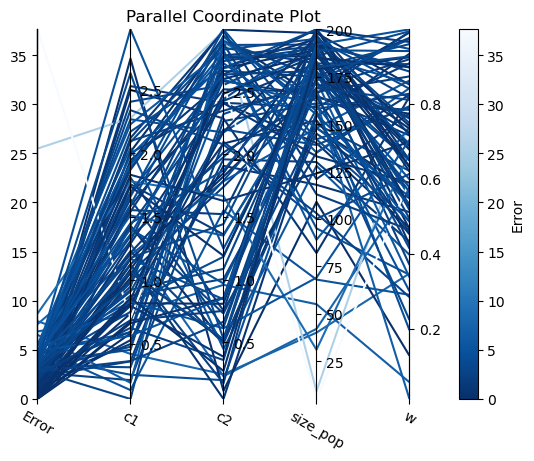

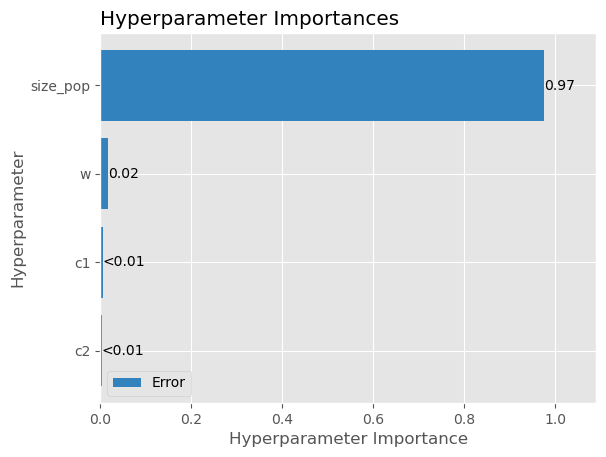

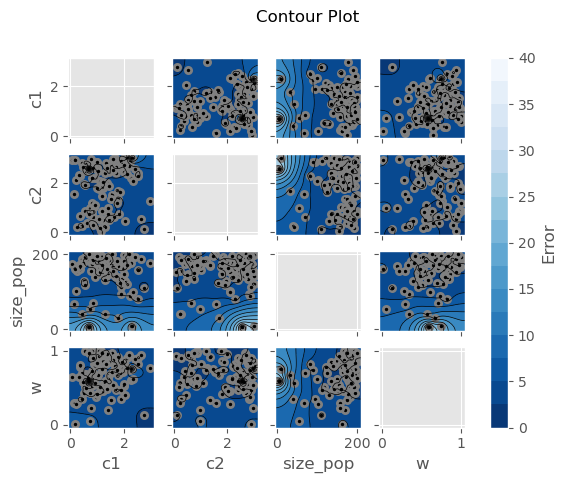

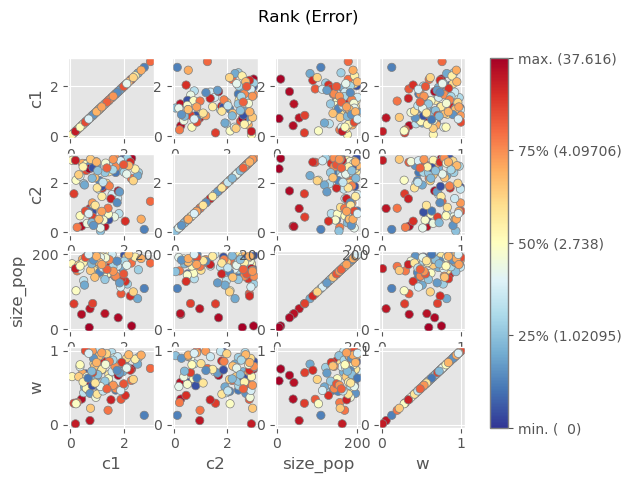

In [18]:
plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="Error")
plot_param_importances(study, target=lambda t: t.values[0], target_name="Error")
plot_contour(study, target=lambda t: t.values[0], target_name="Error")
plot_rank(study, target=lambda t: t.values[0], target_name="Error")

In [19]:
# Show the best trials.
for trial in study.best_trials:
    print("Params: ",trial.params, "- Results (error):",trial.values) 

Params:  {'size_pop': 198, 'w': 0.8506952290564493, 'c1': 2.0100284112874696, 'c2': 2.995235064233053} - Results (error): [0.0]
Params:  {'size_pop': 164, 'w': 0.7728516162455915, 'c1': 1.9153876197042996, 'c2': 2.934328951967846} - Results (error): [0.0]
Params:  {'size_pop': 169, 'w': 0.9898482466488235, 'c1': 1.124321414421067, 'c2': 1.823407010358861} - Results (error): [0.0]
Params:  {'size_pop': 148, 'w': 0.5725337620569391, 'c1': 1.4287685084284807, 'c2': 0.5005835050458376} - Results (error): [0.0]
Params:  {'size_pop': 186, 'w': 0.6864614485086141, 'c1': 0.581247961250722, 'c2': 2.769539841486925} - Results (error): [0.0]
Params:  {'size_pop': 189, 'w': 0.46568619838823017, 'c1': 0.6746491129906059, 'c2': 2.688498258503026} - Results (error): [0.0]
Params:  {'size_pop': 193, 'w': 0.740436250702114, 'c1': 1.1655815767635318, 'c2': 1.8497768051373613} - Results (error): [0.0]
Params:  {'size_pop': 187, 'w': 0.6332645696299151, 'c1': 0.8417084834210209, 'c2': 2.6010220665401} - R

Interestingly, the parameter analysis for solving the TSP, specifically optimizing parameters for `berlin52`, reveals that population size (size_pop) is overwhelmingly the most important parameter, with a weight of 0.97. This indicates that the size of the population has a significant impact on the performance of the optimization algorithm. A larger population size allows for more diverse exploration of the solution space, potentially leading to better solutions. On the other hand, the inertia weight (w), personal best coefficient (c1), and global best coefficient (c2) have negligible importance, with weights less than 0.01.

In this case, the results indicate that the optimization algorithm has found a set of solutions where all objectives (errors) are at their minimum possible values simultaneously, suggesting that no further improvement can be made for optimizing `berlin52`.

As before let's optimize now the parameters for the most complex file (`rat195`).

In [20]:
filename='rat195'
theCities,bestLength,bestTour=ReadTsp(TOURS_PATH+"/"+filename)
rounds=10

def objective(trial):
    params = {
        "size_pop": trial.suggest_int("size_pop", 5, 500),
        'max_iter': 1000,
        'w': trial.suggest_float("w", 0.00001, 1.0),
        'c1': trial.suggest_float("c1", 0.01, 3.0),
        'c2': trial.suggest_float("c2", 0.01, 3.0),
    }
    
    # Add a callback for pruning.
    _,error=MonteCarloPSOTour(rounds,theCities,bestLength,params)
    return error

reading tour rat195
reading done 2323.0


In [21]:
study2 = optuna.create_study(
    directions=["minimize"]
)
study2.optimize(objective, callbacks=[MaxTrialsCallback(100, states=(TrialState.COMPLETE,))])

[I 2024-03-15 09:32:48,700] A new study created in memory with name: no-name-ef445043-148e-4976-922a-21a65691b7e9
[I 2024-03-15 09:50:53,718] Trial 0 finished with value: 58.45888936719759 and parameters: {'size_pop': 341, 'w': 0.5060826226804623, 'c1': 0.907813801105008, 'c2': 0.4785080962527858}. Best is trial 0 with value: 58.45888936719759.


Minimum of objective function: 3697.3865307134038
Mean of objective function: 4237.794025558823
Variance of objective function: 190700.25843430424


[I 2024-03-15 10:06:35,853] Trial 1 finished with value: 70.34007748600948 and parameters: {'size_pop': 293, 'w': 0.2788833184841518, 'c1': 1.6267732709383305, 'c2': 1.4384658277233602}. Best is trial 0 with value: 58.45888936719759.


Minimum of objective function: 3970.0244870115644
Mean of objective function: 4267.919711679186
Variance of objective function: 78452.75142034996


[I 2024-03-15 10:22:34,779] Trial 2 finished with value: 72.79380111924236 and parameters: {'size_pop': 301, 'w': 0.6871545843714668, 'c1': 1.203430476288422, 'c2': 0.31750131597358267}. Best is trial 0 with value: 58.45888936719759.


Minimum of objective function: 4019.0466070285156
Mean of objective function: 4466.99187750376
Variance of objective function: 38656.7138926265


[I 2024-03-15 10:34:57,213] Trial 3 finished with value: 82.86698235040896 and parameters: {'size_pop': 232, 'w': 0.04484679148192421, 'c1': 0.9596941004779218, 'c2': 2.094924995680829}. Best is trial 0 with value: 58.45888936719759.


Minimum of objective function: 4257.830048385824
Mean of objective function: 4568.458290355523
Variance of objective function: 92822.74592011035


[I 2024-03-15 11:00:22,069] Trial 4 finished with value: 53.98191993112355 and parameters: {'size_pop': 480, 'w': 0.5989078458203764, 'c1': 0.5712845132636962, 'c2': 1.8499999903510866}. Best is trial 4 with value: 53.98191993112355.


Minimum of objective function: 3587.439568342097
Mean of objective function: 3908.56688721352
Variance of objective function: 47587.279210725275


[I 2024-03-15 11:26:32,367] Trial 5 finished with value: 50.3228583727938 and parameters: {'size_pop': 493, 'w': 0.3044453009743436, 'c1': 2.3902757695301524, 'c2': 1.0617224095786395}. Best is trial 5 with value: 50.3228583727938.


Minimum of objective function: 3500.290482575696
Mean of objective function: 3851.030129170455
Variance of objective function: 84505.55436154932


[I 2024-03-15 11:30:46,891] Trial 6 finished with value: 128.45458458889368 and parameters: {'size_pop': 80, 'w': 0.7907939424816592, 'c1': 0.932698490972114, 'c2': 2.3285184129758525}. Best is trial 5 with value: 50.3228583727938.


Minimum of objective function: 5314.419999644396
Mean of objective function: 6286.6214038592525
Variance of objective function: 279130.31921354576


[I 2024-03-15 11:54:27,329] Trial 7 finished with value: 55.61773568661214 and parameters: {'size_pop': 448, 'w': 0.5638558755869224, 'c1': 1.2760310521336624, 'c2': 1.145687180502785}. Best is trial 5 with value: 50.3228583727938.


Minimum of objective function: 3619.821036701706
Mean of objective function: 3859.024594801643
Variance of objective function: 31582.456892110793


[I 2024-03-15 12:04:56,563] Trial 8 finished with value: 96.51312957382694 and parameters: {'size_pop': 196, 'w': 0.797772074731711, 'c1': 2.0133917171243425, 'c2': 0.3902310785411092}. Best is trial 5 with value: 50.3228583727938.


Minimum of objective function: 4576.996902694832
Mean of objective function: 4986.519428868826
Variance of objective function: 128257.97682358029


[I 2024-03-15 12:14:28,027] Trial 9 finished with value: 98.40723202755058 and parameters: {'size_pop': 178, 'w': 0.3843613532691482, 'c1': 2.833599859092047, 'c2': 1.0584399705705825}. Best is trial 5 with value: 50.3228583727938.


Minimum of objective function: 4614.862646417557
Mean of objective function: 4928.332488631249
Variance of objective function: 81287.45919338493


[I 2024-03-15 12:35:31,970] Trial 10 finished with value: 52.38915195867413 and parameters: {'size_pop': 397, 'w': 0.16141205778225237, 'c1': 2.9554606307771807, 'c2': 2.9301639622394013}. Best is trial 5 with value: 50.3228583727938.


Minimum of objective function: 3545.082663801059
Mean of objective function: 3936.3225889886053
Variance of objective function: 42153.32817086203


[I 2024-03-15 12:56:46,284] Trial 11 finished with value: 60.43908738699957 and parameters: {'size_pop': 404, 'w': 0.14733998163003048, 'c1': 2.8298482889178818, 'c2': 2.8488410584585964}. Best is trial 5 with value: 50.3228583727938.


Minimum of objective function: 3734.163118788826
Mean of objective function: 3897.271436688461
Variance of objective function: 21067.21928598838


[I 2024-03-15 13:23:11,426] Trial 12 finished with value: 52.561343090830825 and parameters: {'size_pop': 500, 'w': 0.2720252027221283, 'c1': 2.298951565307079, 'c2': 2.8694972741727787}. Best is trial 5 with value: 50.3228583727938.


Minimum of objective function: 3551.3178382616115
Mean of objective function: 3927.0265420970354
Variance of objective function: 49300.36335919624


[I 2024-03-15 13:43:59,043] Trial 13 finished with value: 50.279810589754625 and parameters: {'size_pop': 391, 'w': 0.9735704800942215, 'c1': 2.4296783061875225, 'c2': 0.8910060419538823}. Best is trial 13 with value: 50.279810589754625.


Minimum of objective function: 3499.1736777741626
Mean of objective function: 4067.118888113805
Variance of objective function: 89012.51974808089


[I 2024-03-15 14:04:51,802] Trial 14 finished with value: 59.53508394317693 and parameters: {'size_pop': 392, 'w': 0.9787170337733565, 'c1': 2.340271791898086, 'c2': 0.8424290183058276}. Best is trial 13 with value: 50.279810589754625.


Minimum of objective function: 3712.9342638982075
Mean of objective function: 4128.044372766824
Variance of objective function: 57001.49266386023


[I 2024-03-15 14:28:14,464] Trial 15 finished with value: 51.31295738269479 and parameters: {'size_pop': 443, 'w': 0.993080767205284, 'c1': 0.09129688328286178, 'c2': 0.7910745533751145}. Best is trial 13 with value: 50.279810589754625.


Minimum of objective function: 3519.4231086568957
Mean of objective function: 3799.2019360323693
Variance of objective function: 39414.40908135492


[I 2024-03-15 14:46:37,893] Trial 16 finished with value: 67.84330606973741 and parameters: {'size_pop': 349, 'w': 0.3230021085023431, 'c1': 2.0073201361511854, 'c2': 0.05784425747659161}. Best is trial 13 with value: 50.279810589754625.


Minimum of objective function: 3905.342195762171
Mean of objective function: 4114.950415006546
Variance of objective function: 18457.805277358297


[I 2024-03-15 14:51:21,479] Trial 17 finished with value: 130.3486870426173 and parameters: {'size_pop': 89, 'w': 0.4152814606891254, 'c1': 2.400196829636518, 'c2': 1.5016550804843323}. Best is trial 13 with value: 50.279810589754625.


Minimum of objective function: 5357.31299614227
Mean of objective function: 6223.074144244403
Variance of objective function: 413536.9752936746


[I 2024-03-15 14:52:36,650] Trial 18 finished with value: 212.05337925096856 and parameters: {'size_pop': 23, 'w': 0.7591024547491543, 'c1': 1.7218087537423497, 'c2': 1.2403206232817336}. Best is trial 13 with value: 50.279810589754625.


Minimum of objective function: 7257.05969204819
Mean of objective function: 7916.057425732346
Variance of objective function: 117820.06160249717


[I 2024-03-15 15:16:12,398] Trial 19 finished with value: 55.273353422298754 and parameters: {'size_pop': 447, 'w': 0.8894188187203177, 'c1': 2.5696593536947336, 'c2': 1.7849790192733344}. Best is trial 13 with value: 50.279810589754625.


Minimum of objective function: 3616.33221354481
Mean of objective function: 3914.8854355368676
Variance of objective function: 77267.51402381243


[I 2024-03-15 15:33:21,042] Trial 20 finished with value: 73.74085234610418 and parameters: {'size_pop': 325, 'w': 0.44944649323212366, 'c1': 1.9214155857505295, 'c2': 0.72024460074155}. Best is trial 13 with value: 50.279810589754625.


Minimum of objective function: 4046.201337917615
Mean of objective function: 4310.308991046167
Variance of objective function: 73824.2367082052


[I 2024-03-15 15:57:01,480] Trial 21 finished with value: 51.18381403357727 and parameters: {'size_pop': 448, 'w': 0.97310617069997, 'c1': 0.07060779839815967, 'c2': 0.7350510214022475}. Best is trial 13 with value: 50.279810589754625.


Minimum of objective function: 3525.3803193760577
Mean of objective function: 3919.887659501967
Variance of objective function: 47213.53173387626


[I 2024-03-15 16:23:32,732] Trial 22 finished with value: 45.24321997417133 and parameters: {'size_pop': 497, 'w': 0.9050040626001394, 'c1': 0.043419757980093135, 'c2': 0.9828176735458065}. Best is trial 22 with value: 45.24321997417133.


Minimum of objective function: 3383.8213461568457
Mean of objective function: 3696.459782485683
Variance of objective function: 36970.32433613453


[I 2024-03-15 16:50:15,729] Trial 23 finished with value: 56.52173913043478 and parameters: {'size_pop': 499, 'w': 0.8745621142102525, 'c1': 0.3773136456444218, 'c2': 1.0071701220863567}. Best is trial 22 with value: 45.24321997417133.


Minimum of objective function: 3640.1436487558713
Mean of objective function: 3858.8367548472947
Variance of objective function: 69940.84852275268


[I 2024-03-15 17:10:17,858] Trial 24 finished with value: 61.64442531209643 and parameters: {'size_pop': 377, 'w': 0.671279015718515, 'c1': 2.5883397130013477, 'c2': 1.3633556445686579}. Best is trial 22 with value: 45.24321997417133.


Minimum of objective function: 3761.4046114677994
Mean of objective function: 4082.133777968498
Variance of objective function: 66678.11730428875


[I 2024-03-15 17:32:36,965] Trial 25 finished with value: 53.120964270340075 and parameters: {'size_pop': 423, 'w': 0.8568912467232668, 'c1': 2.126947399664283, 'c2': 0.5323505044510315}. Best is trial 22 with value: 45.24321997417133.


Minimum of objective function: 3568.956707756966
Mean of objective function: 3965.855429909363
Variance of objective function: 63121.02075827477


[I 2024-03-15 17:57:55,283] Trial 26 finished with value: 56.17735686612139 and parameters: {'size_pop': 479, 'w': 0.17202266880350445, 'c1': 1.4717940723352454, 'c2': 1.7265212680963913}. Best is trial 22 with value: 45.24321997417133.


Minimum of objective function: 3634.557578819367
Mean of objective function: 3879.049345972059
Variance of objective function: 21741.62559875775


[I 2024-03-15 18:17:36,559] Trial 27 finished with value: 61.64442531209643 and parameters: {'size_pop': 374, 'w': 0.906062309019275, 'c1': 2.603127646959009, 'c2': 0.9389782135339269}. Best is trial 22 with value: 45.24321997417133.


Minimum of objective function: 3769.071708871278
Mean of objective function: 4141.018502507406
Variance of objective function: 243866.08802417904


[I 2024-03-15 18:31:52,274] Trial 28 finished with value: 82.09212225570383 and parameters: {'size_pop': 272, 'w': 0.6963270495206018, 'c1': 0.616764303578701, 'c2': 0.02331673653806332}. Best is trial 22 with value: 45.24321997417133.


Minimum of objective function: 4237.584006616125
Mean of objective function: 4545.82006521871
Variance of objective function: 45655.82112555625


[I 2024-03-15 18:56:53,290] Trial 29 finished with value: 54.97201894102454 and parameters: {'size_pop': 472, 'w': 0.5030741223798678, 'c1': 1.7975456210080447, 'c2': 0.5602575637213194}. Best is trial 22 with value: 45.24321997417133.


Minimum of objective function: 3606.5764948223077
Mean of objective function: 3804.481144147946
Variance of objective function: 13812.003130247385


[I 2024-03-15 19:14:06,434] Trial 30 finished with value: 71.54541541110633 and parameters: {'size_pop': 329, 'w': 0.6013228822957856, 'c1': 1.4303355480279363, 'c2': 1.2223887683736088}. Best is trial 22 with value: 45.24321997417133.


Minimum of objective function: 3992.855553991237
Mean of objective function: 4159.998873069028
Variance of objective function: 8687.328426750717


[I 2024-03-15 19:36:56,129] Trial 31 finished with value: 64.18424451140766 and parameters: {'size_pop': 433, 'w': 0.9457260100719428, 'c1': 0.09433849447011909, 'c2': 0.6896634708988839}. Best is trial 22 with value: 45.24321997417133.


Minimum of objective function: 3822.9350254955248
Mean of objective function: 3991.2928216284113
Variance of objective function: 11950.631203918954


[I 2024-03-15 20:01:32,540] Trial 32 finished with value: 57.29659922513991 and parameters: {'size_pop': 462, 'w': 0.9372755227884554, 'c1': 0.4201177493411263, 'c2': 0.31264127370135064}. Best is trial 22 with value: 45.24321997417133.


Minimum of objective function: 3655.3736177940013
Mean of objective function: 4034.8042255614578
Variance of objective function: 74032.04221056998


[I 2024-03-15 20:23:31,452] Trial 33 finished with value: 53.42229875161429 and parameters: {'size_pop': 420, 'w': 0.9880019716873332, 'c1': 0.2910939812800342, 'c2': 0.9122066912361346}. Best is trial 22 with value: 45.24321997417133.


Minimum of objective function: 3568.4835851467597
Mean of objective function: 3914.063759428654
Variance of objective function: 74168.70753646412


[I 2024-03-15 20:42:35,134] Trial 34 finished with value: 64.27034007748601 and parameters: {'size_pop': 365, 'w': 0.8307121922168442, 'c1': 0.7084321175713493, 'c2': 1.321059859056456}. Best is trial 22 with value: 45.24321997417133.


Minimum of objective function: 3824.843366456859
Mean of objective function: 4207.8165734933145
Variance of objective function: 85173.69524674748


[I 2024-03-15 21:08:03,478] Trial 35 finished with value: 58.9324149806285 and parameters: {'size_pop': 482, 'w': 0.728364222542599, 'c1': 0.013644057498268608, 'c2': 0.6412597756677364}. Best is trial 22 with value: 45.24321997417133.


Minimum of objective function: 3695.5362386345273
Mean of objective function: 3862.0422979731875
Variance of objective function: 22546.04955320826


[I 2024-03-15 21:30:00,976] Trial 36 finished with value: 62.07490314248816 and parameters: {'size_pop': 414, 'w': 0.24461522968405963, 'c1': 1.0946602879626643, 'c2': 0.26881233419193973}. Best is trial 22 with value: 45.24321997417133.


Minimum of objective function: 3775.686597957388
Mean of objective function: 4014.2369960251394
Variance of objective function: 14183.84211288967


[I 2024-03-15 21:54:07,559] Trial 37 finished with value: 59.31984502798106 and parameters: {'size_pop': 458, 'w': 0.02416647155504481, 'c1': 0.30675958158271555, 'c2': 1.6753955504358014}. Best is trial 22 with value: 45.24321997417133.


Minimum of objective function: 3705.554693599694
Mean of objective function: 4126.999106783979
Variance of objective function: 49741.354350899885


[I 2024-03-15 22:06:38,984] Trial 38 finished with value: 78.26086956521739 and parameters: {'size_pop': 239, 'w': 0.8150350388596064, 'c1': 0.19993741125943365, 'c2': 1.1155012794850063}. Best is trial 22 with value: 45.24321997417133.


Minimum of objective function: 4140.657928221776
Mean of objective function: 4452.503379266685
Variance of objective function: 45860.26422616042


[I 2024-03-15 22:32:57,627] Trial 39 finished with value: 40.89539388721481 and parameters: {'size_pop': 499, 'w': 0.6408240838630879, 'c1': 0.8233999615314476, 'c2': 1.5571847381290729}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3281.783693755194
Mean of objective function: 3653.3218832335892
Variance of objective function: 35599.14630434422


[I 2024-03-15 22:59:11,157] Trial 40 finished with value: 48.55789926818769 and parameters: {'size_pop': 498, 'w': 0.5553124728918218, 'c1': 0.7737312854213115, 'c2': 1.993235862286209}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3453.644684927852
Mean of objective function: 3964.7111474493895
Variance of objective function: 167201.1721654538


[I 2024-03-15 23:24:49,489] Trial 41 finished with value: 49.54799827808868 and parameters: {'size_pop': 486, 'w': 0.5700119657127296, 'c1': 0.7554021017611477, 'c2': 2.158569296516643}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3480.0624269146288
Mean of objective function: 3702.0660966718233
Variance of objective function: 42616.25099453571


[I 2024-03-15 23:51:09,969] Trial 42 finished with value: 50.021523891519585 and parameters: {'size_pop': 500, 'w': 0.5679844357582855, 'c1': 0.8042503191721214, 'c2': 2.1757381217958476}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3495.8169990984557
Mean of objective function: 3764.6192733881085
Variance of objective function: 23249.312660467538


[I 2024-03-16 00:17:23,334] Trial 43 finished with value: 43.52130865260439 and parameters: {'size_pop': 500, 'w': 0.5598394518217232, 'c1': 0.793126997318956, 'c2': 2.146976982239174}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3342.1694484258524
Mean of objective function: 3644.7636640436576
Variance of objective function: 19389.245423236403


[I 2024-03-16 00:42:34,566] Trial 44 finished with value: 58.37279380111924 and parameters: {'size_pop': 477, 'w': 0.6264096636105112, 'c1': 1.0183404799022642, 'c2': 2.399046499867984}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3688.086873306257
Mean of objective function: 3815.1359255970406
Variance of objective function: 12708.213908211364


[I 2024-03-16 01:07:16,029] Trial 45 finished with value: 52.948773138183384 and parameters: {'size_pop': 470, 'w': 0.458702077996593, 'c1': 1.239344420972191, 'c2': 2.004174557473417}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3562.2307241835174
Mean of objective function: 3800.498646879975
Variance of objective function: 17952.459196700736


[I 2024-03-16 01:15:35,460] Trial 46 finished with value: 102.66896254842875 and parameters: {'size_pop': 159, 'w': 0.5221731531497527, 'c1': 0.5281079503759132, 'c2': 2.619616769988208}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 4710.711191960221
Mean of objective function: 5085.256009709859
Variance of objective function: 104331.45591811255


[I 2024-03-16 01:41:49,207] Trial 47 finished with value: 46.96513129573827 and parameters: {'size_pop': 500, 'w': 0.6494837456384447, 'c1': 0.7404145476934307, 'c2': 1.9517942371327759}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3417.9755395053726
Mean of objective function: 3747.1321441597393
Variance of objective function: 56582.08072189465


[I 2024-03-16 02:04:36,763] Trial 48 finished with value: 55.316401205337925 and parameters: {'size_pop': 435, 'w': 0.657761343940315, 'c1': 0.8666301702349822, 'c2': 1.935297037275445}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3612.3511436879535
Mean of objective function: 3988.6956936425986
Variance of objective function: 39252.69456900057


[I 2024-03-16 02:28:37,744] Trial 49 finished with value: 56.09126130004305 and parameters: {'size_pop': 457, 'w': 0.5387827702000159, 'c1': 1.114151499009742, 'c2': 1.613749651294227}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3633.9439807291583
Mean of objective function: 3893.718229290799
Variance of objective function: 45104.26291031305


[I 2024-03-16 02:54:49,737] Trial 50 finished with value: 44.683598794662075 and parameters: {'size_pop': 500, 'w': 0.35644331529415607, 'c1': 1.356904029216334, 'c2': 2.3887316938782095}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3372.1924665461574
Mean of objective function: 3828.597604296758
Variance of objective function: 57830.486133669016


[I 2024-03-16 03:20:52,472] Trial 51 finished with value: 52.991820921222555 and parameters: {'size_pop': 496, 'w': 0.4658397293892174, 'c1': 0.9371467377748849, 'c2': 2.506341193930987}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3559.9910882958725
Mean of objective function: 3873.211079880596
Variance of objective function: 65988.94857404736


[I 2024-03-16 03:45:09,152] Trial 52 finished with value: 58.544984933275934 and parameters: {'size_pop': 464, 'w': 0.6339925392251922, 'c1': 0.6758058664316182, 'c2': 2.339367920401493}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3690.800934796328
Mean of objective function: 3937.35077714788
Variance of objective function: 23381.16945201098


[I 2024-03-16 04:08:06,608] Trial 53 finished with value: 60.352991820921225 and parameters: {'size_pop': 438, 'w': 0.3635686111124347, 'c1': 0.48379274472201506, 'c2': 2.0348764513310535}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3733.19170228928
Mean of objective function: 3990.3112271022255
Variance of objective function: 37144.48483596903


[I 2024-03-16 04:29:20,318] Trial 54 finished with value: 59.79337064141197 and parameters: {'size_pop': 405, 'w': 0.7397339514227852, 'c1': 1.6088628434406826, 'c2': 1.9147522759405369}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3716.167236538096
Mean of objective function: 3932.66674808732
Variance of objective function: 9967.6183207695


[I 2024-03-16 04:54:35,308] Trial 55 finished with value: 51.87257856220405 and parameters: {'size_pop': 482, 'w': 0.3809279366703331, 'c1': 1.3651955453886124, 'c2': 2.7299459741146777}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3531.2355515594095
Mean of objective function: 3757.673180671235
Variance of objective function: 32057.711271948046


[I 2024-03-16 05:20:36,046] Trial 56 finished with value: 51.7864829961257 and parameters: {'size_pop': 497, 'w': 0.7060431892589609, 'c1': 1.1400445451433232, 'c2': 1.563189291217447}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3537.44626628122
Mean of objective function: 3769.8979812333832
Variance of objective function: 15191.200004216555


[I 2024-03-16 05:44:37,010] Trial 57 finished with value: 50.495049504950494 and parameters: {'size_pop': 459, 'w': 0.7649923318722665, 'c1': 0.6023965705907318, 'c2': 2.2210258547813355}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3508.2796261758413
Mean of objective function: 3891.4320962947595
Variance of objective function: 56450.87986845236


[I 2024-03-16 05:55:19,347] Trial 58 finished with value: 85.19156263452432 and parameters: {'size_pop': 204, 'w': 0.6021314243972247, 'c1': 1.314283699767205, 'c2': 2.2622541493362505}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 4305.150661143682
Mean of objective function: 4818.297008078211
Variance of objective function: 166683.07750501245


[I 2024-03-16 06:02:27,670] Trial 59 finished with value: 104.60611278519156 and parameters: {'size_pop': 136, 'w': 0.43520631788643566, 'c1': 0.991610964769364, 'c2': 1.83114749102761}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 4761.455615977974
Mean of objective function: 5394.344295776249
Variance of objective function: 143664.47208038662


[I 2024-03-16 06:24:43,636] Trial 60 finished with value: 51.65733964700818 and parameters: {'size_pop': 425, 'w': 0.34222460012742667, 'c1': 1.5620056488191045, 'c2': 2.47378018732197}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3535.7520432135916
Mean of objective function: 3951.191366283626
Variance of objective function: 72740.31659348687


[I 2024-03-16 06:50:16,645] Trial 61 finished with value: 52.948773138183384 and parameters: {'size_pop': 486, 'w': 0.5599612491835885, 'c1': 0.7228291885281228, 'c2': 2.0478449591933074}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3565.7329732789076
Mean of objective function: 3910.88743620015
Variance of objective function: 60209.32654055978


[I 2024-03-16 07:15:29,655] Trial 62 finished with value: 54.670684459750326 and parameters: {'size_pop': 481, 'w': 0.5734318138646606, 'c1': 0.8338857449133587, 'c2': 2.1344276228379173}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3598.0737940461554
Mean of objective function: 3883.5412233390425
Variance of objective function: 38011.23743204355


[I 2024-03-16 07:38:56,211] Trial 63 finished with value: 54.06801549720189 and parameters: {'size_pop': 448, 'w': 0.6481286701744028, 'c1': 0.7204057778260832, 'c2': 1.4377073653835784}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3585.559217712993
Mean of objective function: 4006.819108753708
Variance of objective function: 99699.83241292532


[I 2024-03-16 08:05:03,439] Trial 64 finished with value: 47.567800258286695 and parameters: {'size_pop': 499, 'w': 0.40479002299710876, 'c1': 0.803837159503299, 'c2': 1.933783459027449}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3441.423538865884
Mean of objective function: 3688.9989521451876
Variance of objective function: 63767.30906665758


[I 2024-03-16 08:31:10,398] Trial 65 finished with value: 46.66379681446406 and parameters: {'size_pop': 499, 'w': 0.4847788170158118, 'c1': 0.9893959486597343, 'c2': 1.905940146062693}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3412.7175554460637
Mean of objective function: 3710.281730683518
Variance of objective function: 27857.23772206721


[I 2024-03-16 08:55:53,695] Trial 66 finished with value: 54.88592337494619 and parameters: {'size_pop': 472, 'w': 0.2734816498171435, 'c1': 0.8908204874211071, 'c2': 1.7445213287631416}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3606.06669396773
Mean of objective function: 3805.0537231659664
Variance of objective function: 27873.987895317812


[I 2024-03-16 09:19:10,646] Trial 67 finished with value: 57.25355144210073 and parameters: {'size_pop': 442, 'w': 0.49116594050182233, 'c1': 1.0415133302845396, 'c2': 1.8603661819162647}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3662.774545828062
Mean of objective function: 3927.2297758315194
Variance of objective function: 74259.26449428563


[I 2024-03-16 09:35:02,571] Trial 68 finished with value: 72.32027550581145 and parameters: {'size_pop': 302, 'w': 0.41708268434953677, 'c1': 1.1922800536510145, 'c2': 1.4702172045414619}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 4011.490277064251
Mean of objective function: 4420.0370940877465
Variance of objective function: 61865.15692636485


[I 2024-03-16 09:59:23,104] Trial 69 finished with value: 49.28971157985364 and parameters: {'size_pop': 465, 'w': 0.22759651104737344, 'c1': 0.589463563491656, 'c2': 2.295900644993687}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3478.8319824624627
Mean of objective function: 3843.5792155952563
Variance of objective function: 34614.47109328811


[I 2024-03-16 10:25:34,748] Trial 70 finished with value: 54.19715884631942 and parameters: {'size_pop': 500, 'w': 0.3149043330031251, 'c1': 0.4472377536359995, 'c2': 1.581669332050137}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3590.063213874606
Mean of objective function: 3880.237651863548
Variance of objective function: 54594.38789737118


[I 2024-03-16 10:50:49,150] Trial 71 finished with value: 52.819629789065864 and parameters: {'size_pop': 482, 'w': 0.47947157971761345, 'c1': 0.9092786318573929, 'c2': 2.0956871399063184}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3561.726649453636
Mean of objective function: 3920.785321645659
Variance of objective function: 76056.05686106524


[I 2024-03-16 11:14:31,913] Trial 72 finished with value: 55.445544554455445 and parameters: {'size_pop': 453, 'w': 0.4045403718225193, 'c1': 1.70504974493322, 'c2': 1.9761422300253322}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3616.364828251776
Mean of objective function: 3883.3493951091295
Variance of objective function: 21756.882571561728


[I 2024-03-16 11:40:49,292] Trial 73 finished with value: 51.61429186396901 and parameters: {'size_pop': 499, 'w': 0.5327815573634115, 'c1': 0.8233130247262527, 'c2': 1.867988575790158}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3533.4143288239843
Mean of objective function: 3780.392107775778
Variance of objective function: 27937.050016601046


[I 2024-03-16 12:05:30,114] Trial 74 finished with value: 52.13086526043909 and parameters: {'size_pop': 471, 'w': 0.3490783955124665, 'c1': 0.6424303001160014, 'c2': 1.715535932197508}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3545.1141927303056
Mean of objective function: 3789.7976100466863
Variance of objective function: 19968.62208217631


[I 2024-03-16 12:31:01,112] Trial 75 finished with value: 53.37925096857512 and parameters: {'size_pop': 488, 'w': 0.4955111989508417, 'c1': 0.20606135686062715, 'c2': 2.373877697440406}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3573.209589978837
Mean of objective function: 3791.31486312564
Variance of objective function: 11525.460082738457


[I 2024-03-16 12:33:18,423] Trial 76 finished with value: 184.80413258717175 and parameters: {'size_pop': 43, 'w': 0.612278085331586, 'c1': 0.33983973500654124, 'c2': 1.807066235331782}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 6626.574697246852
Mean of objective function: 7265.36637763258
Variance of objective function: 80497.03250834982


[I 2024-03-16 12:57:53,850] Trial 77 finished with value: 51.35600516573396 and parameters: {'size_pop': 469, 'w': 0.6750493904014726, 'c1': 0.5259593237262885, 'c2': 2.544595528862196}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3526.167251600778
Mean of objective function: 3932.947792603529
Variance of objective function: 52971.895356799476


[I 2024-03-16 13:23:15,405] Trial 78 finished with value: 48.42875591907017 and parameters: {'size_pop': 488, 'w': 0.4330829819566865, 'c1': 0.9969648187086085, 'c2': 1.6537097886604168}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3458.170707151034
Mean of objective function: 3830.5899715110936
Variance of objective function: 53575.267728975195


[I 2024-03-16 13:44:48,887] Trial 79 finished with value: 58.71717606543263 and parameters: {'size_pop': 416, 'w': 0.093908586158233, 'c1': 1.3825497439909642, 'c2': 1.355976942026966}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3692.966992646373
Mean of objective function: 4007.4526067722572
Variance of objective function: 55683.413215239474


[I 2024-03-16 14:07:05,680] Trial 80 finished with value: 48.51485148514851 and parameters: {'size_pop': 430, 'w': 0.4244317048469711, 'c1': 1.1864552927921914, 'c2': 1.6567827802509356}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3465.5432053916215
Mean of objective function: 3812.357550313112
Variance of objective function: 54176.886449016674


[I 2024-03-16 14:32:17,120] Trial 81 finished with value: 51.09771846749892 and parameters: {'size_pop': 486, 'w': 0.442845764843671, 'c1': 1.171327162904329, 'c2': 1.6545861009451748}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3519.752406928738
Mean of objective function: 3767.7787046946155
Variance of objective function: 35430.56768674806


[I 2024-03-16 14:55:36,679] Trial 82 finished with value: 50.9685751183814 and parameters: {'size_pop': 450, 'w': 0.4020300981359668, 'c1': 1.0461931420831774, 'c2': 1.5638920817071589}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3512.7592569334274
Mean of objective function: 3876.781417517797
Variance of objective function: 59819.58421577669


[I 2024-03-16 15:17:57,400] Trial 83 finished with value: 59.27679724494188 and parameters: {'size_pop': 431, 'w': 0.5147939499652878, 'c1': 1.2988805755629556, 'c2': 1.9239943434666593}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3701.266847102059
Mean of objective function: 4067.949992990632
Variance of objective function: 70673.28390790868


[I 2024-03-16 15:42:31,083] Trial 84 finished with value: 56.86612139474817 and parameters: {'size_pop': 474, 'w': 0.37601543308302265, 'c1': 0.9752507079869014, 'c2': 1.2066277667390775}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3655.151787603797
Mean of objective function: 3959.811408639667
Variance of objective function: 54445.4656997027


[I 2024-03-16 16:07:46,111] Trial 85 finished with value: 52.475247524752476 and parameters: {'size_pop': 487, 'w': 0.4184614112651298, 'c1': 1.052068874731657, 'c2': 1.779194315181138}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3551.4353781556647
Mean of objective function: 3876.2011365080457
Variance of objective function: 47005.26189253236


[I 2024-03-16 16:31:42,357] Trial 86 finished with value: 53.42229875161429 and parameters: {'size_pop': 461, 'w': 0.30417592932782134, 'c1': 1.240129216710307, 'c2': 1.688791856532924}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3576.000733387335
Mean of objective function: 3920.3254400308083
Variance of objective function: 84666.55961153009


[I 2024-03-16 16:52:01,179] Trial 87 finished with value: 56.95221696082652 and parameters: {'size_pop': 391, 'w': 0.46525308439847574, 'c1': 1.5356698359840508, 'c2': 2.074550194440024}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3659.4128381840637
Mean of objective function: 4150.354878360084
Variance of objective function: 74408.61908888651


[I 2024-03-16 17:13:08,805] Trial 88 finished with value: 53.33620318553594 and parameters: {'size_pop': 404, 'w': 0.33021685454135774, 'c1': 1.4497915095115608, 'c2': 1.4612903609508514}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3564.846821740626
Mean of objective function: 3853.7051335699093
Variance of objective function: 26454.505561291862


[I 2024-03-16 17:38:45,415] Trial 89 finished with value: 53.33620318553594 and parameters: {'size_pop': 491, 'w': 0.44620482020297514, 'c1': 0.9291707893352293, 'c2': 2.2212740295149045}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3568.170851026011
Mean of objective function: 3826.503342723762
Variance of objective function: 64899.55707106086


[I 2024-03-16 18:01:48,858] Trial 90 finished with value: 55.187257856220405 and parameters: {'size_pop': 440, 'w': 0.2947560728291243, 'c1': 1.1317582202205831, 'c2': 1.2834703344969824}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3612.0518067581565
Mean of objective function: 3897.329388674262
Variance of objective function: 59765.77600432133


[I 2024-03-16 18:27:52,783] Trial 91 finished with value: 46.49160568230736 and parameters: {'size_pop': 500, 'w': 0.5441854372261987, 'c1': 0.7716916445252949, 'c2': 1.9507566004869221}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3415.618387278011
Mean of objective function: 3705.0158662591653
Variance of objective function: 39155.53240068447


[I 2024-03-16 18:52:37,675] Trial 92 finished with value: 51.82953077916487 and parameters: {'size_pop': 475, 'w': 0.53892290865019, 'c1': 0.8080054059191131, 'c2': 1.923988788255989}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3530.6283936030254
Mean of objective function: 3815.5608507682505
Variance of objective function: 30342.847614140133


[I 2024-03-16 19:18:41,555] Trial 93 finished with value: 52.819629789065864 and parameters: {'size_pop': 500, 'w': 0.5790296297322381, 'c1': 0.8694350211860598, 'c2': 1.6467300684424377}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3552.1682922987848
Mean of objective function: 3786.3017763255934
Variance of objective function: 23991.152559862767


[I 2024-03-16 19:42:32,430] Trial 94 finished with value: 61.64442531209643 and parameters: {'size_pop': 456, 'w': 0.3901468615032403, 'c1': 0.9671412542892123, 'c2': 1.4093928116659906}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3766.4965662082823
Mean of objective function: 3927.4030670166203
Variance of objective function: 22590.574107947363


[I 2024-03-16 20:08:14,701] Trial 95 finished with value: 44.25312096427034 and parameters: {'size_pop': 490, 'w': 0.4827856574587388, 'c1': 0.682362421583089, 'c2': 1.7886529607651962}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3359.3334450994166
Mean of objective function: 3788.2083751598557
Variance of objective function: 53708.05444439099


[I 2024-03-16 20:33:54,901] Trial 96 finished with value: 45.37236332328885 and parameters: {'size_pop': 489, 'w': 0.5113021069730244, 'c1': 0.5373266316764447, 'c2': 2.136553375568803}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3382.233183436185
Mean of objective function: 3716.3560226256513
Variance of objective function: 28292.859949897294


[I 2024-03-16 20:58:27,529] Trial 97 finished with value: 54.49849332759363 and parameters: {'size_pop': 469, 'w': 0.5113095035574413, 'c1': 0.6535533403765246, 'c2': 2.1382323955725604}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3593.8249968672885
Mean of objective function: 3782.0380685343835
Variance of objective function: 34478.48461114384


[I 2024-03-16 21:24:12,895] Trial 98 finished with value: 54.670684459750326 and parameters: {'size_pop': 490, 'w': 0.48010328700391164, 'c1': 0.3915814608273788, 'c2': 1.9780959575062462}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3602.332670865541
Mean of objective function: 3824.6323784183755
Variance of objective function: 20455.93702230241


[I 2024-03-16 21:49:11,659] Trial 99 finished with value: 46.53465346534654 and parameters: {'size_pop': 477, 'w': 0.597932242771594, 'c1': 0.23227438962825475, 'c2': 2.2073790932876283}. Best is trial 39 with value: 40.89539388721481.


Minimum of objective function: 3401.8672276390366
Mean of objective function: 3889.464213274353
Variance of objective function: 96774.20933084095


/tmp/ipykernel_90211/4024480383.py:1: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study2, target=lambda t: t.values[0], target_name="Error")
/tmp/ipykernel_90211/4024480383.py:2: ExperimentalWarning: plot_param_importances is experimental (supported from v2.2.0). The interface can change in the future.
  plot_param_importances(study2, target=lambda t: t.values[0], target_name="Error")
/tmp/ipykernel_90211/4024480383.py:3: ExperimentalWarning: plot_contour is experimental (supported from v2.2.0). The interface can change in the future.
  plot_contour(study2, target=lambda t: t.values[0], target_name="Error")
[W 2024-03-16 21:49:12,749] Output figures of this Matplotlib-based `plot_contour` function would be different from those of the Plotly-based `plot_contour`.
/tmp/ipykernel_90211/4024480383.py:4: ExperimentalWarning: plot_rank is experimental (supported from v3.2.0). The int

array([[<Axes: ylabel='c1'>, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: ylabel='c2'>, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: ylabel='size_pop'>, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: xlabel='c1', ylabel='w'>, <Axes: xlabel='c2'>,
        <Axes: xlabel='size_pop'>, <Axes: xlabel='w'>]], dtype=object)

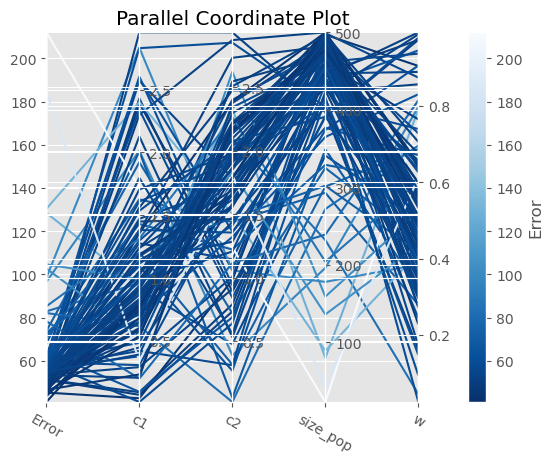

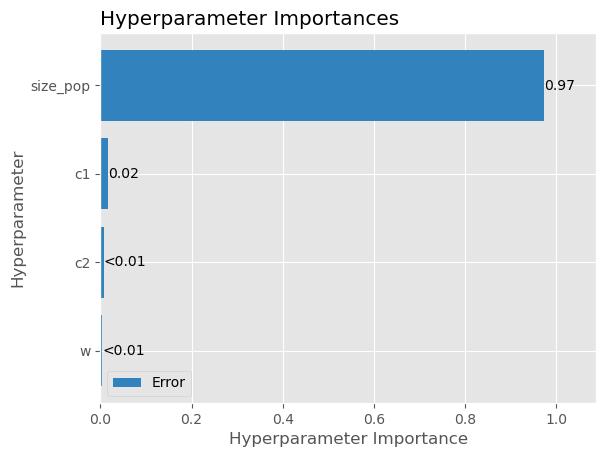

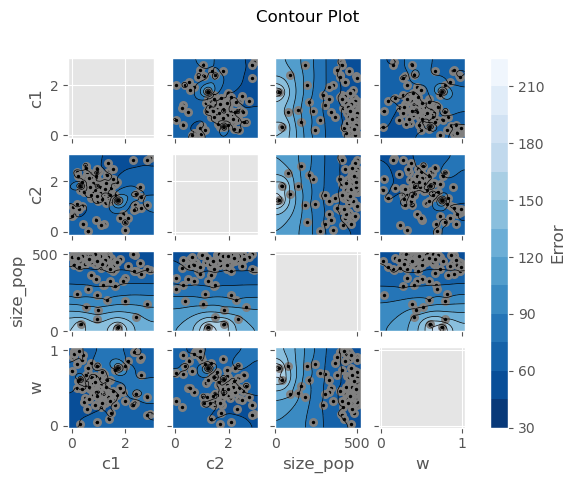

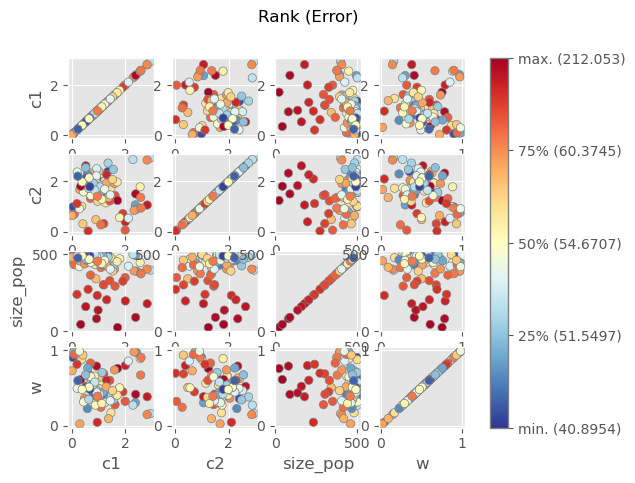

In [22]:
plot_parallel_coordinate(study2, target=lambda t: t.values[0], target_name="Error")
plot_param_importances(study2, target=lambda t: t.values[0], target_name="Error")
plot_contour(study2, target=lambda t: t.values[0], target_name="Error")
plot_rank(study2, target=lambda t: t.values[0], target_name="Error")

In [23]:
# Show the best trials.
for trial in study2.best_trials:
    print("Params: ",trial.params, "- Results (error):",trial.values) 

Params:  {'size_pop': 499, 'w': 0.6408240838630879, 'c1': 0.8233999615314476, 'c2': 1.5571847381290729} - Results (error): [40.89539388721481]


Again, the parameter analysis for solving the TSP, specifically optimizing parameters for `berlin52`, reveals that population size (`size_pop`) is overwhelmingly the most important parameter. In addition, we can see that the best solutions approximate to the top bound of population (500) suggesting that a higher value for this parameter is required in order to improve the optimization process.

In this case, the provided result for the `rat195` TSP instance, produces a tour with an error of 40.90%, still too high as the algorithm is outperformed by the rest of heuristics (which have error values of 11.1063%, 13.9905% and 21.2656%). Further analysis or experimentation may be necessary to explore opportunities for improvement. At least the error value is lower with respect to the grid search experiments.

**EXPERIMENT**: Let's try to change the `size_pop` bounds to test higher values for this parameter and see what happens (we will do only 3 experiments since a execution with such a high population size takes too long).

In [12]:
filename='rat195'
theCities,bestLength,bestTour=ReadTsp(TOURS_PATH+"/"+filename)
rounds=10

def objective(trial):
    params = {
        "size_pop": trial.suggest_int("size_pop", 500, 1000),
        'max_iter': 1000,
        'w': trial.suggest_float("w", 0.00001, 1.0),
        'c1': trial.suggest_float("c1", 0.01, 3.0),
        'c2': trial.suggest_float("c2", 0.01, 3.0),
    }
    
    # Add a callback for pruning.
    _,error=MonteCarloPSOTour(rounds,theCities,bestLength,params)
    return error

reading tour rat195
reading done 2323.0


In [13]:
study3 = optuna.create_study(
    directions=["minimize"]
)
study3.optimize(objective, callbacks=[MaxTrialsCallback(3, states=(TrialState.COMPLETE,))])

[I 2024-03-17 10:18:07,220] A new study created in memory with name: no-name-233059d6-8217-433d-a28e-ae79040afdfc
[I 2024-03-17 20:45:01,407] Trial 3 finished with value: 49.80628497632372 and parameters: {'size_pop': 525, 'w': 0.9939301761481848, 'c1': 2.683789224125239, 'c2': 0.09034749563339402}. Best is trial 3 with value: 49.80628497632372.


Minimum of objective function: 3484.696163613273
Mean of objective function: 3814.502805279329
Variance of objective function: 82107.87836796718


[I 2024-03-17 21:14:43,052] Trial 8 finished with value: 46.96513129573827 and parameters: {'size_pop': 550, 'w': 0.5941658659890829, 'c1': 0.18810511313639225, 'c2': 2.001212984641974}. Best is trial 8 with value: 46.96513129573827.


Minimum of objective function: 3424.032305104978
Mean of objective function: 3684.7723018232928
Variance of objective function: 39981.109709803364


[I 2024-03-17 22:12:02,851] Trial 10 finished with value: 42.91863969005596 and parameters: {'size_pop': 598, 'w': 0.017338575719548333, 'c1': 1.9185163634456635, 'c2': 1.255206268875891}. Best is trial 10 with value: 42.91863969005596.


Minimum of objective function: 3321.9892023254497
Mean of objective function: 3593.5269438945006
Variance of objective function: 26220.104179383074


/tmp/ipykernel_848/1077393297.py:1: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study3, target=lambda t: t.values[0], target_name="Error")
/tmp/ipykernel_848/1077393297.py:2: ExperimentalWarning: plot_param_importances is experimental (supported from v2.2.0). The interface can change in the future.
  plot_param_importances(study3, target=lambda t: t.values[0], target_name="Error")
/tmp/ipykernel_848/1077393297.py:3: ExperimentalWarning: plot_contour is experimental (supported from v2.2.0). The interface can change in the future.
  plot_contour(study3, target=lambda t: t.values[0], target_name="Error")
[W 2024-03-17 23:04:35,923] Output figures of this Matplotlib-based `plot_contour` function would be different from those of the Plotly-based `plot_contour`.
/tmp/ipykernel_848/1077393297.py:4: ExperimentalWarning: plot_rank is experimental (supported from v3.2.0). The interface c

array([[<Axes: ylabel='c1'>, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: ylabel='c2'>, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: ylabel='size_pop'>, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: xlabel='c1', ylabel='w'>, <Axes: xlabel='c2'>,
        <Axes: xlabel='size_pop'>, <Axes: xlabel='w'>]], dtype=object)

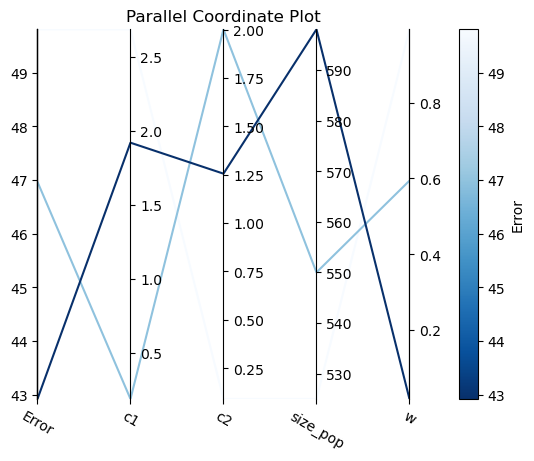

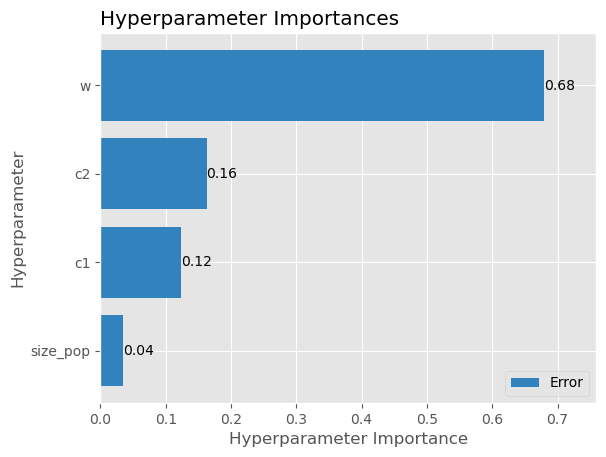

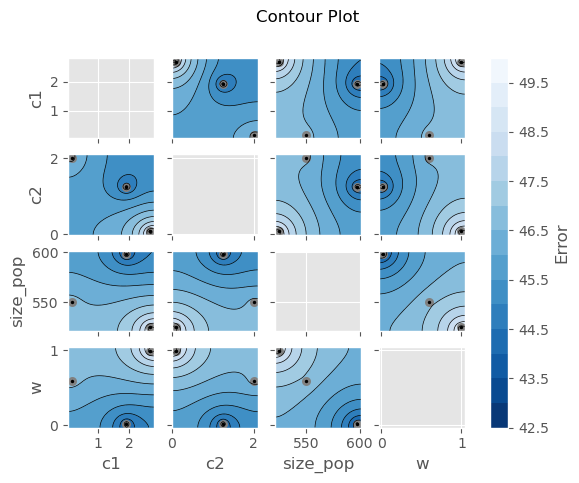

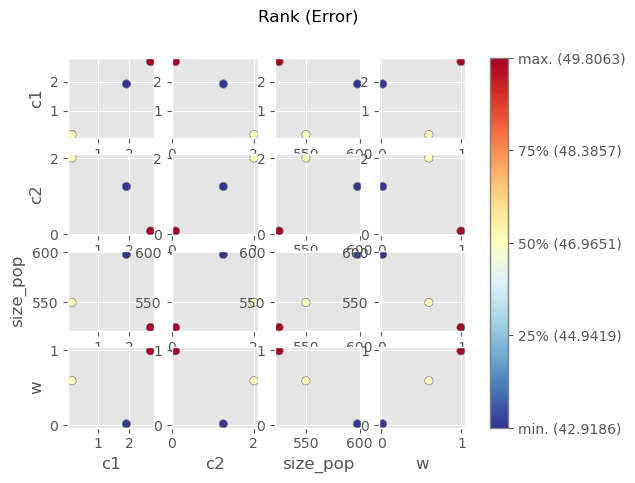

In [15]:
plot_parallel_coordinate(study3, target=lambda t: t.values[0], target_name="Error")
plot_param_importances(study3, target=lambda t: t.values[0], target_name="Error")
plot_contour(study3, target=lambda t: t.values[0], target_name="Error")
plot_rank(study3, target=lambda t: t.values[0], target_name="Error")

In [14]:
# Show the best trials.
for trial in study3.best_trials:
    print("Params: ",trial.params, "- Results (error):",trial.values) 

Params:  {'size_pop': 598, 'w': 0.017338575719548333, 'c1': 1.9185163634456635, 'c2': 1.255206268875891} - Results (error): [42.91863969005596]


While the error obtained in this experiment is higher than in the previous one, it is important to note that the population size used here is significantly higher. A population size of 598 led to a really computational expensive process due to the increased number of particles in the swarm, resulting in longer execution times (12h of execution time to obtain the result) and higher resource requirements. In addition the computational expense associated with such a large population size is not justifiable, since the error was not decreased. Also note that most tests take so long to finish that they reach the maximum time set by Optuna and are removed.

Therefore, while a smaller error is desirable, it is crucial to strike a balance between error minimization and computational efficiency. In practice, it is often necessary to find a population size that provides a reasonable trade-off between accuracy and computational cost. Experimentation with different population sizes and performance evaluation helps to identify the most suitable configuration for the specific optimization task at hand.

To end with this section let's test the best parameter set ({'size_pop': 499, 'w': 0.6408240838630879, 'c1': 0.8233999615314476, 'c2': 1.5571847381290729}) in all the TSP files.

reading tour berlin52
reading done 7542.0
Minimum of objective function: 7763.566222475603
Mean of objective function: 7965.178948294053
Variance of objective function: 39759.41045023048
Monte Carlo standard error: 63.055063595424656


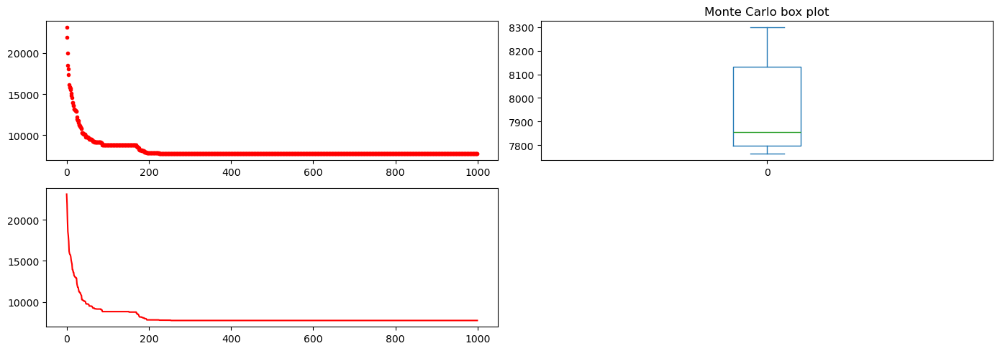

relative error PSO algorithm:  2.916998143728454 %


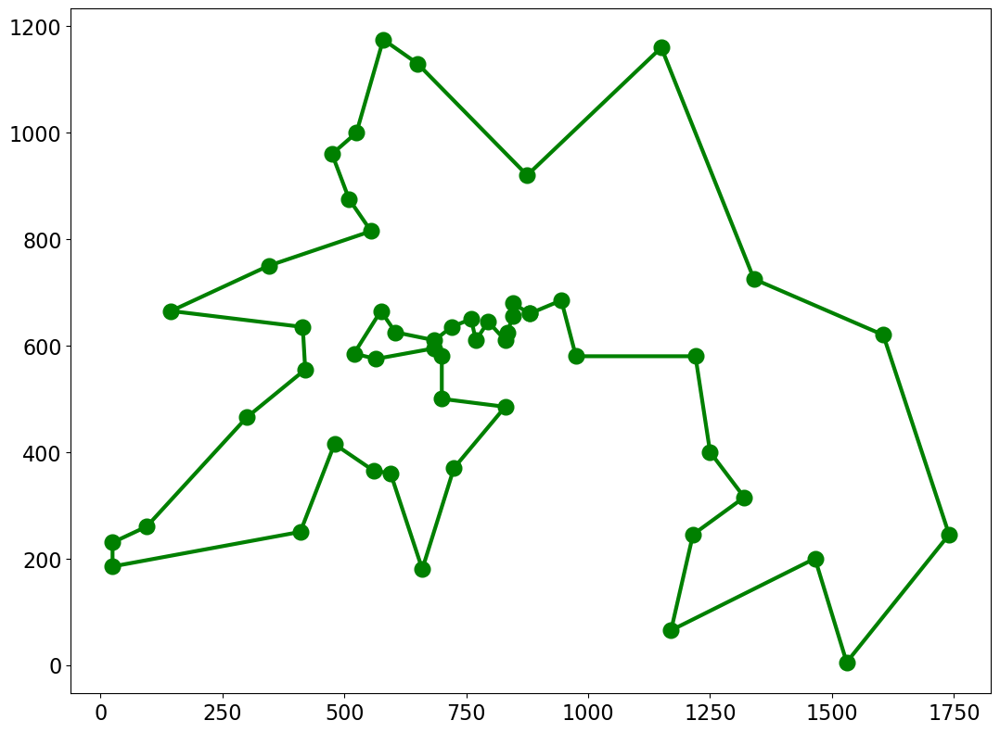

reading tour block40
reading optimal tour bestTour.opt.tour
reading done 400.0
Minimum of objective function: 400.0
Mean of objective function: 409.9411254969544
Variance of objective function: 24.706494036548634
Monte Carlo standard error: 1.5718299537974403


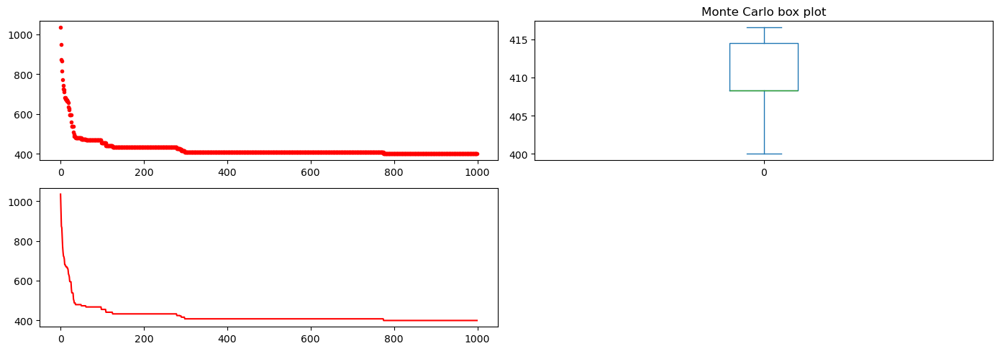

relative error PSO algorithm:  0.0 %


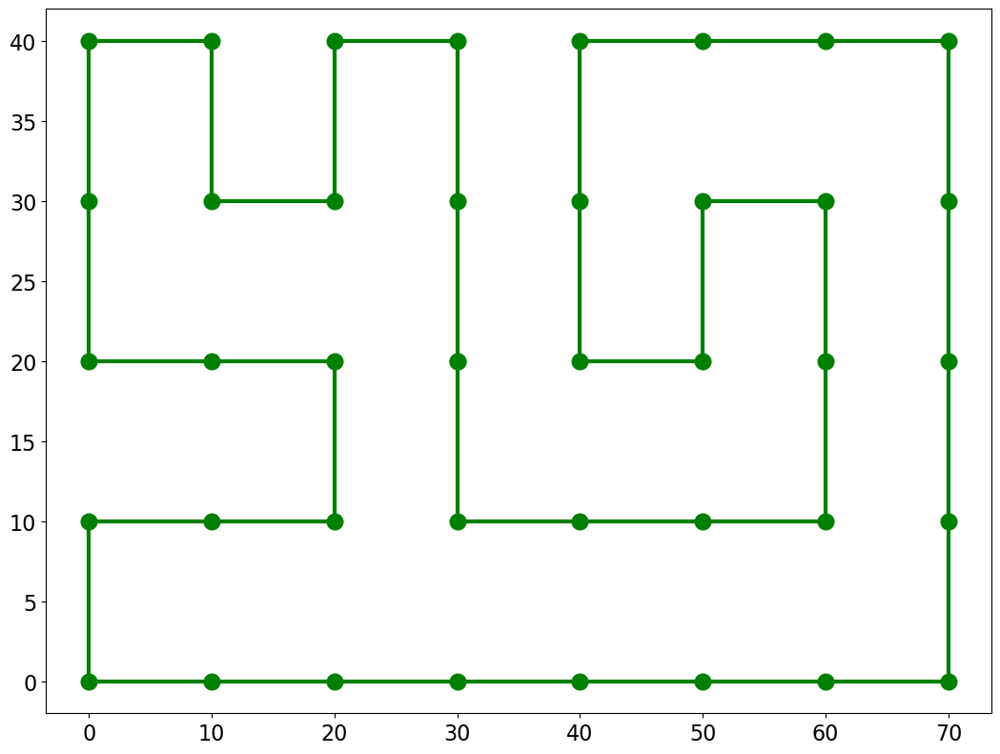

reading tour dj38
reading optimal tour dj38.pc.opt.tour
reading done 6656.0
Minimum of objective function: 6659.431532931463
Mean of objective function: 6680.143917454006
Variance of objective function: 2128.6435570797403
Monte Carlo standard error: 14.589871682368356


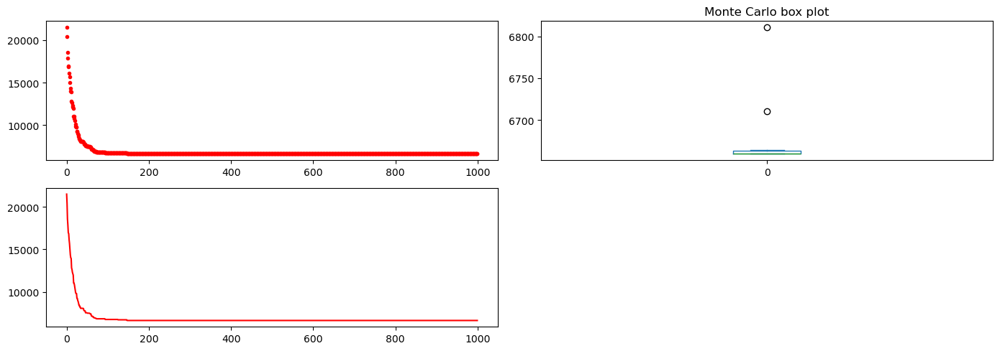

relative error PSO algorithm:  0.0 %


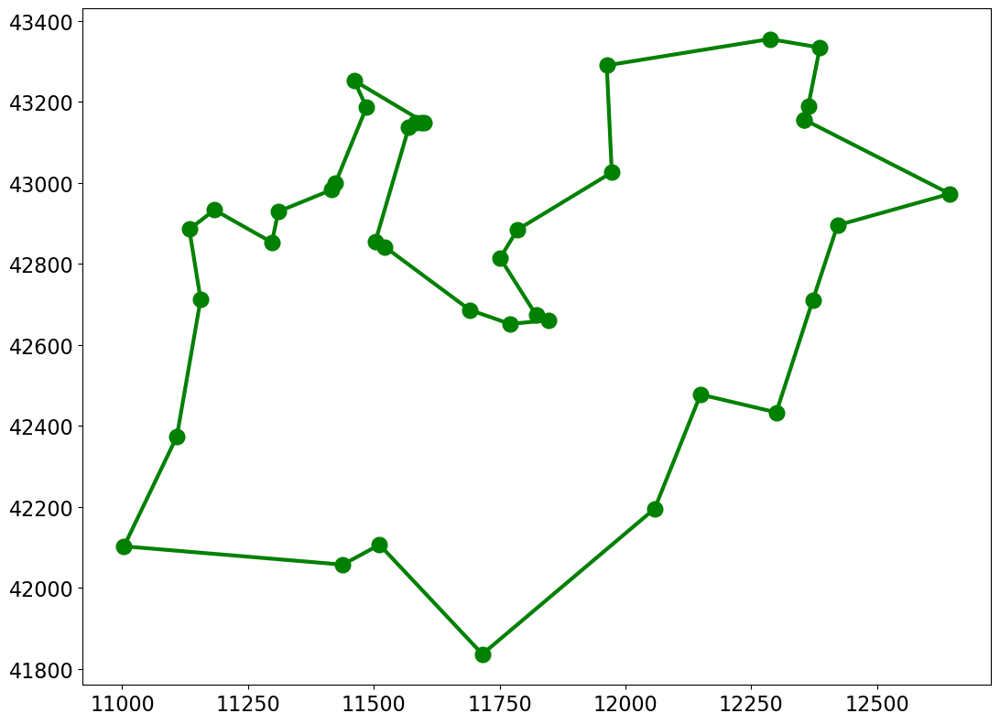

reading tour eil51
reading optimal tour eil51.opt.tour
reading done 426.0
Minimum of objective function: 429.48408067125524
Mean of objective function: 439.63496971360007
Variance of objective function: 20.15958485495448
Monte Carlo standard error: 1.4198445286352475


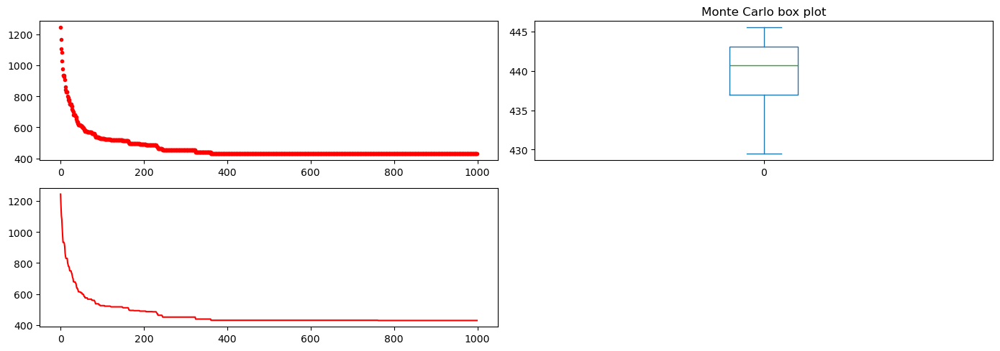

relative error PSO algorithm:  0.4694835680751174 %


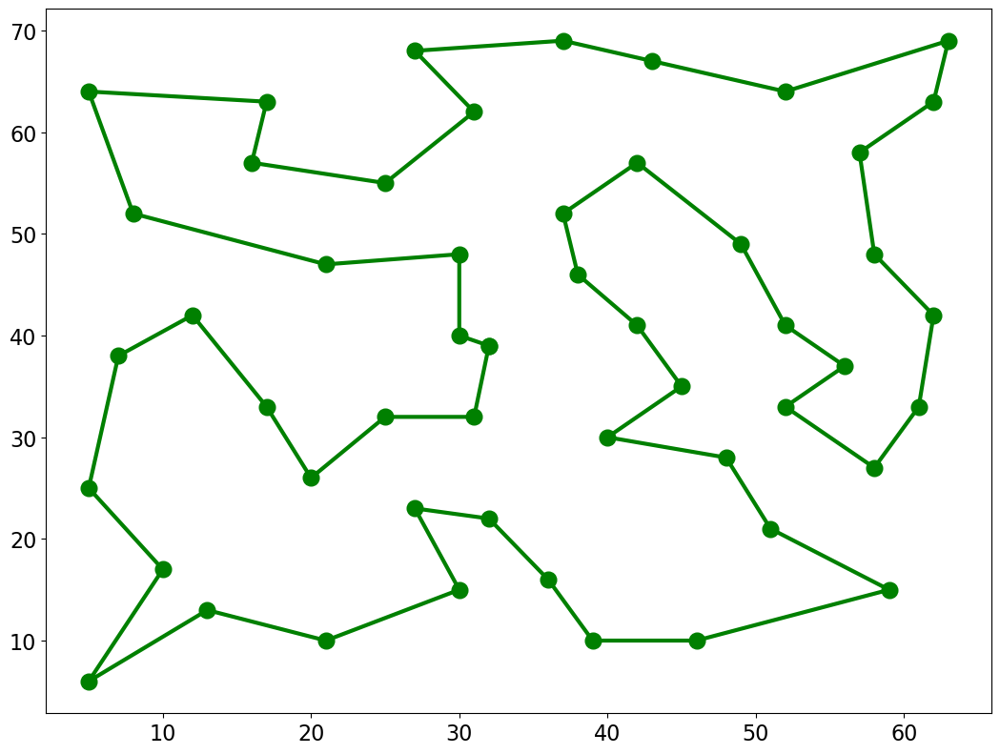

reading tour eil76
reading optimal tour eil76.opt.tour
reading done 538.0
Minimum of objective function: 578.4761735193941
Mean of objective function: 584.5543512226662
Variance of objective function: 18.073363726028013
Monte Carlo standard error: 1.3443721109137905


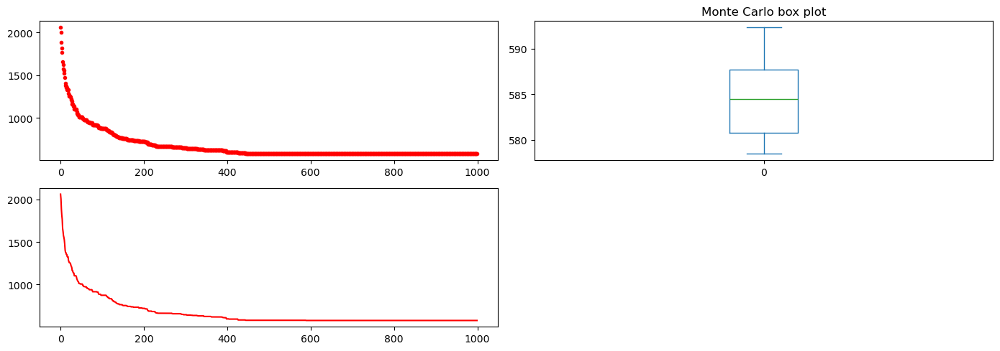

relative error PSO algorithm:  6.319702602230484 %


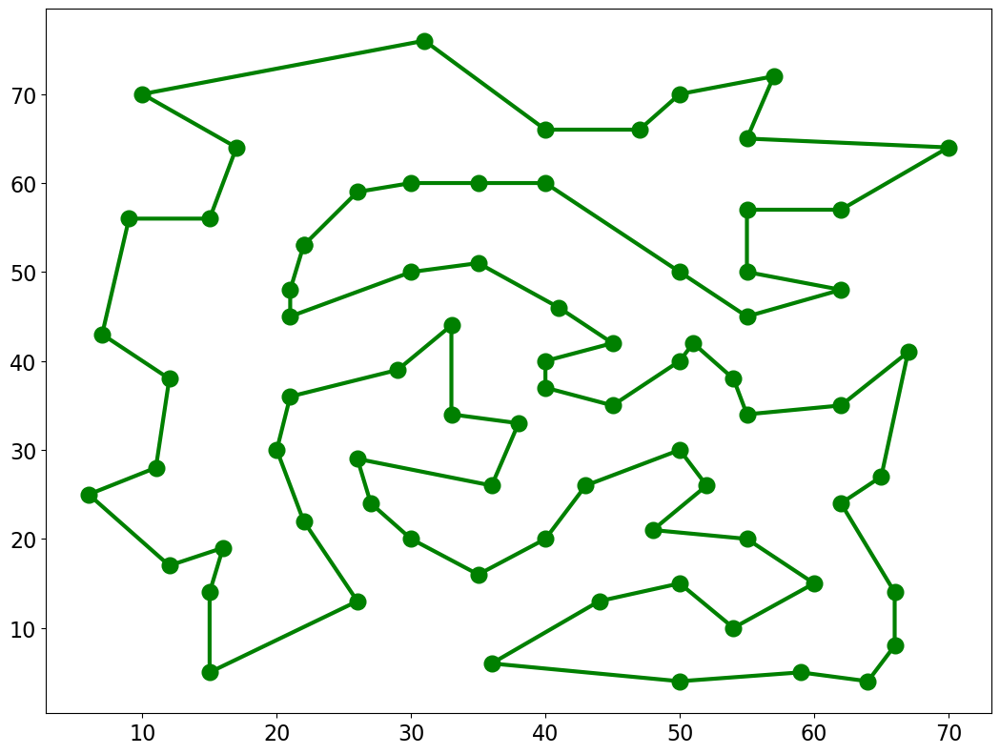

reading tour kroA100
reading optimal tour kroA100.opt.tour
reading done 21282.0
Minimum of objective function: 22038.753260422254
Mean of objective function: 23539.994969090032
Variance of objective function: 1297627.5138448519
Monte Carlo standard error: 360.22597266783134


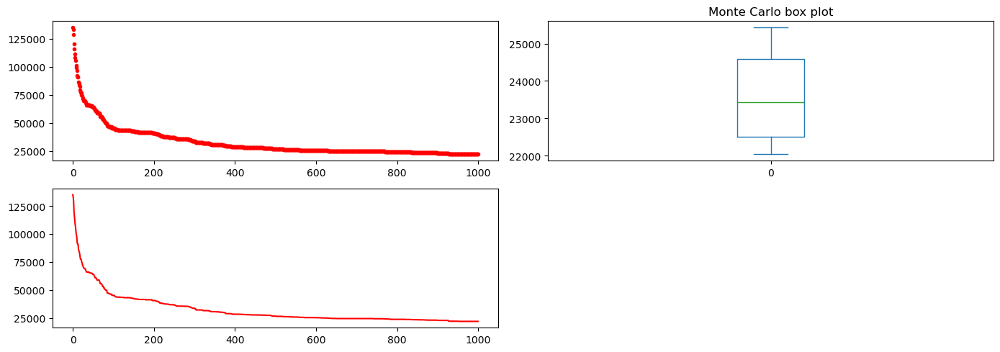

relative error PSO algorithm:  3.5382012968705947 %


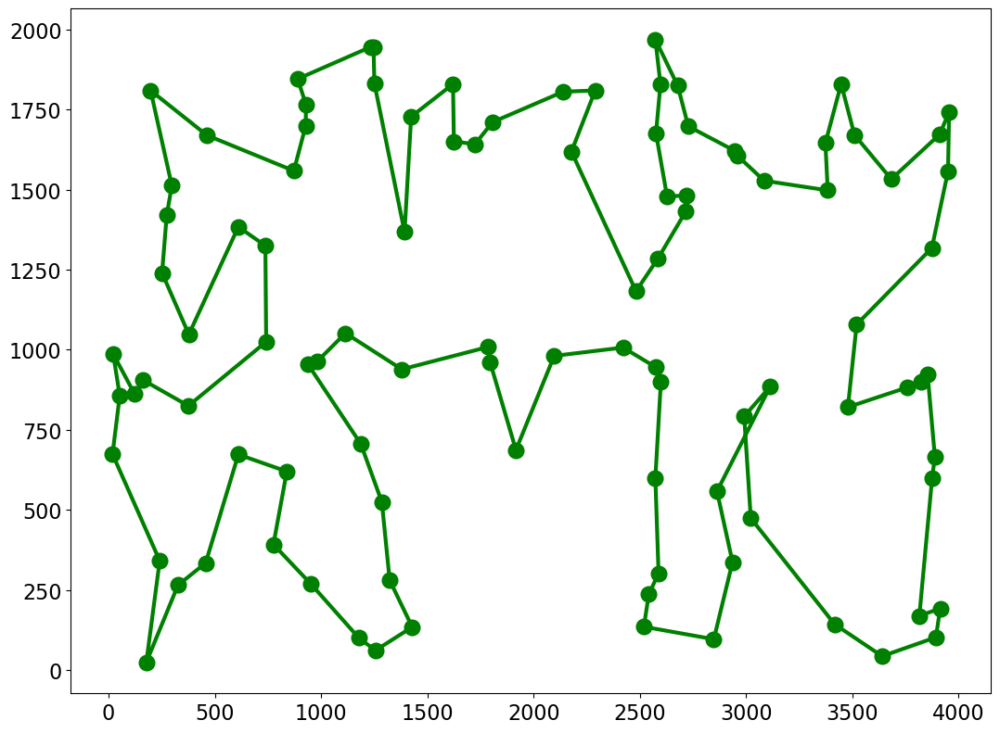

reading tour kroB100
reading optimal tour kroB100.pc.opt.tour
reading done 22141.0
Minimum of objective function: 23132.01656695294
Mean of objective function: 24548.79634476075
Variance of objective function: 495817.54906583996
Monte Carlo standard error: 222.66960930172752


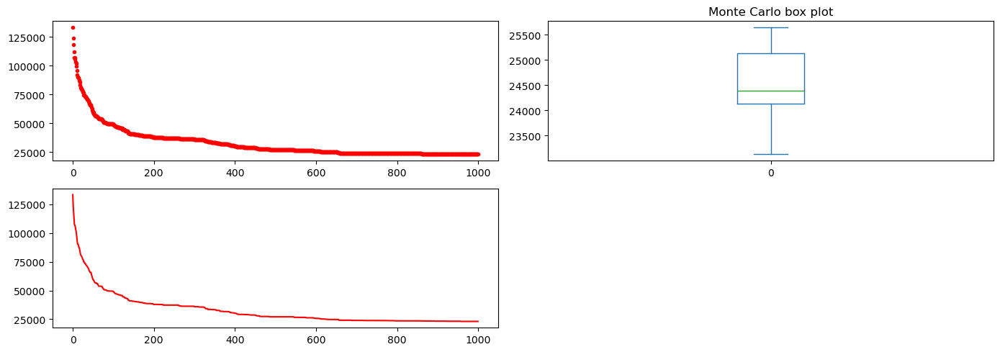

relative error PSO algorithm:  4.480375773451967 %


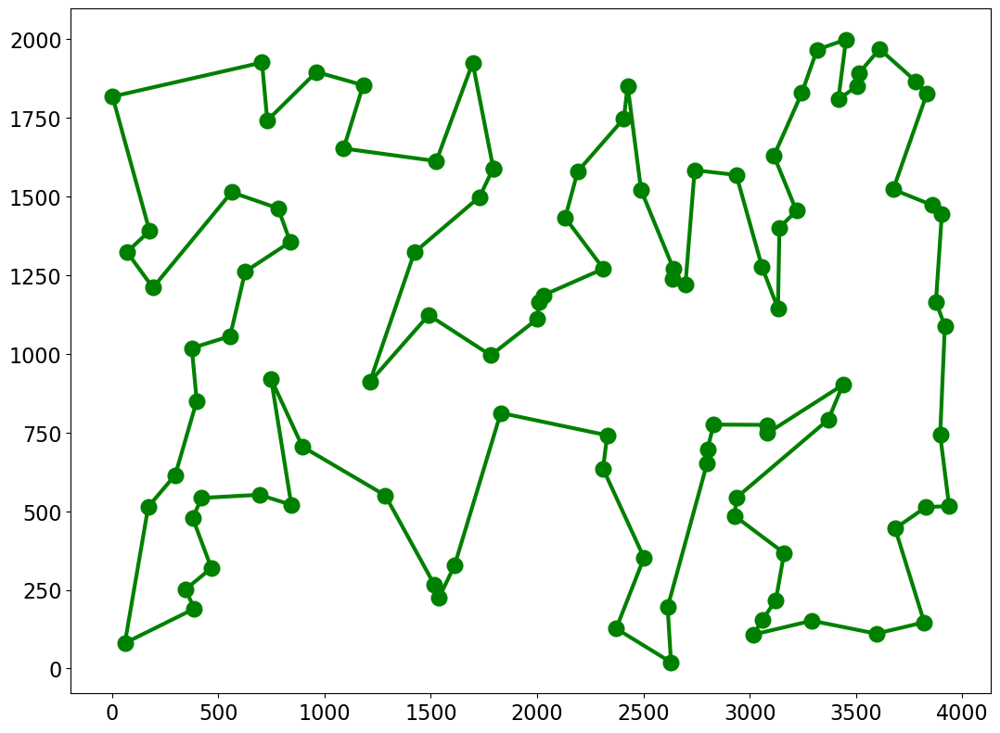

reading tour kroC100
reading optimal tour kroC100.opt.tour
reading done 20749.0
Minimum of objective function: 22186.858259268134
Mean of objective function: 23446.81786415161
Variance of objective function: 1446581.1311623973
Monte Carlo standard error: 380.33947088915147


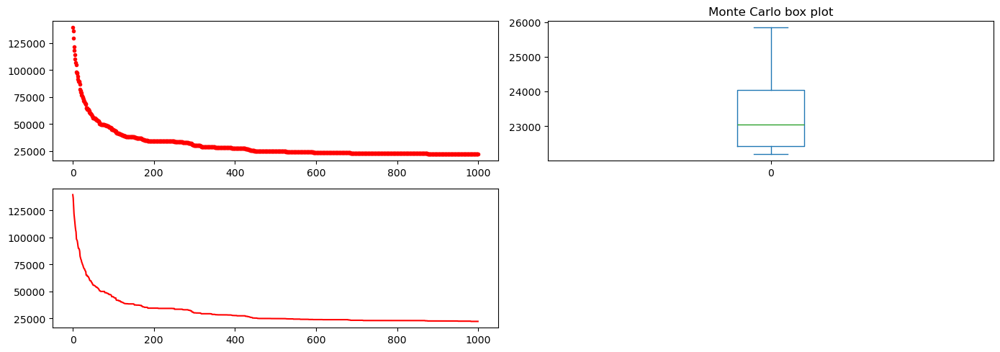

relative error PSO algorithm:  6.920815460986072 %


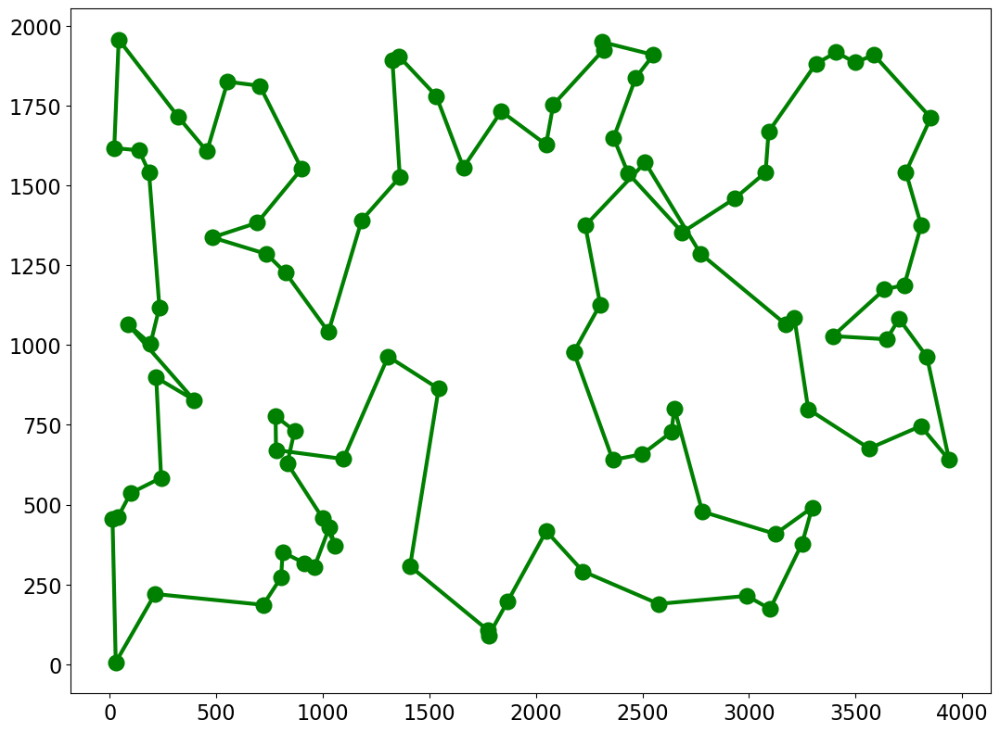

reading tour kroD100
reading optimal tour kroD100.opt.tour
reading done 21294.0
Minimum of objective function: 22552.828467976156
Mean of objective function: 23500.730863755576
Variance of objective function: 698165.373363591
Monte Carlo standard error: 264.2281917895195


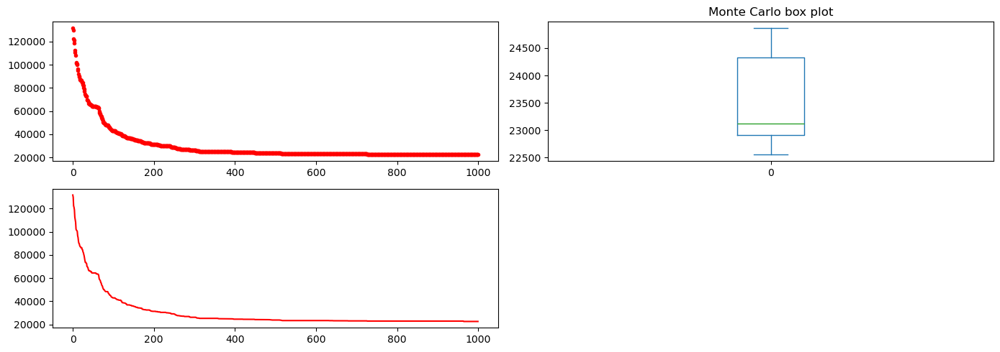

relative error PSO algorithm:  5.907767446228985 %


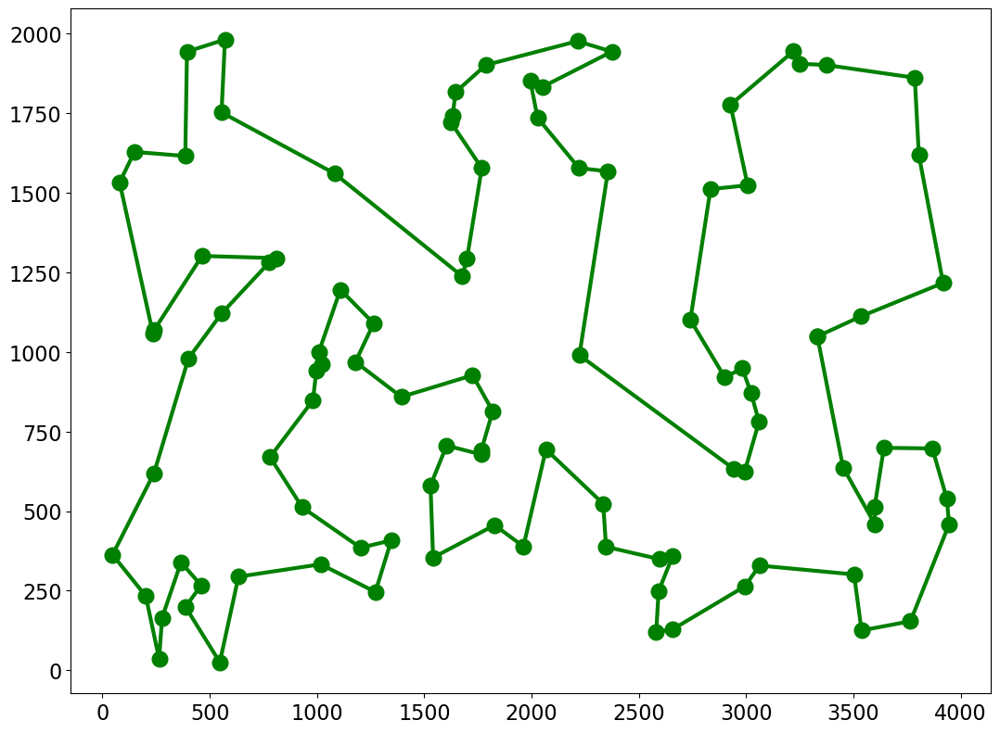

reading tour pr76
reading optimal tour pr76.opt.tour
reading done 108159.0
Minimum of objective function: 111527.75671064865
Mean of objective function: 114742.9381863287
Variance of objective function: 3997299.4942643
Monte Carlo standard error: 632.2420022637139


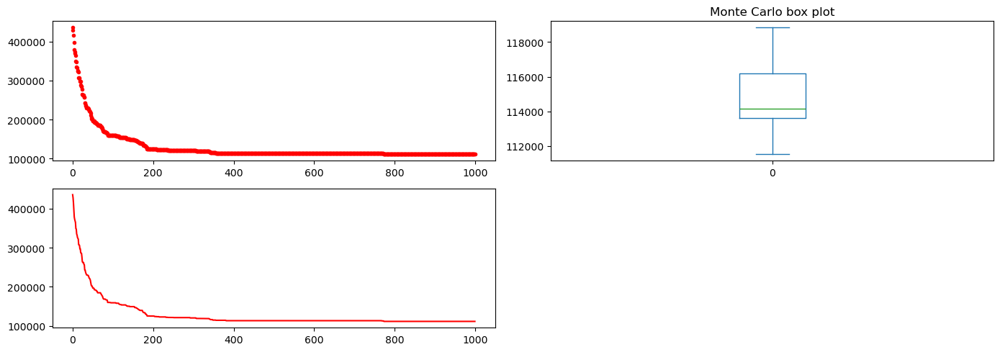

relative error PSO algorithm:  3.1120849859928437 %


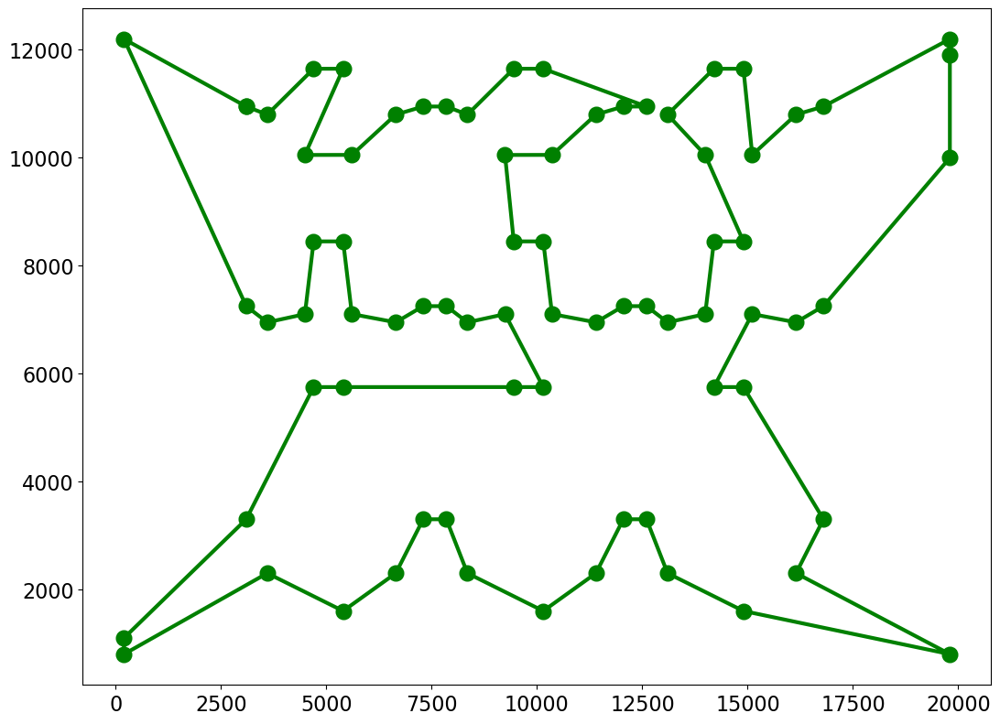

reading tour rat195
reading done 2323.0
Minimum of objective function: 3415.93309794504
Mean of objective function: 3740.886778998888
Variance of objective function: 22149.901860533446
Monte Carlo standard error: 47.06368224069749


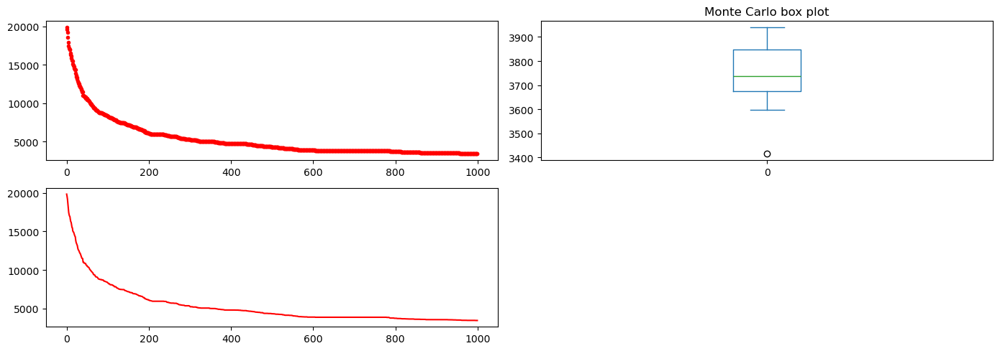

relative error PSO algorithm:  46.53465346534654 %


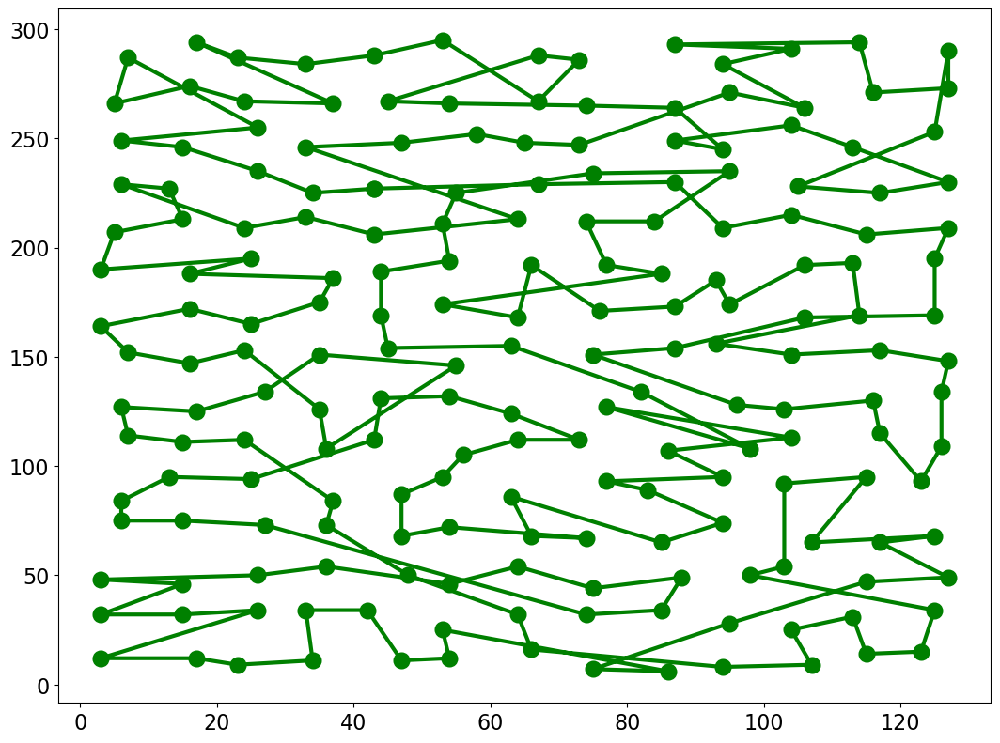

reading tour rat99
reading optimal tour rat99.pc.opt.tour
reading done 1211.0
Minimum of objective function: 1321.178252619735
Mean of objective function: 1364.4211330358457
Variance of objective function: 940.1277709378921
Monte Carlo standard error: 9.696018620742702


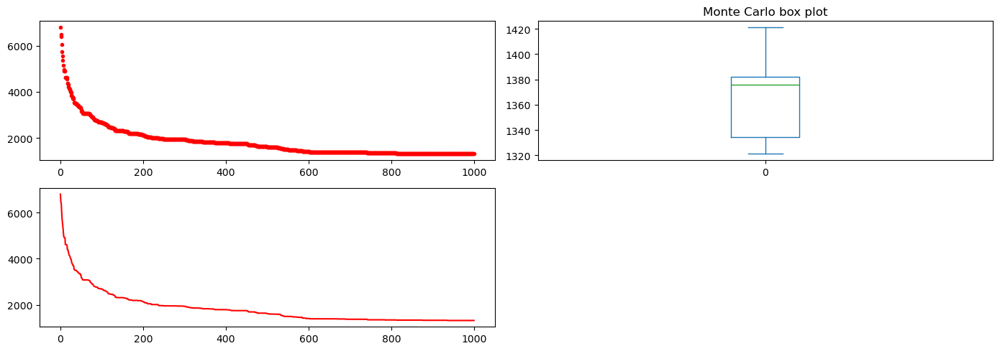

relative error PSO algorithm:  8.670520231213873 %


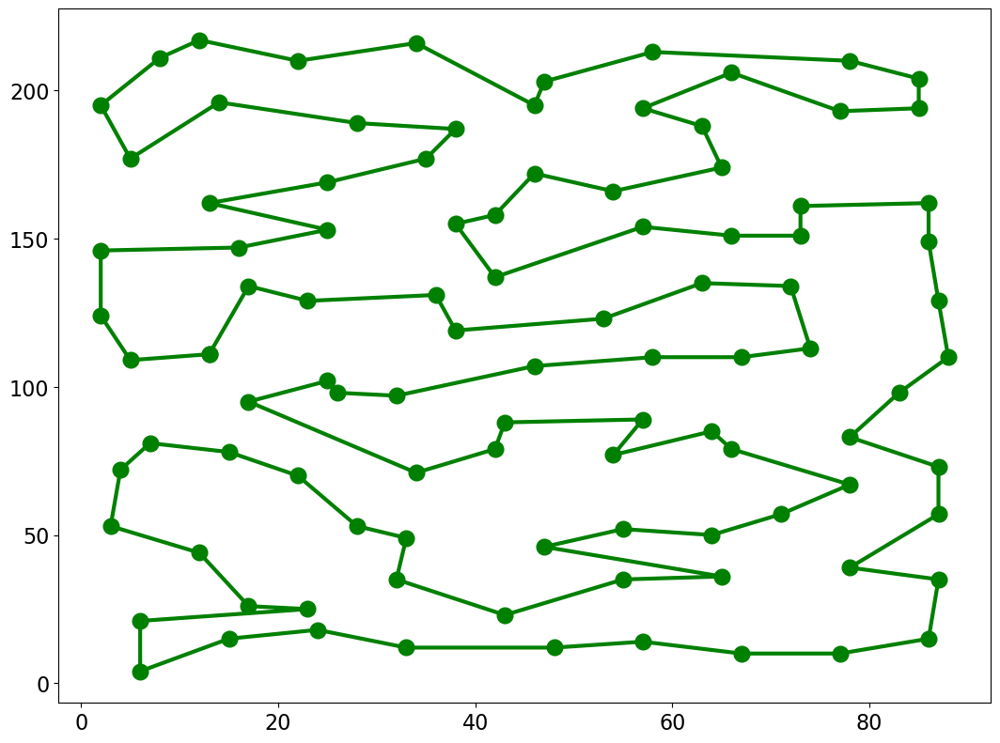

reading tour rd100
reading optimal tour rd100.pc.opt.tour
reading done 7910.0
Minimum of objective function: 8233.869464248128
Mean of objective function: 8788.156158401933
Variance of objective function: 87058.81096941055
Monte Carlo standard error: 93.30531119363492


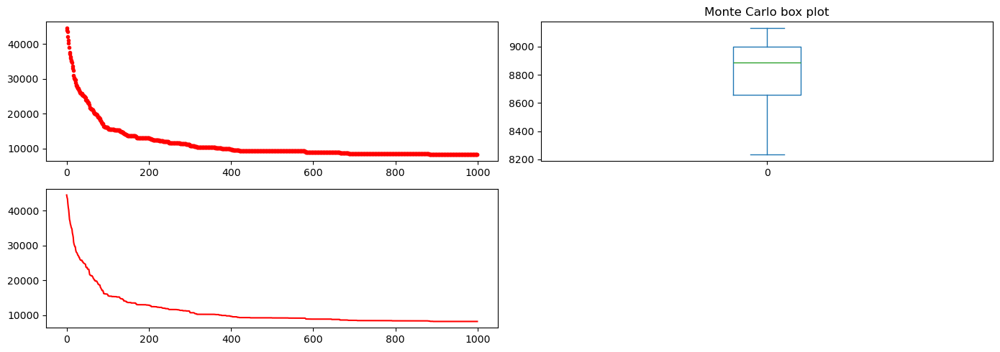

relative error PSO algorithm:  4.070796460176991 %


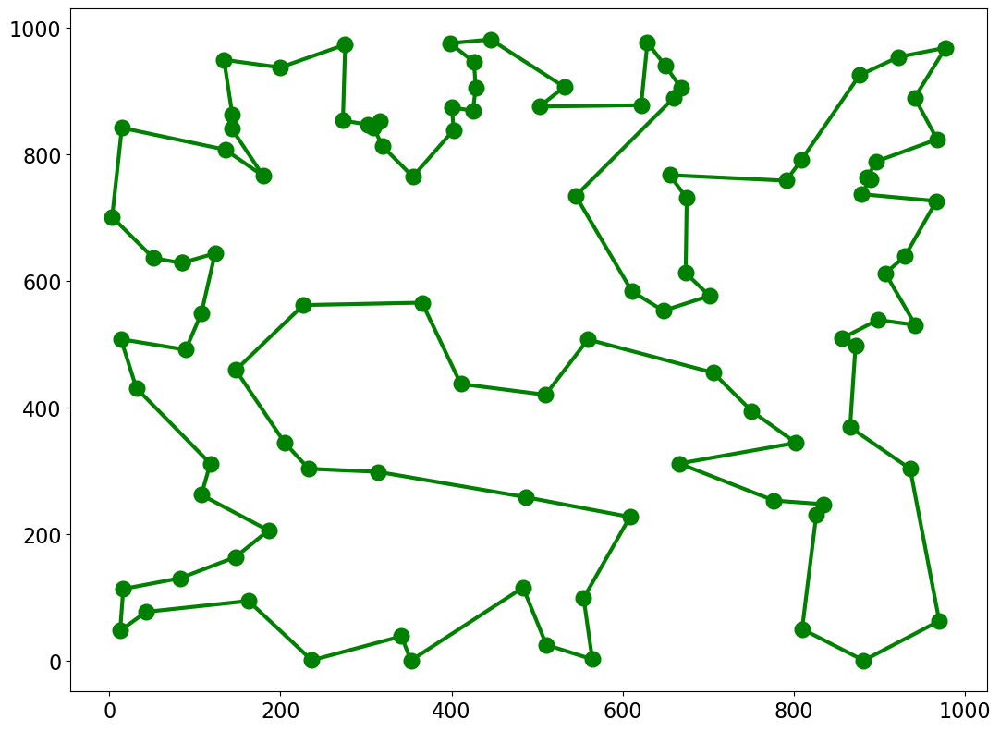

reading tour st70
reading optimal tour st70.opt.tour
reading done 675.0
Minimum of objective function: 679.3691555373749
Mean of objective function: 711.759687256698
Variance of objective function: 260.5896447861419
Monte Carlo standard error: 5.104798181967059


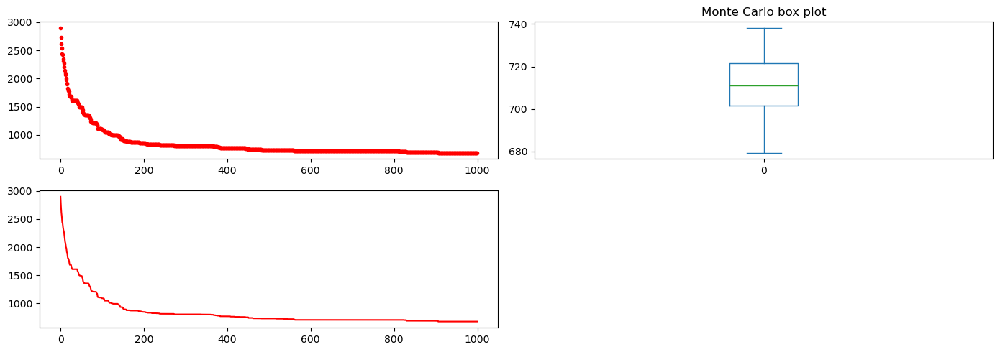

relative error PSO algorithm:  0.2962962962962963 %


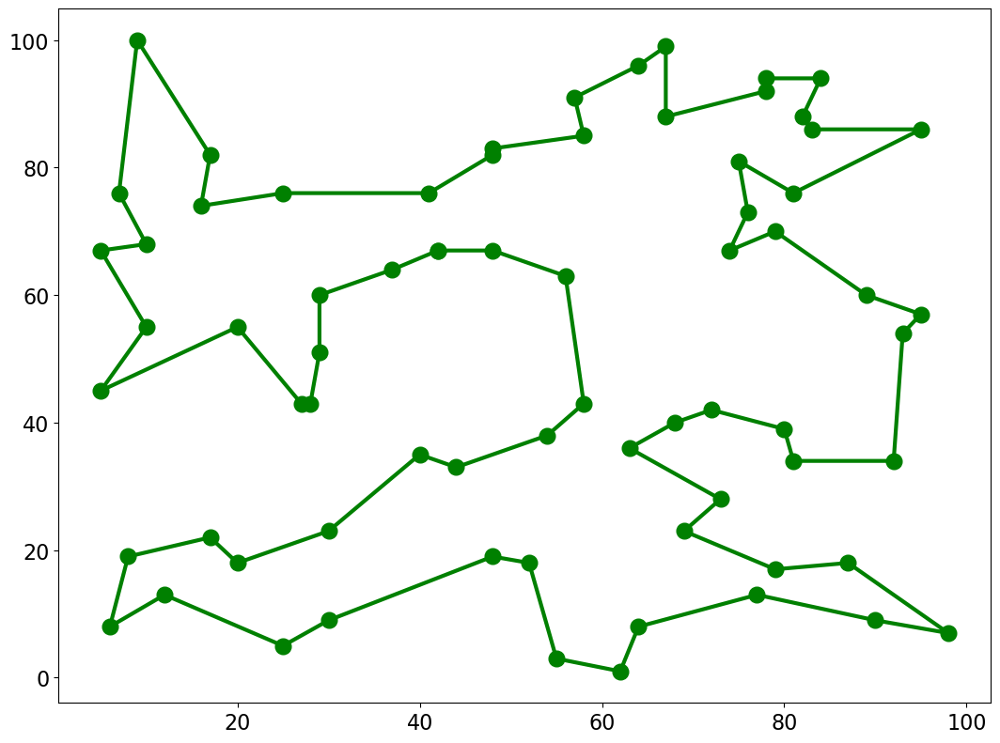

reading tour wi29
reading optimal tour wi29.pc.opt.tour
reading done 27603.0
Minimum of objective function: 27601.17377449375
Mean of objective function: 27821.92352120682
Variance of objective function: 117799.04044803022
Monte Carlo standard error: 108.53526636445419


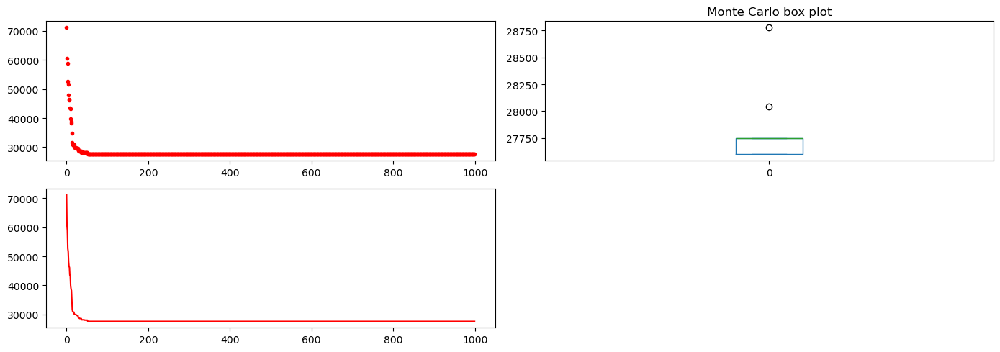

relative error PSO algorithm:  0.0 %


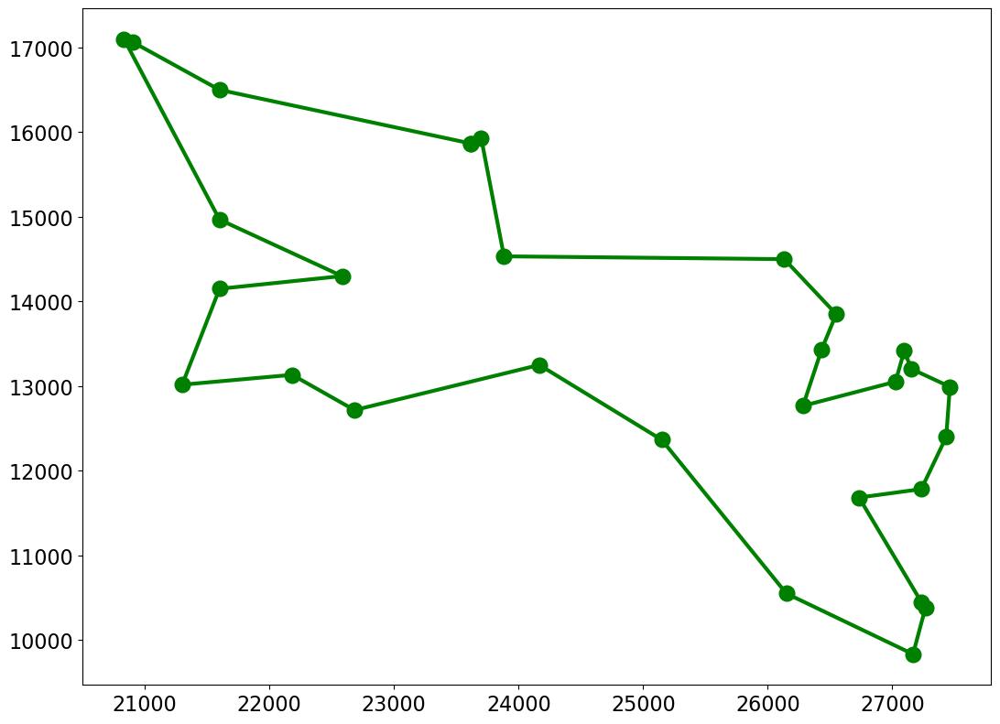

In [18]:
params = {
    "size_pop": 499,
    'max_iter': 1000,
    'w': 0.6408240838630879,
    'c1': 0.8233999615314476,
    'c2': 1.5571847381290729,
}

rounds=10

# Get tour filenames
tour_filenames = [ os.path.splitext(filename)[0] for filename in os.listdir(TOURS_PATH) if filename.endswith(".tsp") ]
results = {"File":[],"PSO tour":[]}

for filename in tour_filenames:

  theCities,bestLength,bestTour=ReadTsp(TOURS_PATH+"/"+filename)

  results["File"].append(filename)

  bestT,error=MonteCarloPSOTour(rounds,theCities,bestLength,params, plot=True)
  print("relative error PSO algorithm: ",error,"%")
  PlotTour(bestT,"green",show=True,fn=filename+"_GeneticAlgorithm.png")
  results["PSO tour"].append(error)

In [13]:
print(tabulate(results, headers=results.keys()))

File        PSO tour
--------  ----------
berlin52    2.917
block40     0
dj38        0
eil51       0.469484
eil76       6.3197
kroA100     3.5382
kroB100     4.48038
kroC100     6.92082
kroD100     5.90777
pr76        3.11208
rat195     46.5347
rat99       8.67052
rd100       4.0708
st70        0.296296
wi29        0


Comparing the two parameter optimization methods we would obtain the following table:

| File    | GA error (Grid search) (%)      | PSO error (Grid search) (%) | PSO error (Optuna) (%) |
|---------|----------|----------------|-------------------|
| berlin52| 6.86820  | 0              | 2.917             |
| block40 | 2.0      | 0              | 0                 |
| dj38    | 0.06009  | 0              | 0                 |
| eil51   | 1.64319  | 1.17371        | 0.469484          |
| eil76   | 4.83271  | 4.64684        | 6.3197            |
| kroA100 | 4.96663  | 2.96965        | 3.5382            |
| kroB100 | 2.77765  | 6.41344        | 4.48038           |
| kroC100 | 2.89170  | 6.85334        | 6.92082           |
| kroD100 | 8.36385  | 3.4188         | 5.90777           |
| pr76    | 3.19159  | 0.951377       | 3.11208           |
| rat195  | 28.62677 | 44.124         | 46.5347           |
| rat99   | 7.10156  | 7.43187        | 8.67052           |
| rd100   | 7.73704  | 3.81795        | 4.0708            |
| st70    | 3.70370  | 1.48148        | 0.296296          |
| wi29    | 0        | 0              | 0                 |


## Descriptive statistics for TSP datasets:
|     |    mean      |    std        |    min  |    max   |
| --- | ------------ | ------------- | ------- | -------- |
|  GA   | 5.6509786667 | 6.8796581894  | 0       | 28.62677 |
|  PSO (Grid search)   | 5.5521638    | 10.983809779  | 0       | 44.124   |
|  PSO (Optuna)   | 6.21585      | 11.5000269287 | 0       | 46.5347  |


**Performance Comparison**: For some instances, PSO (Optuna) outperforms both GA and the original PSO parameter settings. For example, in "eil51", "kroB100" and "st70", it produces better results than the grid search PSO configuration. However in "eil76", "pr76", "rd100" and "kroA100", the grid search PSO configuration performs better.

**Trade-offs**: It's evident that there are trade-offs between the algorithms and their parameter settings. While PSO (Grid Search) might outperform the original PSO in some instances, it might perform worse in others. This indicates the importance of tailoring algorithm parameters to specific problem characteristics. The No Free Lunch theorem further underscores this point by stating that no single optimization algorithm performs best across all possible problems. Hence, it's crucial to explore different algorithms and parameter configurations to find the most effective solution for a specific problem.

**Algorithm stability**: Another point worth to mention is the instability stated by the high variance of the objective function in some TSP files.

### **Additional experiment: Verify the property 1 > ξ > 1/2(ϕ1 +ϕ2)−1 ≥ 0**:
In order to verify the property 1 > ξ > 1/2(ϕ1 +ϕ2)−1 ≥ 0. Since φ1 = c1*U(0, 1) and φ2 = c2*U(0, 1), the acceleration coefficients,
c1 and c2 serve as upper bounds of φ1 and φ2. Equation (16.38) can then be rewritten as 1 > ξ > 1/2(c1 +c2) − 1 ≥ 0.  Hence we should set: c1 + c2 < 4

Let's check if surpassing this values the algorithm is not able to converge. Using the parameters which provided the most stable results for minimizing Schaffer N.2 function we will carry out 10 experiments using arbitrary values for c1 (5.6) and c2 (3.4), whose sum is higher than 4.

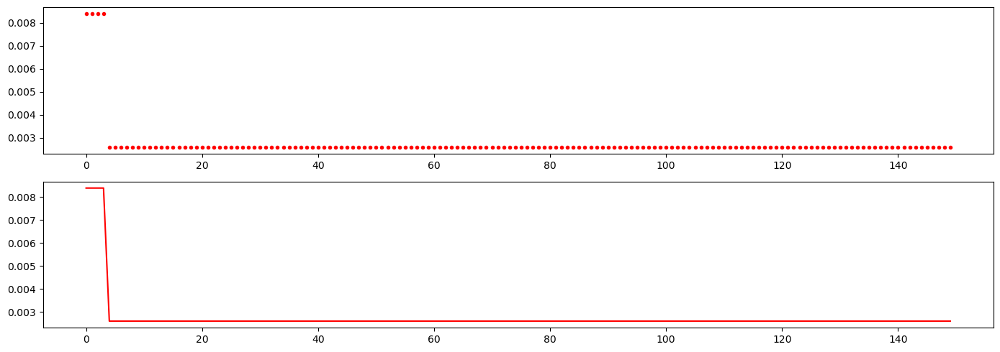

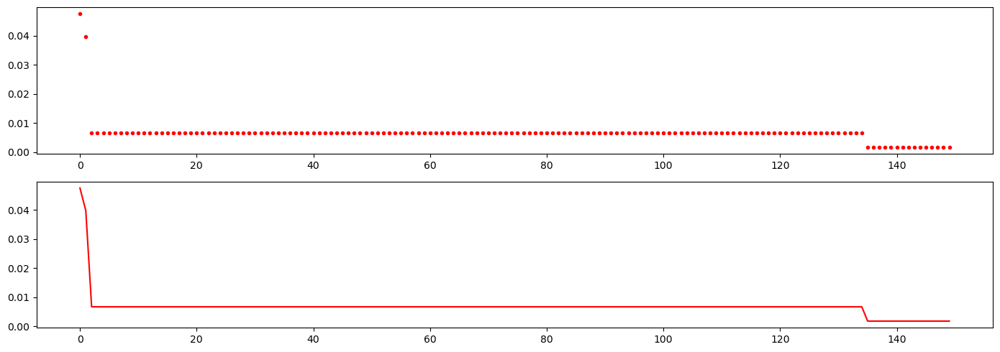

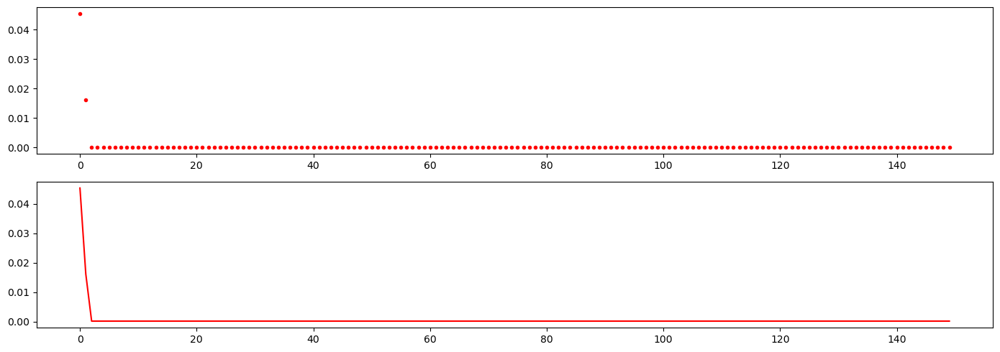

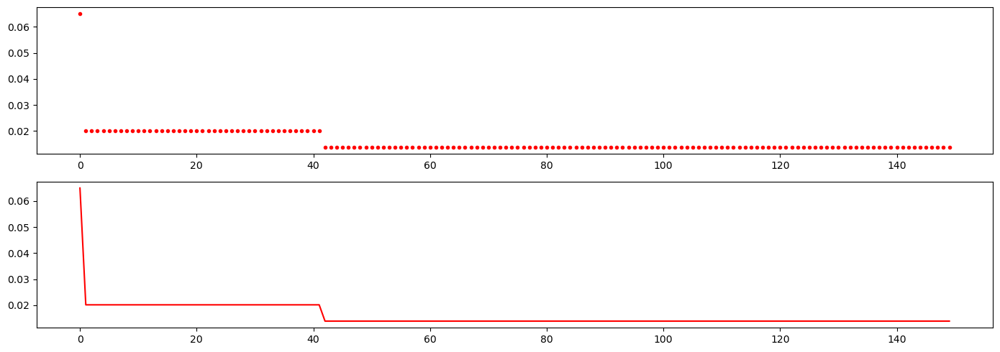

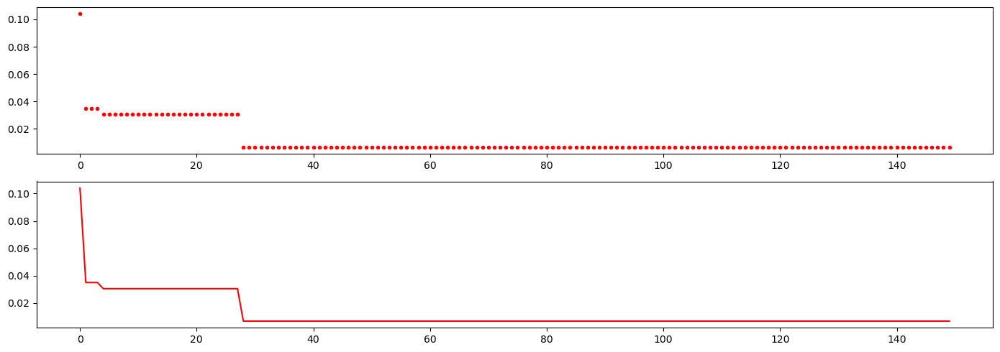

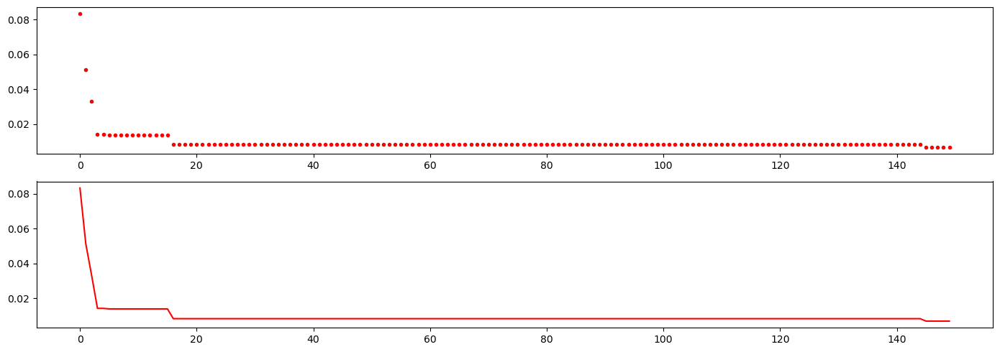

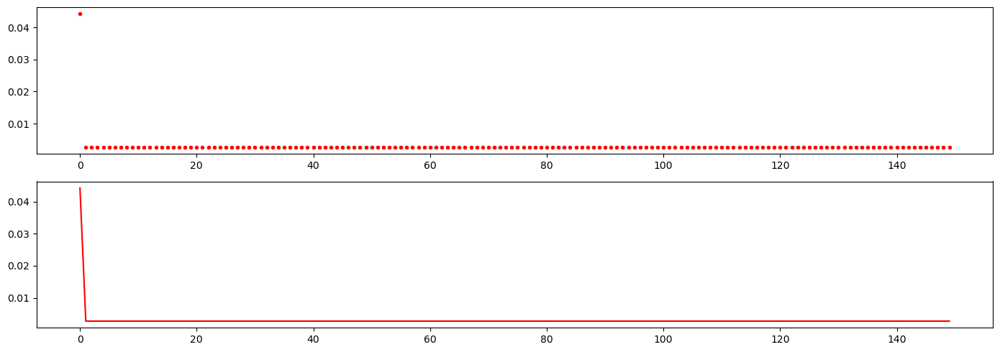

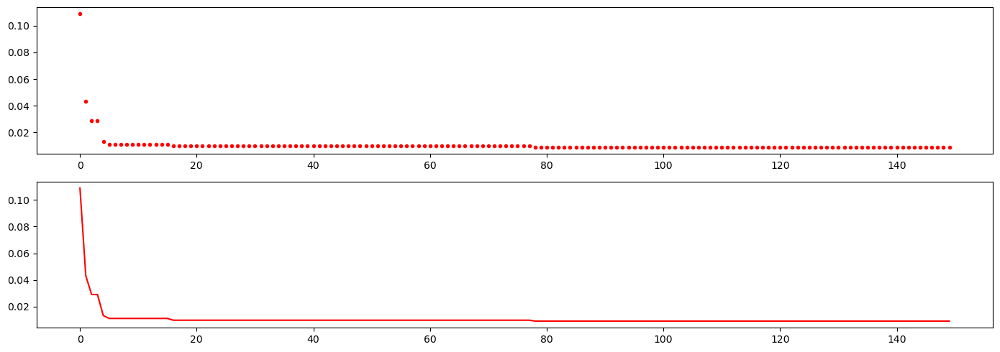

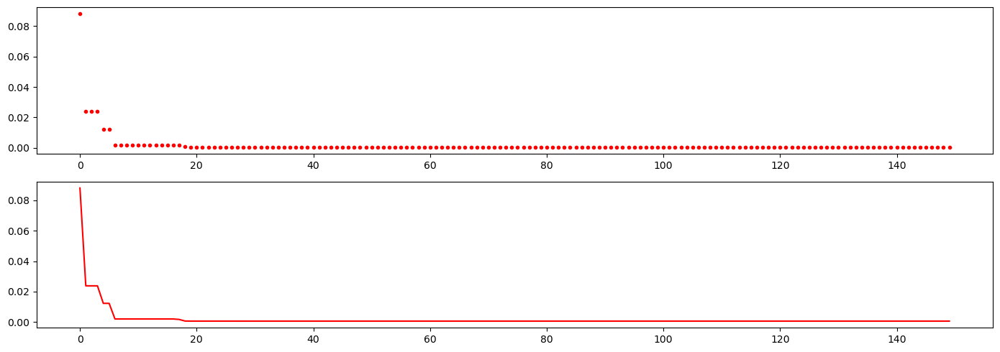

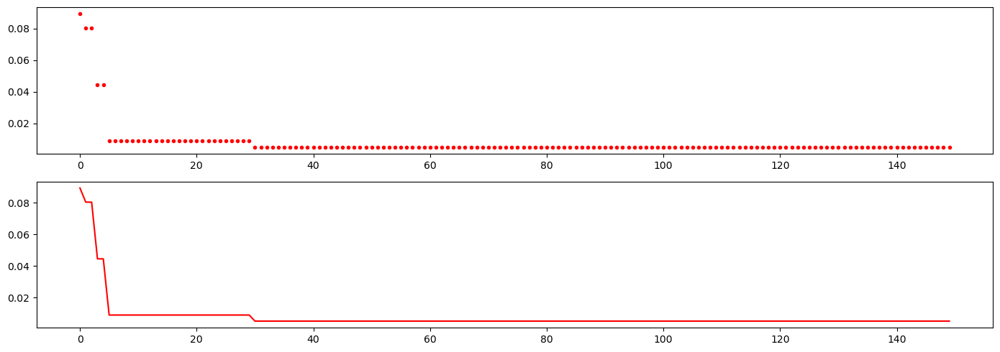

In [49]:
for i in range(10):
    params = {'pop': 498, 'w': 0.08226738195182977, 'c1': 5.6, 'c2': 3.4}

    al = PSO(func=schaffer_n2, n_dim=2, lb=[-100, -100], ub=[100, 100], **params)
                
    best_x, best_y = al.run()

    Y_history = pd.DataFrame(al.gbest_y_hist)

    # Plot the results as a box plot
    fig, axs = plt.subplots(2, 1, figsize=(14, 5))

    # Plot Y_history
    axs[0].plot(Y_history.index, Y_history.values, '.', color='red')
    Y_history.min(axis=1).cummin().plot(kind='line', ax=axs[1], color='red')

    plt.tight_layout()  # Adjust layout for better spacing
    plt.show()

In the plots above we can see how the algorithm has problems to converge in many executions (is not able to reach the global minimum of 0), highlighting the importance of fulfilling the condition previously stated. For a better visualization of this problem let's plot the particle animation first with the parameters which fulfill the condition and afterwards with the parameters which do not fulfill the condition.

In [ ]:
# Animation plot for parameters fulfilling the convergence condition
params = {'pop': 461, 'w': 0.009545519076492514, 'c1': 0.9216112737597871, 'c2': 1.8512726974377147}

al = PSO(func=schaffer_n2, n_dim=2, lb=[-100, -100], ub=[100, 100], **params)
al.record_mode = True
al.run()

# %% Now Plot the animation
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

record_value = al.record_value
X_list, V_list = record_value['X'], record_value['V']

fig, ax = plt.subplots(1, 1)
ax.set_title('title', loc='center')
line = ax.plot([], [], 'b.')

X_grid, Y_grid = np.meshgrid(np.linspace(-2.0, 2.0, 40), np.linspace(-2.0, 2.0, 40))
Z_grid = schaffer_n2((X_grid, Y_grid))
ax.contour(X_grid, Y_grid, Z_grid, 30)

ax.set_xlim(-2, 2)
ax.set_ylim(-2, 2)

t = np.linspace(0, 2 * np.pi, 40)
ax.plot(0.5 * np.cos(t) + 1, 0.5 * np.sin(t), color='r')

plt.ion()
p = plt.show()


def update_scatter(frame):
    i, j = frame // 10, frame % 10
    ax.set_title('iter = ' + str(i))
    X_tmp = X_list[i] + V_list[i] * j / 10.0
    plt.setp(line, 'xdata', X_tmp[:, 0], 'ydata', X_tmp[:, 1])
    return line


ani = FuncAnimation(fig, update_scatter, blit=True, interval=25, frames=150 * 10)
plt.show()

ani.save('pso.gif', writer='pillow')

<img src="pso.gif" width="750" align="center">

In [ ]:
# Animation plot for parameters not fulfilling the convergence condition
params = {'pop': 498, 'w': 0.08226738195182977, 'c1': 5.6, 'c2': 3.4}

al = PSO(func=schaffer_n2, n_dim=2, lb=[-100, -100], ub=[100, 100], **params)
al.record_mode = True
al.run()

# %% Now Plot the animation
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

record_value = al.record_value
X_list, V_list = record_value['X'], record_value['V']

fig, ax = plt.subplots(1, 1)
ax.set_title('title', loc='center')
line = ax.plot([], [], 'b.')

X_grid, Y_grid = np.meshgrid(np.linspace(-2.0, 2.0, 40), np.linspace(-2.0, 2.0, 40))
Z_grid = schaffer_n2((X_grid, Y_grid))
ax.contour(X_grid, Y_grid, Z_grid, 30)

ax.set_xlim(-2, 2)
ax.set_ylim(-2, 2)

t = np.linspace(0, 2 * np.pi, 40)
ax.plot(0.5 * np.cos(t) + 1, 0.5 * np.sin(t), color='r')

plt.ion()
p = plt.show()


def update_scatter(frame):
    i, j = frame // 10, frame % 10
    ax.set_title('iter = ' + str(i))
    X_tmp = X_list[i] + V_list[i] * j / 10.0
    plt.setp(line, 'xdata', X_tmp[:, 0], 'ydata', X_tmp[:, 1])
    return line


ani = FuncAnimation(fig, update_scatter, blit=True, interval=25, frames=150 * 10)
plt.show()

ani.save('pso_2.gif', writer='pillow')

<img src="pso_2.gif" width="750" align="center">

While using the first parameter set the algorithm converges without problem, using the second one the algorithm is unable to converge.

## Conclusion

In conclusion, the application of Particle Swarm Optimization (PSO) to minimize functions or to solve combinatorial optimization problems such as the Traveling Salesman Problem (TSP) has demonstrated its effectiveness and versatility. PSO operates by simulating the behavior of swarms, where individual particles iteratively adjust their positions in the search space based on their own experience and the best experiences of neighboring particles. This collaborative exploration and exploitation process allows PSO to efficiently traverse the solution space and converge towards optimal or near-optimal solutions.

However, the success of PSO (same as GA) heavily relies on the selection of its parameters. Key parameters include the size of the population, inertia weight, cognitive coefficient, and social coefficient. Each parameter influences PSO's behavior and performance uniquely. For example, a larger population size enhances exploration capabilities but may increase computational overhead, while adjusting the inertia weight affects the balance between exploration and exploitation.

PSO's performance heavily depends on parameter tuning and may struggle with complex TSP instances due to its inherent stochastic nature. On the other hand, heuristics such as nearest neighbor, though simpler and often faster to execute, may lack the global search capability of PSO, leading to suboptimal solutions. Nevertheless, heuristics tend to be more robust and require less parameter tuning, making them suitable for smaller TSP instances or scenarios where computational resources are limited. Ultimately, the choice between PSO and heuristics depends on the specific requirements of the TSP instance, including its size, complexity, available computational resources, and desired solution quality.

Achieving an optimal parameter configuration is crucial for maximizing PSO's performance. Inappropriate parameter settings can lead to suboptimal solutions, premature convergence, or inefficient exploration of the solution space. In real-world applications, considerations such as computational efficiency alongside optimization performance must be taken into account. Therefore, researchers and practitioners must engage in rigorous parameter tuning to identify the most suitable parameter combination for their specific PSO instances. This process often involves iterative experimentation and refinement to strike a balance between exploration and exploitation while considering computational constraints.

As parameter selection is problem-dependent, there is no one-size-fits-all solution, and experimentation remains the primary approach to finding optimal parameter values. As optimization methodologies evolve, refining PSO's parameters will continue to be a vital aspect of enhancing its performance and applicability across a diverse range of optimization challenges.

Another point worth to mention is that, in contrast to traditional grid search approaches for parameter tuning, Optuna offers a more efficient and automated method for finding the best parameter configuration. Grid search involves exhaustively trying out every possible combination of parameter values within predefined ranges, which can be computationally expensive and impractical, especially for high-dimensional optimization problems. Optuna, on the other hand, employs techniques such as Bayesian optimization and tree-structured Parzen estimators to intelligently search the parameter space, prioritizing promising regions based on past evaluations. This adaptive search strategy not only reduces the computational burden but also tends to converge more quickly towards optimal solutions by dynamically allocating resources to areas of higher potential.